In [16]:
import matplotlib.image as image
import matplotlib.pyplot as plt
import numpy as np
import SimpleITK as sitk
import os as os
import nrrd as reader
import pandas as pd
import cv2 as cv
import csv
import scipy
from tqdm import tqdm
from tabulate import tabulate
from skimage import morphology
from skimage import measure
from skimage import segmentation
from skimage.segmentation import flood, flood_fill
from skimage.measure import label
from skimage.segmentation import active_contour
from skimage import data, io, img_as_ubyte,filters
from time import sleep
from IPython.display import clear_output

In [35]:
def join(one, two):
    return os.path.join(one, two)
# - - - - - - - - - - -  - - - - - - - - - - - #    
folder_path=join(os.getcwd(), "./cnnmasks/")
dcmpath=join(os.getcwd(),"dicom")

InputSize=(sitk.ReadImage(sitk.ImageSeriesReader_GetGDCMSeriesFileNames(join(dcmpath, "9000798"))) ).GetSize()
InputSize=int(InputSize[0]/2),InputSize[1],InputSize[2]
PatientCount=(len(os.listdir(dcmpath)))
SlicePerPatient=InputSize[2]
TotalSliceCount=(len(os.listdir(join(folder_path,"./VG/"))))

amodel = np.zeros([TotalSliceCount,InputSize[1],InputSize[1]])
print(f'amodel Array Dimensions = {amodel.shape}')

amodel Array Dimensions = (5520, 256, 256)


In [ ]:
def pngtonp (pathname):
    mask_count = 0
    maskpath = join(folder_path, pathname)
    masks = np.empty((TotalSliceCount,256,256))
    for png in sorted(os.listdir(maskpath)):
        if(".png" in png):
            clear_output(wait=True)
            segmentation = sitk.ReadImage(join(maskpath, png))
            masks[mask_count]=sitk.GetArrayFromImage(segmentation)
            masks[mask_count]=np.where(masks[mask_count]>0,1,0)
            mask_count+=1
            print(f'Mask Importing... {round((mask_count/TotalSliceCount)*100)}% Complete')  
    return masks

In [ ]:
RF=amodel.copy()
VG=amodel.copy()
FEMUR=amodel.copy()
GR=amodel.copy()
SR=amodel.copy()
AD=amodel.copy()
BF=amodel.copy()
SM=amodel.copy()
ST=amodel.copy()

In [ ]:
RF=pngtonp('RF')
VG=pngtonp('VG')
FEMUR=pngtonp('femur')
GR=pngtonp('GR')
SR=pngtonp('SR')
AD=pngtonp('AD')
BF=pngtonp('BF')
SM=pngtonp('SM')
ST=pngtonp('ST')

In [ ]:
TotalMask=RF+VG+FEMUR+GR+SR+AD+BF+SM+ST

In [ ]:
TotalMask=np.where(TotalMask>0,1,0)

# Fix UFAT Masks

In [2]:
ITSA=np.load('ufatitsamusclemask.npy')
UFATS=np.load('TOTALUNETMask.npy')

In [41]:
ITSACLEAN=amodel.copy()

for i in range (5520):
    ITSACLEAN[i]=morphology.convex_hull_object(ITSA[i])

# for i in range (2):
#     ITSACLEAN=morphology.area_closing(ITSACLEAN, area_threshold=64)

In [46]:
UFATS_PROCESSED=UFATS*ITSACLEAN

In [52]:
plchdr,pre3d = cv2.threshold(UFATS_PROCESSED,0,1,cv2.THRESH_BINARY)
PostZConnectFat =amodel.copy()
    
for i in range (0,TotalSliceCount,SlicePerPatient):
    for x in range (0,SlicePerPatient-1,1):
        if i==i:
            fatcombined_next=pre3d[i+x+1]+pre3d[i+x]
            ret, fatconnectedparts_next= cv2.threshold(fatcombined_next,1,1,cv2.THRESH_BINARY)
            z_connection=fatconnectedparts_next
        elif i==(i+x-1):
            fatcombined_prev=pre3d[i+x-1]+pre3d[i+x]
            ret, fatconnectedparts_prev= cv2.threshold(fatcombined_prev,1,1,cv2.THRESH_BINARY)
            z_connection=fatconnectedparts_prev  
        else:
            fatcombined_prev=pre3d[i+x-1]+pre3d[i+x]
            fatcombined_next=pre3d[i+x]+pre3d[i+x+1]
            ret, fatconnectedparts_prev= cv2.threshold(fatcombined_prev,1,1,cv2.THRESH_BINARY)
            ret, fatconnectedparts_next= cv2.threshold(fatcombined_next,1,1,cv2.THRESH_BINARY)

            z_connection=fatconnectedparts_prev+fatconnectedparts_next
            ret, z_connection= cv2.threshold(z_connection,0,1,cv2.THRESH_BINARY)         
        #Find XY connections to Z connected parts
        coordinates= np.argwhere(z_connection ==1)    
        im_ff=pre3d[i+x].copy()
        nonZ =label(im_ff==1)
        nonZ_keep = (morphology.remove_small_objects(nonZ,min_size=8, connectivity=1))
        ret, nonZ_keep= cv2.threshold(np.uint8(nonZ_keep),0,1,cv2.THRESH_BINARY)
        Z = (im_ff==2)
        PostZConnectFat[i+x]=(Z+nonZ_keep)
        print(f'{round(((i+x+1)/TotalSliceCount)*100)}%')
        clear_output(wait=True)

100%


In [54]:
def patientplot(inputimage):
    for i in range (0,TotalSliceCount,2):
        print(f'=== Slice {i} ===')
        plt.imshow(inputimage[i],'bone')
        
        plt.show()

=== Slice 0 ===


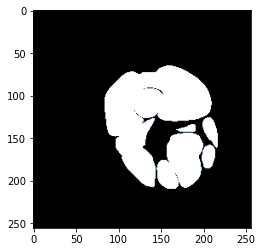

=== Slice 2 ===


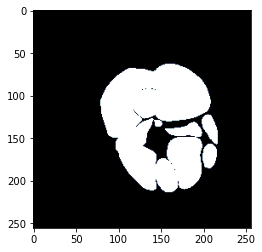

=== Slice 4 ===


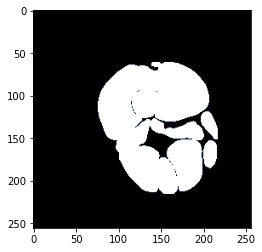

=== Slice 6 ===


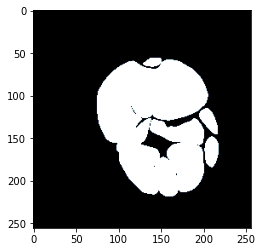

=== Slice 8 ===


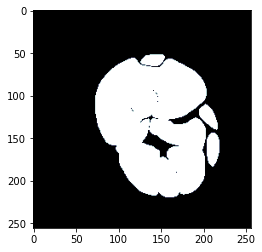

=== Slice 10 ===


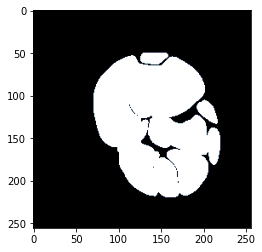

=== Slice 12 ===


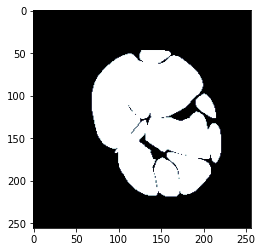

=== Slice 14 ===


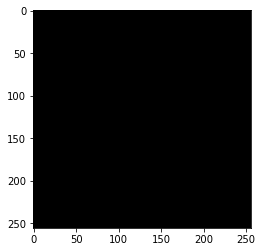

=== Slice 16 ===


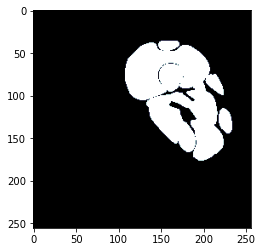

=== Slice 18 ===


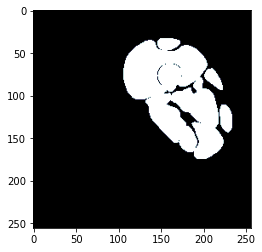

=== Slice 20 ===


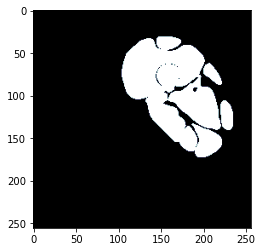

=== Slice 22 ===


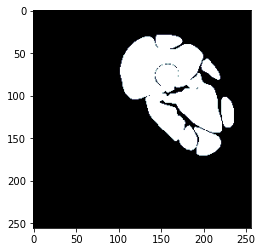

=== Slice 24 ===


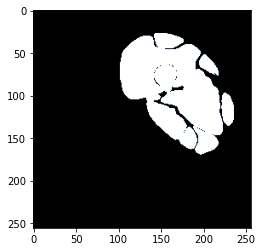

=== Slice 26 ===


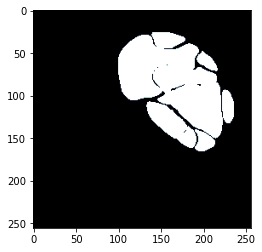

=== Slice 28 ===


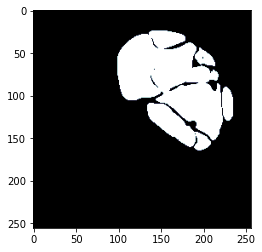

=== Slice 30 ===


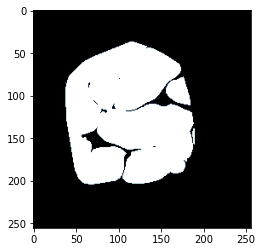

=== Slice 32 ===


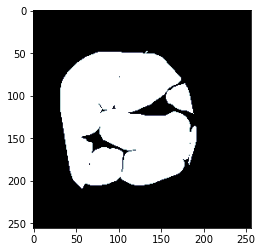

=== Slice 34 ===


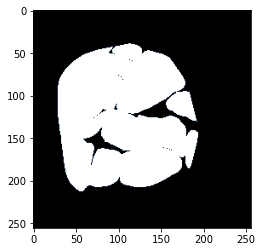

=== Slice 36 ===


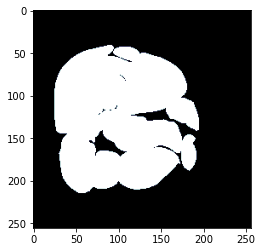

=== Slice 38 ===


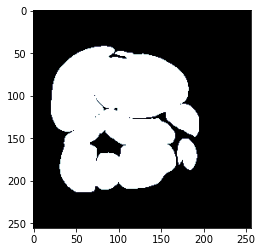

=== Slice 40 ===


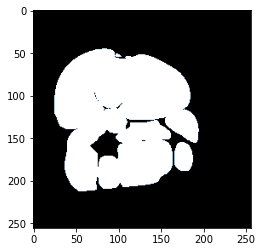

=== Slice 42 ===


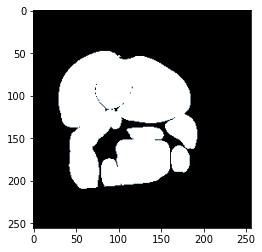

=== Slice 44 ===


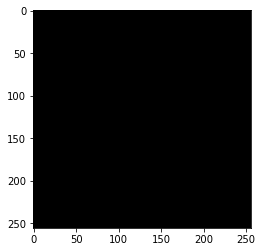

=== Slice 46 ===


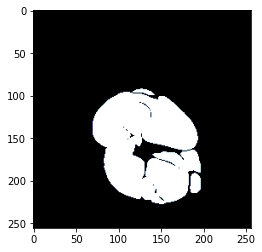

=== Slice 48 ===


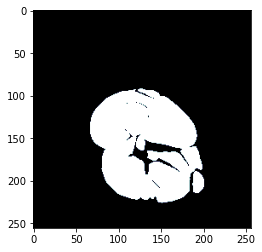

=== Slice 50 ===


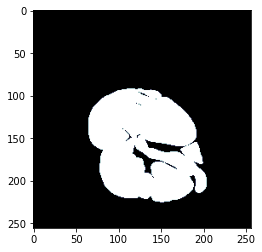

=== Slice 52 ===


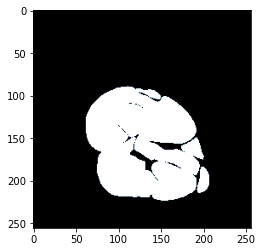

=== Slice 54 ===


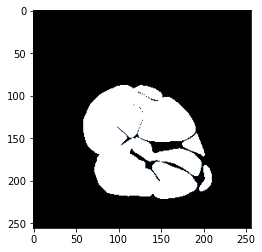

=== Slice 56 ===


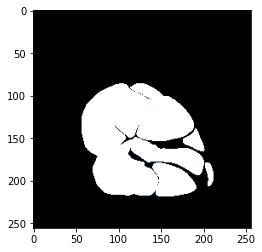

=== Slice 58 ===


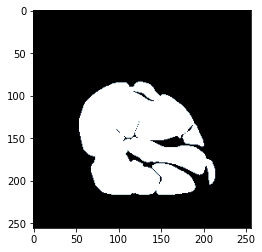

=== Slice 60 ===


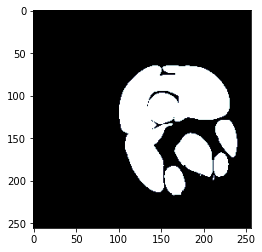

=== Slice 62 ===


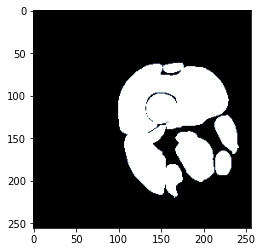

=== Slice 64 ===


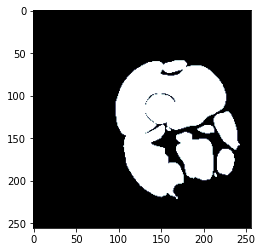

=== Slice 66 ===


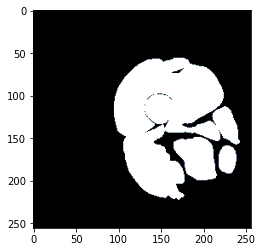

=== Slice 68 ===


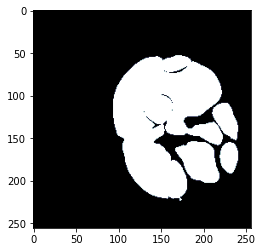

=== Slice 70 ===


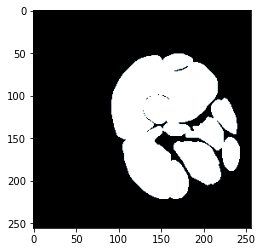

=== Slice 72 ===


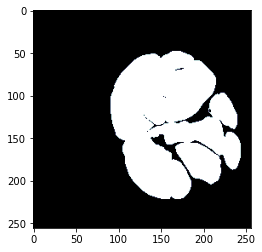

=== Slice 74 ===


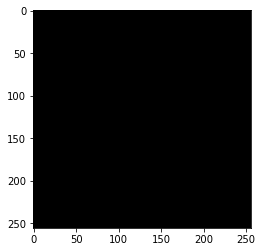

=== Slice 76 ===


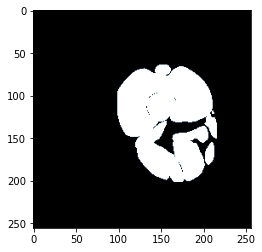

=== Slice 78 ===


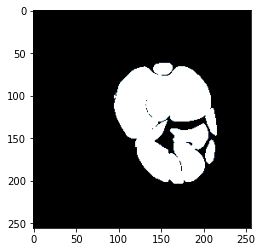

=== Slice 80 ===


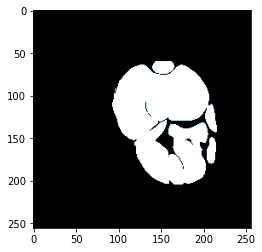

=== Slice 82 ===


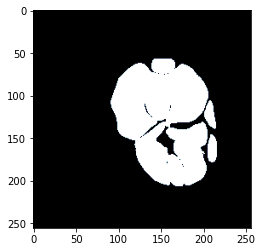

=== Slice 84 ===


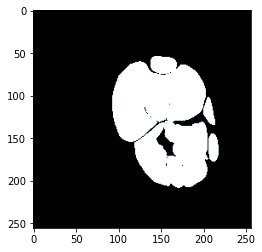

=== Slice 86 ===


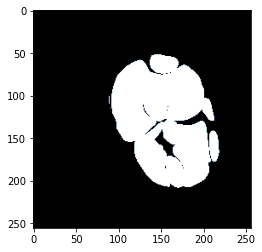

=== Slice 88 ===


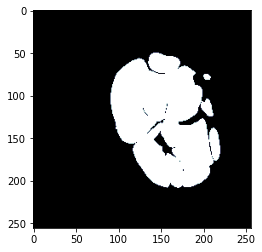

=== Slice 90 ===


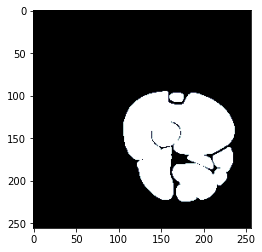

=== Slice 92 ===


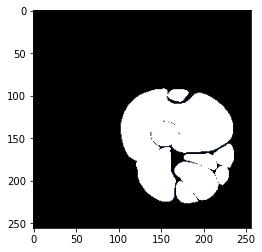

=== Slice 94 ===


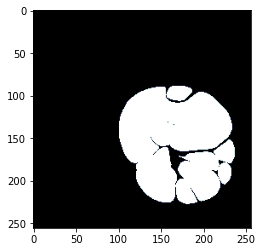

=== Slice 96 ===


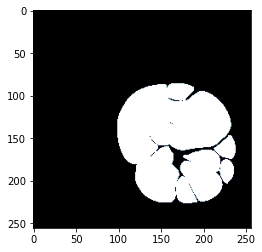

=== Slice 98 ===


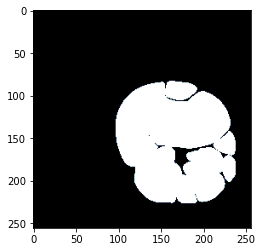

=== Slice 100 ===


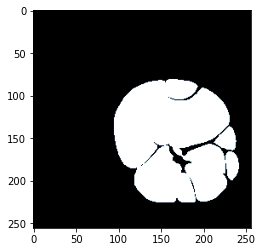

=== Slice 102 ===


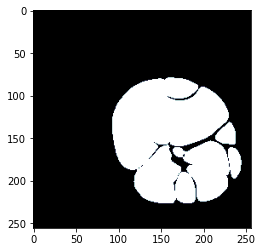

=== Slice 104 ===


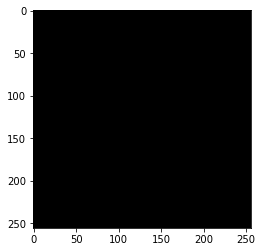

=== Slice 106 ===


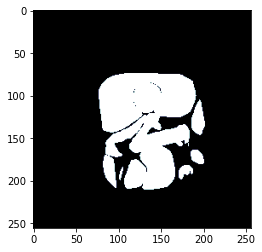

=== Slice 108 ===


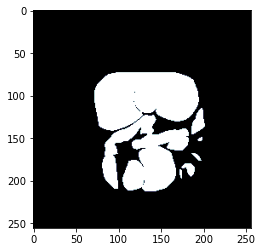

=== Slice 110 ===


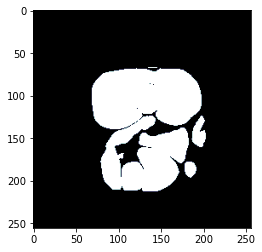

=== Slice 112 ===


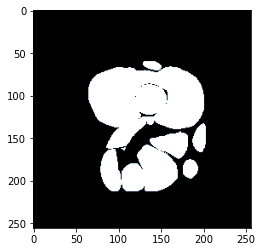

=== Slice 114 ===


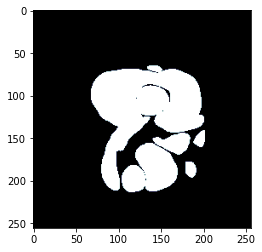

=== Slice 116 ===


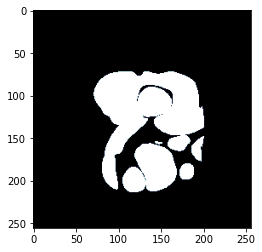

=== Slice 118 ===


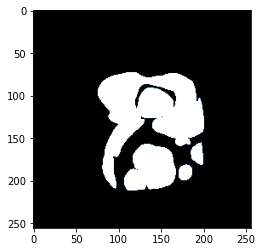

=== Slice 120 ===


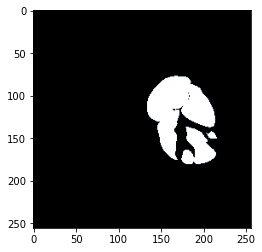

=== Slice 122 ===


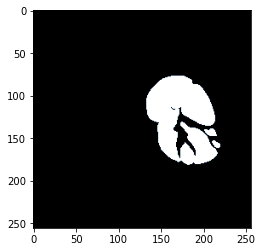

=== Slice 124 ===


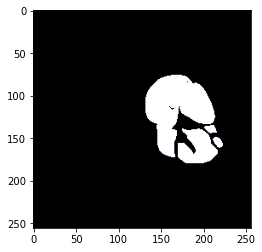

=== Slice 126 ===


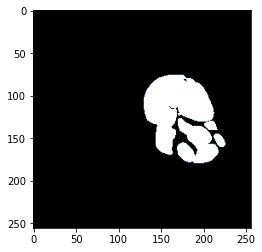

=== Slice 128 ===


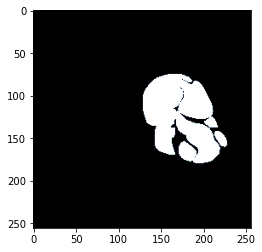

=== Slice 130 ===


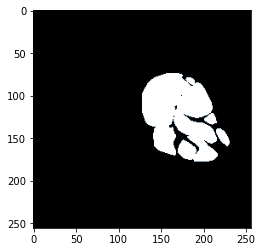

=== Slice 132 ===


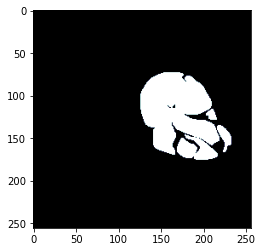

=== Slice 134 ===


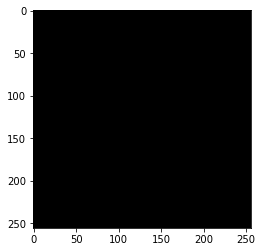

=== Slice 136 ===


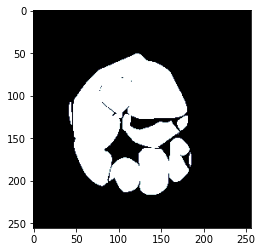

=== Slice 138 ===


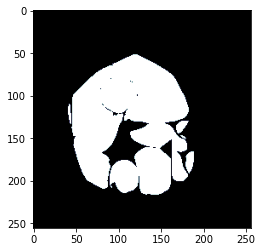

=== Slice 140 ===


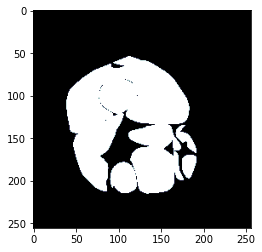

=== Slice 142 ===


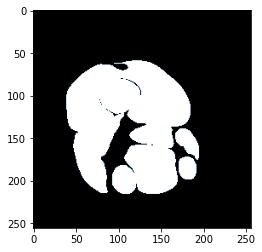

=== Slice 144 ===


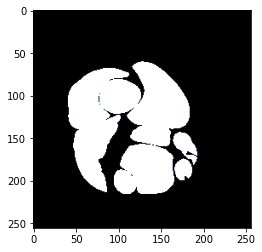

=== Slice 146 ===


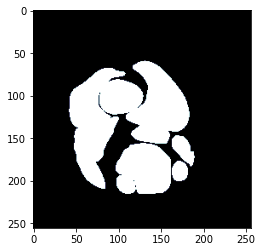

=== Slice 148 ===


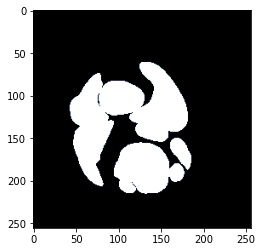

=== Slice 150 ===


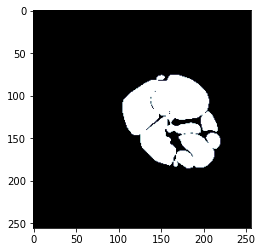

=== Slice 152 ===


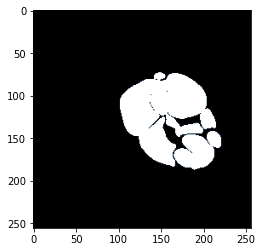

=== Slice 154 ===


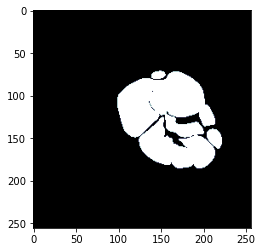

=== Slice 156 ===


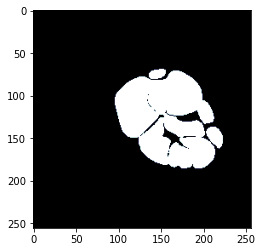

=== Slice 158 ===


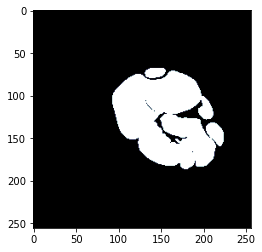

=== Slice 160 ===


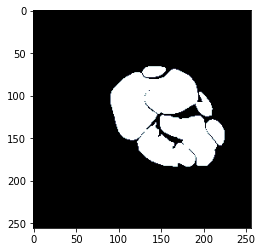

=== Slice 162 ===


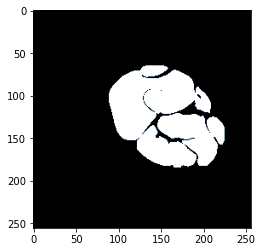

=== Slice 164 ===


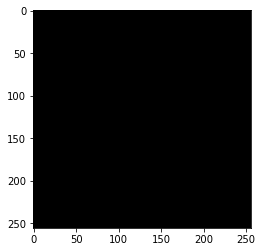

=== Slice 166 ===


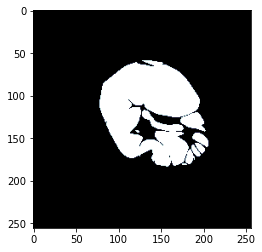

=== Slice 168 ===


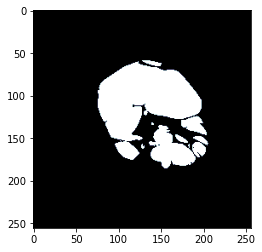

=== Slice 170 ===


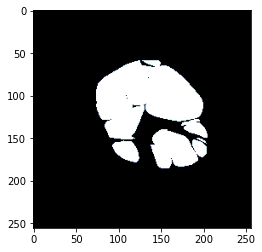

=== Slice 172 ===


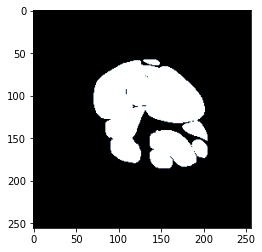

=== Slice 174 ===


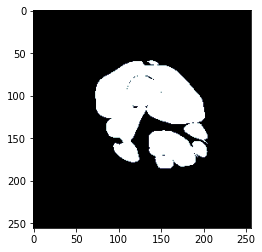

=== Slice 176 ===


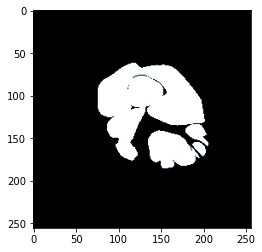

=== Slice 178 ===


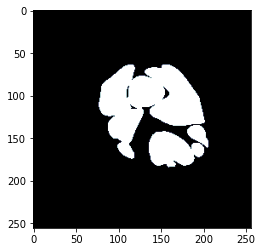

=== Slice 180 ===


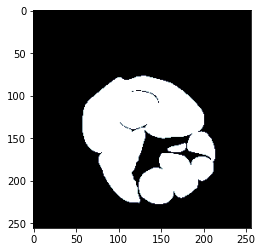

=== Slice 182 ===


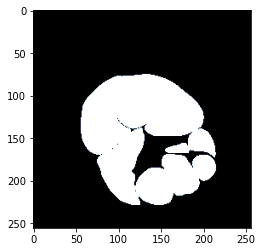

=== Slice 184 ===


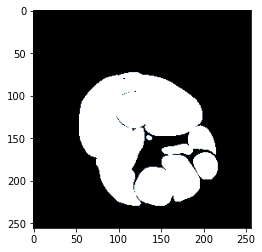

=== Slice 186 ===


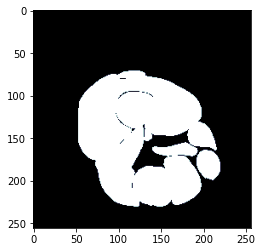

=== Slice 188 ===


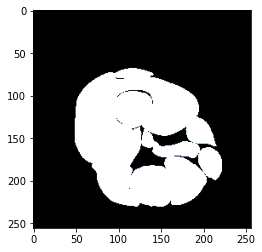

=== Slice 190 ===


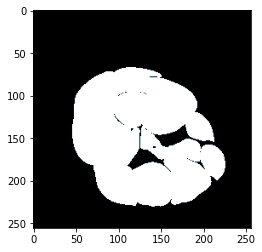

=== Slice 192 ===


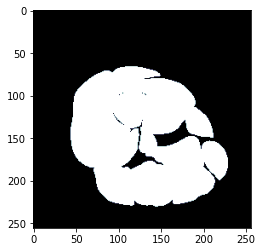

=== Slice 194 ===


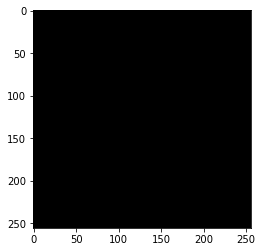

=== Slice 196 ===


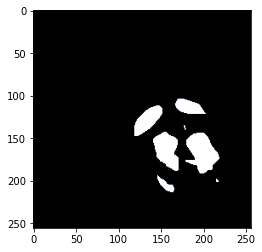

=== Slice 198 ===


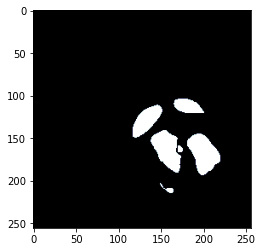

=== Slice 200 ===


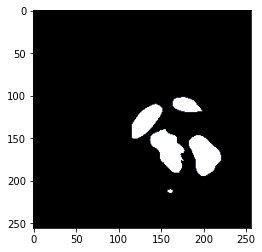

=== Slice 202 ===


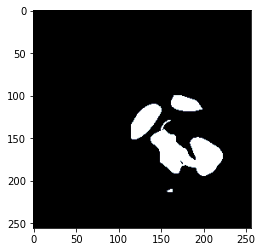

=== Slice 204 ===


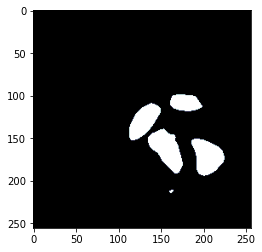

=== Slice 206 ===


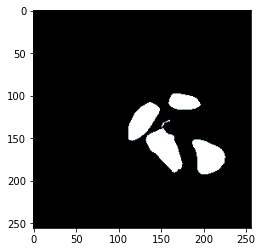

=== Slice 208 ===


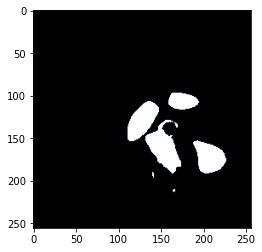

=== Slice 210 ===


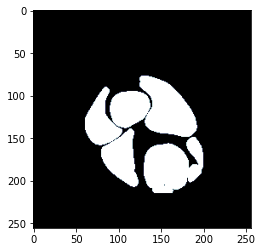

=== Slice 212 ===


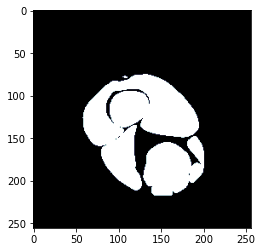

=== Slice 214 ===


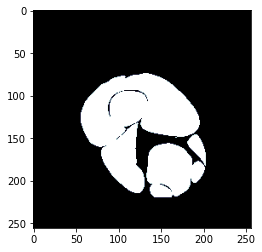

=== Slice 216 ===


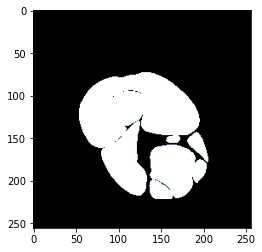

=== Slice 218 ===


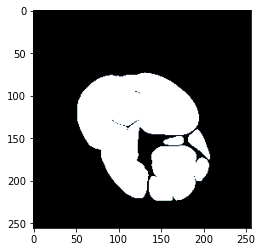

=== Slice 220 ===


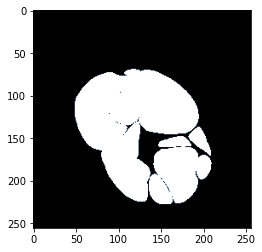

=== Slice 222 ===


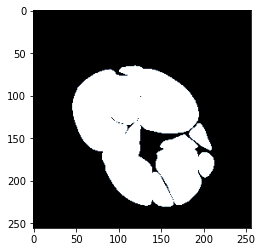

=== Slice 224 ===


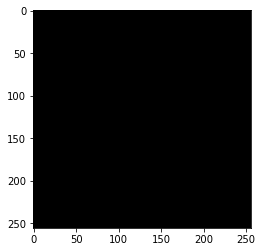

=== Slice 226 ===


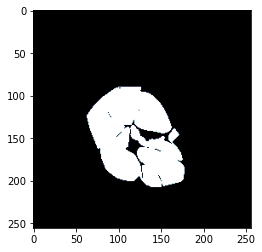

=== Slice 228 ===


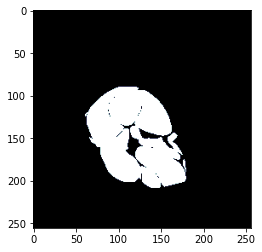

=== Slice 230 ===


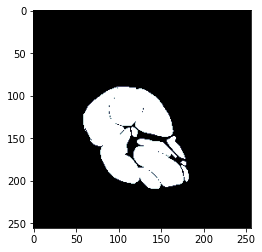

=== Slice 232 ===


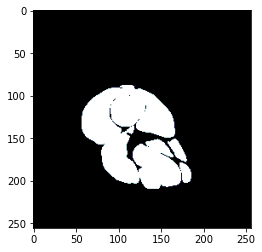

=== Slice 234 ===


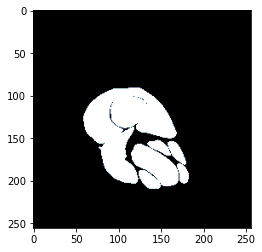

=== Slice 236 ===


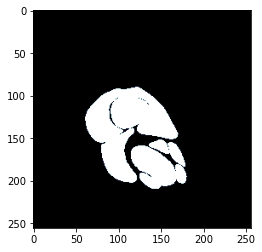

=== Slice 238 ===


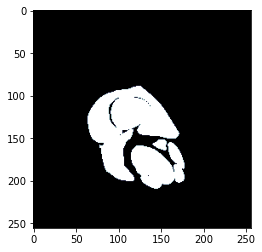

=== Slice 240 ===


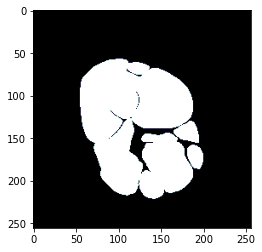

=== Slice 242 ===


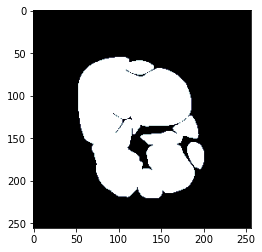

=== Slice 244 ===


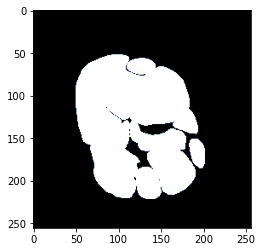

=== Slice 246 ===


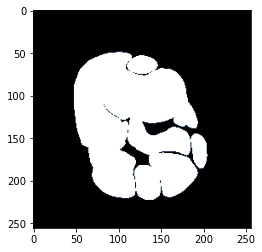

=== Slice 248 ===


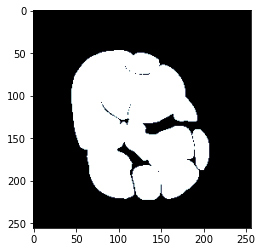

=== Slice 250 ===


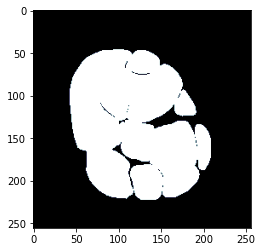

=== Slice 252 ===


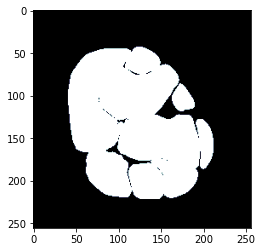

=== Slice 254 ===


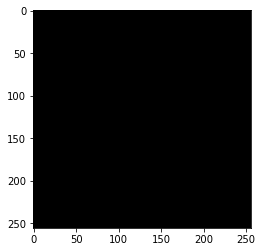

=== Slice 256 ===


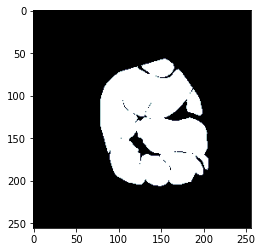

=== Slice 258 ===


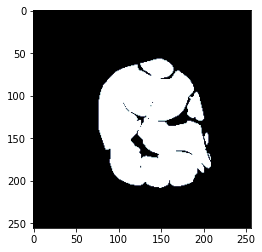

=== Slice 260 ===


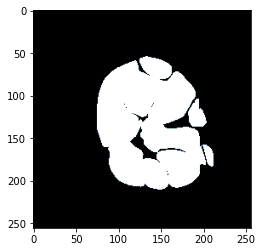

=== Slice 262 ===


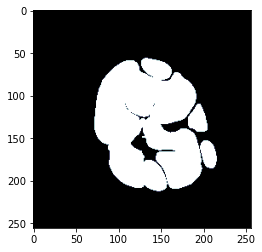

=== Slice 264 ===


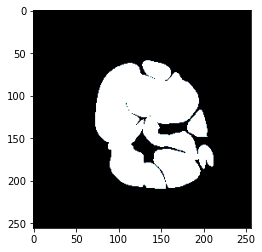

=== Slice 266 ===


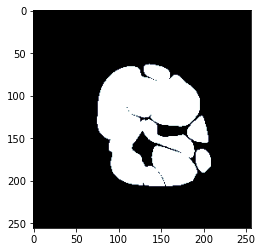

=== Slice 268 ===


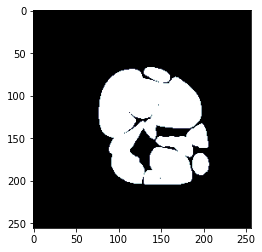

=== Slice 270 ===


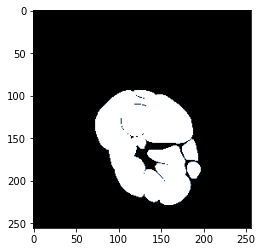

=== Slice 272 ===


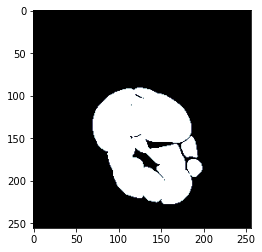

=== Slice 274 ===


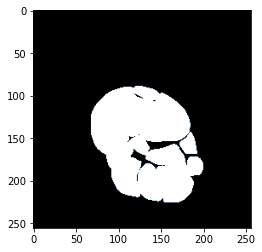

=== Slice 276 ===


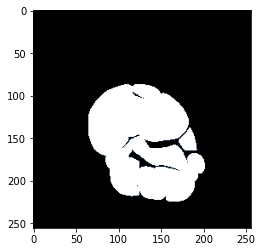

=== Slice 278 ===


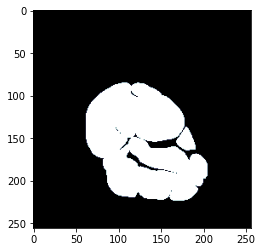

=== Slice 280 ===


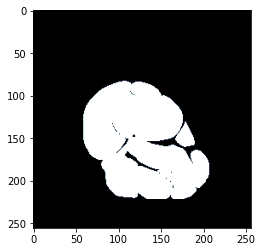

=== Slice 282 ===


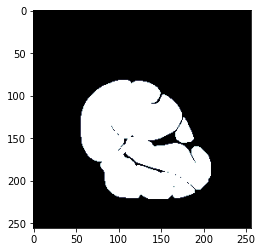

=== Slice 284 ===


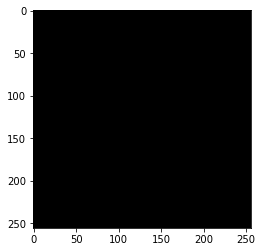

=== Slice 286 ===


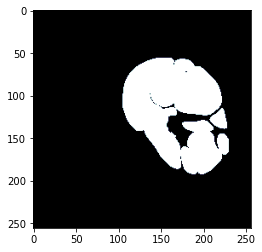

=== Slice 288 ===


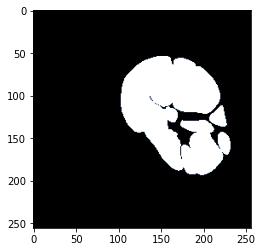

=== Slice 290 ===


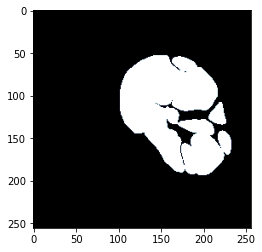

=== Slice 292 ===


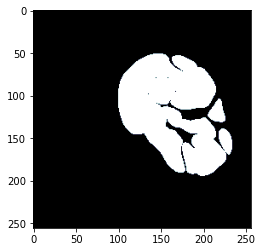

=== Slice 294 ===


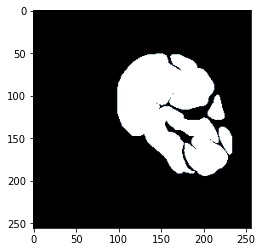

=== Slice 296 ===


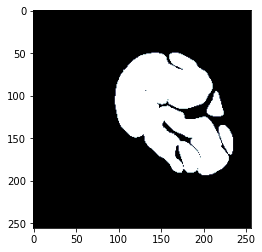

=== Slice 298 ===


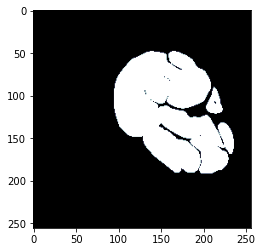

=== Slice 300 ===


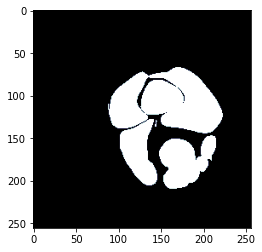

=== Slice 302 ===


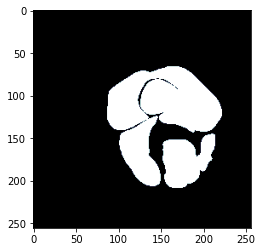

=== Slice 304 ===


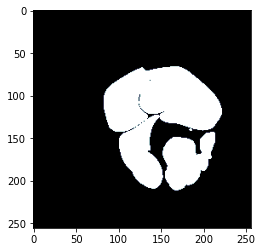

=== Slice 306 ===


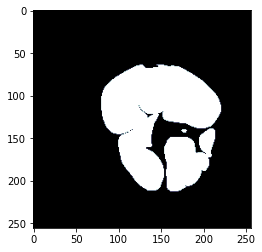

=== Slice 308 ===


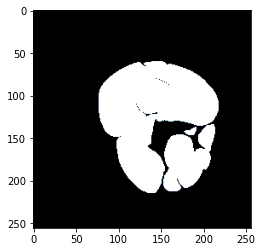

=== Slice 310 ===


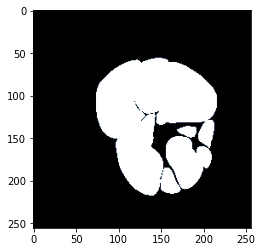

=== Slice 312 ===


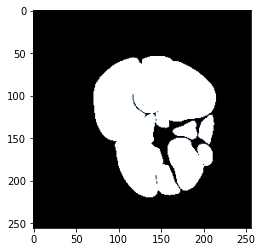

=== Slice 314 ===


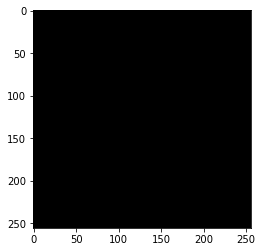

=== Slice 316 ===


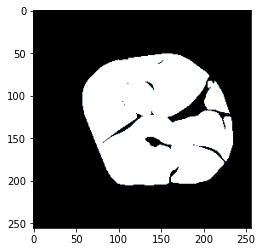

=== Slice 318 ===


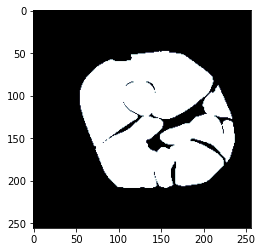

=== Slice 320 ===


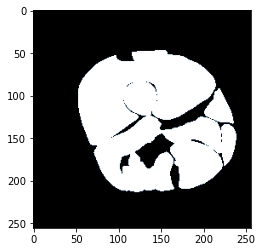

=== Slice 322 ===


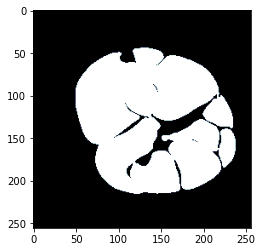

=== Slice 324 ===


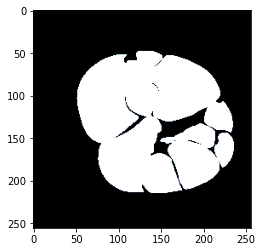

=== Slice 326 ===


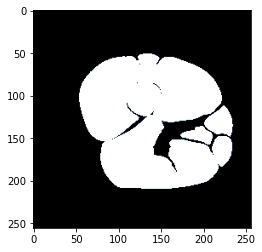

=== Slice 328 ===


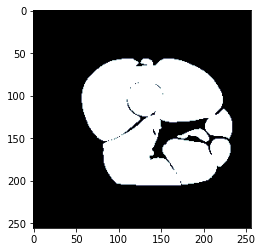

=== Slice 330 ===


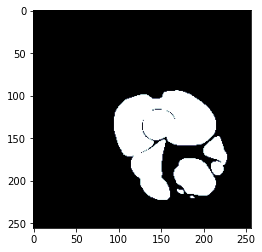

=== Slice 332 ===


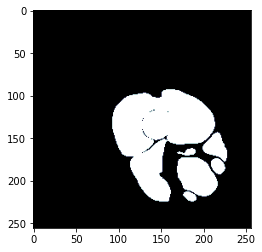

=== Slice 334 ===


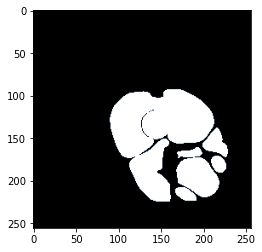

=== Slice 336 ===


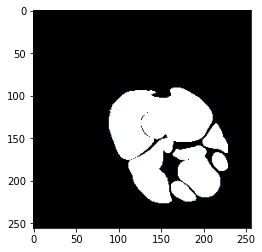

=== Slice 338 ===


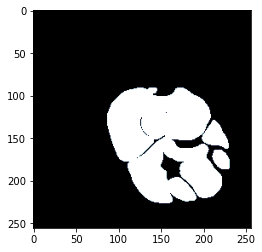

=== Slice 340 ===


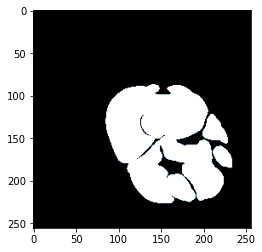

=== Slice 342 ===


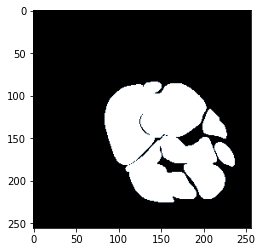

=== Slice 344 ===


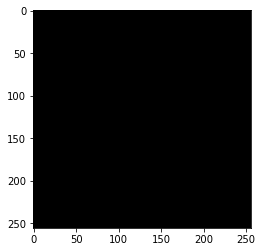

=== Slice 346 ===


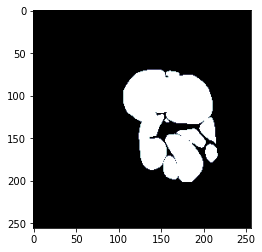

=== Slice 348 ===


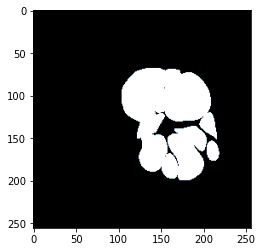

=== Slice 350 ===


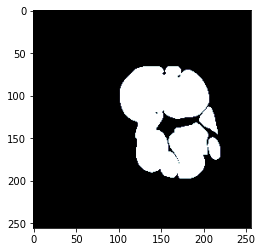

=== Slice 352 ===


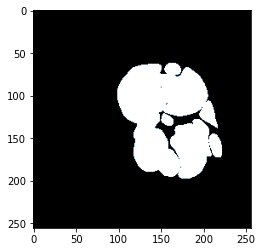

=== Slice 354 ===


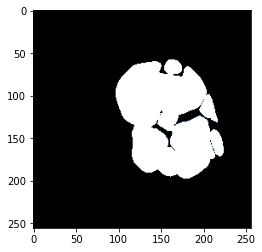

=== Slice 356 ===


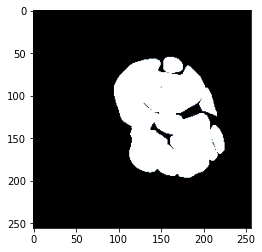

=== Slice 358 ===


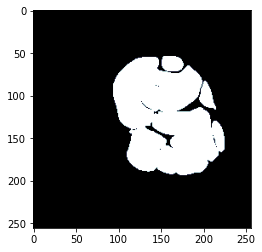

=== Slice 360 ===


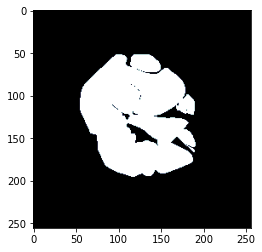

=== Slice 362 ===


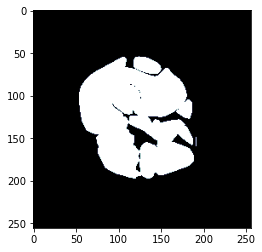

=== Slice 364 ===


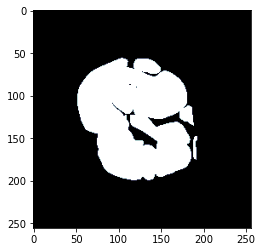

=== Slice 366 ===


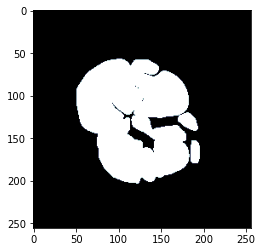

=== Slice 368 ===


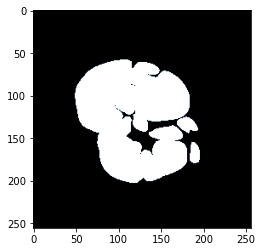

=== Slice 370 ===


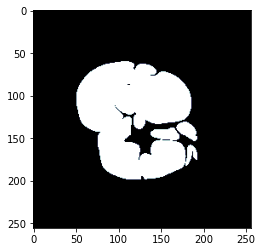

=== Slice 372 ===


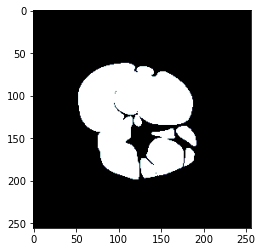

=== Slice 374 ===


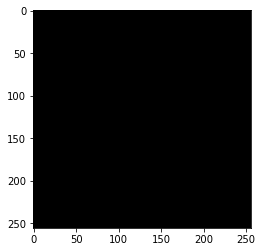

=== Slice 376 ===


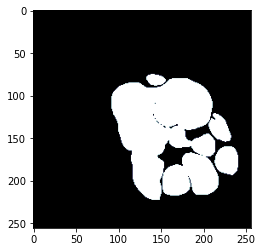

=== Slice 378 ===


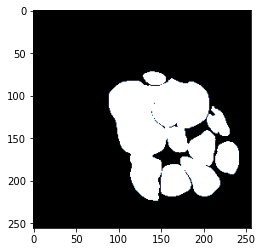

=== Slice 380 ===


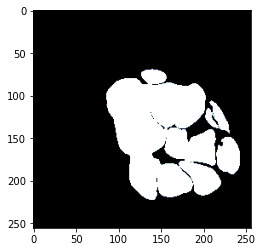

=== Slice 382 ===


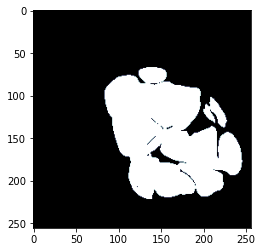

=== Slice 384 ===


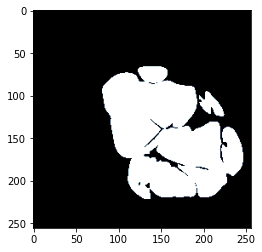

=== Slice 386 ===


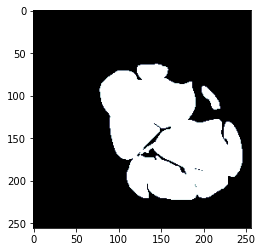

=== Slice 388 ===


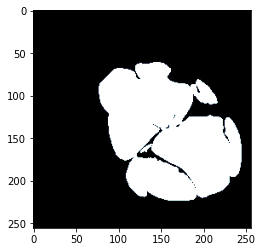

=== Slice 390 ===


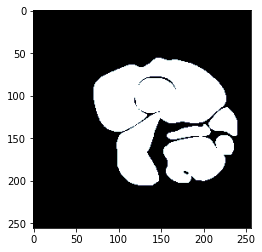

=== Slice 392 ===


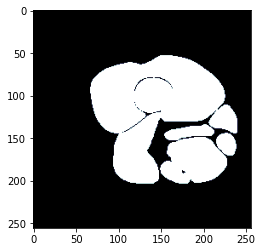

=== Slice 394 ===


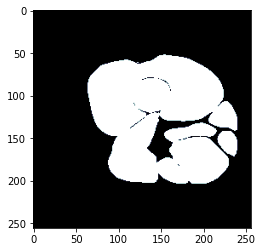

=== Slice 396 ===


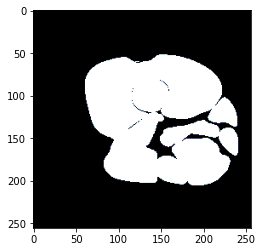

=== Slice 398 ===


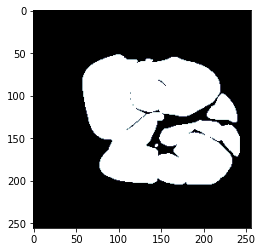

=== Slice 400 ===


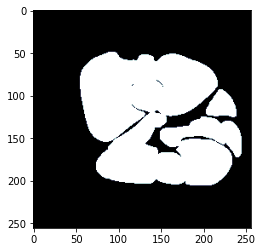

=== Slice 402 ===


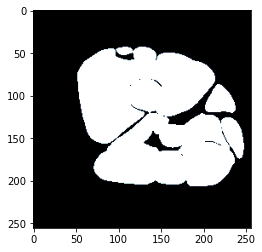

=== Slice 404 ===


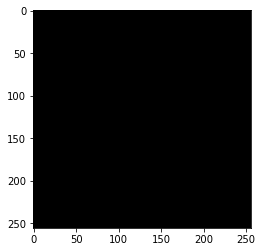

=== Slice 406 ===


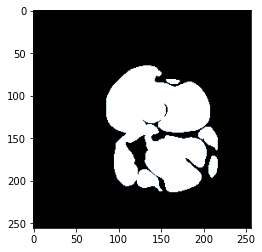

=== Slice 408 ===


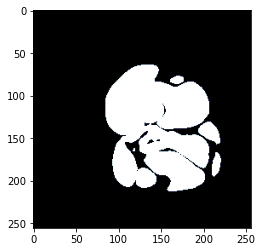

=== Slice 410 ===


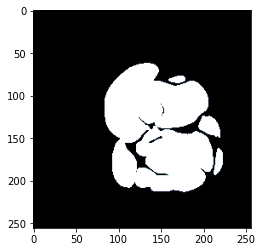

=== Slice 412 ===


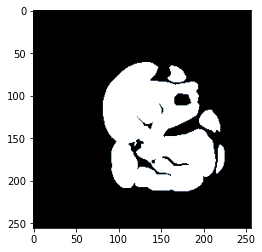

=== Slice 414 ===


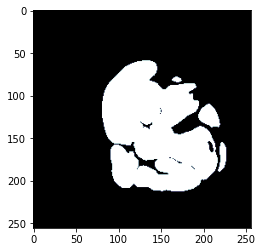

=== Slice 416 ===


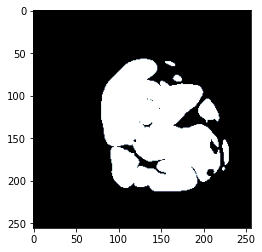

=== Slice 418 ===


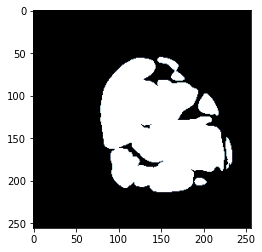

=== Slice 420 ===


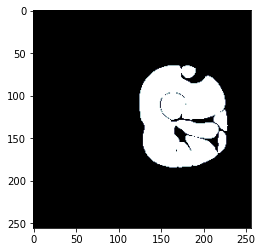

=== Slice 422 ===


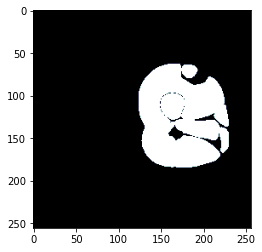

=== Slice 424 ===


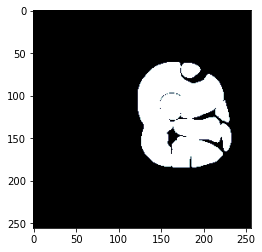

=== Slice 426 ===


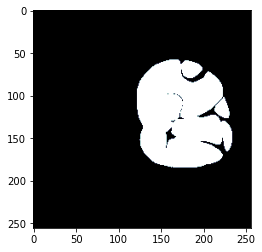

=== Slice 428 ===


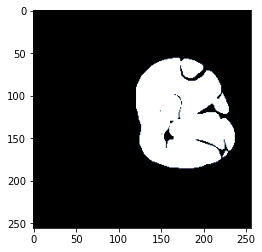

=== Slice 430 ===


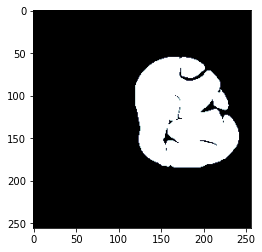

=== Slice 432 ===


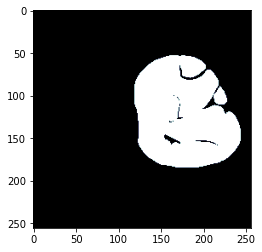

=== Slice 434 ===


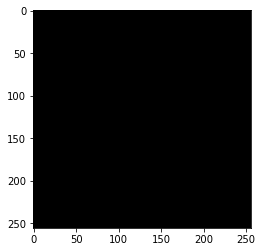

=== Slice 436 ===


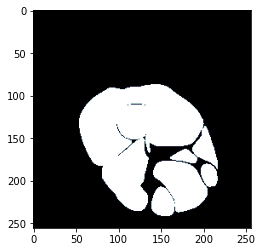

=== Slice 438 ===


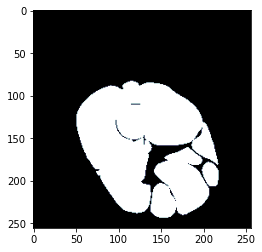

=== Slice 440 ===


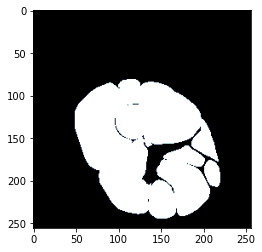

=== Slice 442 ===


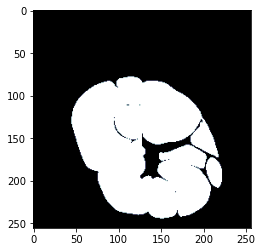

=== Slice 444 ===


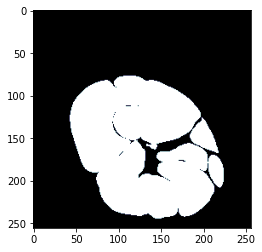

=== Slice 446 ===


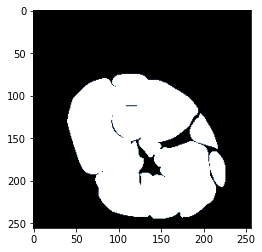

=== Slice 448 ===


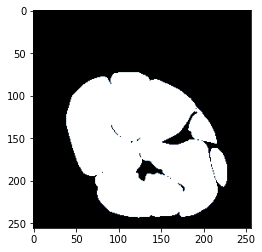

=== Slice 450 ===


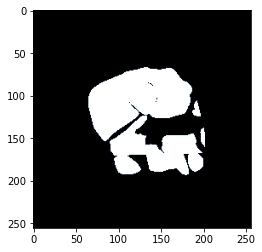

=== Slice 452 ===


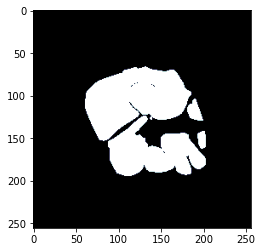

=== Slice 454 ===


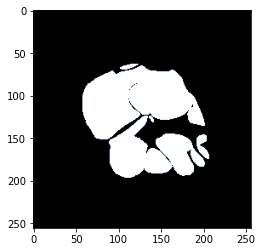

=== Slice 456 ===


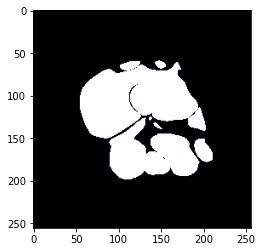

=== Slice 458 ===


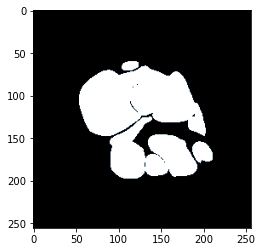

=== Slice 460 ===


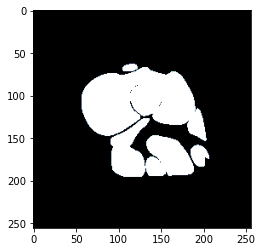

=== Slice 462 ===


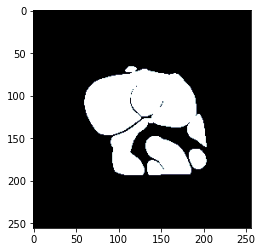

=== Slice 464 ===


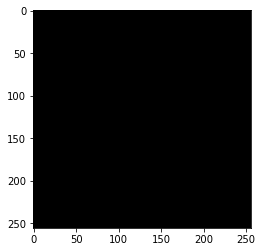

=== Slice 466 ===


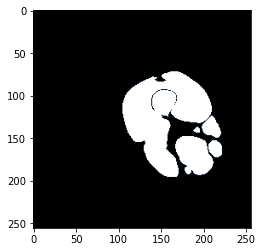

=== Slice 468 ===


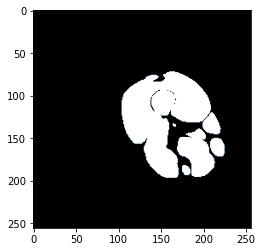

=== Slice 470 ===


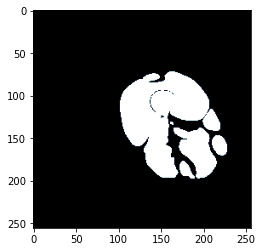

=== Slice 472 ===


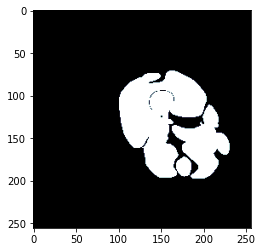

=== Slice 474 ===


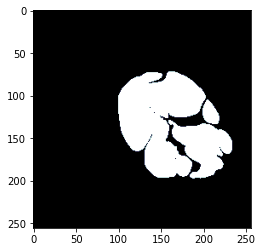

=== Slice 476 ===


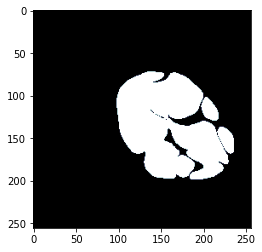

=== Slice 478 ===


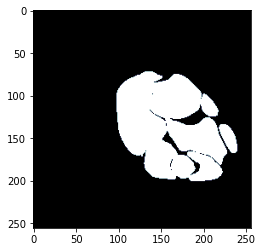

=== Slice 480 ===


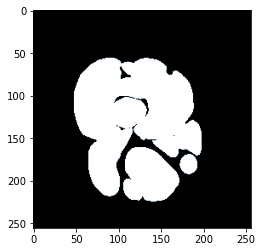

=== Slice 482 ===


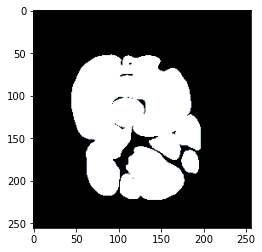

=== Slice 484 ===


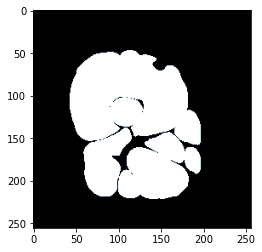

=== Slice 486 ===


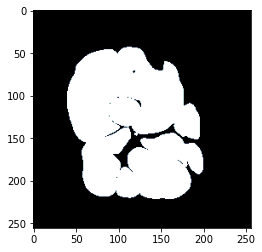

=== Slice 488 ===


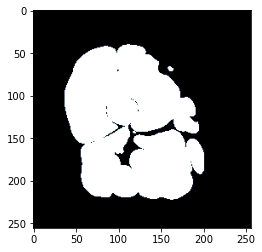

=== Slice 490 ===


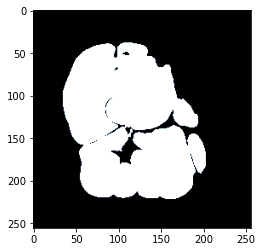

=== Slice 492 ===


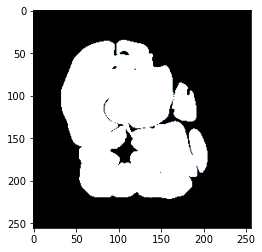

=== Slice 494 ===


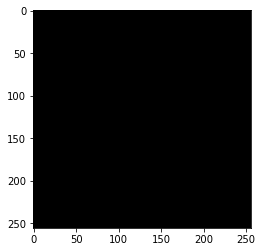

=== Slice 496 ===


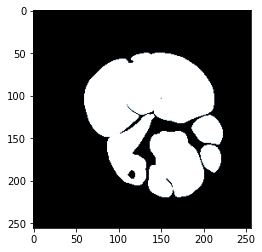

=== Slice 498 ===


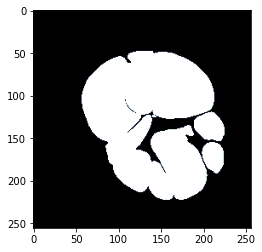

=== Slice 500 ===


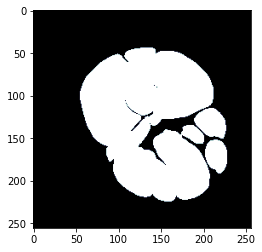

=== Slice 502 ===


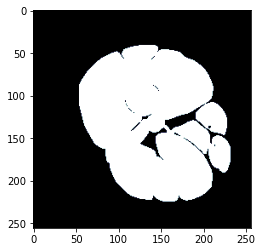

=== Slice 504 ===


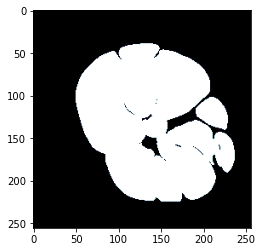

=== Slice 506 ===


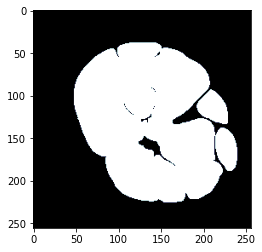

=== Slice 508 ===


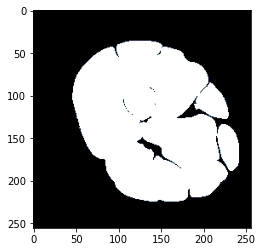

=== Slice 510 ===


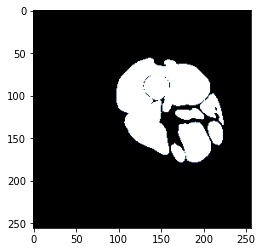

=== Slice 512 ===


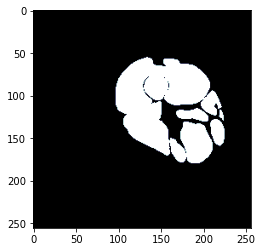

=== Slice 514 ===


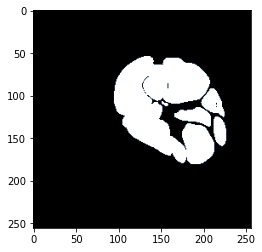

=== Slice 516 ===


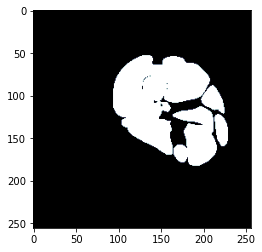

=== Slice 518 ===


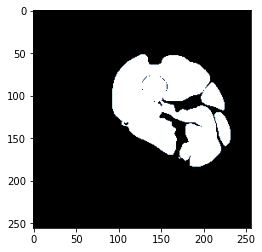

=== Slice 520 ===


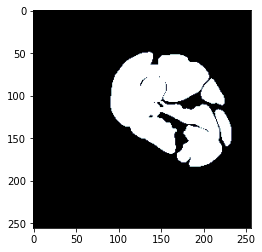

=== Slice 522 ===


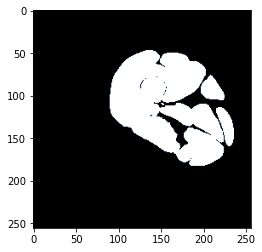

=== Slice 524 ===


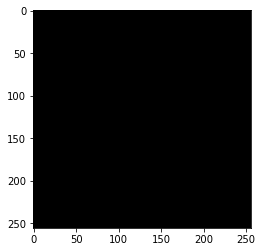

=== Slice 526 ===


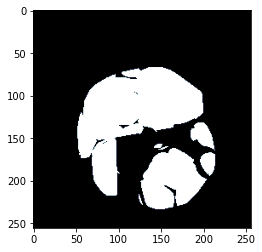

=== Slice 528 ===


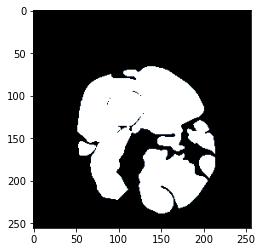

=== Slice 530 ===


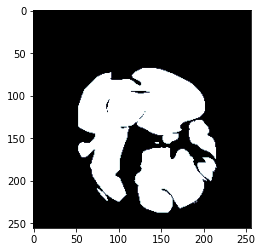

=== Slice 532 ===


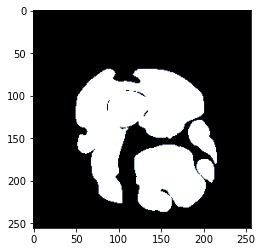

=== Slice 534 ===


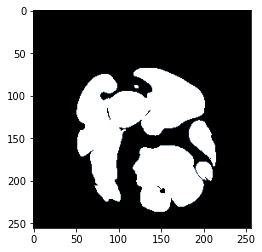

=== Slice 536 ===


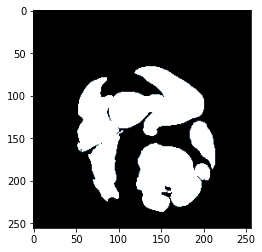

=== Slice 538 ===


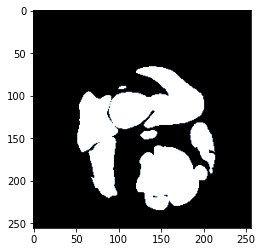

=== Slice 540 ===


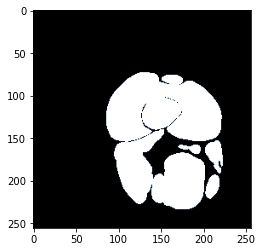

=== Slice 542 ===


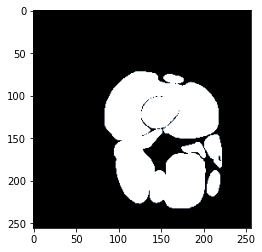

=== Slice 544 ===


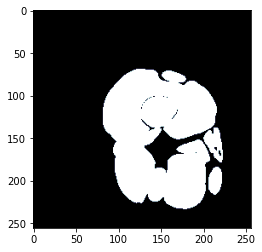

=== Slice 546 ===


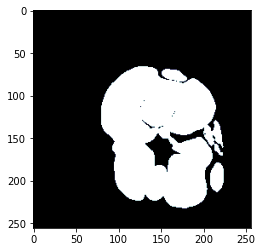

=== Slice 548 ===


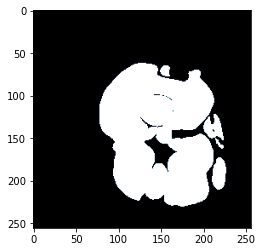

=== Slice 550 ===


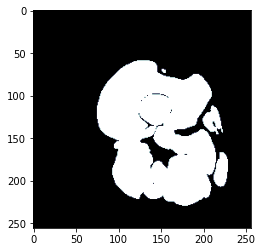

=== Slice 552 ===


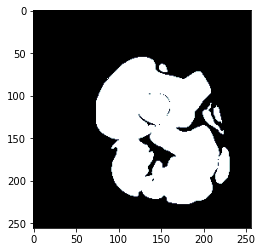

=== Slice 554 ===


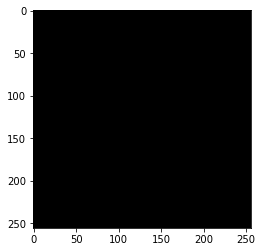

=== Slice 556 ===


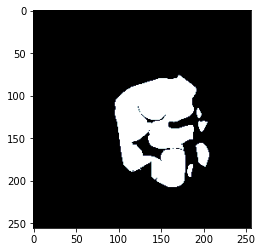

=== Slice 558 ===


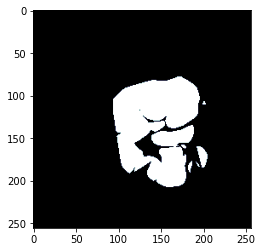

=== Slice 560 ===


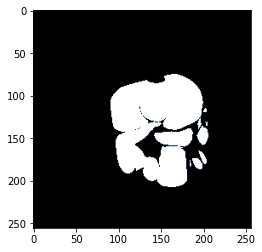

=== Slice 562 ===


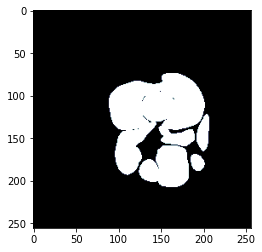

=== Slice 564 ===


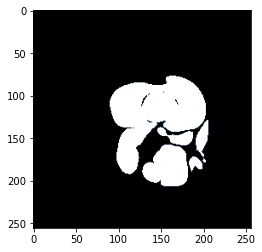

=== Slice 566 ===


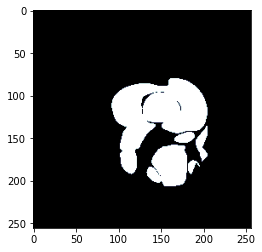

=== Slice 568 ===


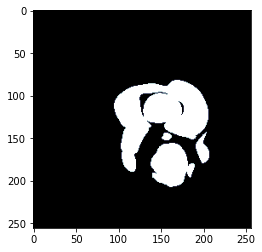

=== Slice 570 ===


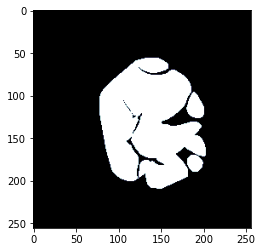

=== Slice 572 ===


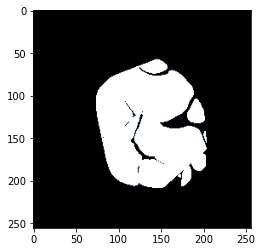

=== Slice 574 ===


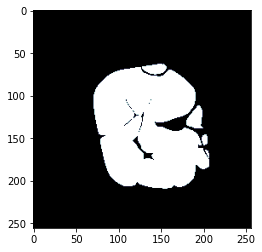

=== Slice 576 ===


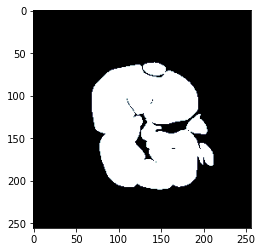

=== Slice 578 ===


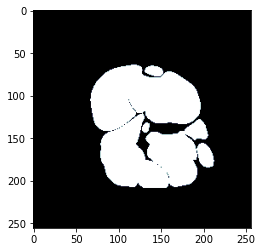

=== Slice 580 ===


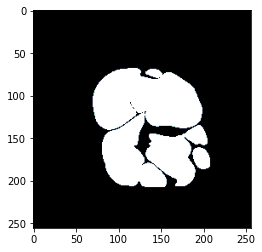

=== Slice 582 ===


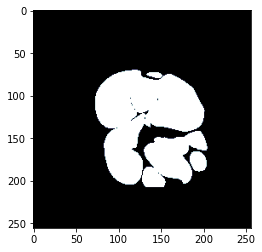

=== Slice 584 ===


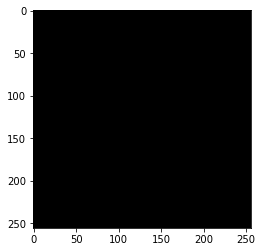

=== Slice 586 ===


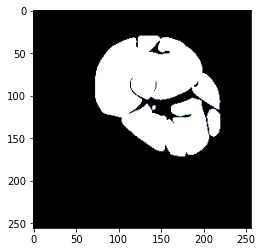

=== Slice 588 ===


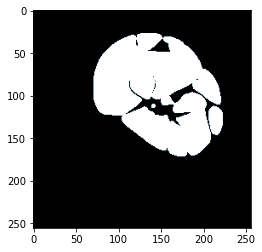

=== Slice 590 ===


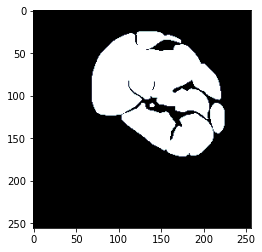

=== Slice 592 ===


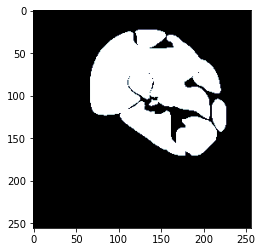

=== Slice 594 ===


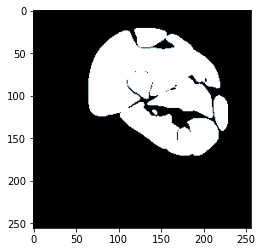

=== Slice 596 ===


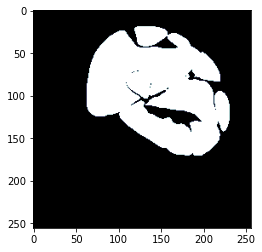

=== Slice 598 ===


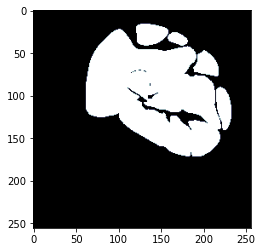

=== Slice 600 ===


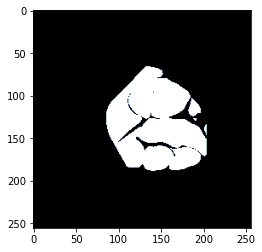

=== Slice 602 ===


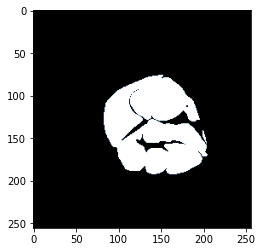

=== Slice 604 ===


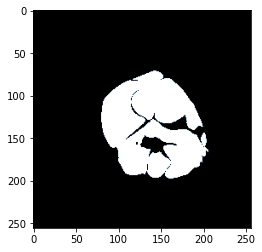

=== Slice 606 ===


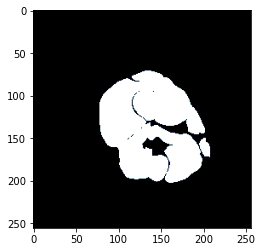

=== Slice 608 ===


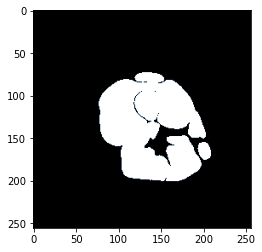

=== Slice 610 ===


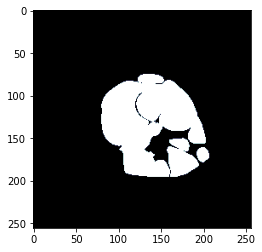

=== Slice 612 ===


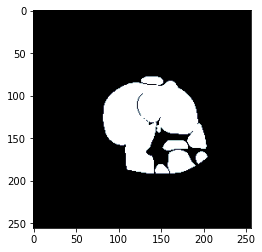

=== Slice 614 ===


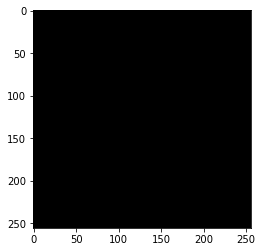

=== Slice 616 ===


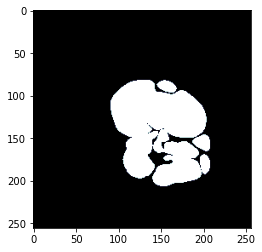

=== Slice 618 ===


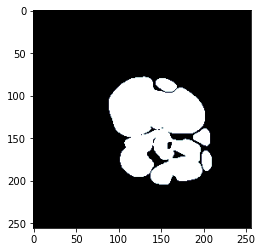

=== Slice 620 ===


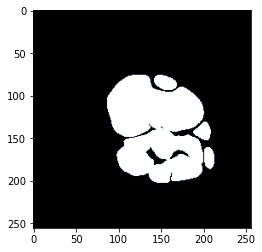

=== Slice 622 ===


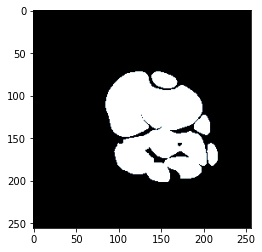

=== Slice 624 ===


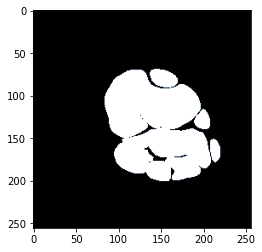

=== Slice 626 ===


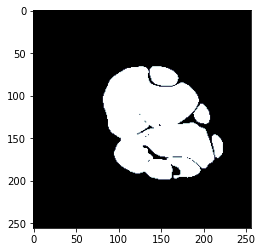

=== Slice 628 ===


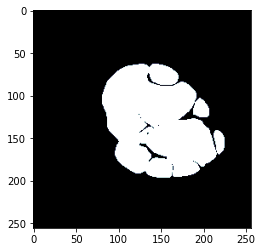

=== Slice 630 ===


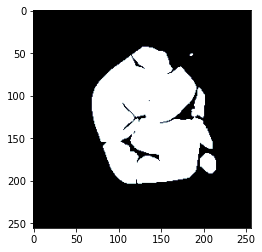

=== Slice 632 ===


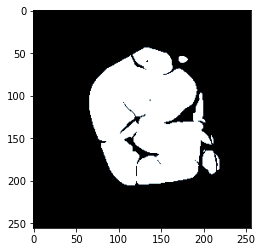

=== Slice 634 ===


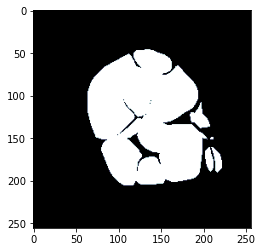

=== Slice 636 ===


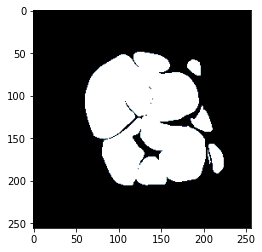

=== Slice 638 ===


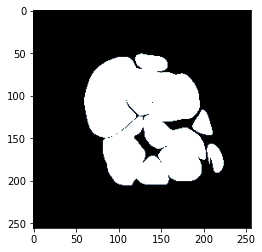

=== Slice 640 ===


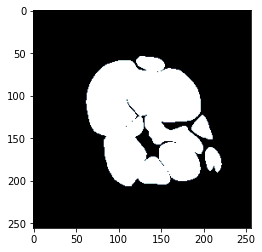

=== Slice 642 ===


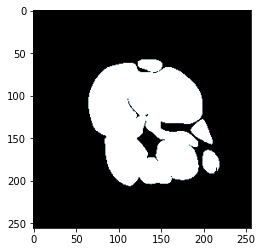

=== Slice 644 ===


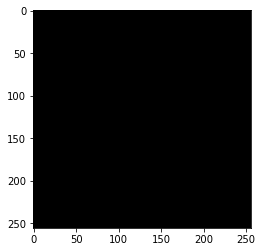

=== Slice 646 ===


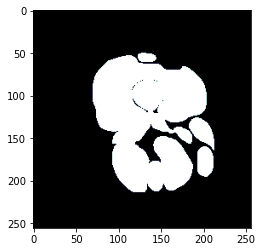

=== Slice 648 ===


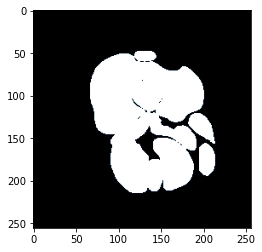

=== Slice 650 ===


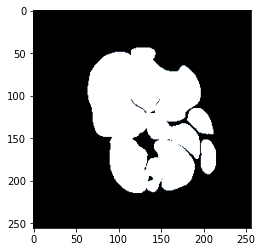

=== Slice 652 ===


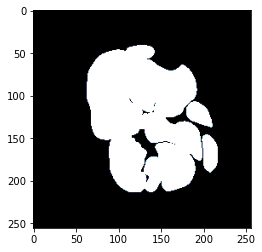

=== Slice 654 ===


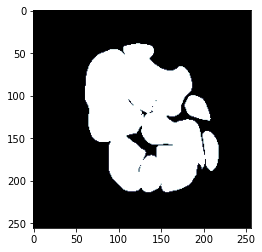

=== Slice 656 ===


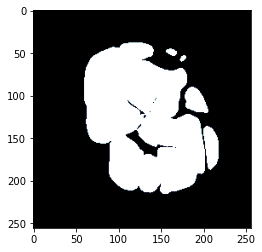

=== Slice 658 ===


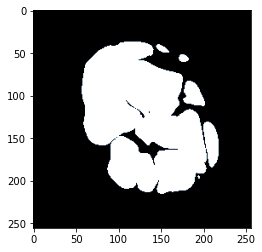

=== Slice 660 ===


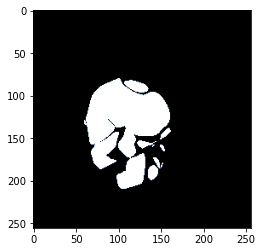

=== Slice 662 ===


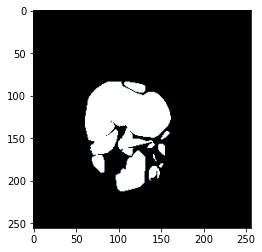

=== Slice 664 ===


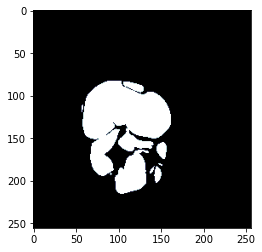

=== Slice 666 ===


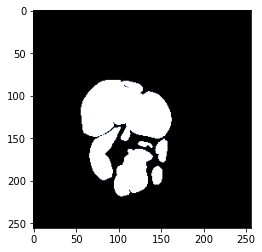

=== Slice 668 ===


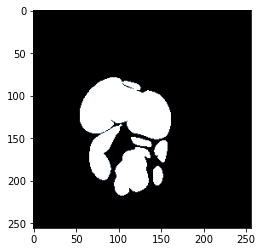

=== Slice 670 ===


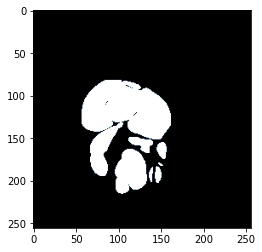

=== Slice 672 ===


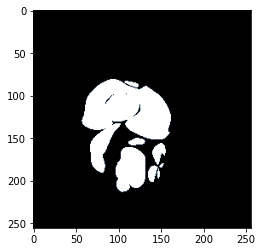

=== Slice 674 ===


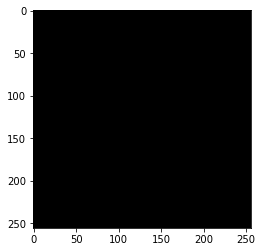

=== Slice 676 ===


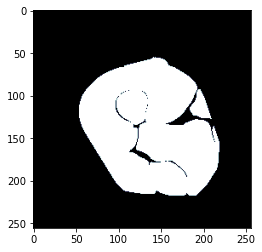

=== Slice 678 ===


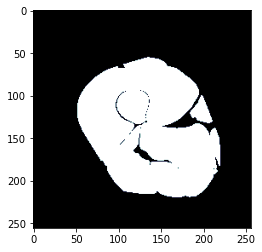

=== Slice 680 ===


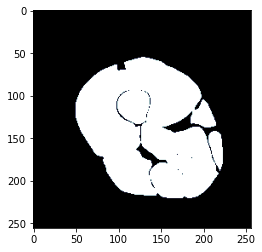

=== Slice 682 ===


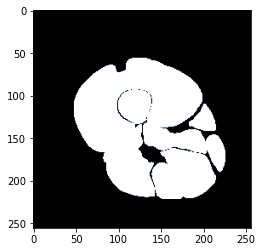

=== Slice 684 ===


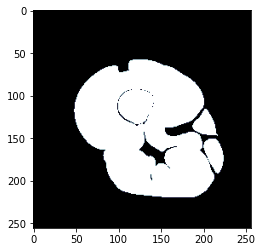

=== Slice 686 ===


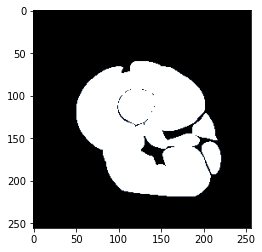

=== Slice 688 ===


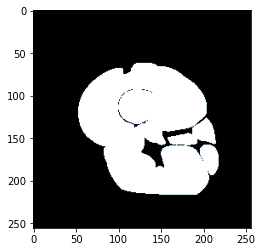

=== Slice 690 ===


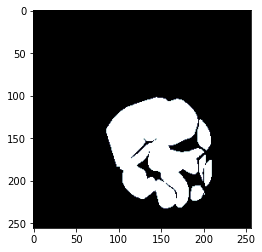

=== Slice 692 ===


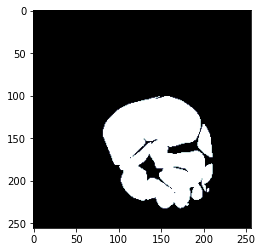

=== Slice 694 ===


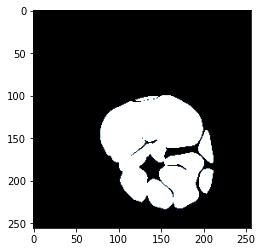

=== Slice 696 ===


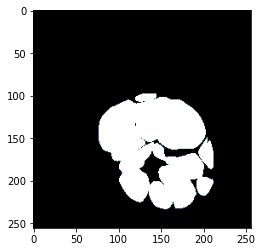

=== Slice 698 ===


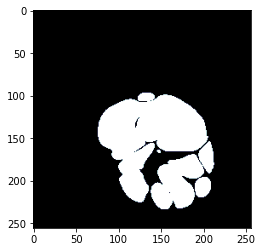

=== Slice 700 ===


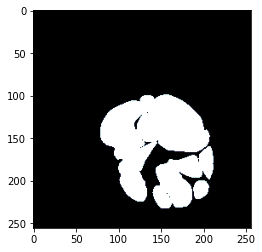

=== Slice 702 ===


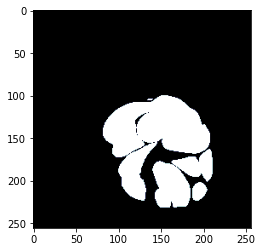

=== Slice 704 ===


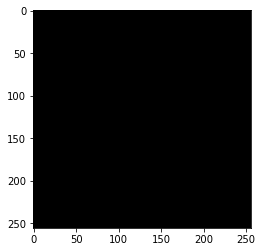

=== Slice 706 ===


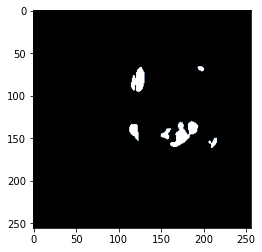

=== Slice 708 ===


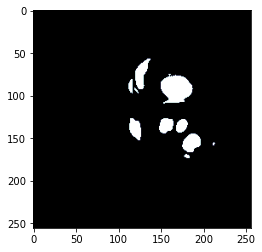

=== Slice 710 ===


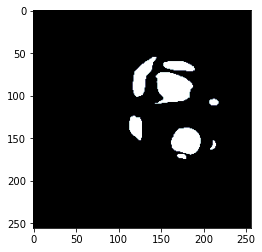

=== Slice 712 ===


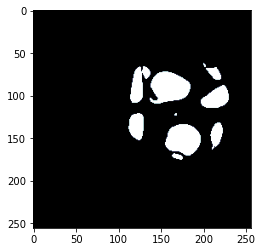

=== Slice 714 ===


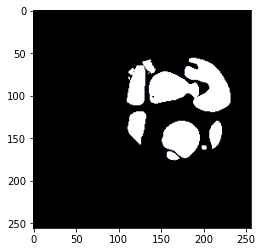

=== Slice 716 ===


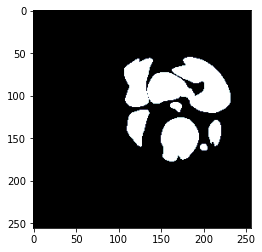

=== Slice 718 ===


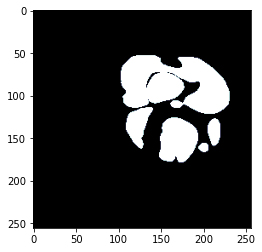

=== Slice 720 ===


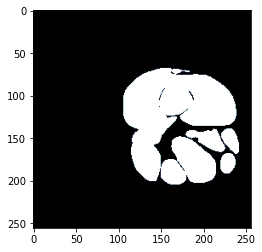

=== Slice 722 ===


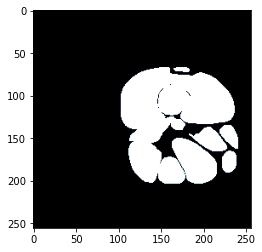

=== Slice 724 ===


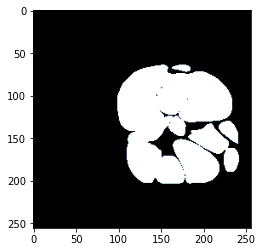

=== Slice 726 ===


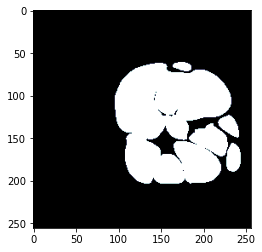

=== Slice 728 ===


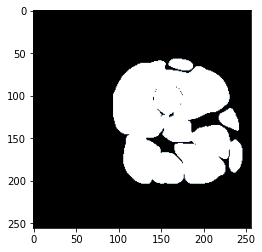

=== Slice 730 ===


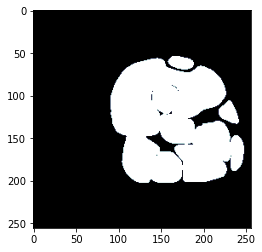

=== Slice 732 ===


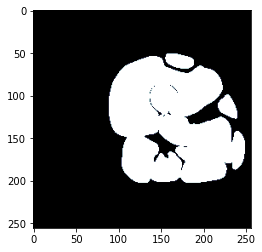

=== Slice 734 ===


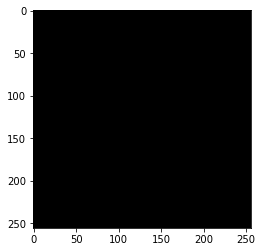

=== Slice 736 ===


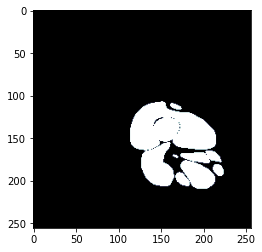

=== Slice 738 ===


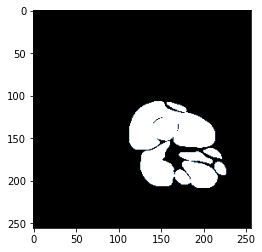

=== Slice 740 ===


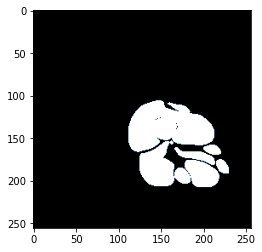

=== Slice 742 ===


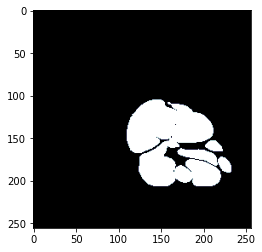

=== Slice 744 ===


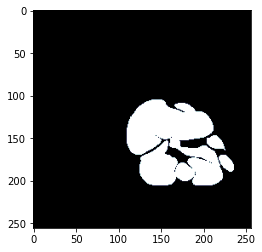

=== Slice 746 ===


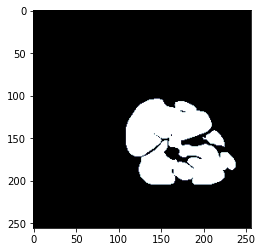

=== Slice 748 ===


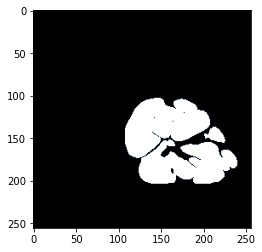

=== Slice 750 ===


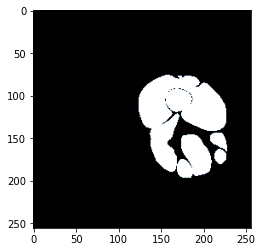

=== Slice 752 ===


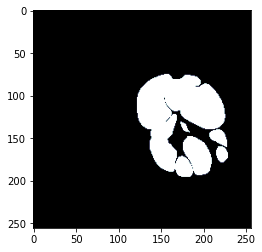

=== Slice 754 ===


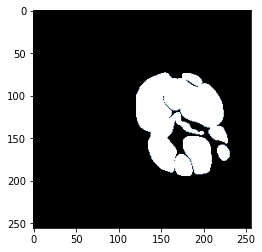

=== Slice 756 ===


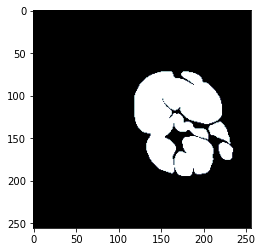

=== Slice 758 ===


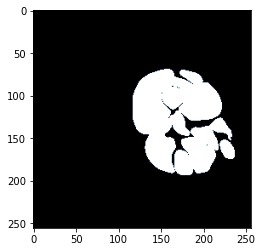

=== Slice 760 ===


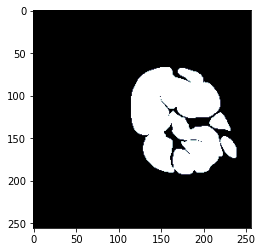

=== Slice 762 ===


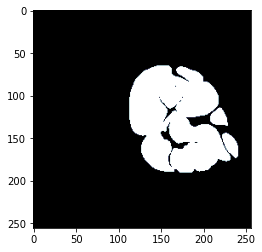

=== Slice 764 ===


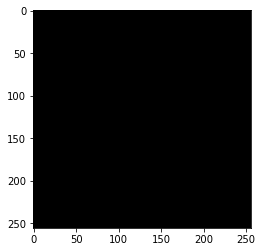

=== Slice 766 ===


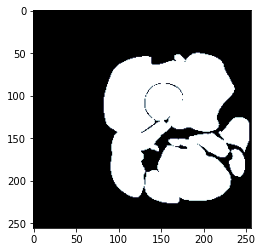

=== Slice 768 ===


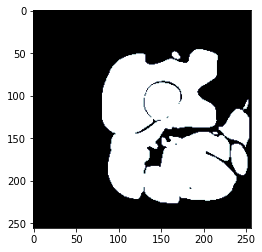

=== Slice 770 ===


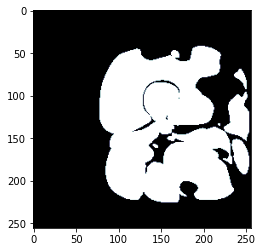

=== Slice 772 ===


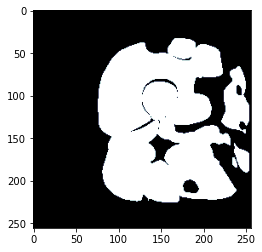

=== Slice 774 ===


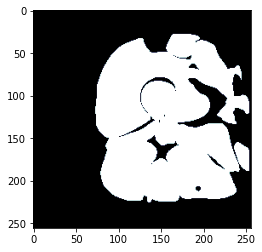

=== Slice 776 ===


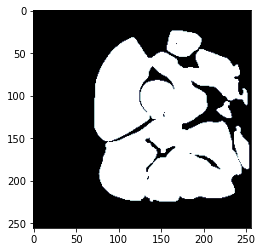

=== Slice 778 ===


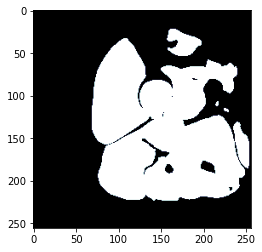

=== Slice 780 ===


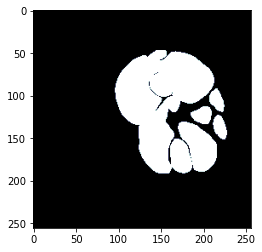

=== Slice 782 ===


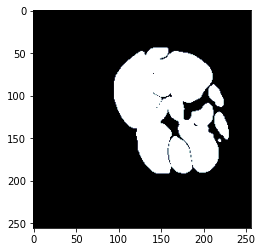

=== Slice 784 ===


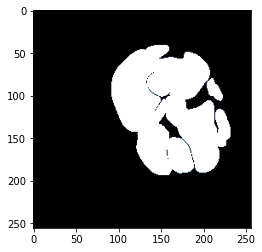

=== Slice 786 ===


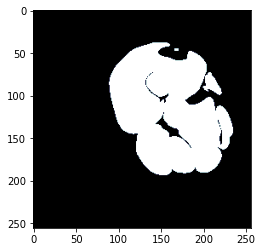

=== Slice 788 ===


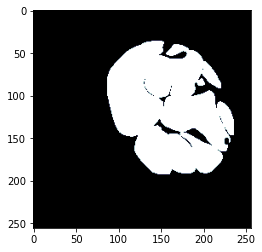

=== Slice 790 ===


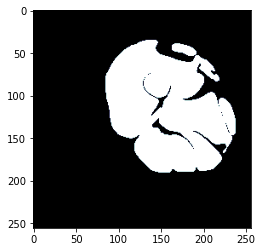

=== Slice 792 ===


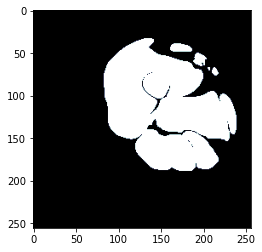

=== Slice 794 ===


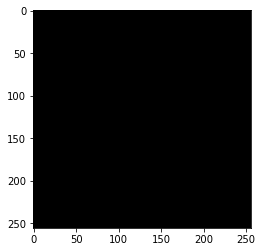

=== Slice 796 ===


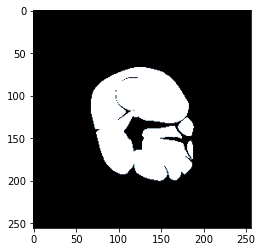

=== Slice 798 ===


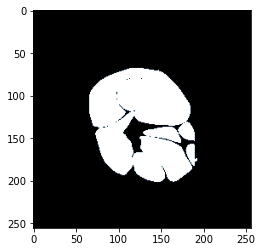

=== Slice 800 ===


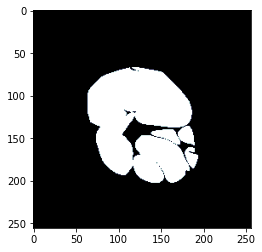

=== Slice 802 ===


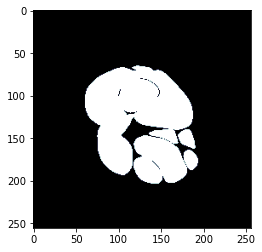

=== Slice 804 ===


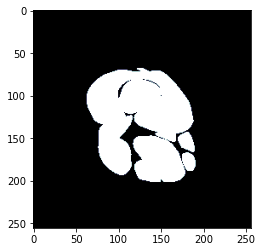

=== Slice 806 ===


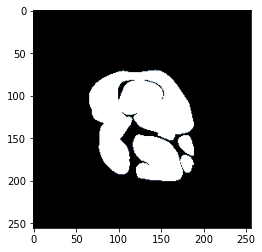

=== Slice 808 ===


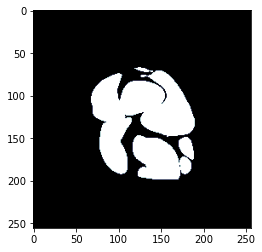

=== Slice 810 ===


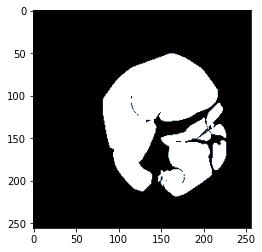

=== Slice 812 ===


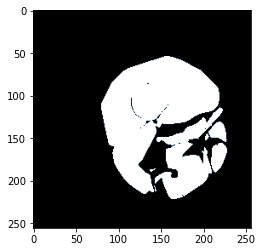

=== Slice 814 ===


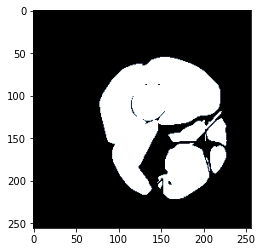

=== Slice 816 ===


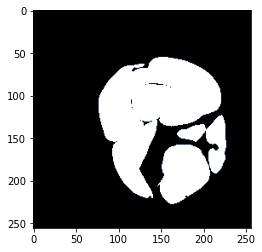

=== Slice 818 ===


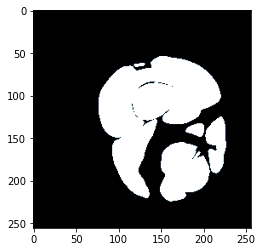

=== Slice 820 ===


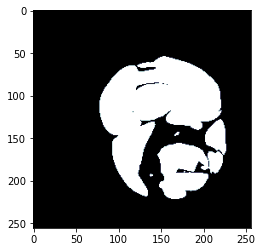

=== Slice 822 ===


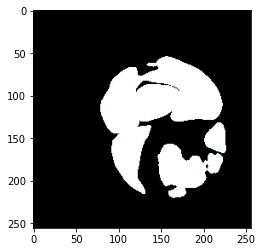

=== Slice 824 ===


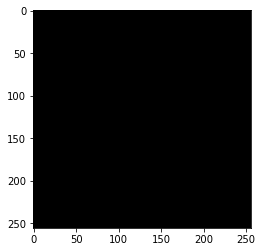

=== Slice 826 ===


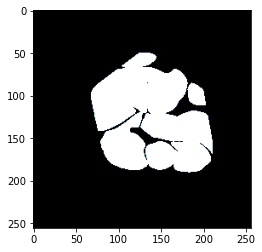

=== Slice 828 ===


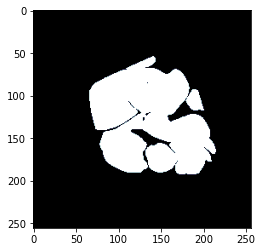

=== Slice 830 ===


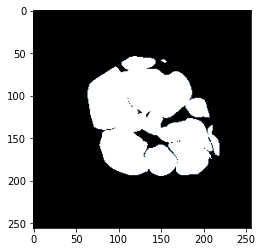

=== Slice 832 ===


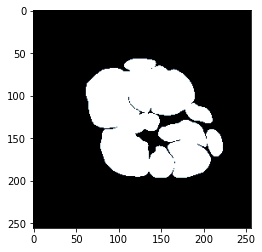

=== Slice 834 ===


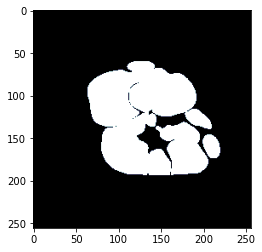

=== Slice 836 ===


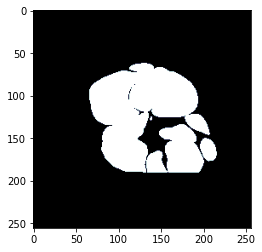

=== Slice 838 ===


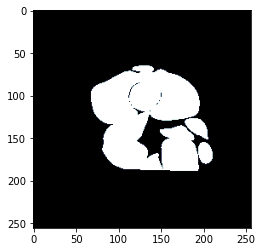

=== Slice 840 ===


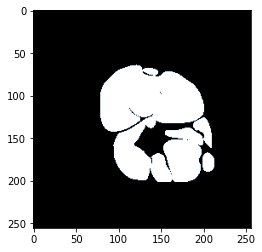

=== Slice 842 ===


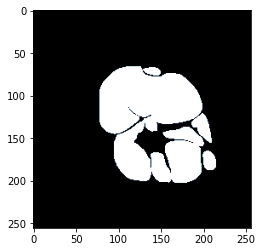

=== Slice 844 ===


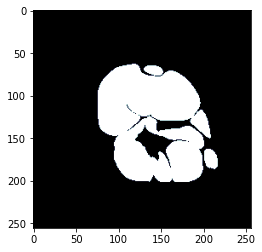

=== Slice 846 ===


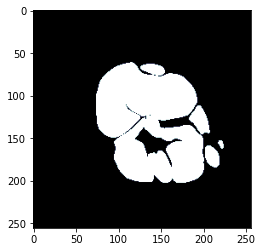

=== Slice 848 ===


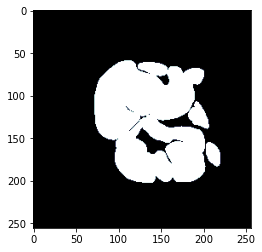

=== Slice 850 ===


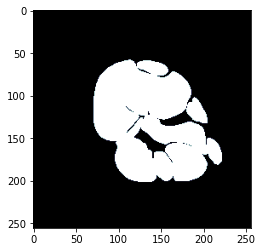

=== Slice 852 ===


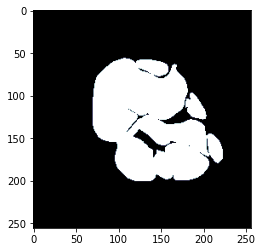

=== Slice 854 ===


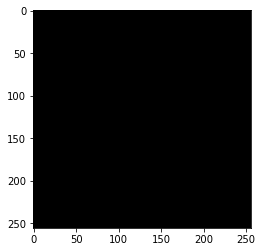

=== Slice 856 ===


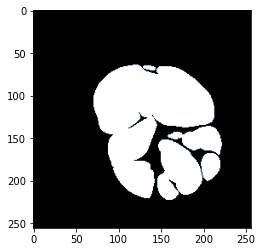

=== Slice 858 ===


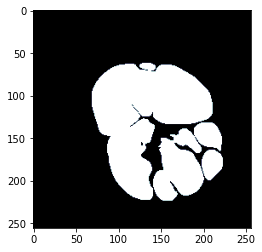

=== Slice 860 ===


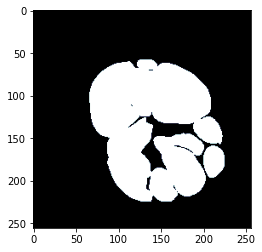

=== Slice 862 ===


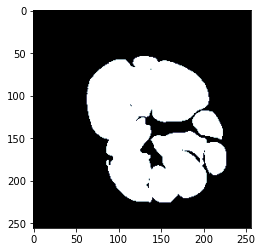

=== Slice 864 ===


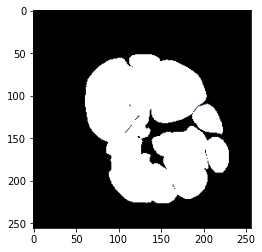

=== Slice 866 ===


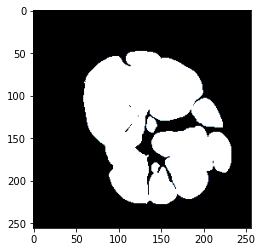

=== Slice 868 ===


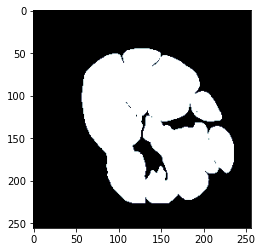

=== Slice 870 ===


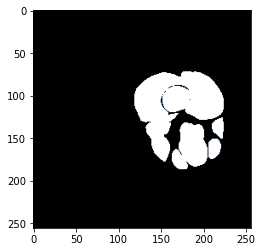

=== Slice 872 ===


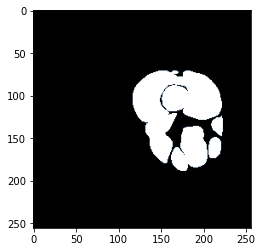

=== Slice 874 ===


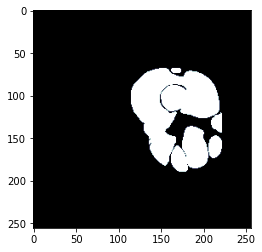

=== Slice 876 ===


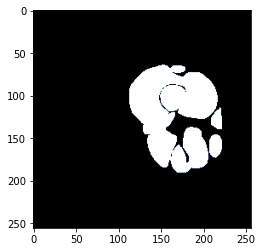

=== Slice 878 ===


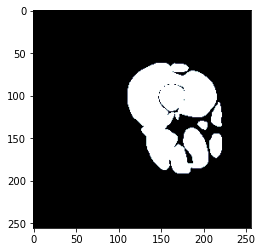

=== Slice 880 ===


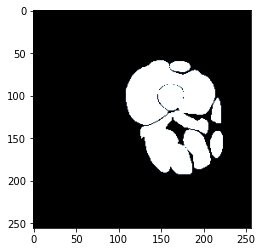

=== Slice 882 ===


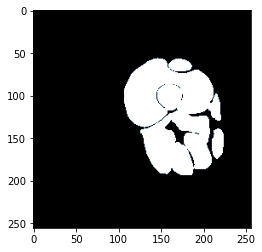

=== Slice 884 ===


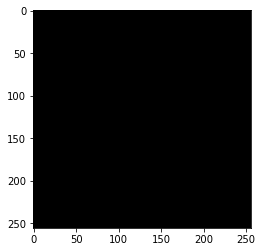

=== Slice 886 ===


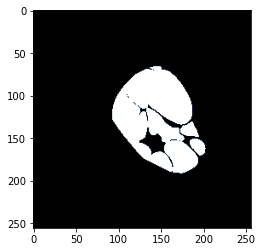

=== Slice 888 ===


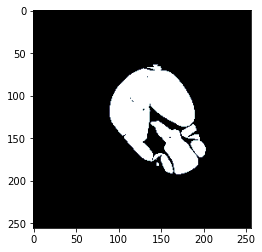

=== Slice 890 ===


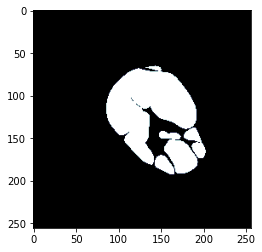

=== Slice 892 ===


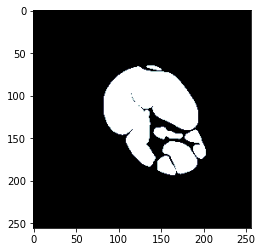

=== Slice 894 ===


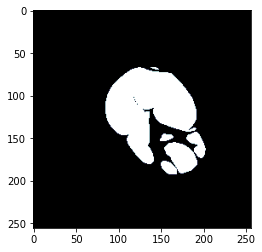

=== Slice 896 ===


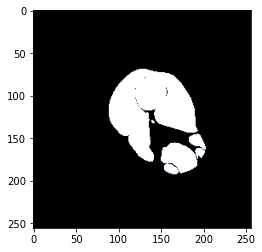

=== Slice 898 ===


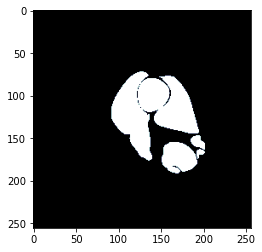

=== Slice 900 ===


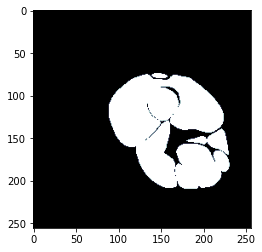

=== Slice 902 ===


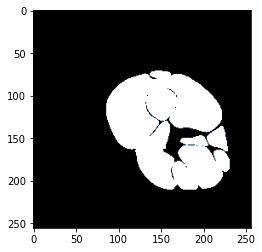

=== Slice 904 ===


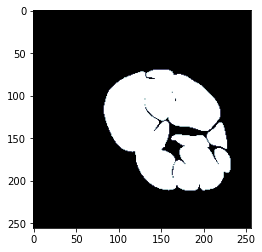

=== Slice 906 ===


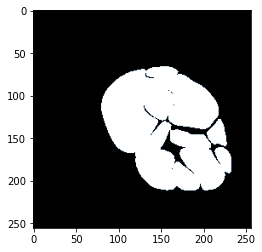

=== Slice 908 ===


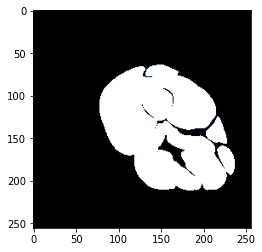

=== Slice 910 ===


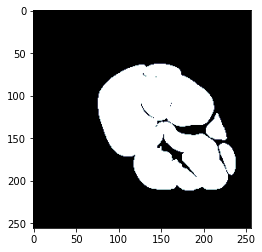

=== Slice 912 ===


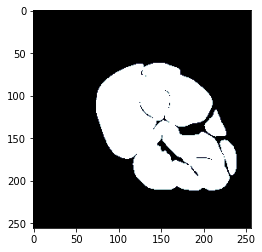

=== Slice 914 ===


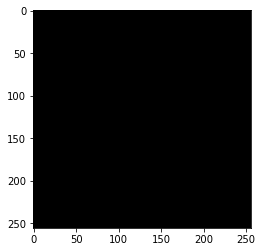

=== Slice 916 ===


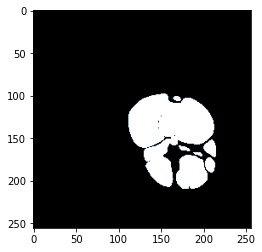

=== Slice 918 ===


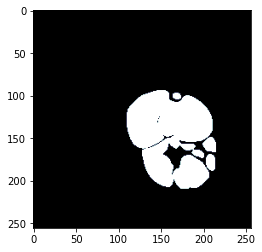

=== Slice 920 ===


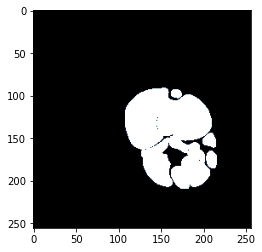

=== Slice 922 ===


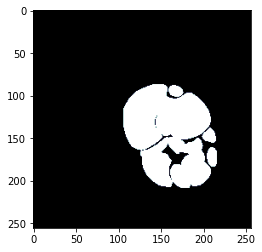

=== Slice 924 ===


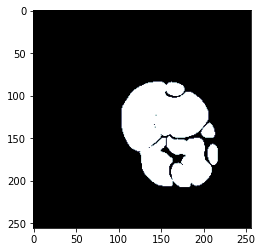

=== Slice 926 ===


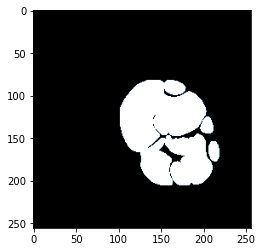

=== Slice 928 ===


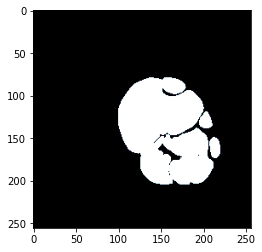

=== Slice 930 ===


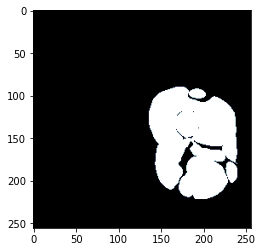

=== Slice 932 ===


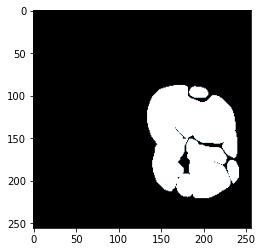

=== Slice 934 ===


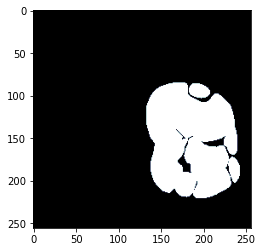

=== Slice 936 ===


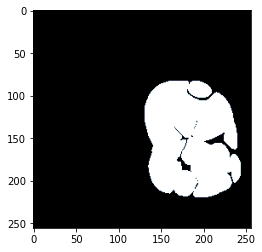

=== Slice 938 ===


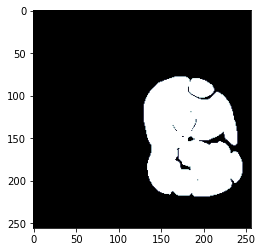

=== Slice 940 ===


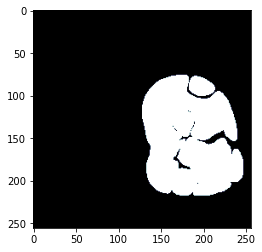

=== Slice 942 ===


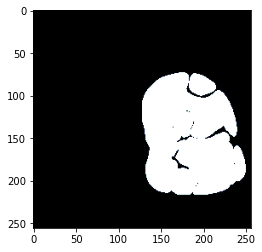

=== Slice 944 ===


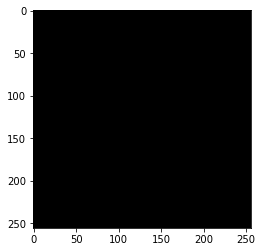

=== Slice 946 ===


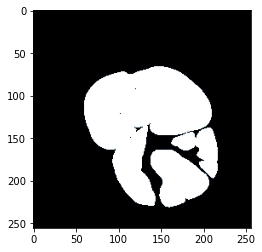

=== Slice 948 ===


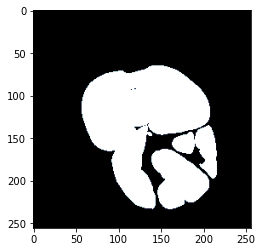

=== Slice 950 ===


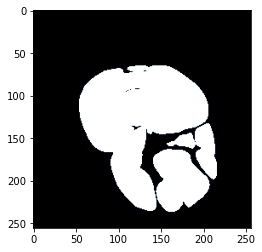

=== Slice 952 ===


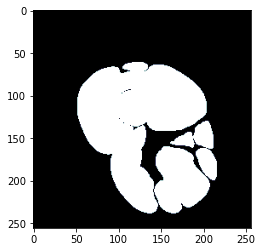

=== Slice 954 ===


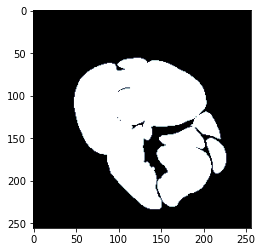

=== Slice 956 ===


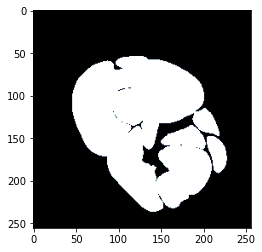

=== Slice 958 ===


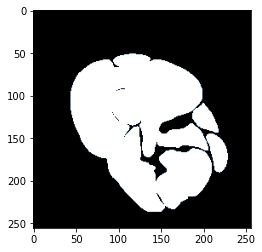

=== Slice 960 ===


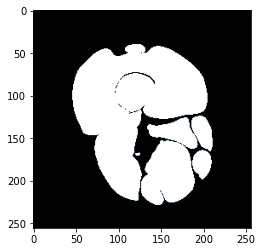

=== Slice 962 ===


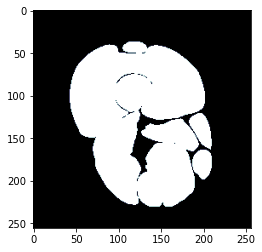

=== Slice 964 ===


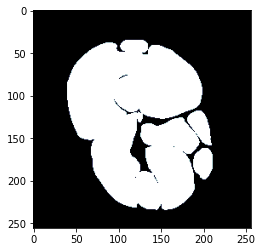

=== Slice 966 ===


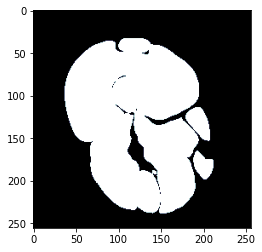

=== Slice 968 ===


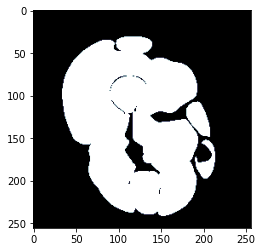

=== Slice 970 ===


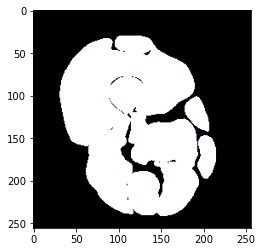

=== Slice 972 ===


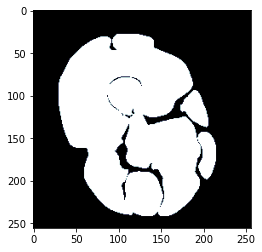

=== Slice 974 ===


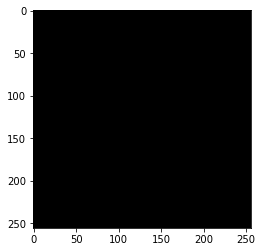

=== Slice 976 ===


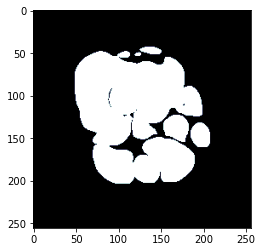

=== Slice 978 ===


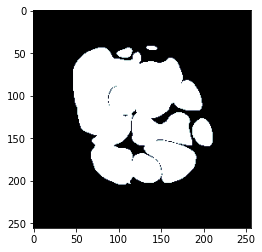

=== Slice 980 ===


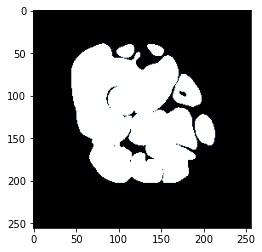

=== Slice 982 ===


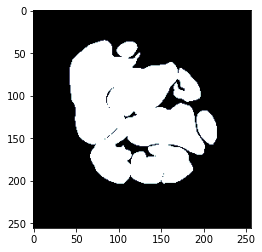

=== Slice 984 ===


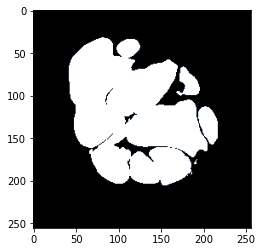

=== Slice 986 ===


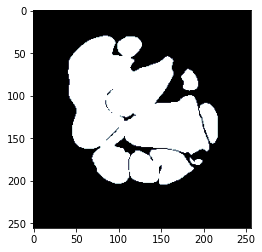

=== Slice 988 ===


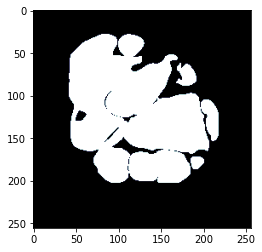

=== Slice 990 ===


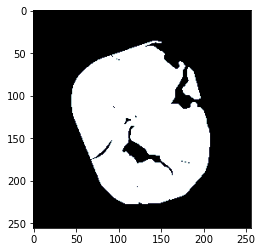

=== Slice 992 ===


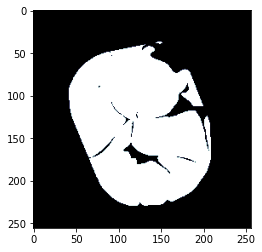

=== Slice 994 ===


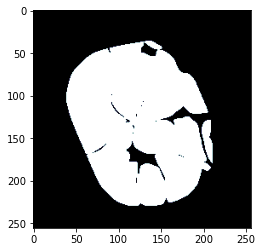

=== Slice 996 ===


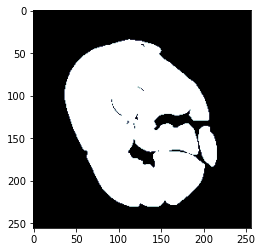

=== Slice 998 ===


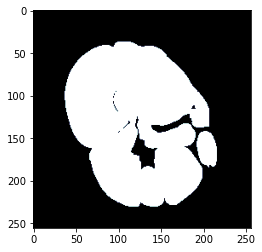

=== Slice 1000 ===


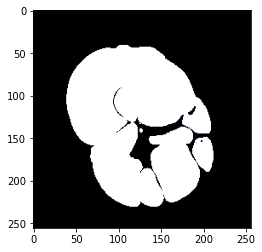

=== Slice 1002 ===


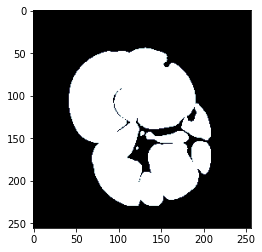

=== Slice 1004 ===


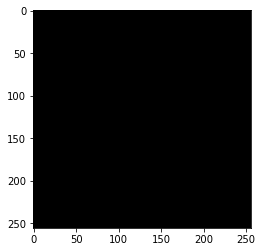

=== Slice 1006 ===


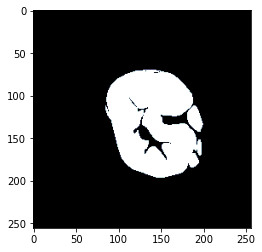

=== Slice 1008 ===


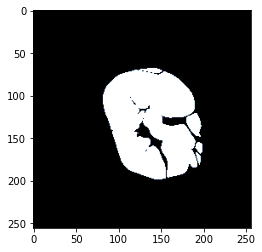

=== Slice 1010 ===


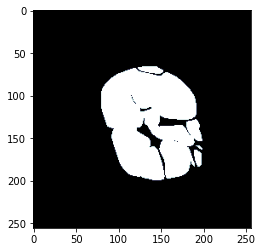

=== Slice 1012 ===


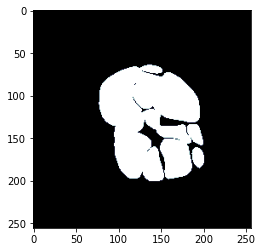

=== Slice 1014 ===


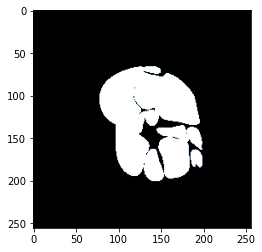

=== Slice 1016 ===


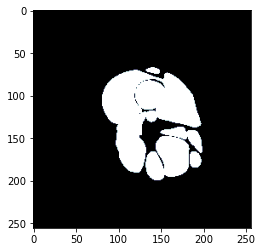

=== Slice 1018 ===


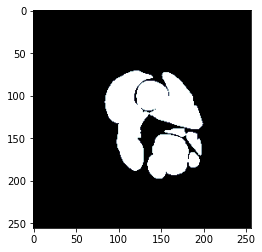

=== Slice 1020 ===


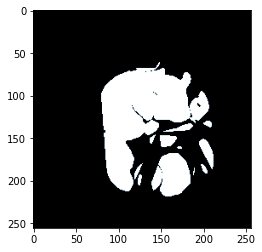

=== Slice 1022 ===


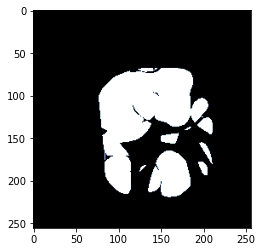

=== Slice 1024 ===


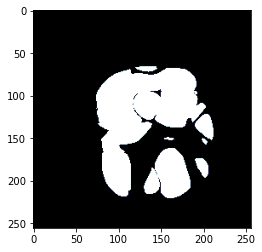

=== Slice 1026 ===


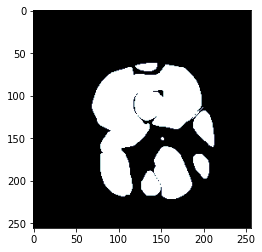

=== Slice 1028 ===


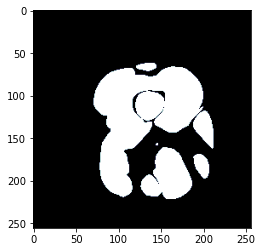

=== Slice 1030 ===


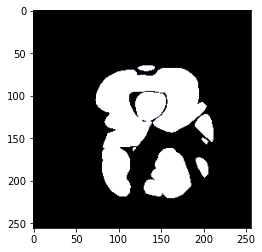

=== Slice 1032 ===


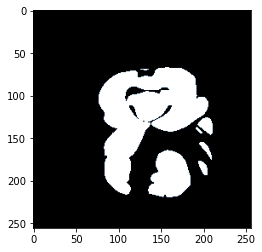

=== Slice 1034 ===


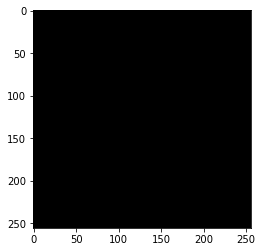

=== Slice 1036 ===


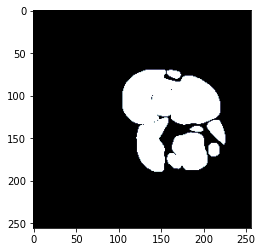

=== Slice 1038 ===


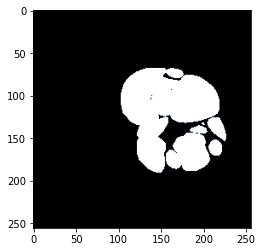

=== Slice 1040 ===


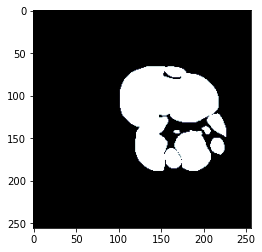

=== Slice 1042 ===


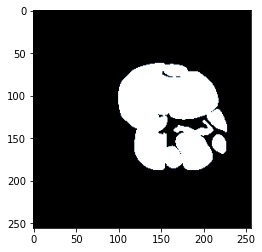

=== Slice 1044 ===


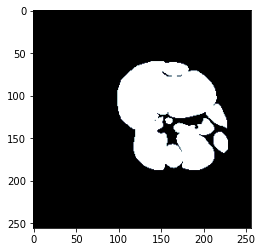

=== Slice 1046 ===


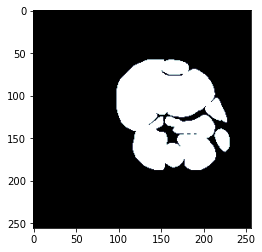

=== Slice 1048 ===


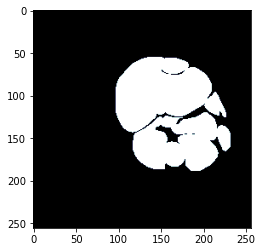

=== Slice 1050 ===


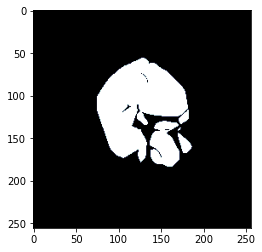

=== Slice 1052 ===


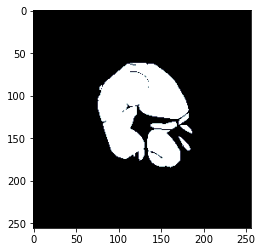

=== Slice 1054 ===


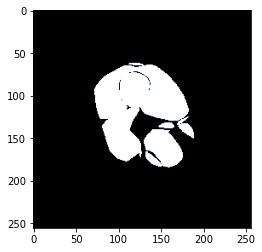

=== Slice 1056 ===


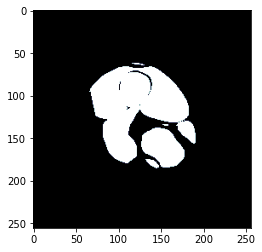

=== Slice 1058 ===


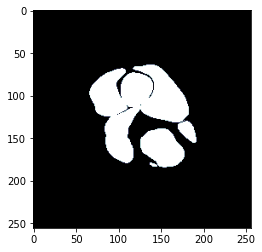

=== Slice 1060 ===


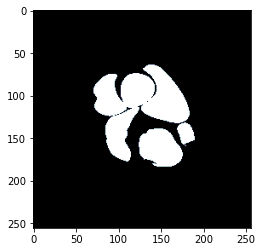

=== Slice 1062 ===


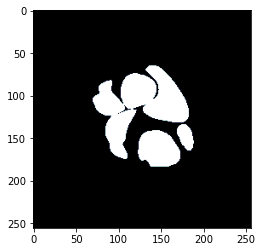

=== Slice 1064 ===


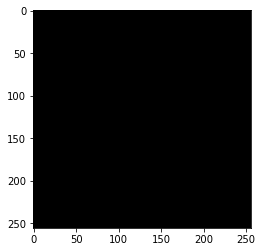

=== Slice 1066 ===


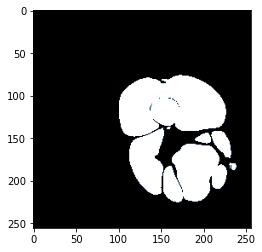

=== Slice 1068 ===


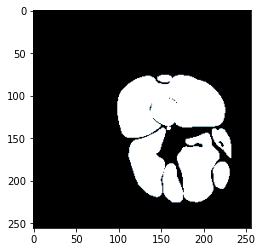

=== Slice 1070 ===


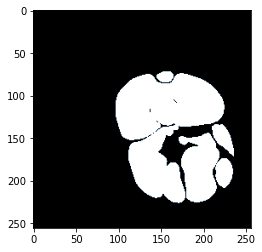

=== Slice 1072 ===


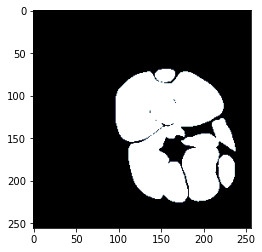

=== Slice 1074 ===


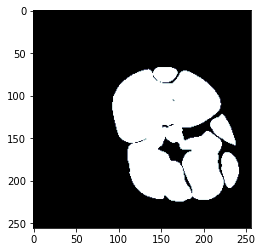

=== Slice 1076 ===


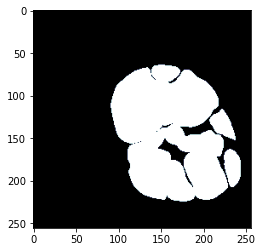

=== Slice 1078 ===


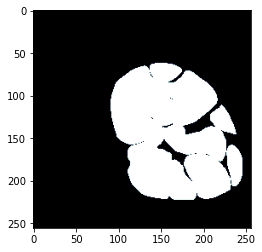

=== Slice 1080 ===


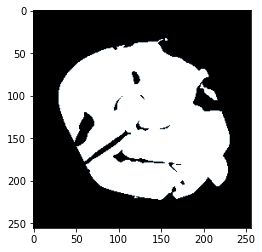

=== Slice 1082 ===


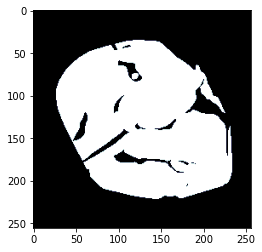

=== Slice 1084 ===


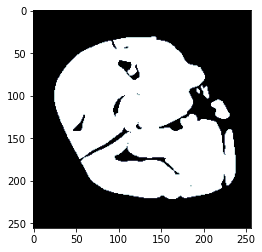

=== Slice 1086 ===


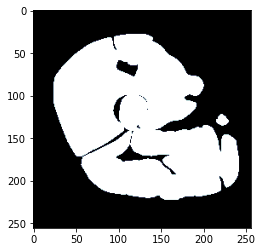

=== Slice 1088 ===


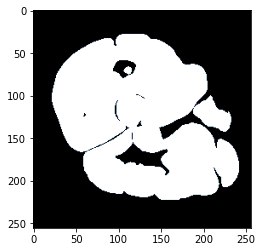

=== Slice 1090 ===


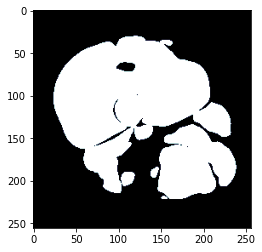

=== Slice 1092 ===


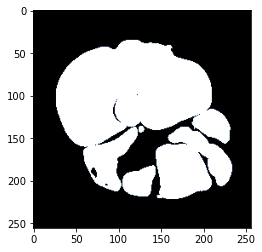

=== Slice 1094 ===


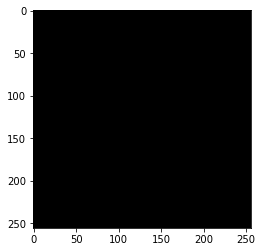

=== Slice 1096 ===


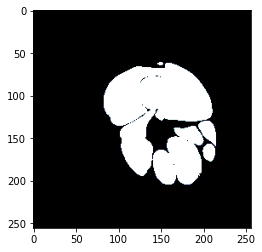

=== Slice 1098 ===


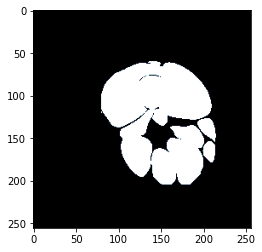

=== Slice 1100 ===


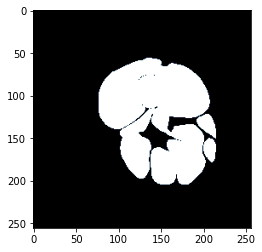

=== Slice 1102 ===


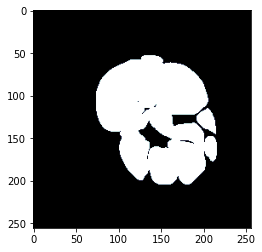

=== Slice 1104 ===


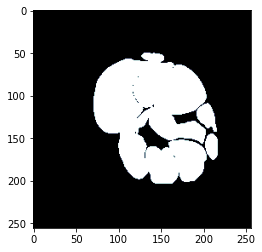

=== Slice 1106 ===


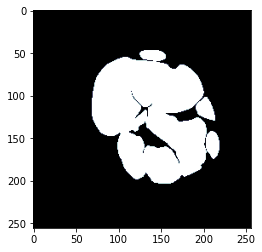

=== Slice 1108 ===


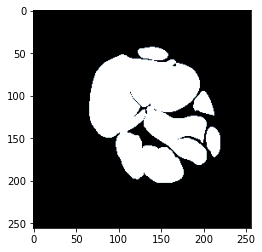

=== Slice 1110 ===


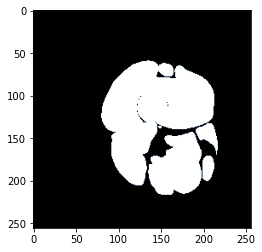

=== Slice 1112 ===


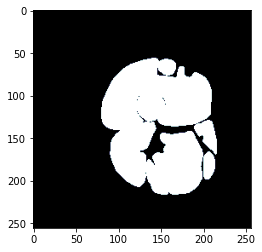

=== Slice 1114 ===


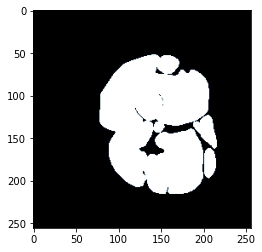

=== Slice 1116 ===


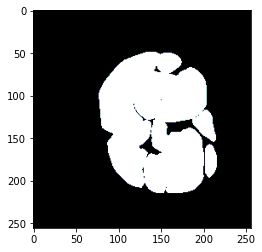

=== Slice 1118 ===


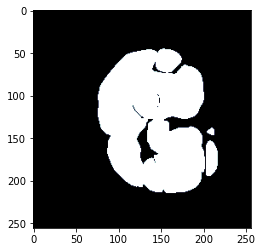

=== Slice 1120 ===


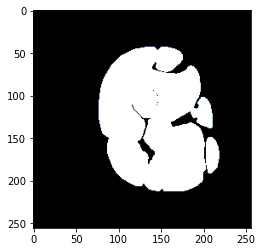

=== Slice 1122 ===


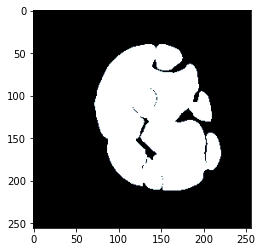

=== Slice 1124 ===


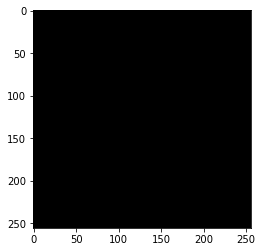

=== Slice 1126 ===


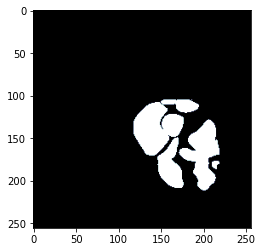

=== Slice 1128 ===


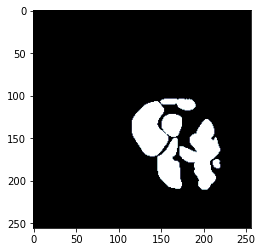

=== Slice 1130 ===


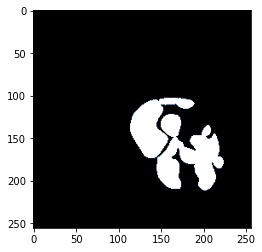

=== Slice 1132 ===


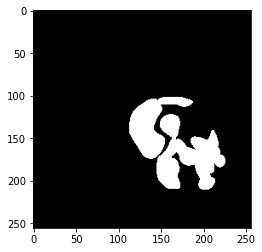

=== Slice 1134 ===


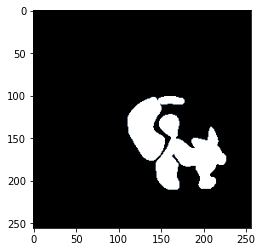

=== Slice 1136 ===


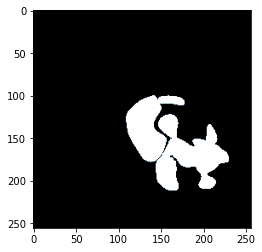

=== Slice 1138 ===


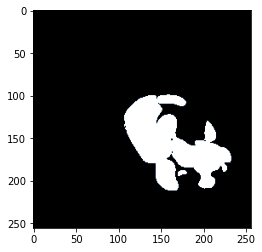

=== Slice 1140 ===


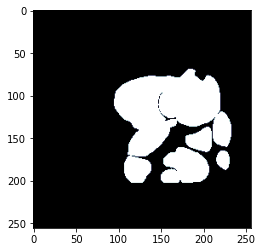

=== Slice 1142 ===


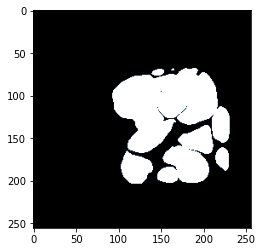

=== Slice 1144 ===


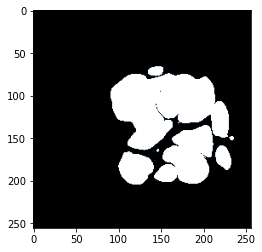

=== Slice 1146 ===


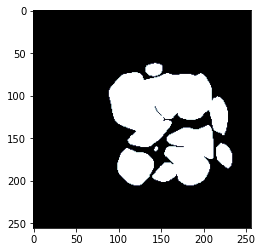

=== Slice 1148 ===


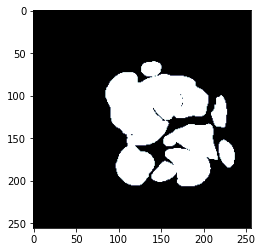

=== Slice 1150 ===


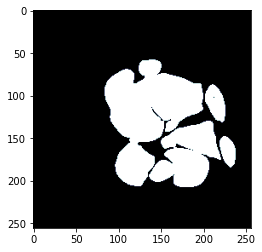

=== Slice 1152 ===


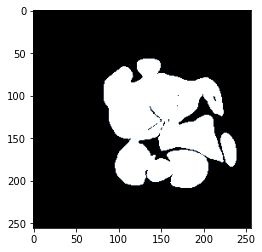

=== Slice 1154 ===


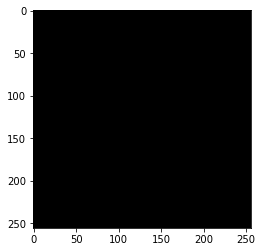

=== Slice 1156 ===


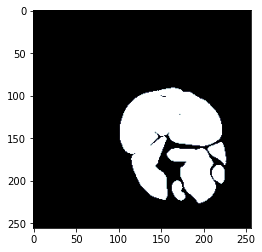

=== Slice 1158 ===


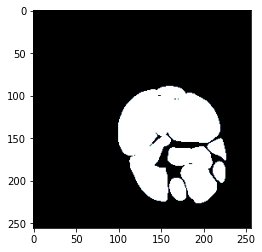

=== Slice 1160 ===


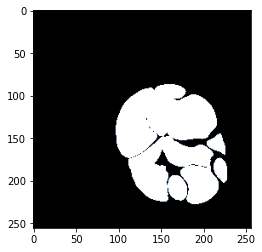

=== Slice 1162 ===


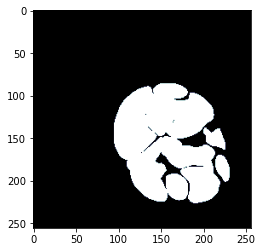

=== Slice 1164 ===


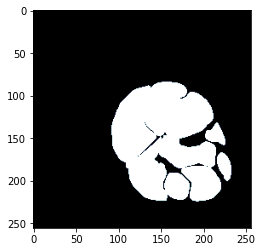

=== Slice 1166 ===


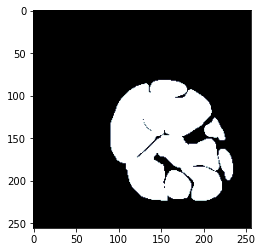

=== Slice 1168 ===


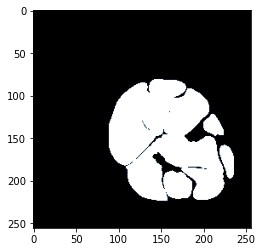

=== Slice 1170 ===


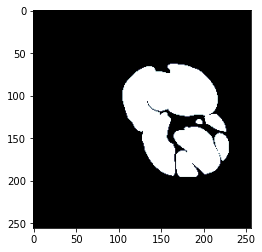

=== Slice 1172 ===


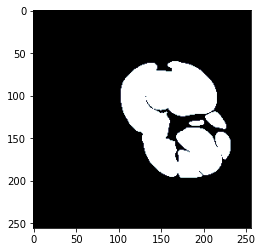

=== Slice 1174 ===


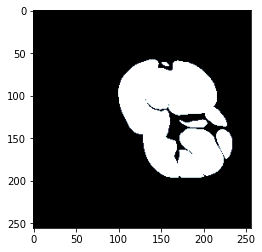

=== Slice 1176 ===


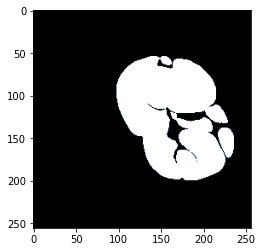

=== Slice 1178 ===


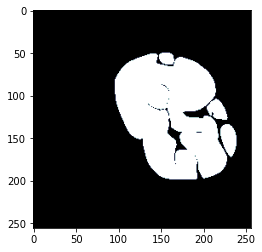

=== Slice 1180 ===


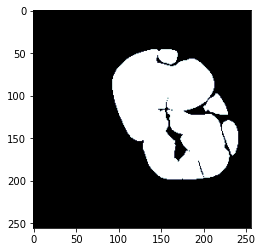

=== Slice 1182 ===


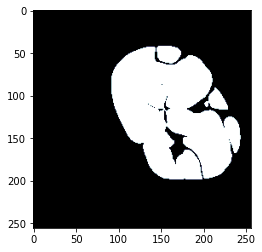

=== Slice 1184 ===


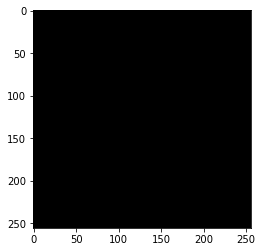

=== Slice 1186 ===


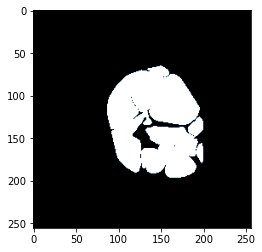

=== Slice 1188 ===


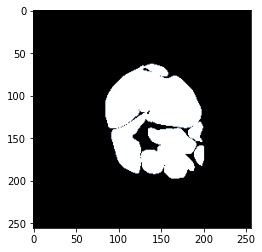

=== Slice 1190 ===


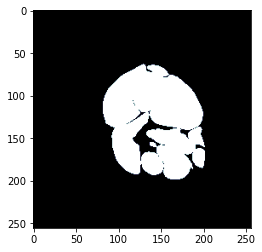

=== Slice 1192 ===


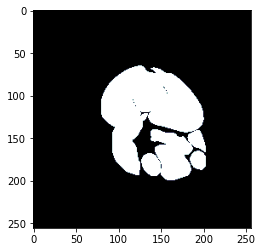

=== Slice 1194 ===


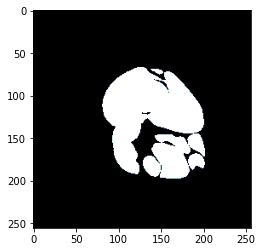

=== Slice 1196 ===


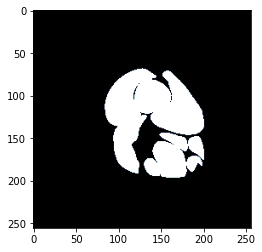

=== Slice 1198 ===


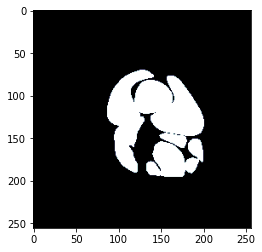

=== Slice 1200 ===


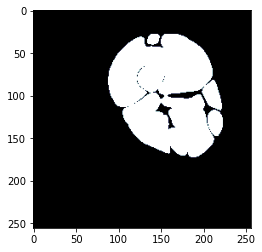

=== Slice 1202 ===


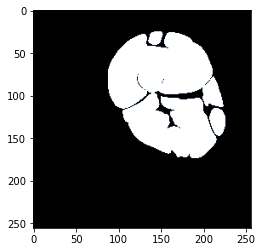

=== Slice 1204 ===


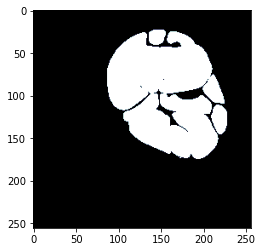

=== Slice 1206 ===


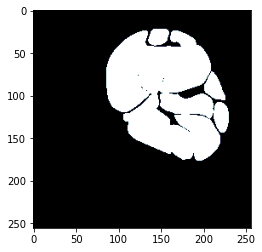

=== Slice 1208 ===


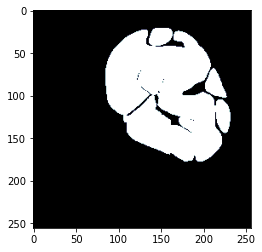

=== Slice 1210 ===


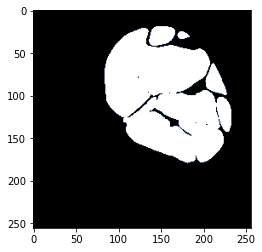

=== Slice 1212 ===


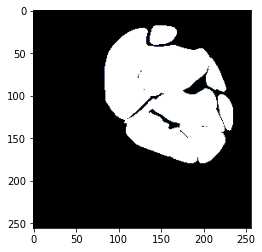

=== Slice 1214 ===


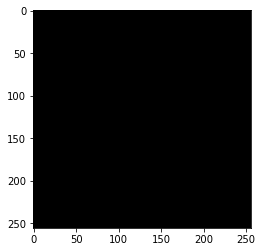

=== Slice 1216 ===


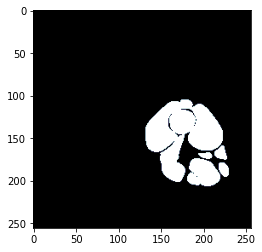

=== Slice 1218 ===


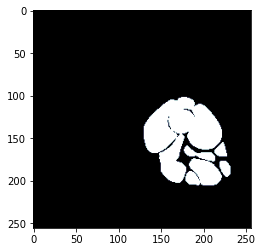

=== Slice 1220 ===


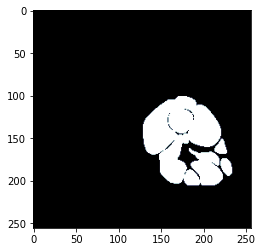

=== Slice 1222 ===


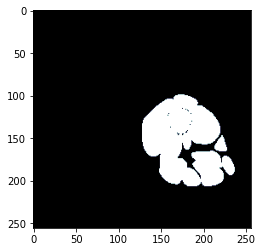

=== Slice 1224 ===


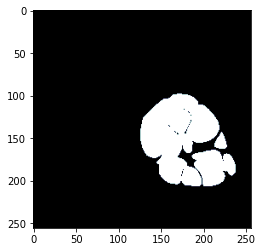

=== Slice 1226 ===


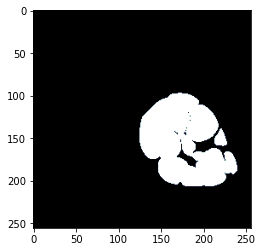

=== Slice 1228 ===


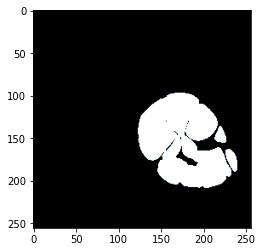

=== Slice 1230 ===


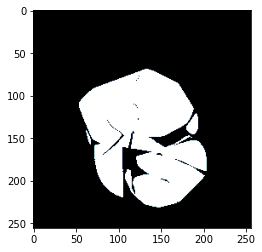

=== Slice 1232 ===


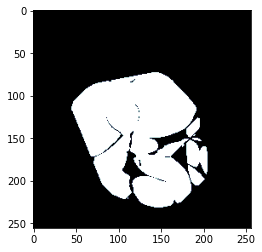

=== Slice 1234 ===


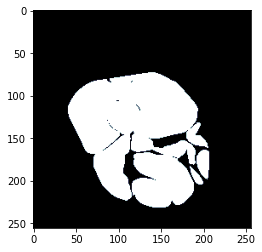

=== Slice 1236 ===


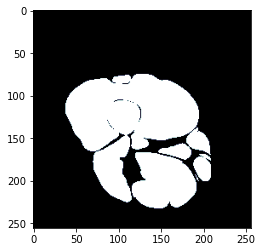

=== Slice 1238 ===


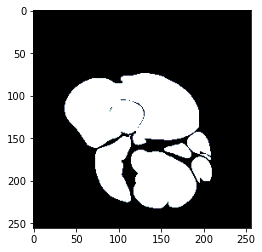

=== Slice 1240 ===


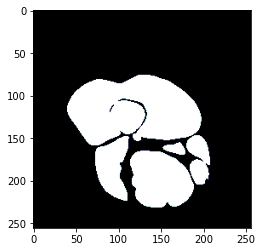

=== Slice 1242 ===


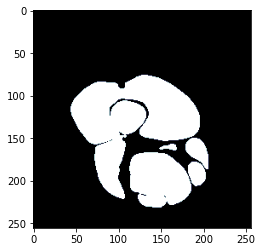

=== Slice 1244 ===


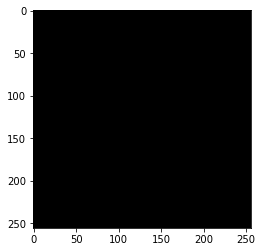

=== Slice 1246 ===


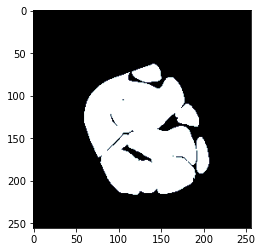

=== Slice 1248 ===


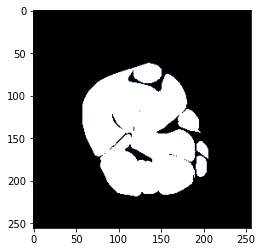

=== Slice 1250 ===


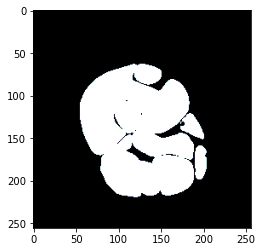

=== Slice 1252 ===


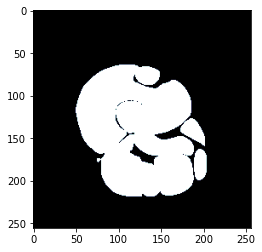

=== Slice 1254 ===


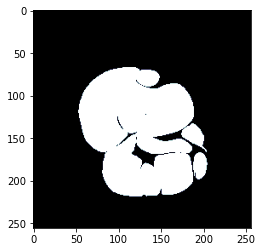

=== Slice 1256 ===


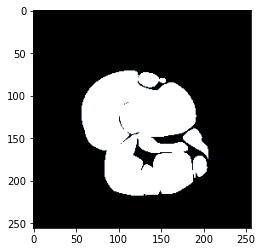

=== Slice 1258 ===


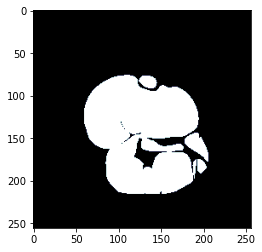

=== Slice 1260 ===


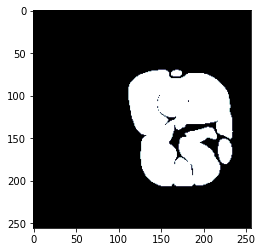

=== Slice 1262 ===


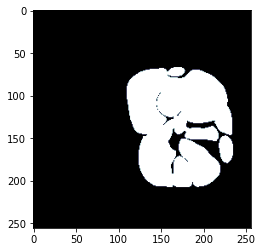

=== Slice 1264 ===


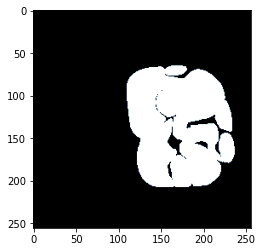

=== Slice 1266 ===


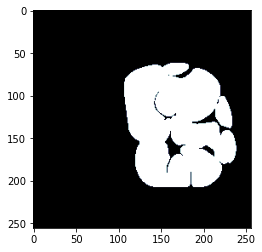

=== Slice 1268 ===


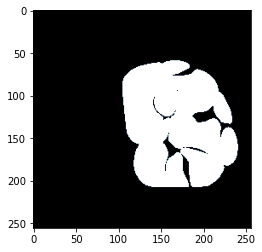

=== Slice 1270 ===


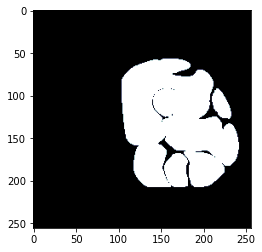

=== Slice 1272 ===


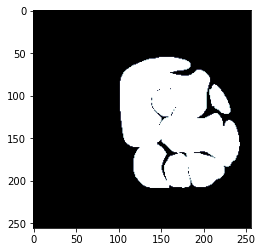

=== Slice 1274 ===


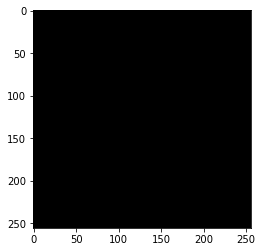

=== Slice 1276 ===


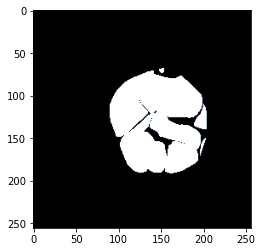

=== Slice 1278 ===


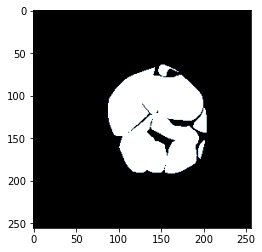

=== Slice 1280 ===


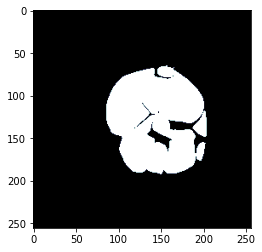

=== Slice 1282 ===


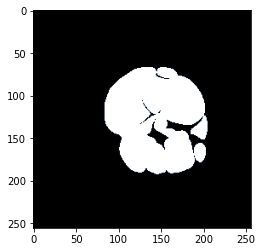

=== Slice 1284 ===


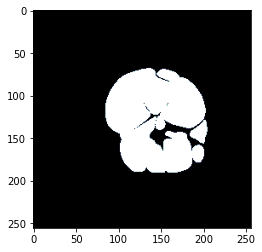

=== Slice 1286 ===


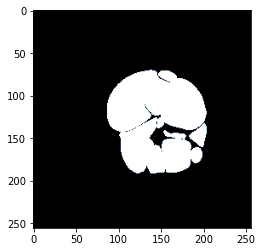

=== Slice 1288 ===


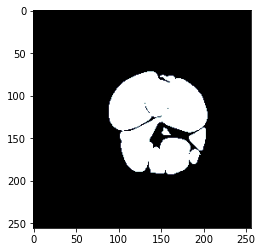

=== Slice 1290 ===


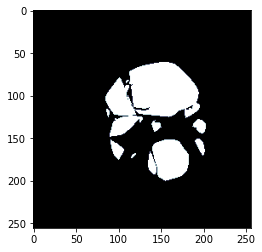

=== Slice 1292 ===


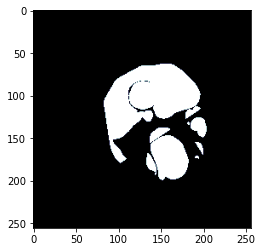

=== Slice 1294 ===


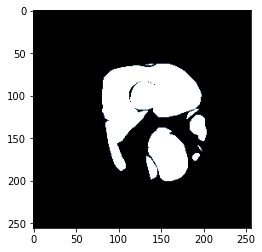

=== Slice 1296 ===


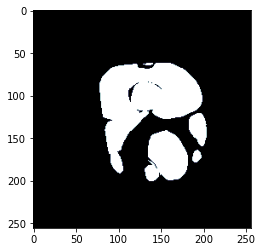

=== Slice 1298 ===


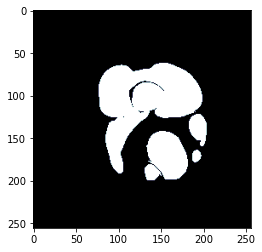

=== Slice 1300 ===


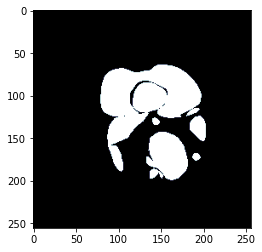

=== Slice 1302 ===


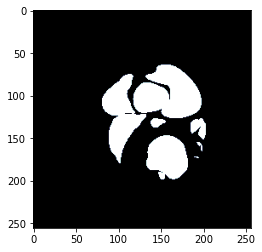

=== Slice 1304 ===


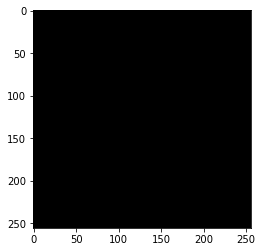

=== Slice 1306 ===


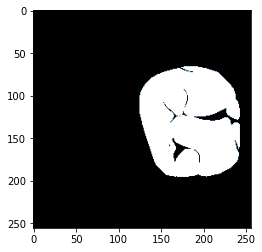

=== Slice 1308 ===


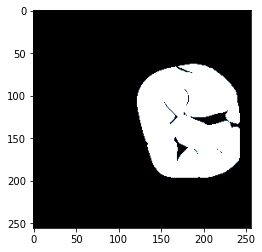

=== Slice 1310 ===


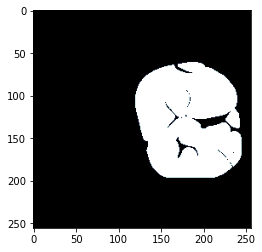

=== Slice 1312 ===


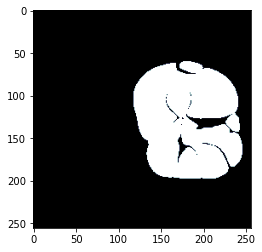

=== Slice 1314 ===


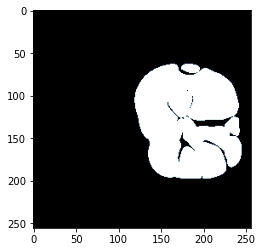

=== Slice 1316 ===


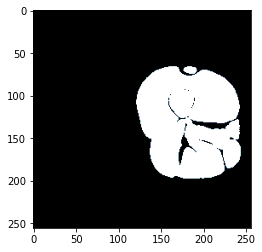

=== Slice 1318 ===


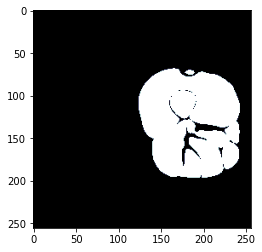

=== Slice 1320 ===


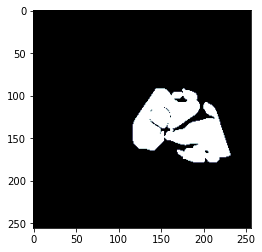

=== Slice 1322 ===


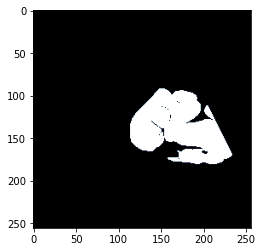

=== Slice 1324 ===


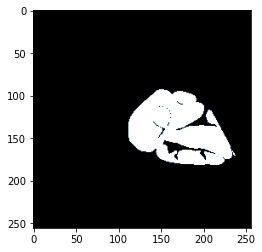

=== Slice 1326 ===


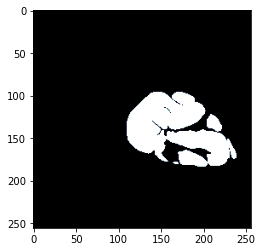

=== Slice 1328 ===


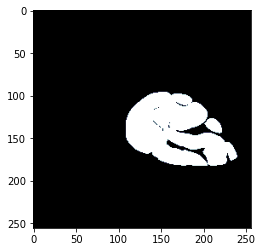

=== Slice 1330 ===


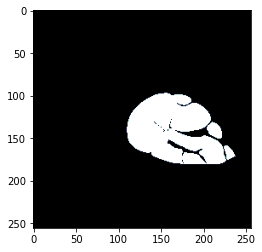

=== Slice 1332 ===


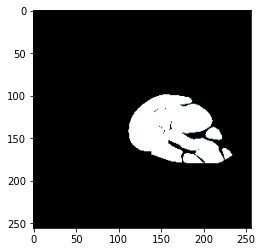

=== Slice 1334 ===


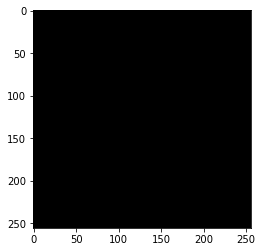

=== Slice 1336 ===


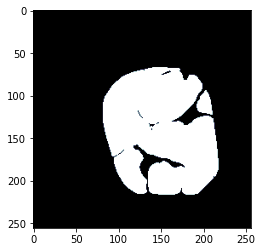

=== Slice 1338 ===


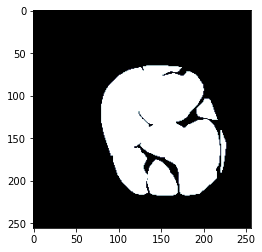

=== Slice 1340 ===


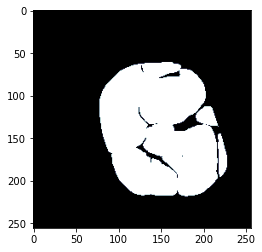

=== Slice 1342 ===


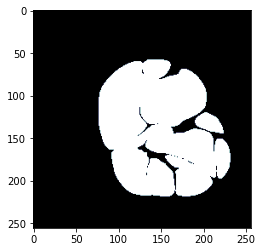

=== Slice 1344 ===


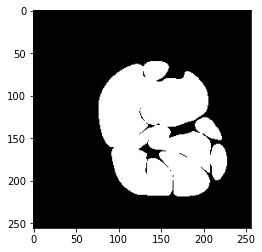

=== Slice 1346 ===


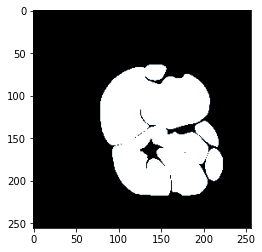

=== Slice 1348 ===


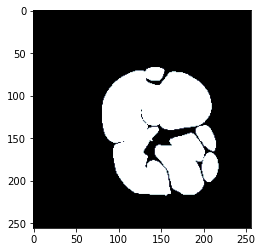

=== Slice 1350 ===


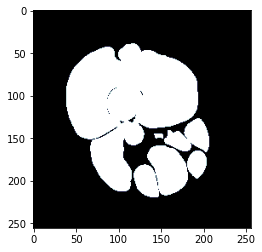

=== Slice 1352 ===


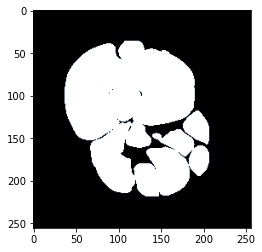

=== Slice 1354 ===


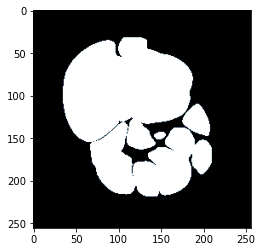

=== Slice 1356 ===


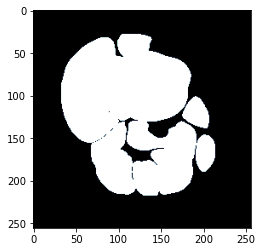

=== Slice 1358 ===


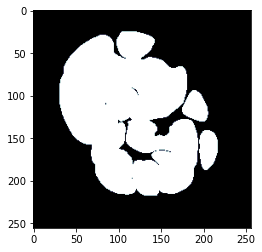

=== Slice 1360 ===


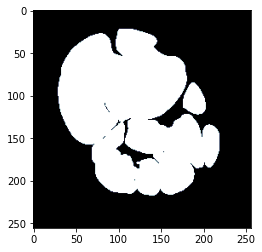

=== Slice 1362 ===


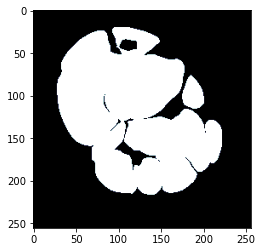

=== Slice 1364 ===


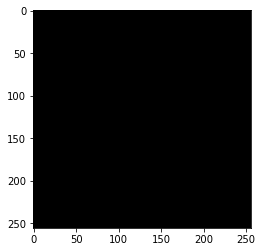

=== Slice 1366 ===


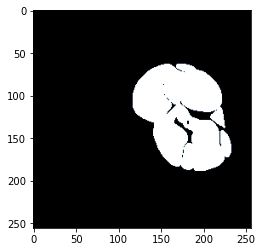

=== Slice 1368 ===


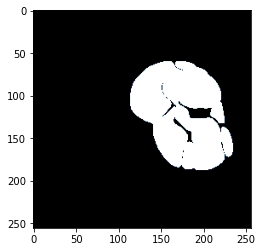

=== Slice 1370 ===


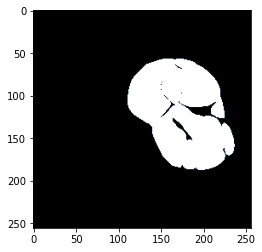

=== Slice 1372 ===


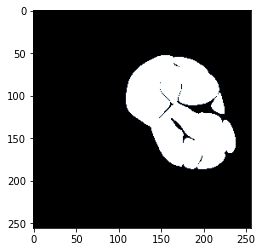

=== Slice 1374 ===


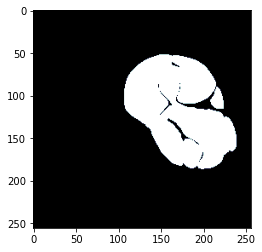

=== Slice 1376 ===


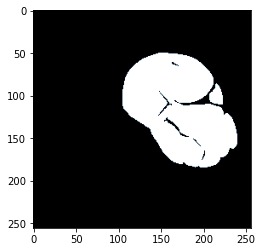

=== Slice 1378 ===


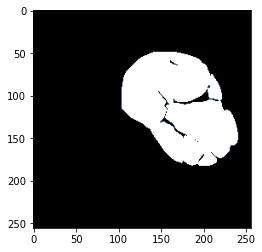

=== Slice 1380 ===


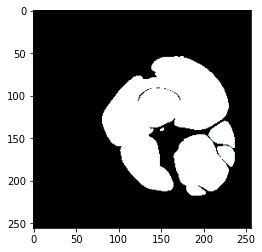

=== Slice 1382 ===


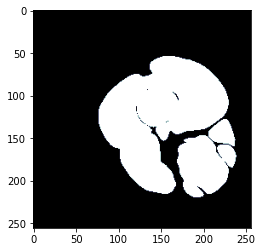

=== Slice 1384 ===


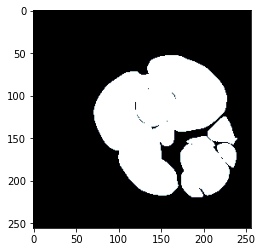

=== Slice 1386 ===


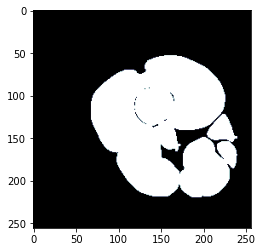

=== Slice 1388 ===


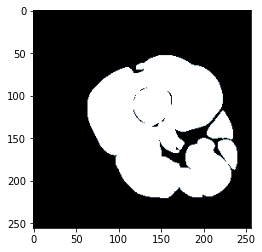

=== Slice 1390 ===


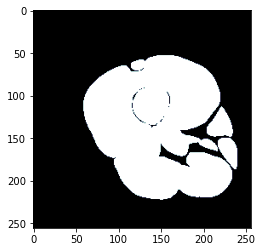

=== Slice 1392 ===


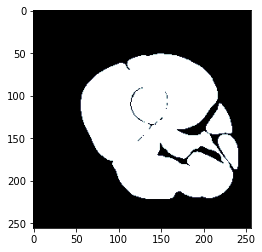

=== Slice 1394 ===


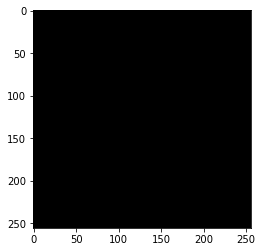

=== Slice 1396 ===


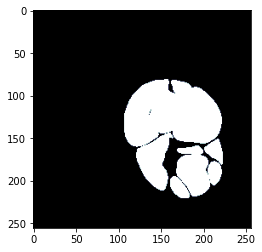

=== Slice 1398 ===


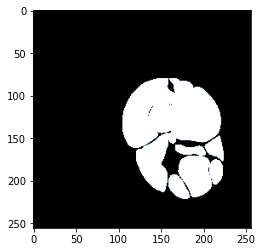

=== Slice 1400 ===


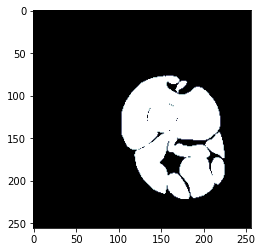

=== Slice 1402 ===


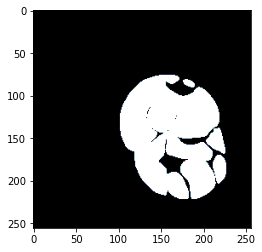

=== Slice 1404 ===


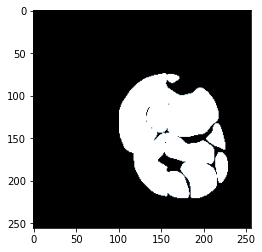

=== Slice 1406 ===


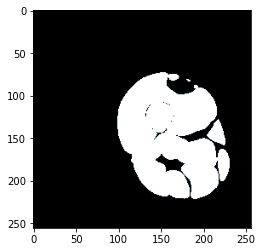

=== Slice 1408 ===


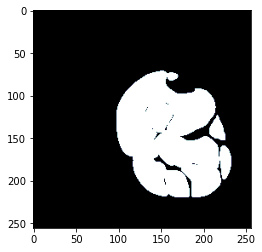

=== Slice 1410 ===


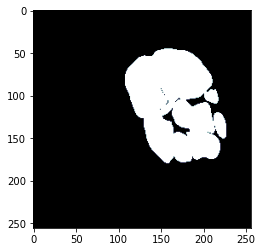

=== Slice 1412 ===


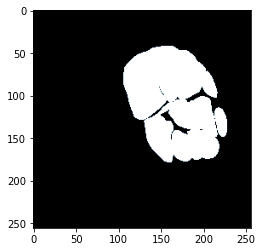

=== Slice 1414 ===


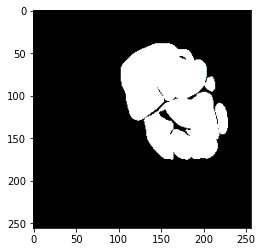

=== Slice 1416 ===


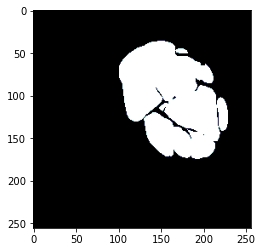

=== Slice 1418 ===


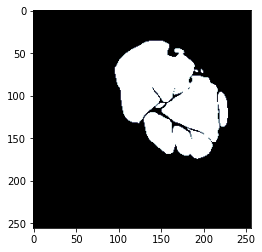

=== Slice 1420 ===


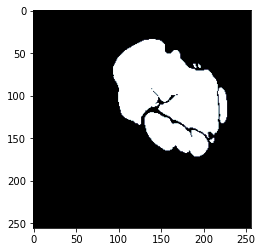

=== Slice 1422 ===


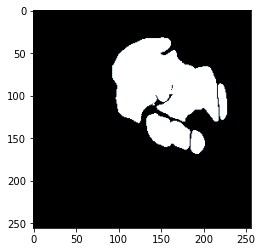

=== Slice 1424 ===


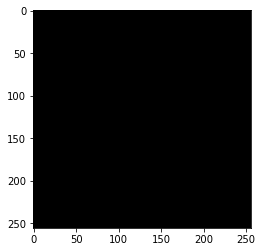

=== Slice 1426 ===


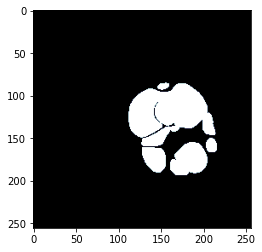

=== Slice 1428 ===


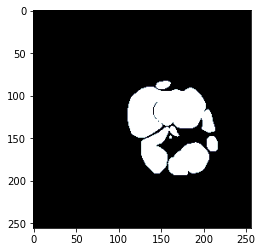

=== Slice 1430 ===


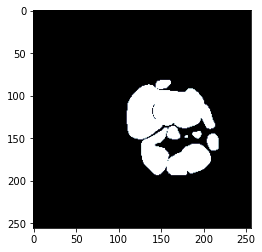

=== Slice 1432 ===


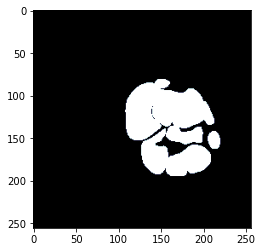

=== Slice 1434 ===


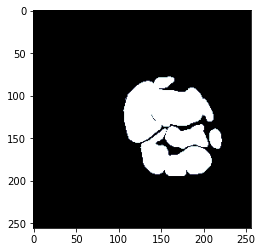

=== Slice 1436 ===


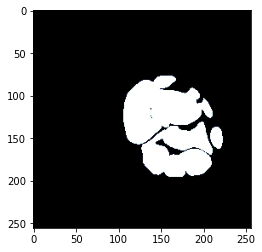

=== Slice 1438 ===


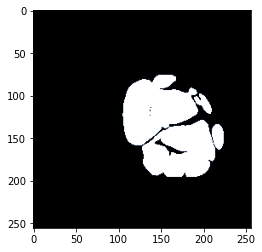

=== Slice 1440 ===


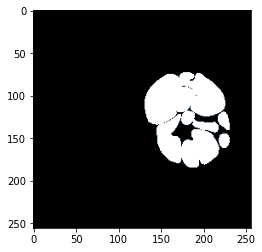

=== Slice 1442 ===


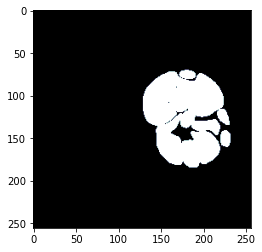

=== Slice 1444 ===


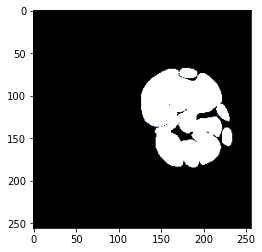

=== Slice 1446 ===


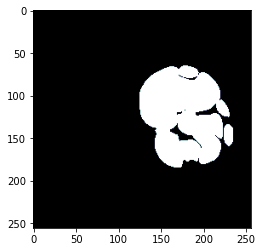

=== Slice 1448 ===


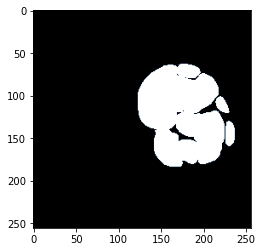

=== Slice 1450 ===


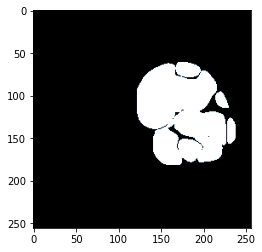

=== Slice 1452 ===


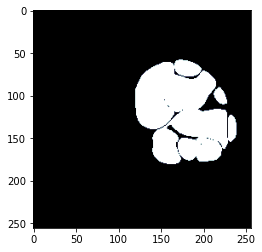

=== Slice 1454 ===


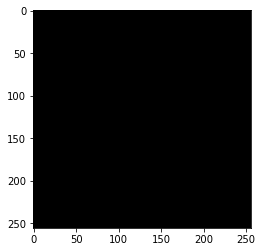

=== Slice 1456 ===


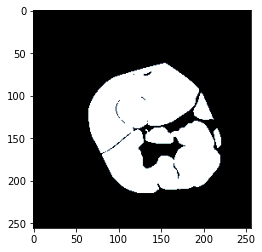

=== Slice 1458 ===


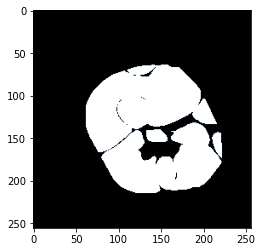

=== Slice 1460 ===


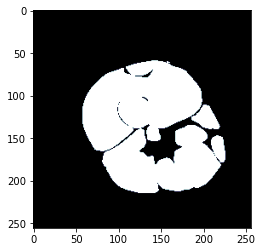

=== Slice 1462 ===


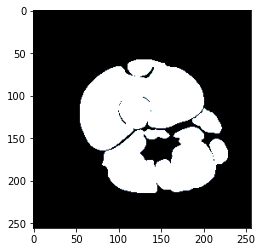

=== Slice 1464 ===


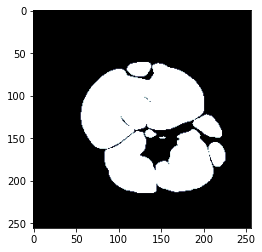

=== Slice 1466 ===


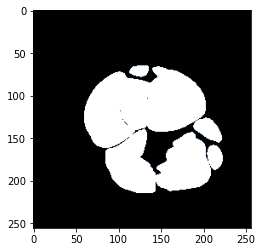

=== Slice 1468 ===


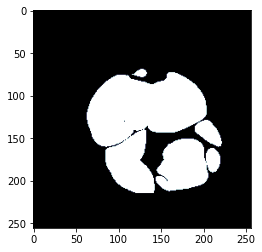

=== Slice 1470 ===


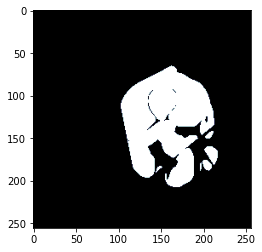

=== Slice 1472 ===


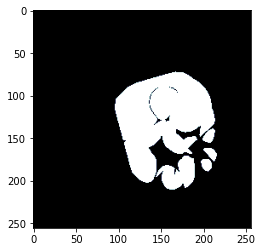

=== Slice 1474 ===


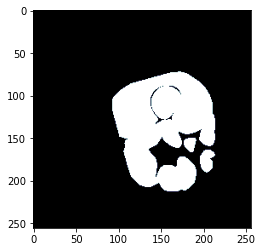

=== Slice 1476 ===


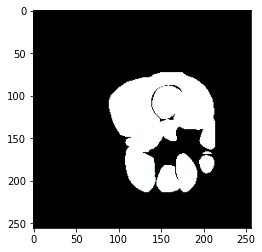

=== Slice 1478 ===


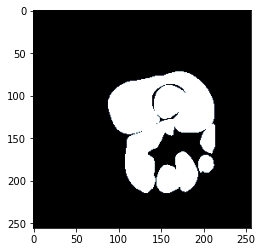

=== Slice 1480 ===


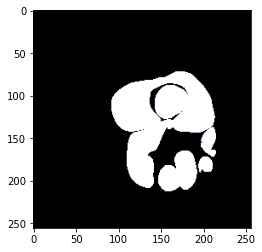

=== Slice 1482 ===


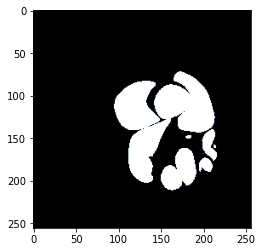

=== Slice 1484 ===


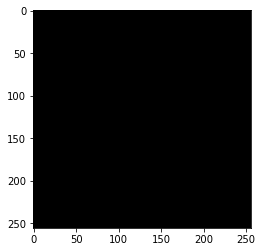

=== Slice 1486 ===


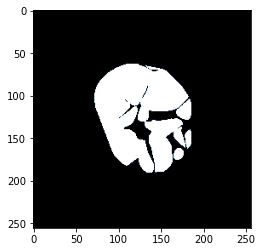

=== Slice 1488 ===


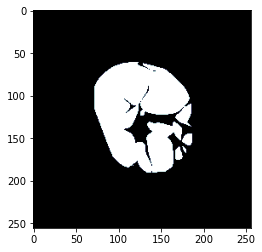

=== Slice 1490 ===


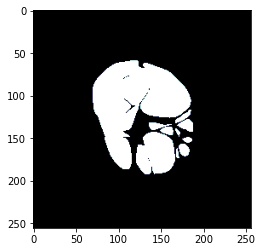

=== Slice 1492 ===


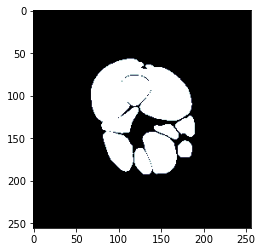

=== Slice 1494 ===


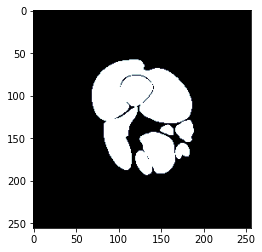

=== Slice 1496 ===


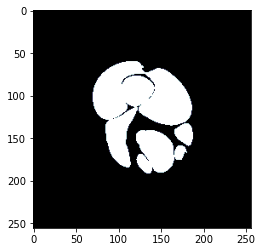

=== Slice 1498 ===


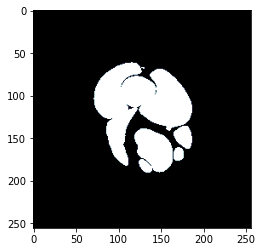

=== Slice 1500 ===


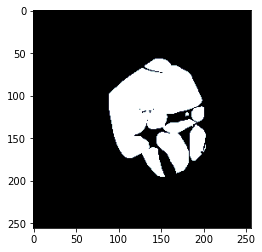

=== Slice 1502 ===


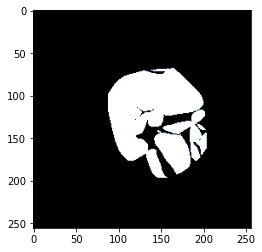

=== Slice 1504 ===


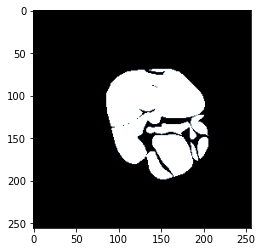

=== Slice 1506 ===


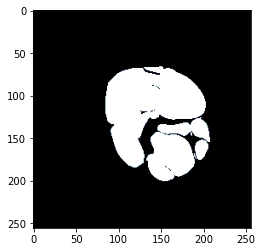

=== Slice 1508 ===


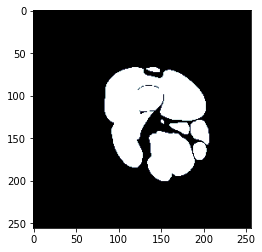

=== Slice 1510 ===


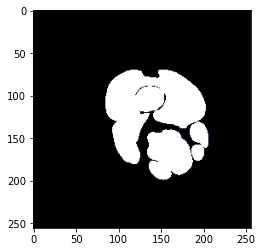

=== Slice 1512 ===


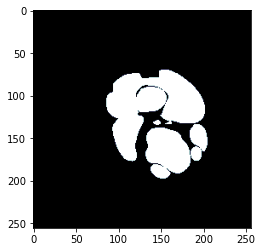

=== Slice 1514 ===


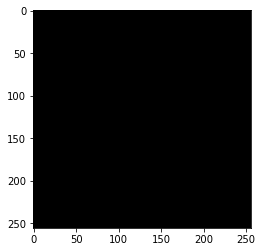

=== Slice 1516 ===


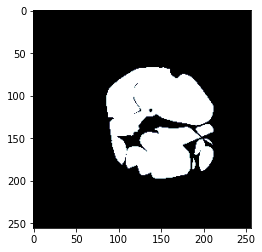

=== Slice 1518 ===


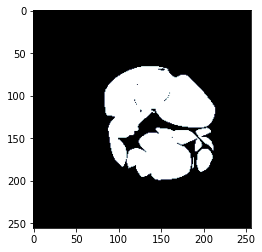

=== Slice 1520 ===


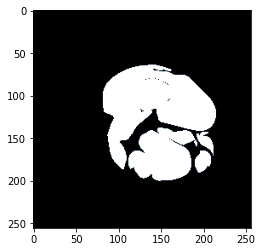

=== Slice 1522 ===


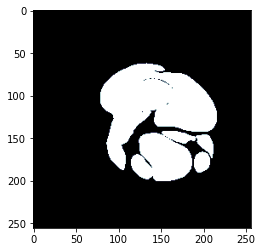

=== Slice 1524 ===


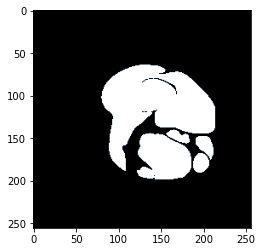

=== Slice 1526 ===


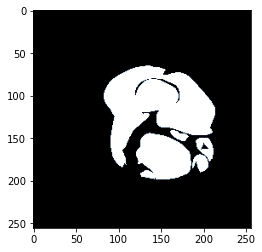

=== Slice 1528 ===


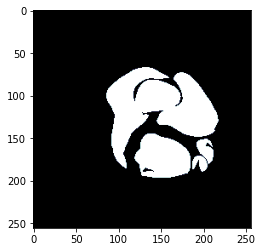

=== Slice 1530 ===


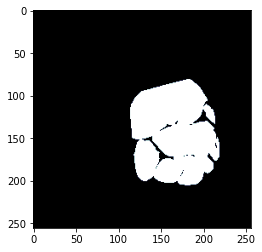

=== Slice 1532 ===


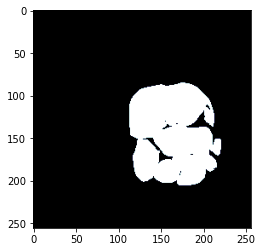

=== Slice 1534 ===


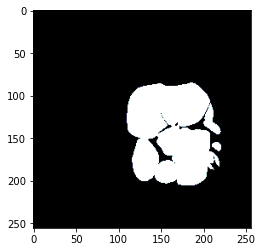

=== Slice 1536 ===


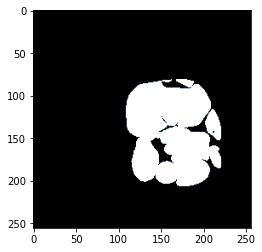

=== Slice 1538 ===


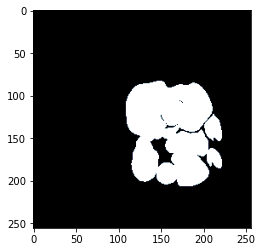

=== Slice 1540 ===


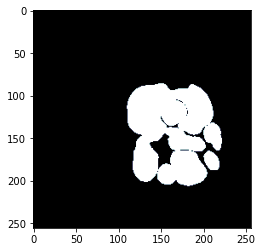

=== Slice 1542 ===


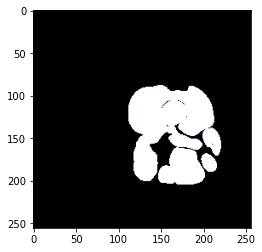

=== Slice 1544 ===


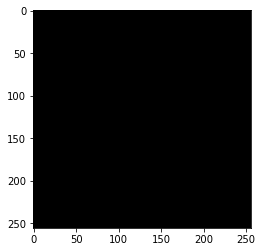

=== Slice 1546 ===


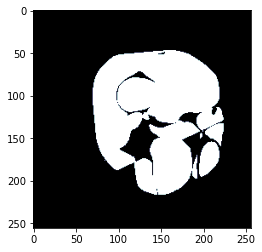

=== Slice 1548 ===


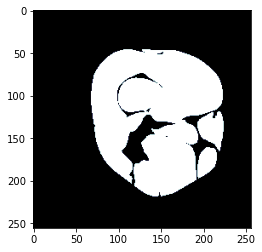

=== Slice 1550 ===


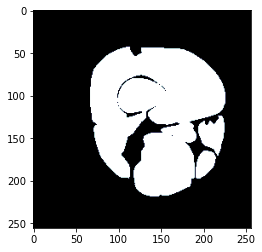

=== Slice 1552 ===


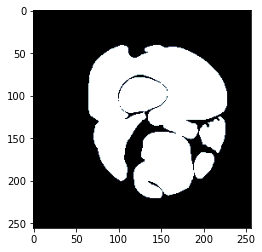

=== Slice 1554 ===


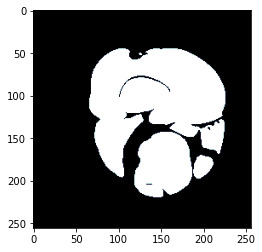

=== Slice 1556 ===


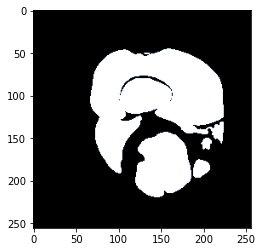

=== Slice 1558 ===


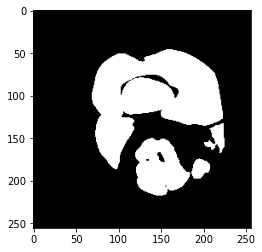

=== Slice 1560 ===


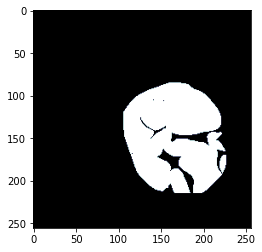

=== Slice 1562 ===


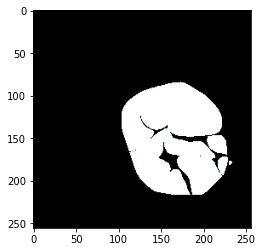

=== Slice 1564 ===


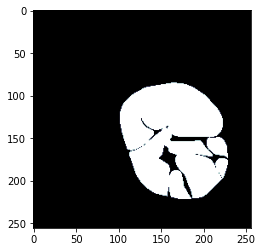

=== Slice 1566 ===


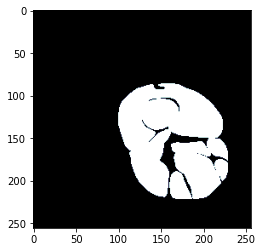

=== Slice 1568 ===


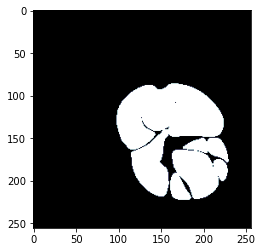

=== Slice 1570 ===


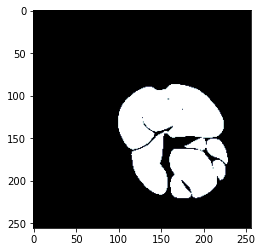

=== Slice 1572 ===


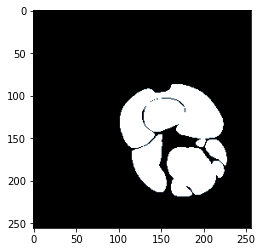

=== Slice 1574 ===


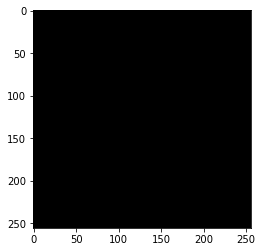

=== Slice 1576 ===


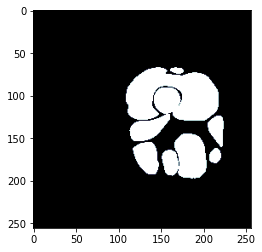

=== Slice 1578 ===


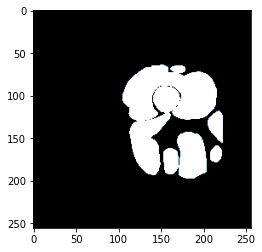

=== Slice 1580 ===


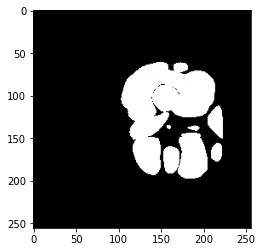

=== Slice 1582 ===


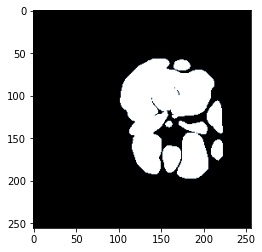

=== Slice 1584 ===


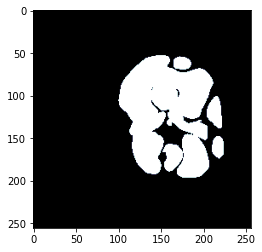

=== Slice 1586 ===


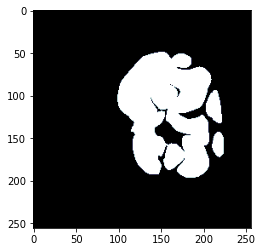

=== Slice 1588 ===


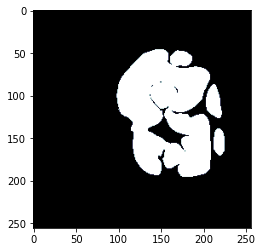

=== Slice 1590 ===


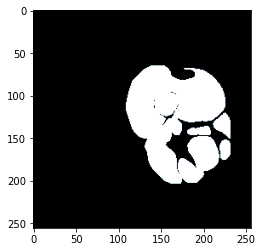

=== Slice 1592 ===


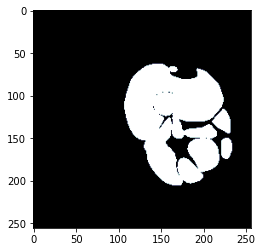

=== Slice 1594 ===


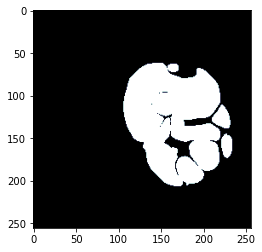

=== Slice 1596 ===


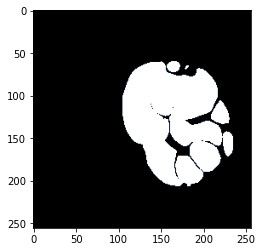

=== Slice 1598 ===


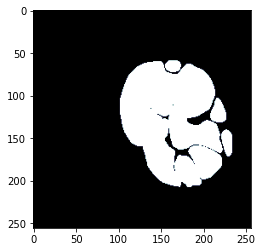

=== Slice 1600 ===


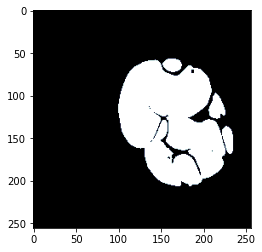

=== Slice 1602 ===


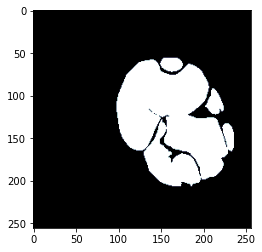

=== Slice 1604 ===


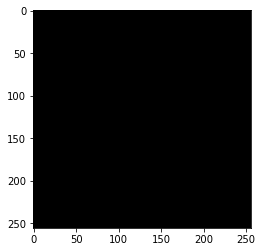

=== Slice 1606 ===


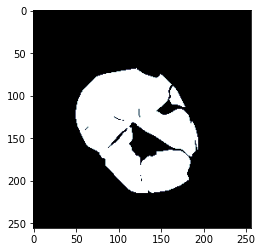

=== Slice 1608 ===


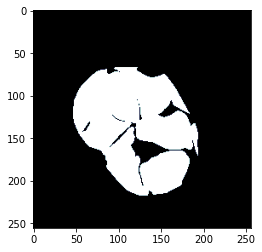

=== Slice 1610 ===


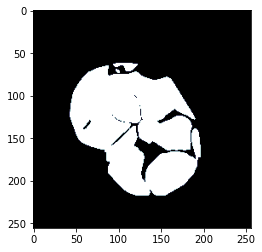

=== Slice 1612 ===


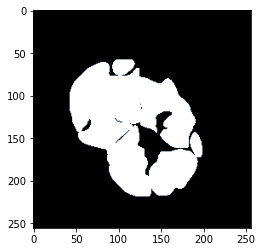

=== Slice 1614 ===


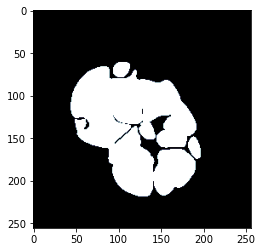

=== Slice 1616 ===


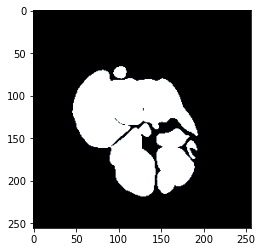

=== Slice 1618 ===


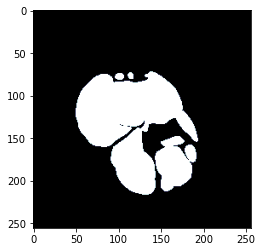

=== Slice 1620 ===


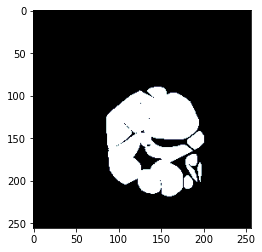

=== Slice 1622 ===


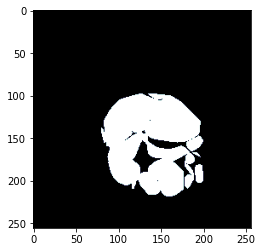

=== Slice 1624 ===


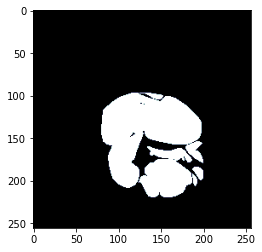

=== Slice 1626 ===


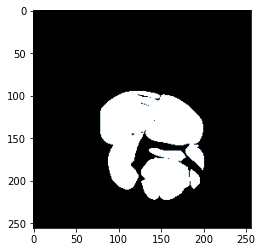

=== Slice 1628 ===


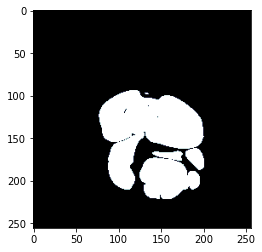

=== Slice 1630 ===


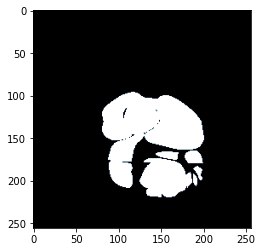

=== Slice 1632 ===


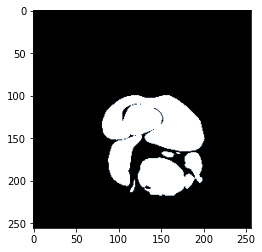

=== Slice 1634 ===


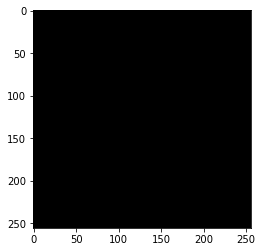

=== Slice 1636 ===


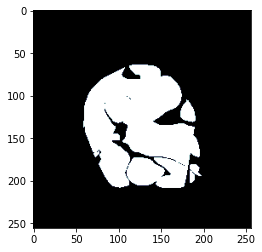

=== Slice 1638 ===


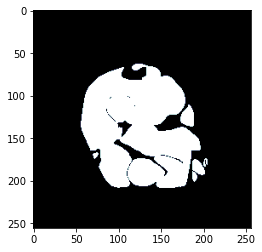

=== Slice 1640 ===


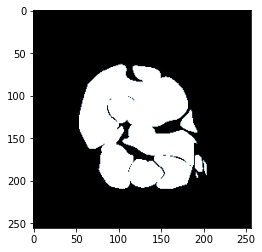

=== Slice 1642 ===


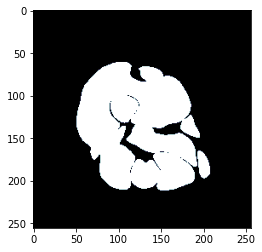

=== Slice 1644 ===


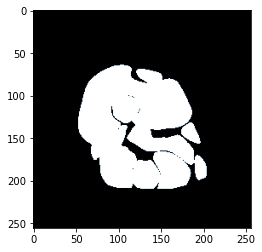

=== Slice 1646 ===


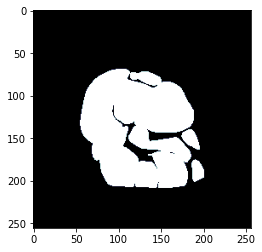

=== Slice 1648 ===


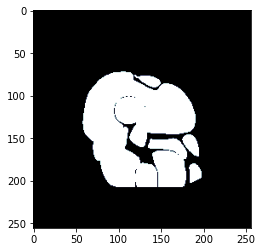

=== Slice 1650 ===


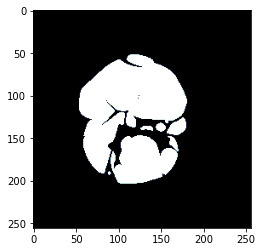

=== Slice 1652 ===


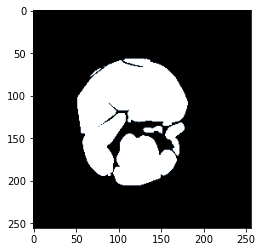

=== Slice 1654 ===


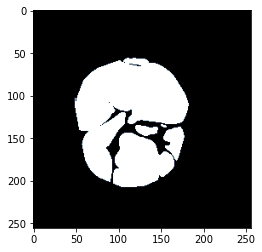

=== Slice 1656 ===


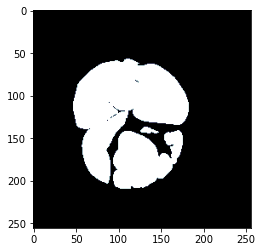

=== Slice 1658 ===


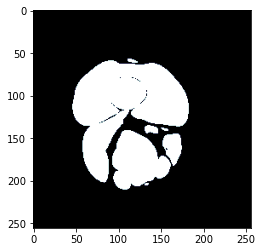

=== Slice 1660 ===


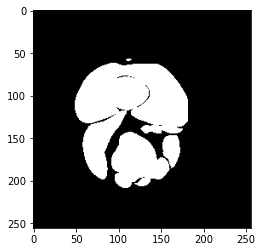

=== Slice 1662 ===


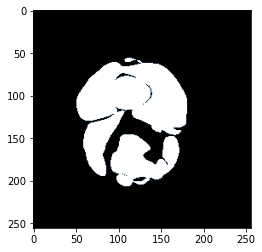

=== Slice 1664 ===


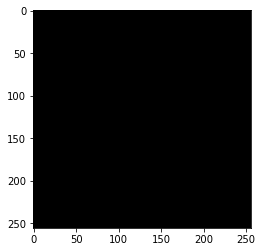

=== Slice 1666 ===


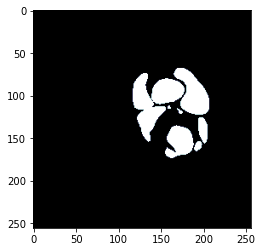

=== Slice 1668 ===


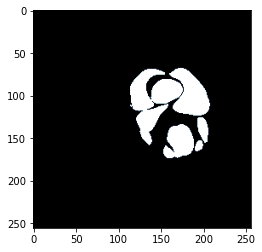

=== Slice 1670 ===


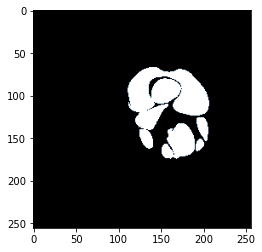

=== Slice 1672 ===


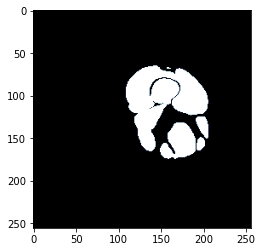

=== Slice 1674 ===


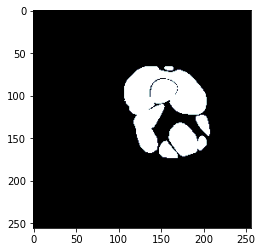

=== Slice 1676 ===


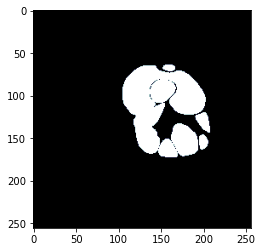

=== Slice 1678 ===


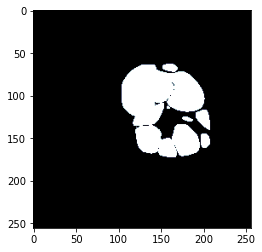

=== Slice 1680 ===


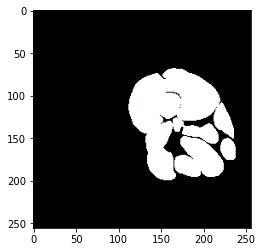

=== Slice 1682 ===


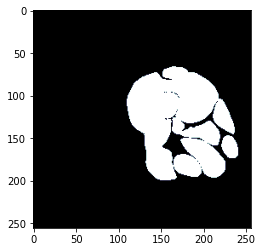

=== Slice 1684 ===


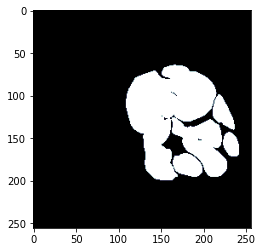

=== Slice 1686 ===


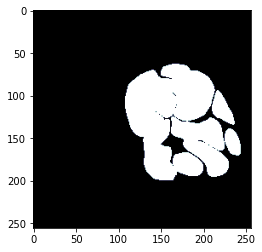

=== Slice 1688 ===


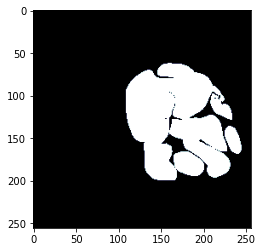

=== Slice 1690 ===


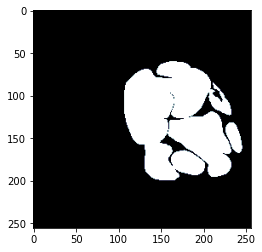

=== Slice 1692 ===


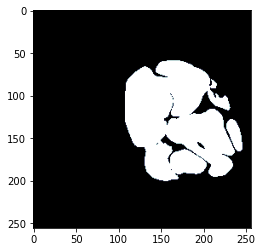

=== Slice 1694 ===


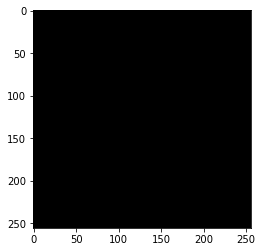

=== Slice 1696 ===


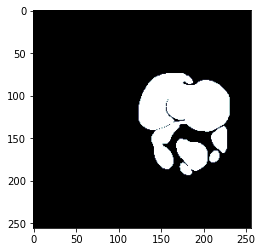

=== Slice 1698 ===


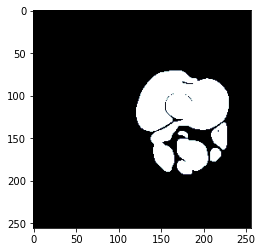

=== Slice 1700 ===


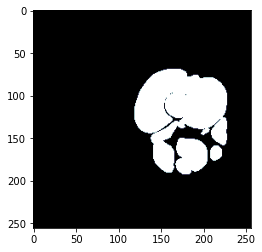

=== Slice 1702 ===


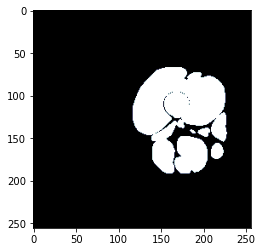

=== Slice 1704 ===


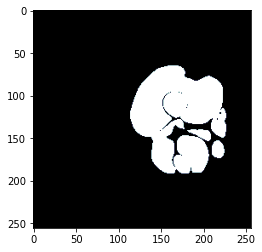

=== Slice 1706 ===


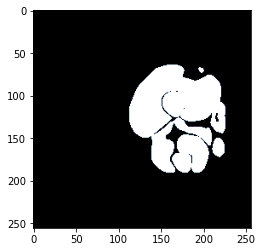

=== Slice 1708 ===


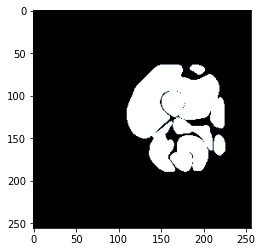

=== Slice 1710 ===


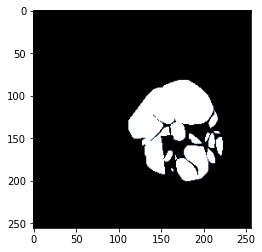

=== Slice 1712 ===


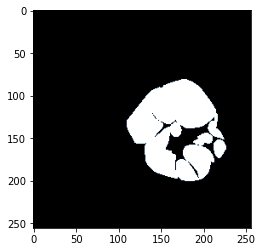

=== Slice 1714 ===


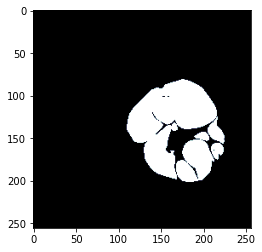

=== Slice 1716 ===


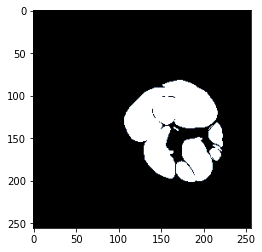

=== Slice 1718 ===


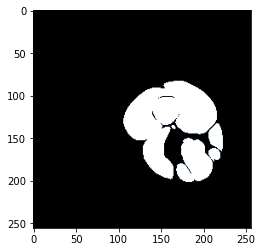

=== Slice 1720 ===


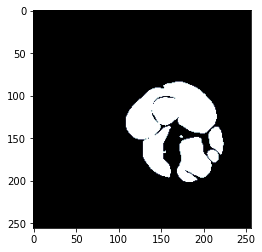

=== Slice 1722 ===


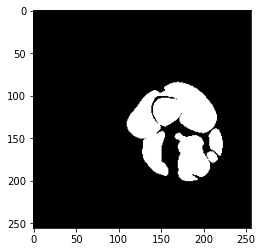

=== Slice 1724 ===


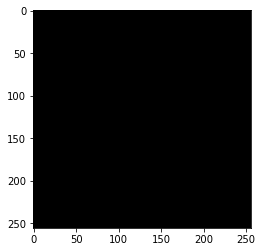

=== Slice 1726 ===


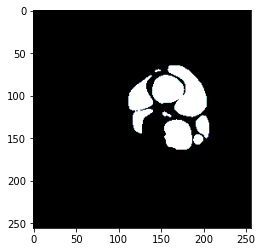

=== Slice 1728 ===


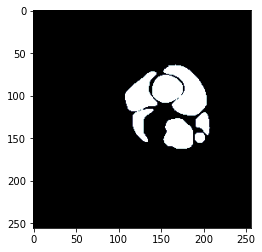

=== Slice 1730 ===


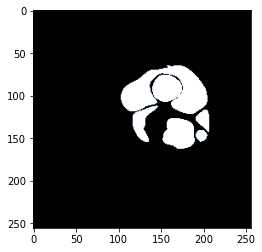

=== Slice 1732 ===


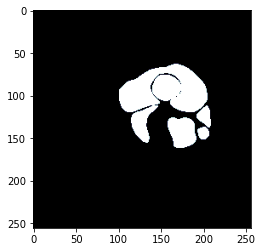

=== Slice 1734 ===


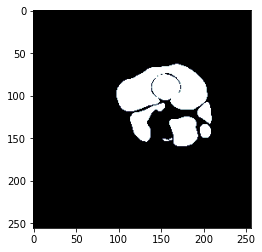

=== Slice 1736 ===


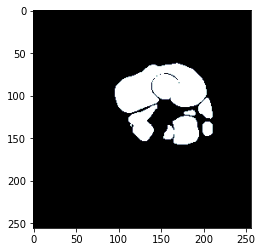

=== Slice 1738 ===


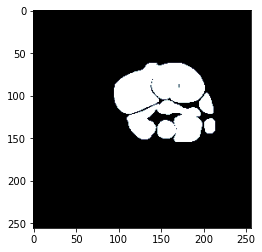

=== Slice 1740 ===


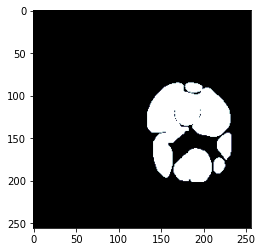

=== Slice 1742 ===


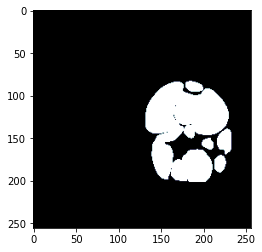

=== Slice 1744 ===


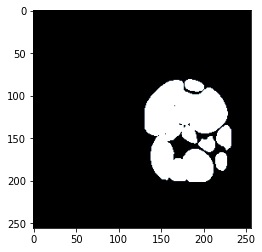

=== Slice 1746 ===


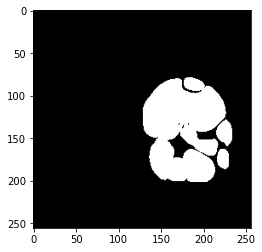

=== Slice 1748 ===


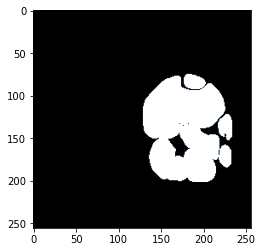

=== Slice 1750 ===


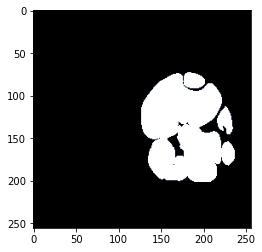

=== Slice 1752 ===


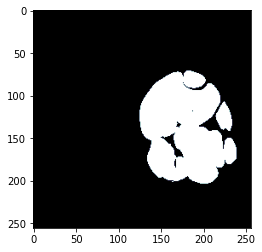

=== Slice 1754 ===


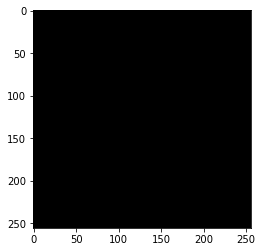

=== Slice 1756 ===


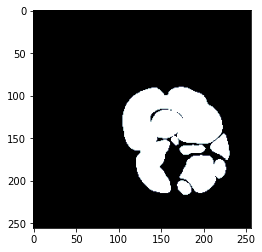

=== Slice 1758 ===


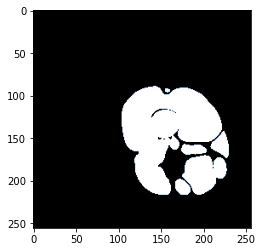

=== Slice 1760 ===


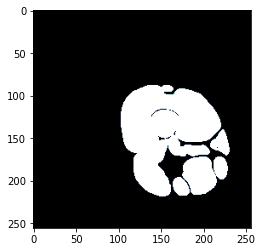

=== Slice 1762 ===


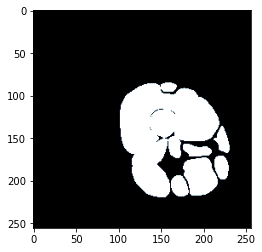

=== Slice 1764 ===


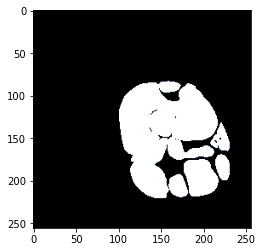

=== Slice 1766 ===


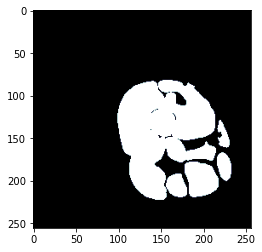

=== Slice 1768 ===


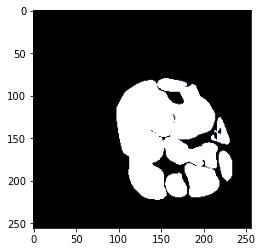

=== Slice 1770 ===


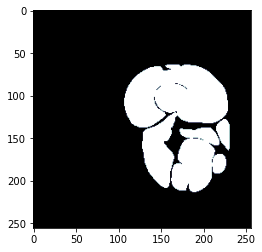

=== Slice 1772 ===


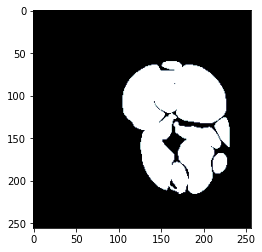

=== Slice 1774 ===


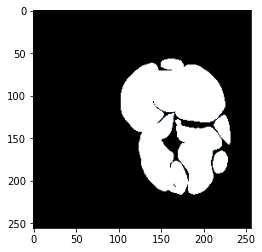

=== Slice 1776 ===


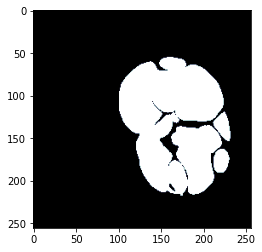

=== Slice 1778 ===


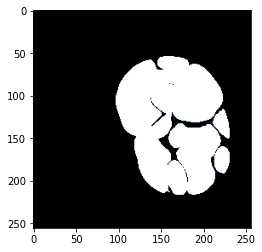

=== Slice 1780 ===


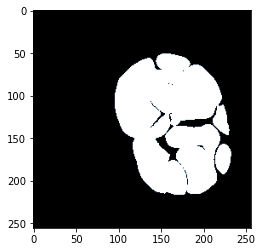

=== Slice 1782 ===


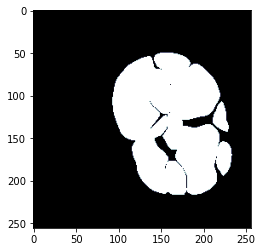

=== Slice 1784 ===


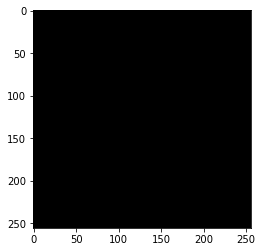

=== Slice 1786 ===


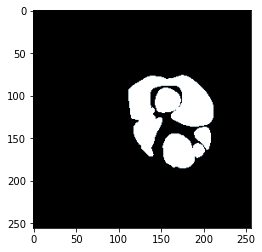

=== Slice 1788 ===


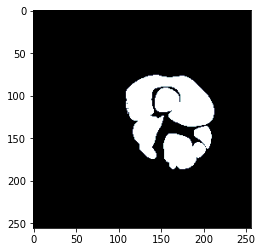

=== Slice 1790 ===


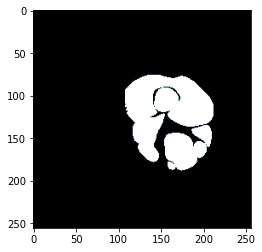

=== Slice 1792 ===


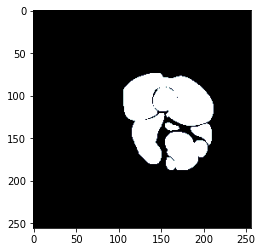

=== Slice 1794 ===


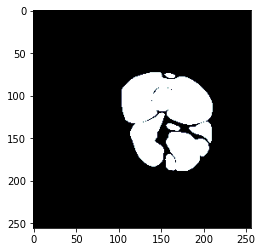

=== Slice 1796 ===


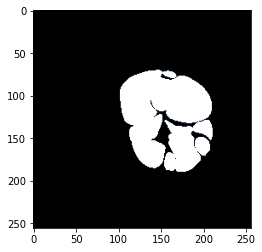

=== Slice 1798 ===


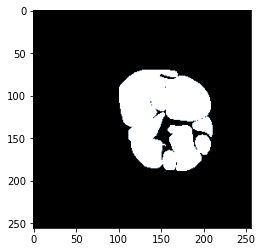

=== Slice 1800 ===


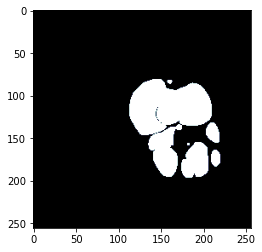

=== Slice 1802 ===


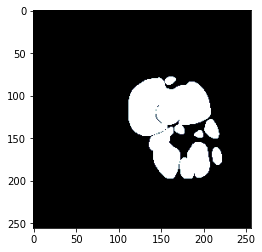

=== Slice 1804 ===


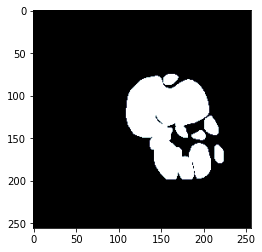

=== Slice 1806 ===


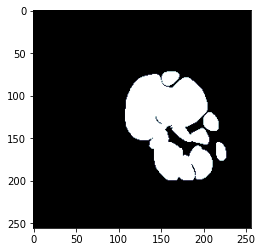

=== Slice 1808 ===


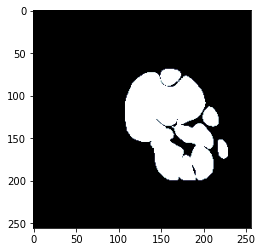

=== Slice 1810 ===


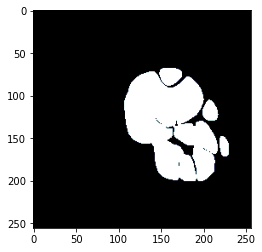

=== Slice 1812 ===


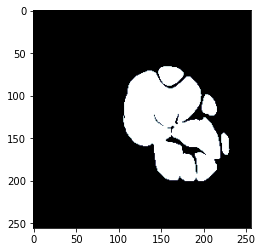

=== Slice 1814 ===


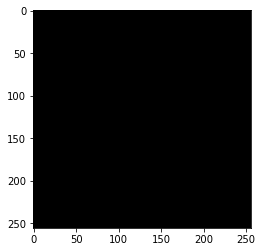

=== Slice 1816 ===


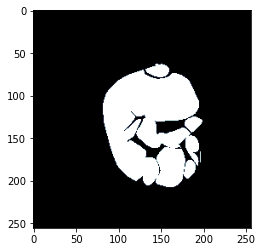

=== Slice 1818 ===


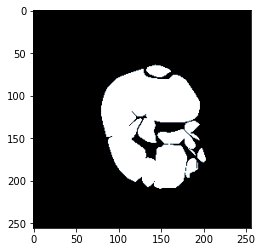

=== Slice 1820 ===


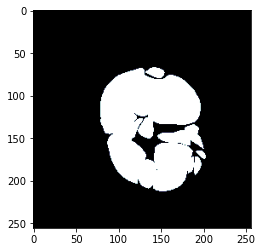

=== Slice 1822 ===


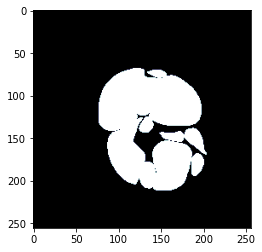

=== Slice 1824 ===


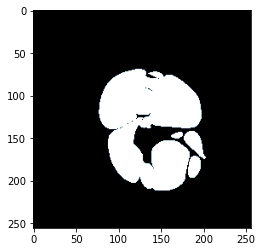

=== Slice 1826 ===


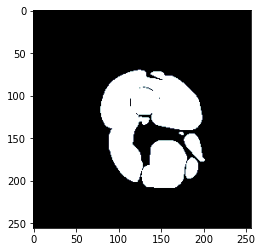

=== Slice 1828 ===


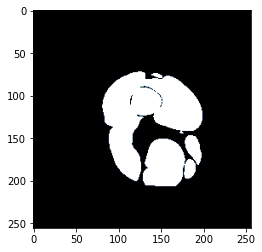

=== Slice 1830 ===


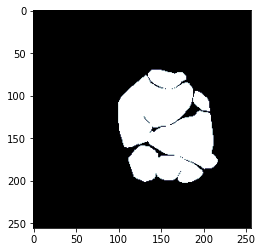

=== Slice 1832 ===


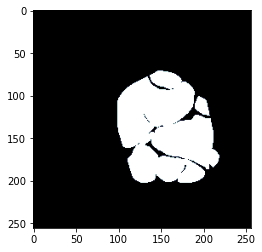

=== Slice 1834 ===


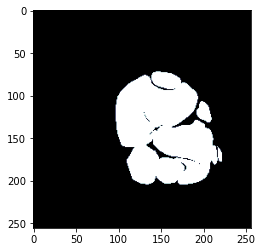

=== Slice 1836 ===


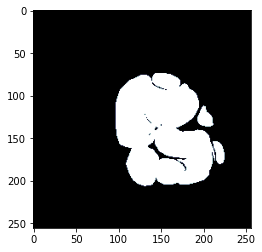

=== Slice 1838 ===


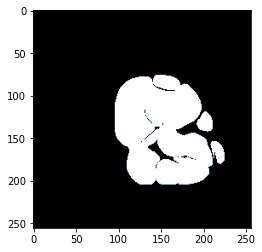

=== Slice 1840 ===


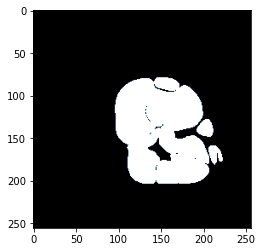

=== Slice 1842 ===


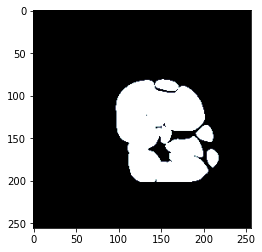

=== Slice 1844 ===


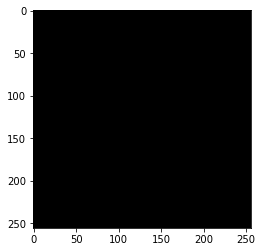

=== Slice 1846 ===


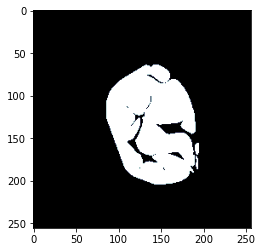

=== Slice 1848 ===


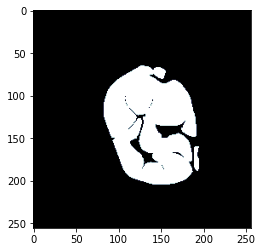

=== Slice 1850 ===


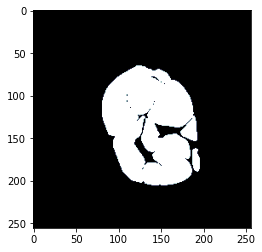

=== Slice 1852 ===


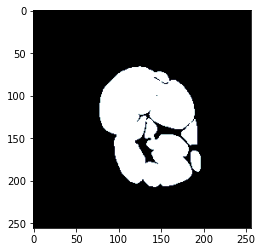

=== Slice 1854 ===


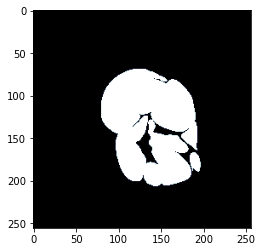

=== Slice 1856 ===


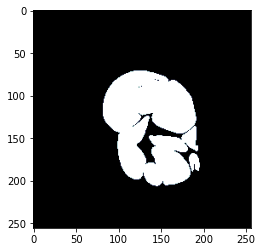

=== Slice 1858 ===


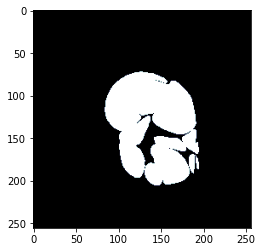

=== Slice 1860 ===


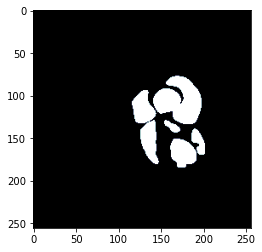

=== Slice 1862 ===


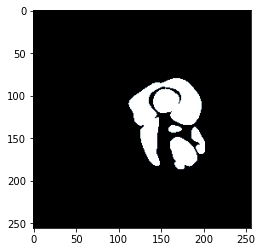

=== Slice 1864 ===


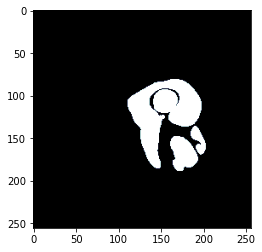

=== Slice 1866 ===


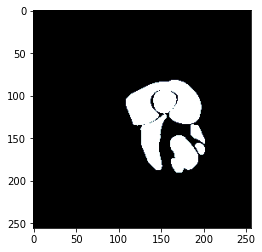

=== Slice 1868 ===


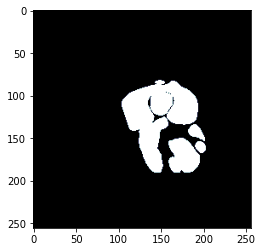

=== Slice 1870 ===


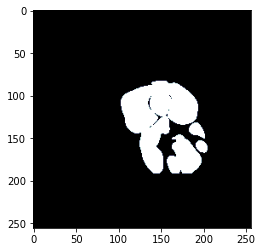

=== Slice 1872 ===


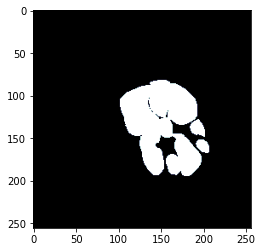

=== Slice 1874 ===


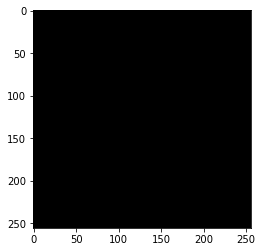

=== Slice 1876 ===


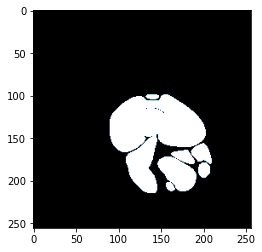

=== Slice 1878 ===


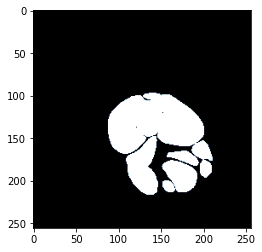

=== Slice 1880 ===


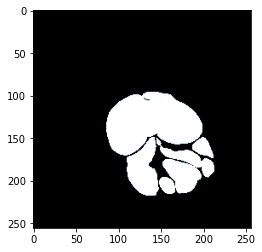

=== Slice 1882 ===


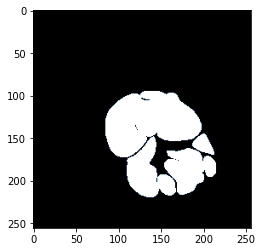

=== Slice 1884 ===


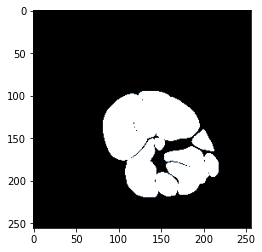

=== Slice 1886 ===


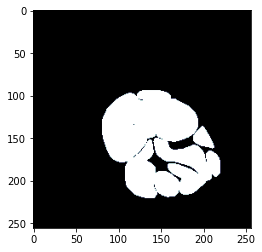

=== Slice 1888 ===


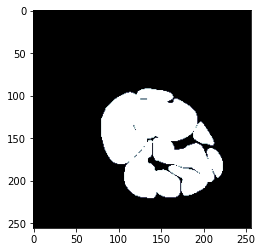

=== Slice 1890 ===


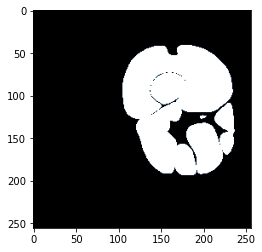

=== Slice 1892 ===


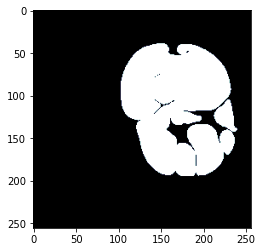

=== Slice 1894 ===


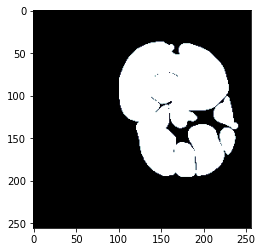

=== Slice 1896 ===


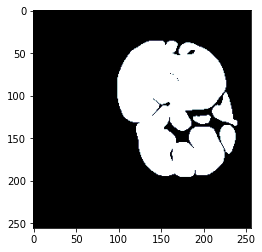

=== Slice 1898 ===


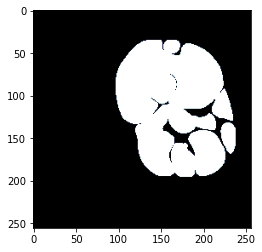

=== Slice 1900 ===


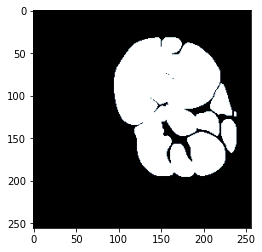

=== Slice 1902 ===


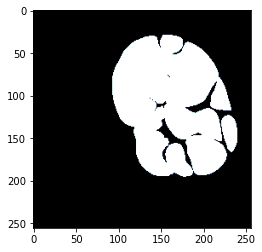

=== Slice 1904 ===


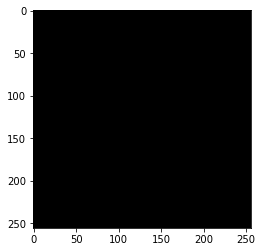

=== Slice 1906 ===


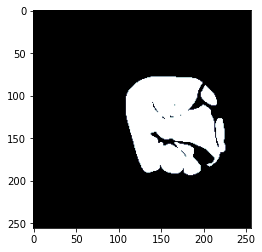

=== Slice 1908 ===


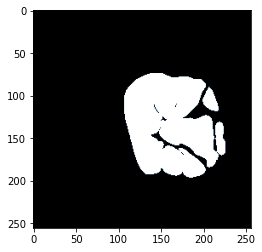

=== Slice 1910 ===


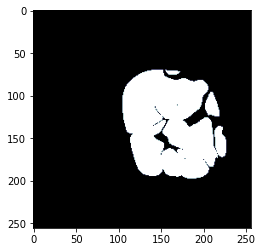

=== Slice 1912 ===


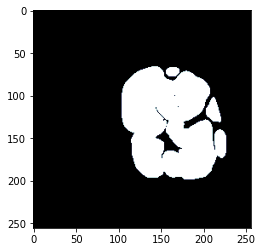

=== Slice 1914 ===


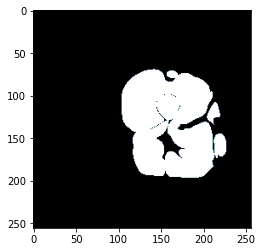

=== Slice 1916 ===


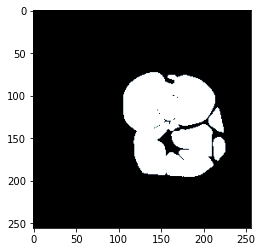

=== Slice 1918 ===


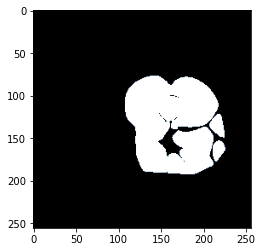

=== Slice 1920 ===


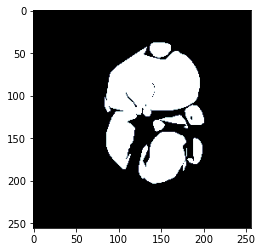

=== Slice 1922 ===


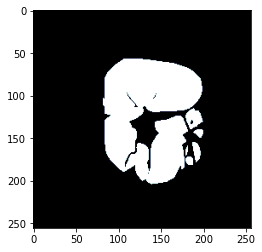

=== Slice 1924 ===


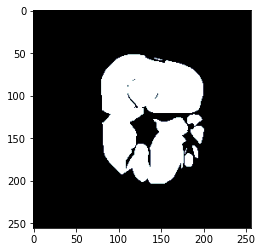

=== Slice 1926 ===


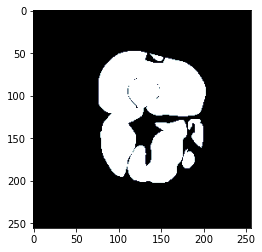

=== Slice 1928 ===


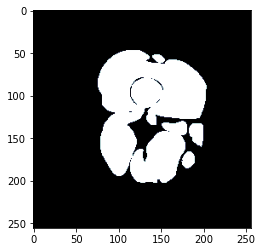

=== Slice 1930 ===


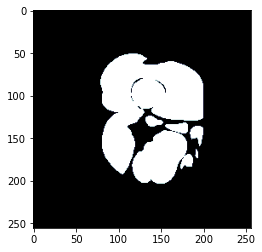

=== Slice 1932 ===


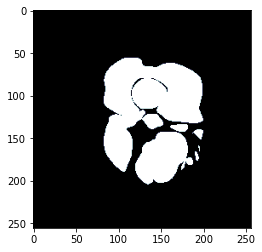

=== Slice 1934 ===


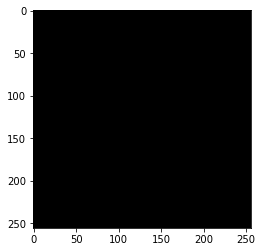

=== Slice 1936 ===


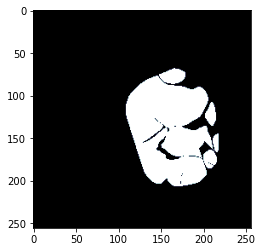

=== Slice 1938 ===


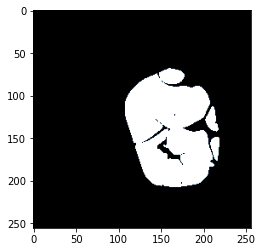

=== Slice 1940 ===


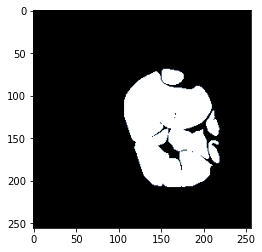

=== Slice 1942 ===


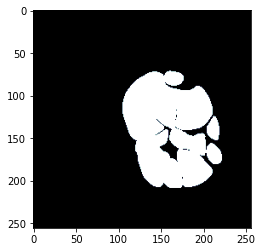

=== Slice 1944 ===


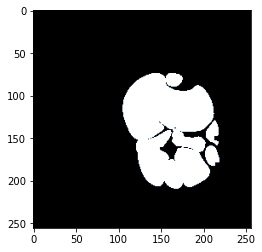

=== Slice 1946 ===


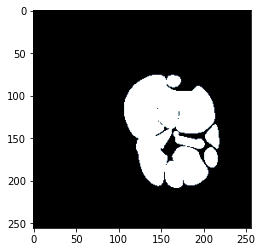

=== Slice 1948 ===


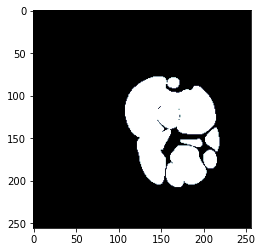

=== Slice 1950 ===


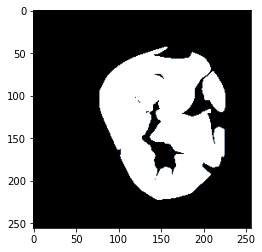

=== Slice 1952 ===


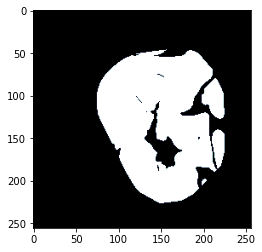

=== Slice 1954 ===


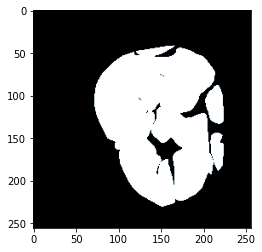

=== Slice 1956 ===


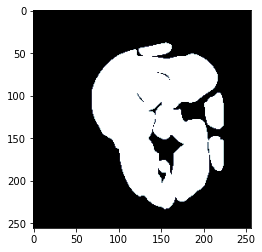

=== Slice 1958 ===


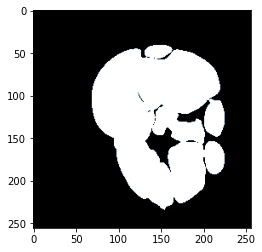

=== Slice 1960 ===


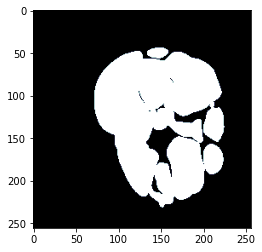

=== Slice 1962 ===


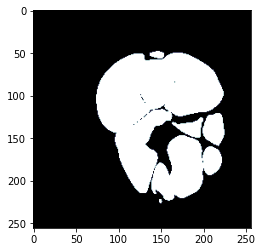

=== Slice 1964 ===


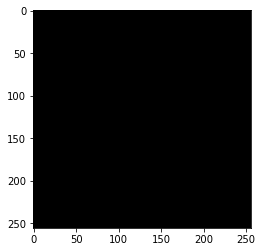

=== Slice 1966 ===


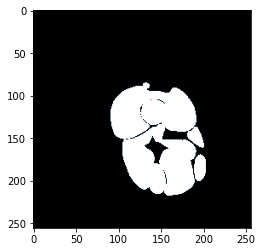

=== Slice 1968 ===


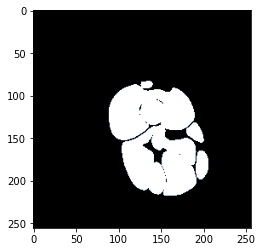

=== Slice 1970 ===


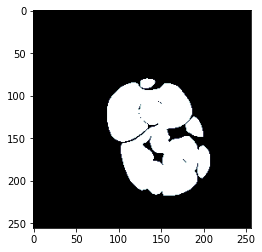

=== Slice 1972 ===


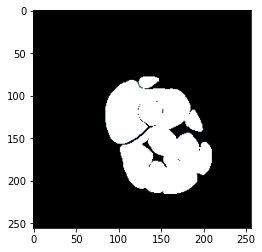

=== Slice 1974 ===


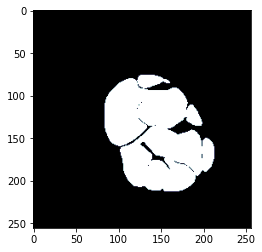

=== Slice 1976 ===


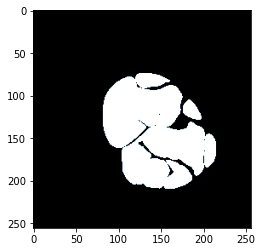

=== Slice 1978 ===


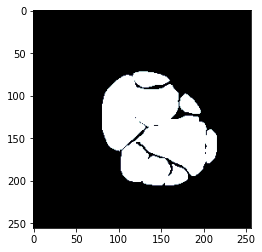

=== Slice 1980 ===


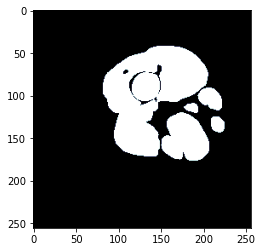

=== Slice 1982 ===


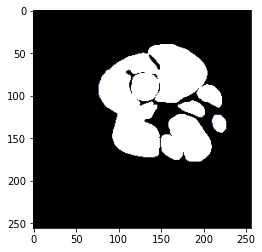

=== Slice 1984 ===


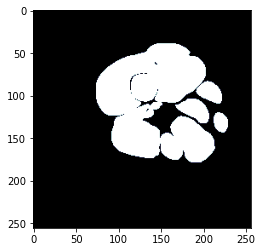

=== Slice 1986 ===


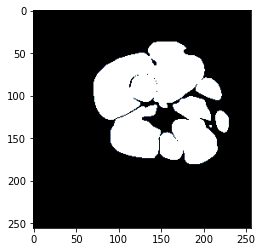

=== Slice 1988 ===


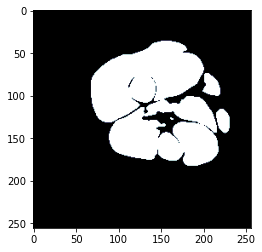

=== Slice 1990 ===


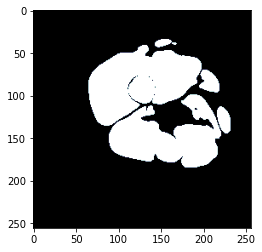

=== Slice 1992 ===


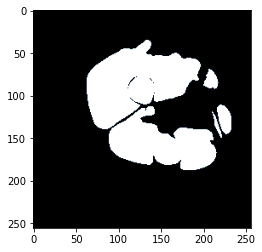

=== Slice 1994 ===


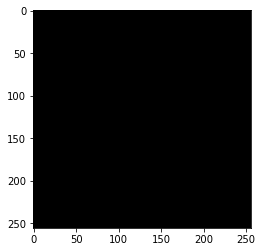

=== Slice 1996 ===


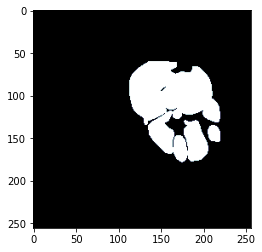

=== Slice 1998 ===


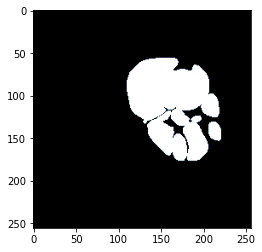

=== Slice 2000 ===


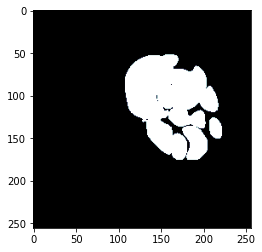

=== Slice 2002 ===


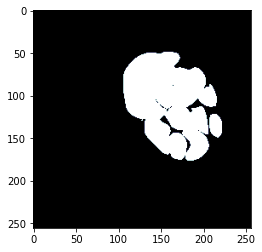

=== Slice 2004 ===


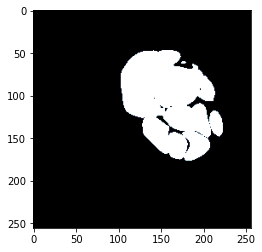

=== Slice 2006 ===


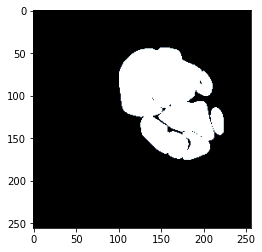

=== Slice 2008 ===


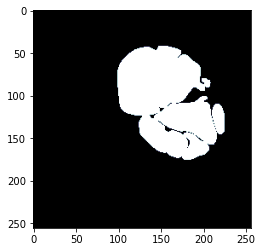

=== Slice 2010 ===


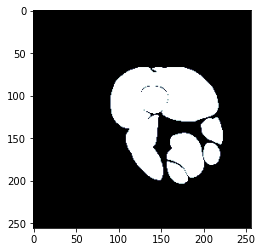

=== Slice 2012 ===


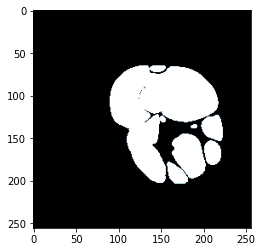

=== Slice 2014 ===


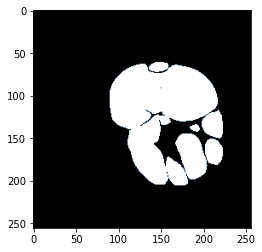

=== Slice 2016 ===


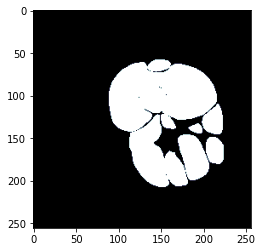

=== Slice 2018 ===


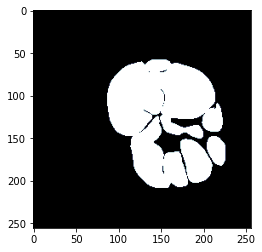

=== Slice 2020 ===


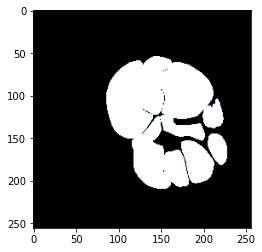

=== Slice 2022 ===


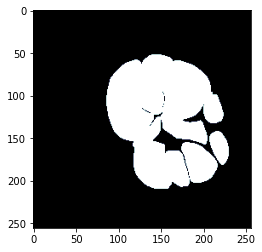

=== Slice 2024 ===


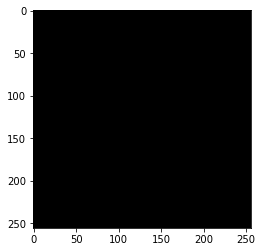

=== Slice 2026 ===


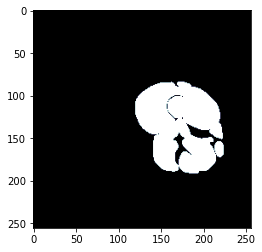

=== Slice 2028 ===


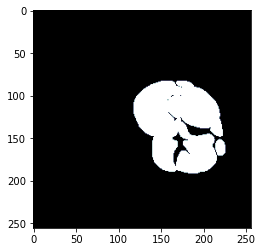

=== Slice 2030 ===


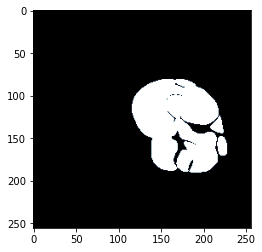

=== Slice 2032 ===


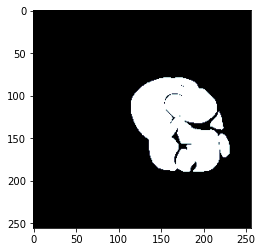

=== Slice 2034 ===


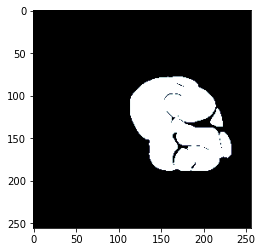

=== Slice 2036 ===


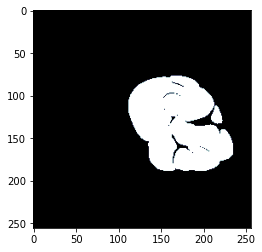

=== Slice 2038 ===


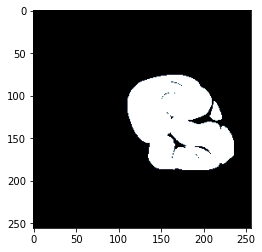

=== Slice 2040 ===


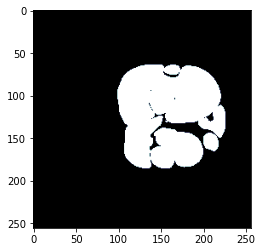

=== Slice 2042 ===


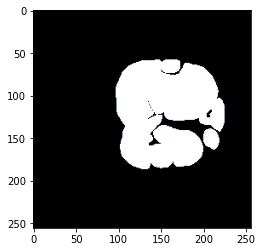

=== Slice 2044 ===


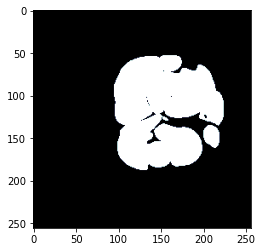

=== Slice 2046 ===


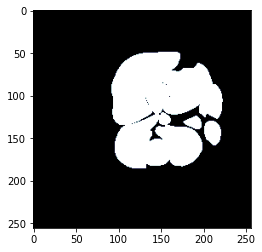

=== Slice 2048 ===


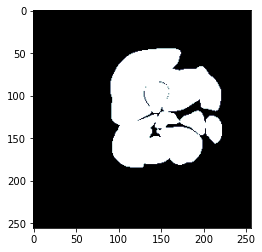

=== Slice 2050 ===


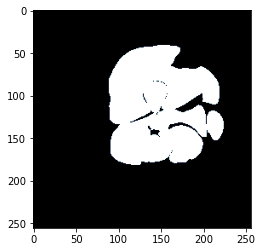

=== Slice 2052 ===


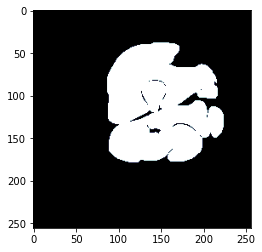

=== Slice 2054 ===


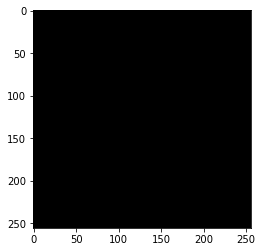

=== Slice 2056 ===


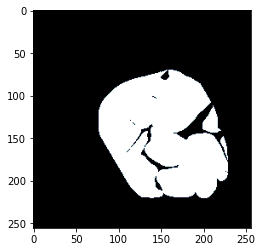

=== Slice 2058 ===


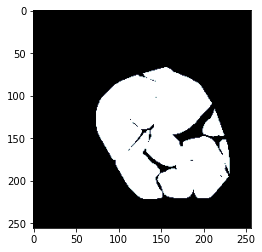

=== Slice 2060 ===


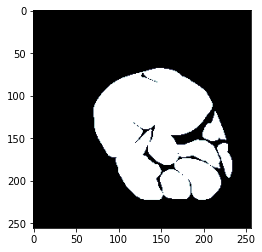

=== Slice 2062 ===


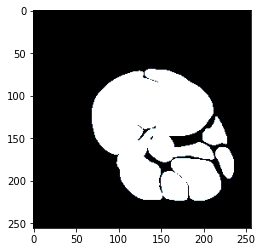

=== Slice 2064 ===


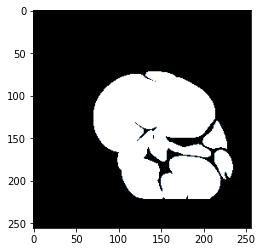

=== Slice 2066 ===


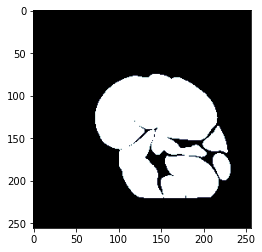

=== Slice 2068 ===


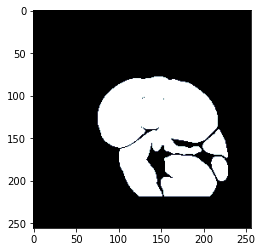

=== Slice 2070 ===


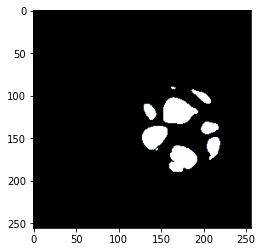

=== Slice 2072 ===


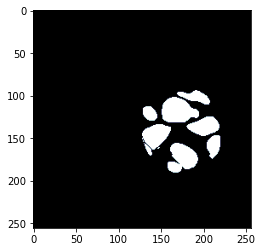

=== Slice 2074 ===


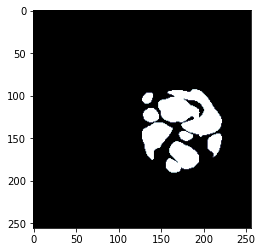

=== Slice 2076 ===


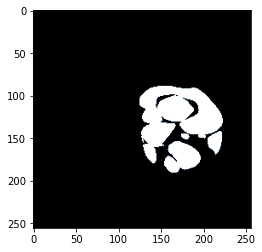

=== Slice 2078 ===


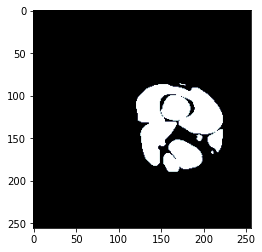

=== Slice 2080 ===


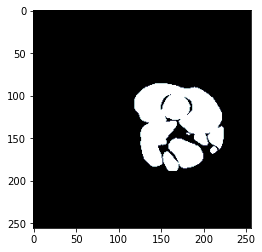

=== Slice 2082 ===


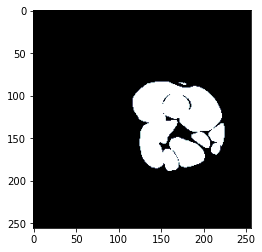

=== Slice 2084 ===


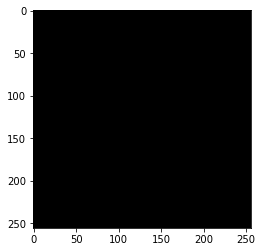

=== Slice 2086 ===


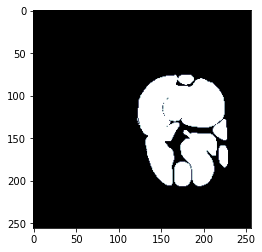

=== Slice 2088 ===


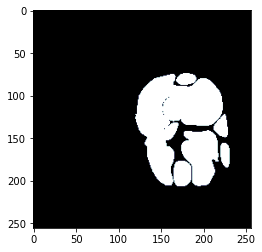

=== Slice 2090 ===


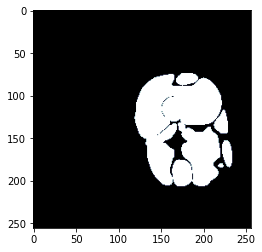

=== Slice 2092 ===


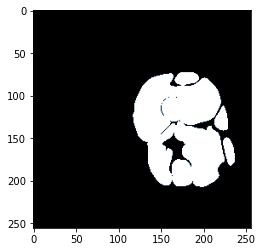

=== Slice 2094 ===


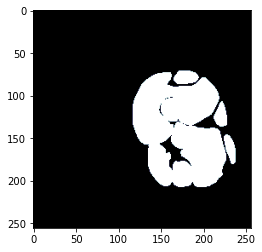

=== Slice 2096 ===


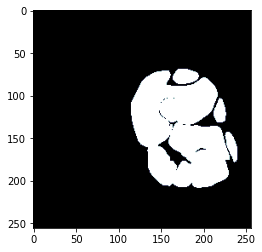

=== Slice 2098 ===


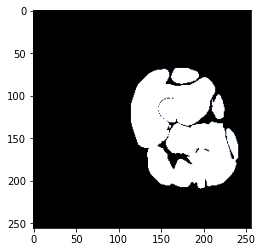

=== Slice 2100 ===


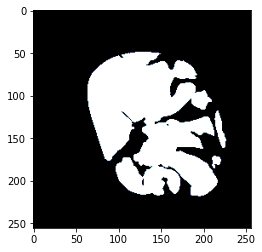

=== Slice 2102 ===


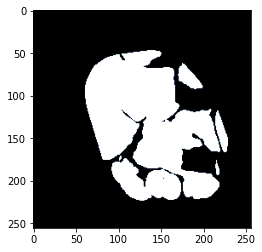

=== Slice 2104 ===


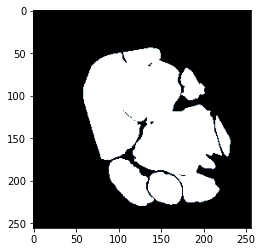

=== Slice 2106 ===


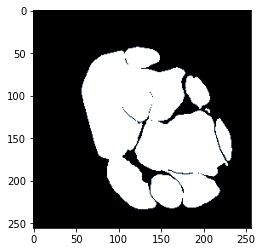

=== Slice 2108 ===


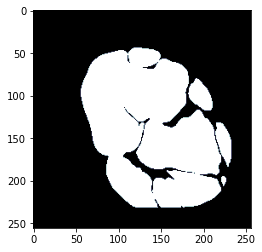

=== Slice 2110 ===


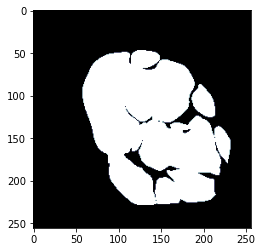

=== Slice 2112 ===


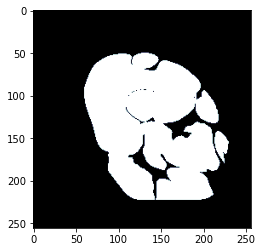

=== Slice 2114 ===


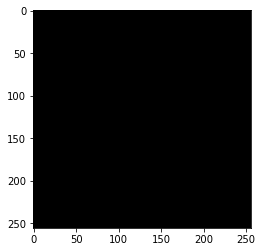

=== Slice 2116 ===


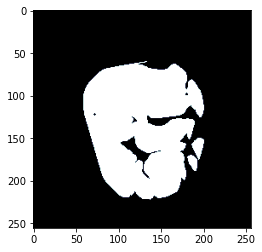

=== Slice 2118 ===


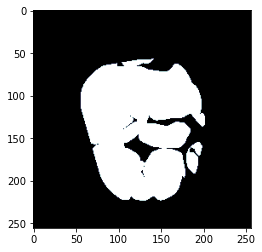

=== Slice 2120 ===


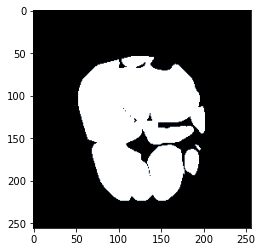

=== Slice 2122 ===


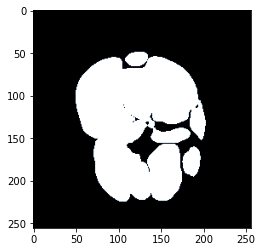

=== Slice 2124 ===


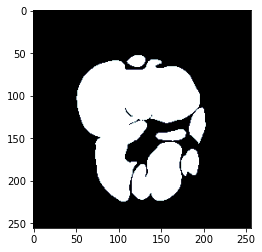

=== Slice 2126 ===


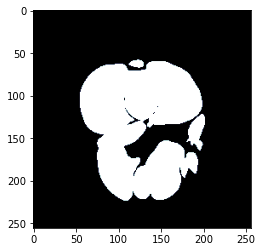

=== Slice 2128 ===


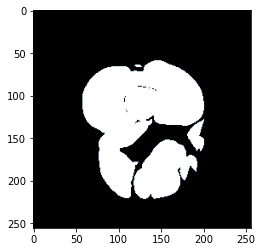

=== Slice 2130 ===


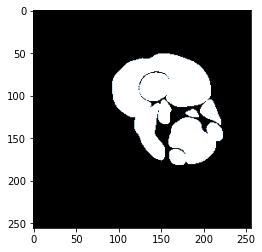

=== Slice 2132 ===


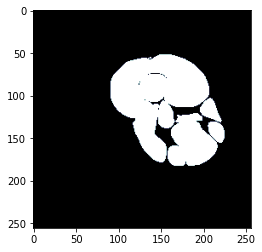

=== Slice 2134 ===


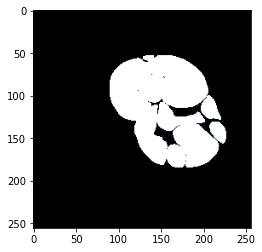

=== Slice 2136 ===


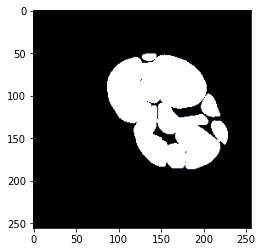

=== Slice 2138 ===


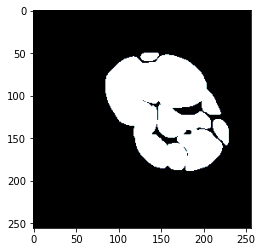

=== Slice 2140 ===


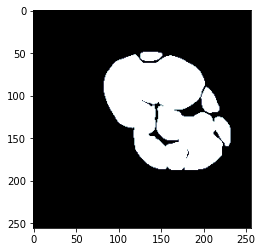

=== Slice 2142 ===


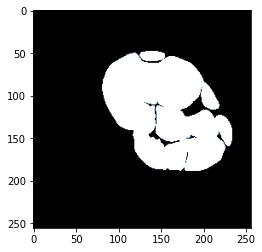

=== Slice 2144 ===


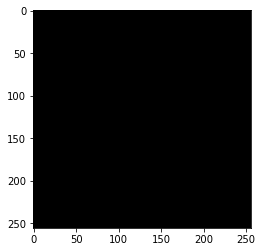

=== Slice 2146 ===


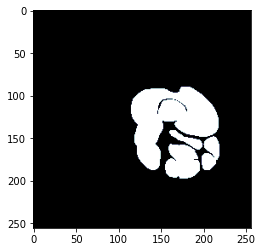

=== Slice 2148 ===


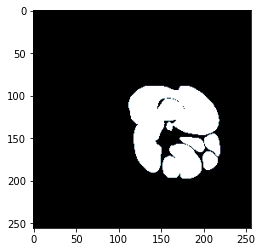

=== Slice 2150 ===


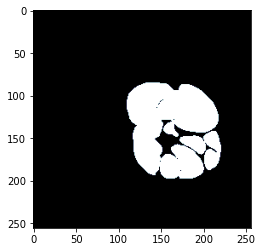

=== Slice 2152 ===


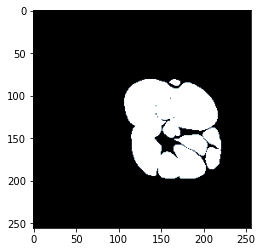

=== Slice 2154 ===


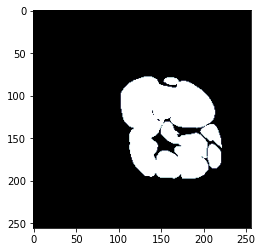

=== Slice 2156 ===


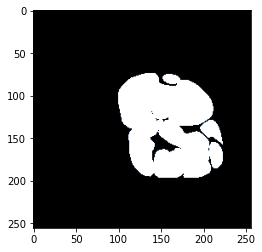

=== Slice 2158 ===


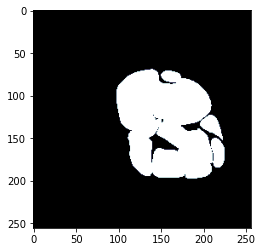

=== Slice 2160 ===


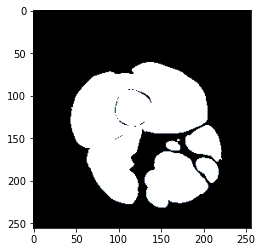

=== Slice 2162 ===


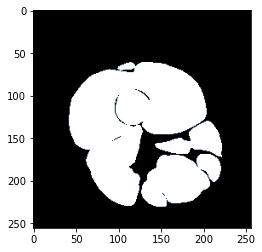

=== Slice 2164 ===


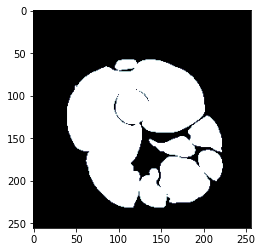

=== Slice 2166 ===


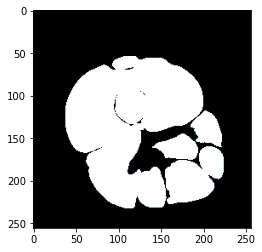

=== Slice 2168 ===


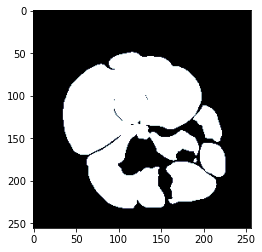

=== Slice 2170 ===


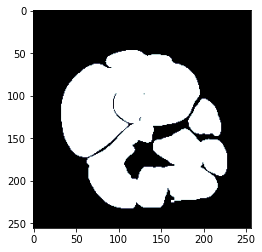

=== Slice 2172 ===


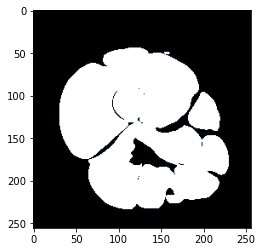

=== Slice 2174 ===


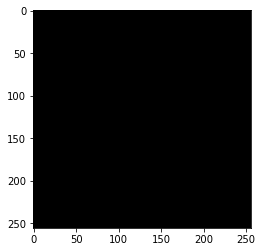

=== Slice 2176 ===


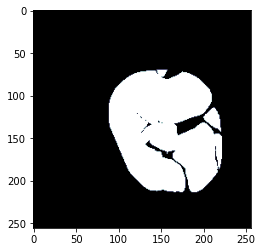

=== Slice 2178 ===


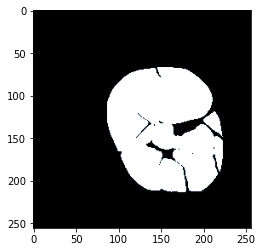

=== Slice 2180 ===


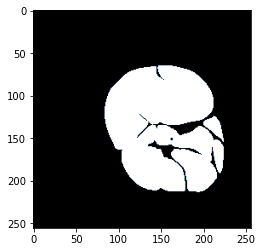

=== Slice 2182 ===


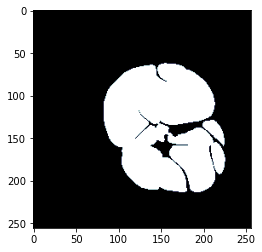

=== Slice 2184 ===


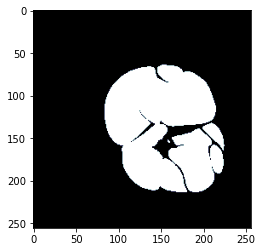

=== Slice 2186 ===


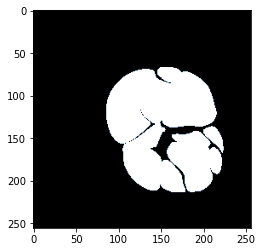

=== Slice 2188 ===


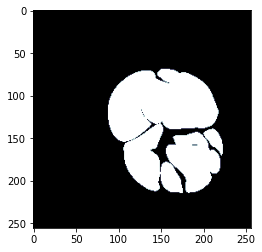

=== Slice 2190 ===


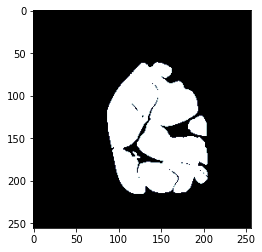

=== Slice 2192 ===


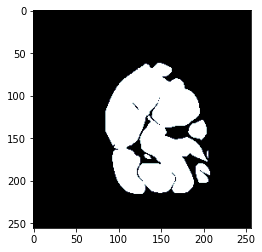

=== Slice 2194 ===


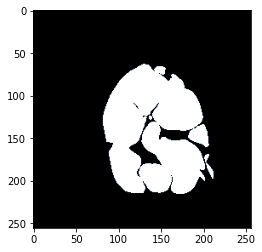

=== Slice 2196 ===


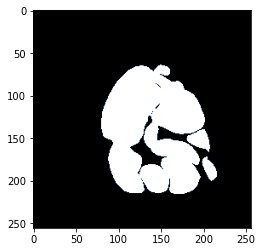

=== Slice 2198 ===


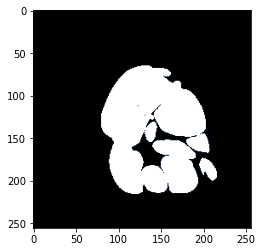

=== Slice 2200 ===


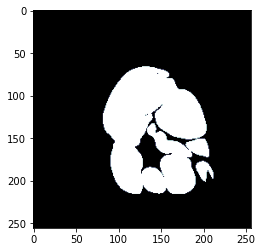

=== Slice 2202 ===


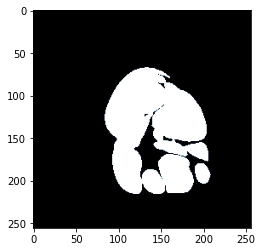

=== Slice 2204 ===


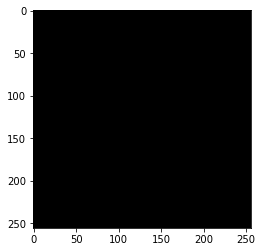

=== Slice 2206 ===


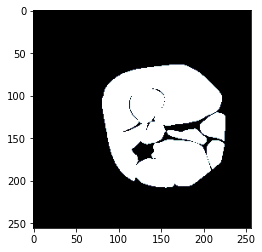

=== Slice 2208 ===


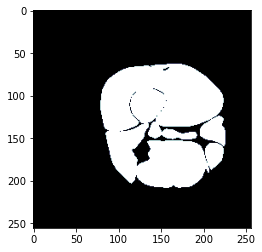

=== Slice 2210 ===


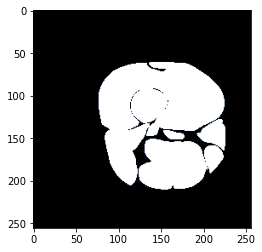

=== Slice 2212 ===


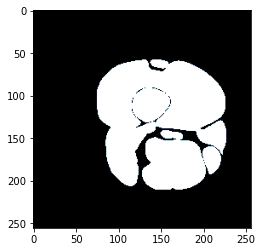

=== Slice 2214 ===


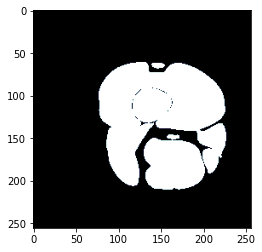

=== Slice 2216 ===


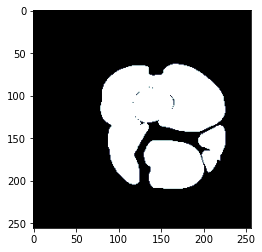

=== Slice 2218 ===


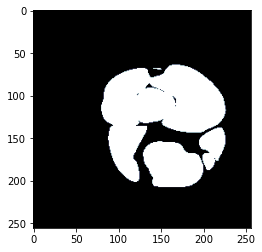

=== Slice 2220 ===


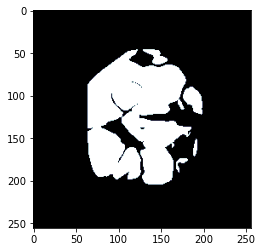

=== Slice 2222 ===


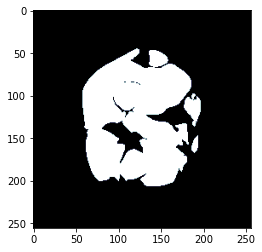

=== Slice 2224 ===


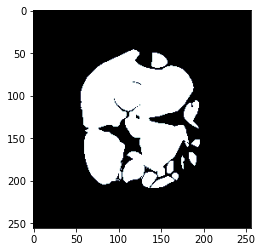

=== Slice 2226 ===


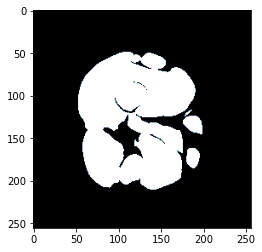

=== Slice 2228 ===


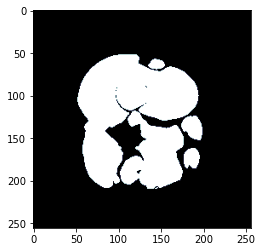

=== Slice 2230 ===


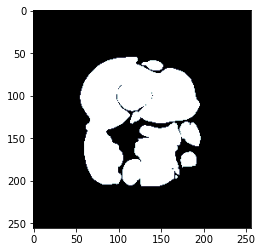

=== Slice 2232 ===


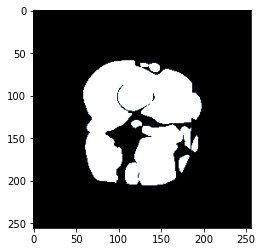

=== Slice 2234 ===


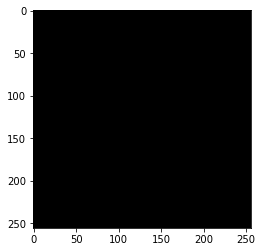

=== Slice 2236 ===


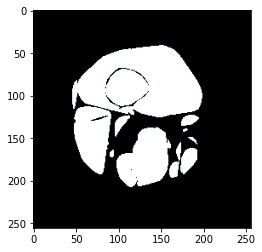

=== Slice 2238 ===


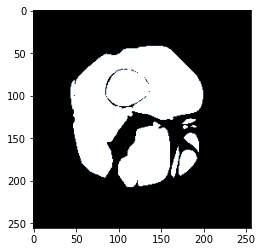

=== Slice 2240 ===


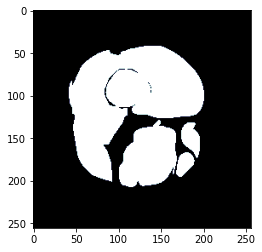

=== Slice 2242 ===


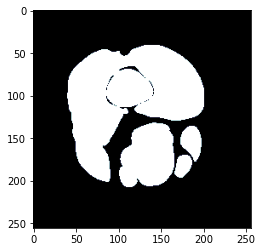

=== Slice 2244 ===


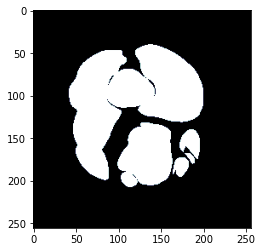

=== Slice 2246 ===


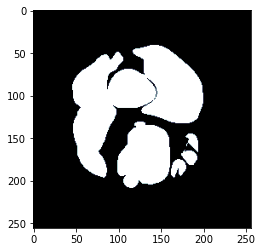

=== Slice 2248 ===


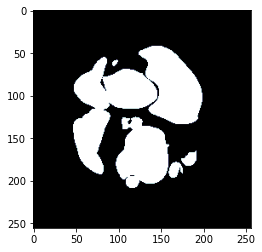

=== Slice 2250 ===


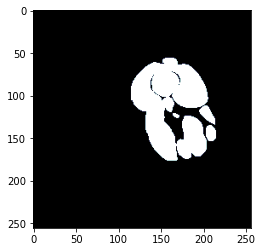

=== Slice 2252 ===


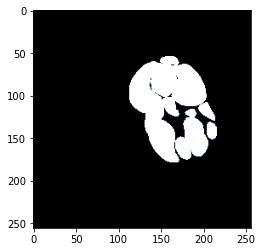

=== Slice 2254 ===


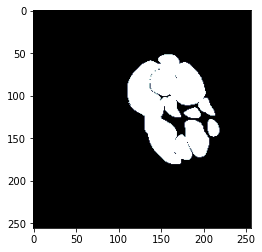

=== Slice 2256 ===


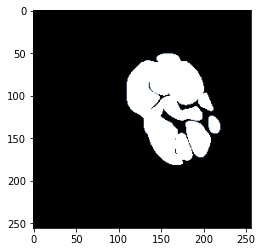

=== Slice 2258 ===


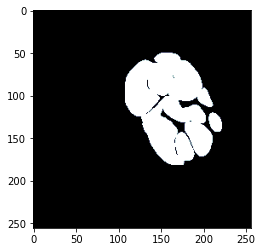

=== Slice 2260 ===


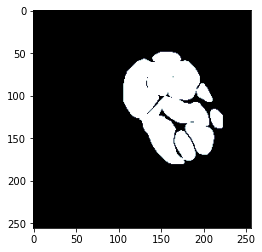

=== Slice 2262 ===


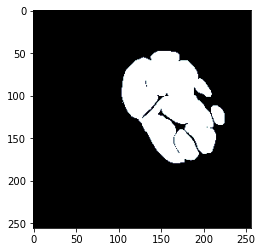

=== Slice 2264 ===


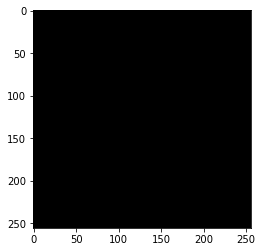

=== Slice 2266 ===


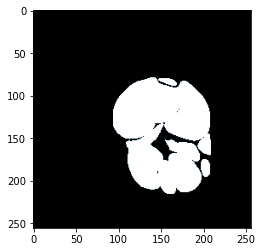

=== Slice 2268 ===


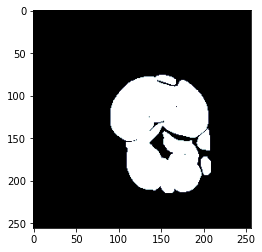

=== Slice 2270 ===


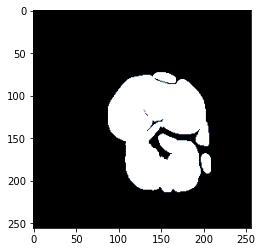

=== Slice 2272 ===


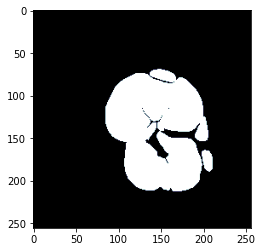

=== Slice 2274 ===


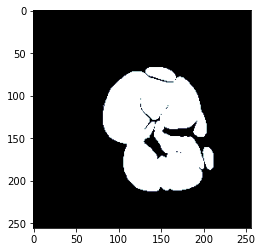

=== Slice 2276 ===


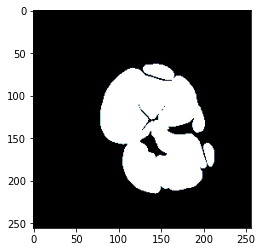

=== Slice 2278 ===


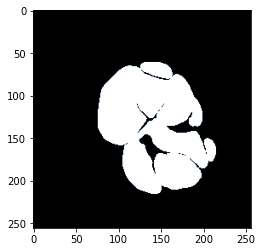

=== Slice 2280 ===


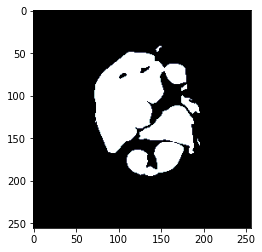

=== Slice 2282 ===


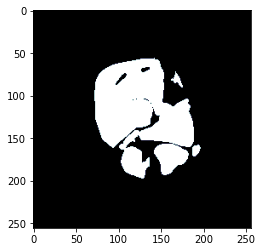

=== Slice 2284 ===


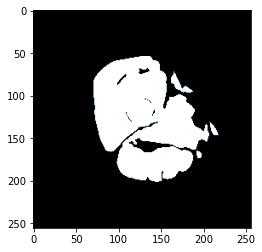

=== Slice 2286 ===


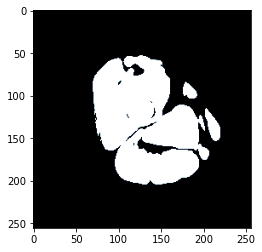

=== Slice 2288 ===


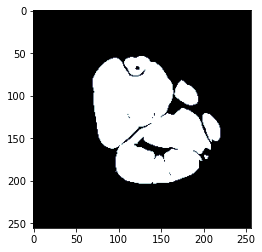

=== Slice 2290 ===


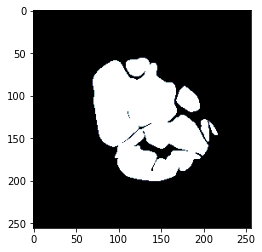

=== Slice 2292 ===


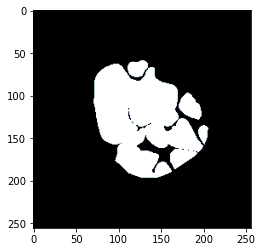

=== Slice 2294 ===


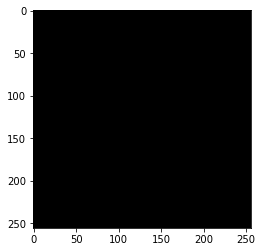

=== Slice 2296 ===


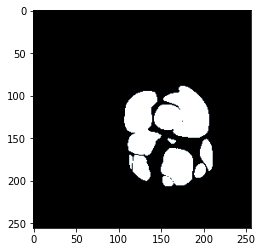

=== Slice 2298 ===


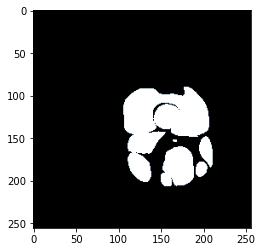

=== Slice 2300 ===


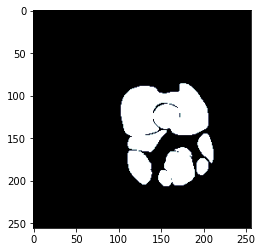

=== Slice 2302 ===


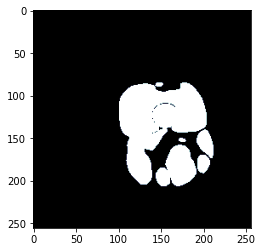

=== Slice 2304 ===


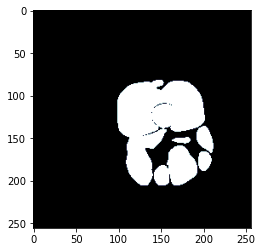

=== Slice 2306 ===


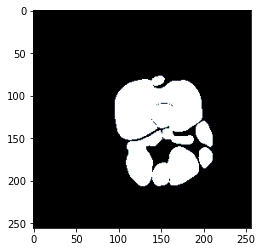

=== Slice 2308 ===


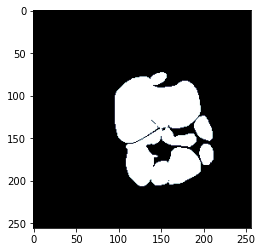

=== Slice 2310 ===


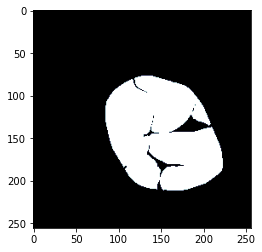

=== Slice 2312 ===


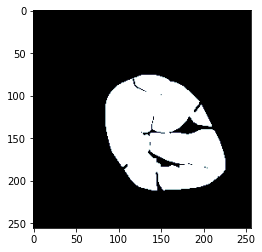

=== Slice 2314 ===


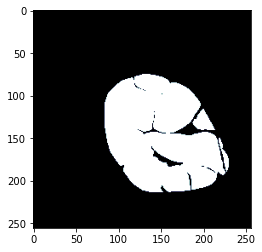

=== Slice 2316 ===


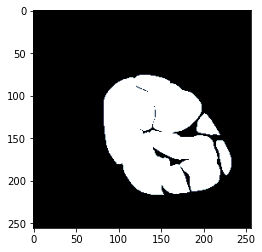

=== Slice 2318 ===


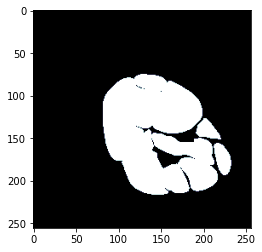

=== Slice 2320 ===


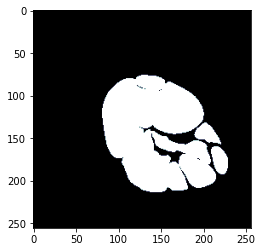

=== Slice 2322 ===


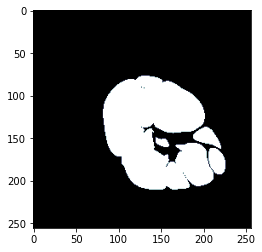

=== Slice 2324 ===


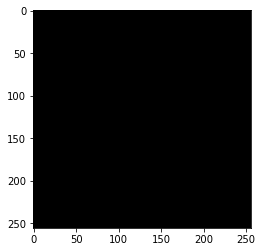

=== Slice 2326 ===


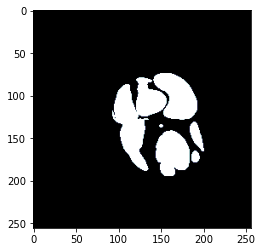

=== Slice 2328 ===


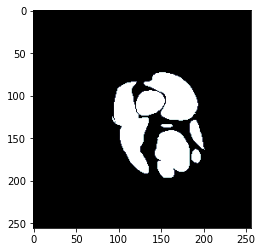

=== Slice 2330 ===


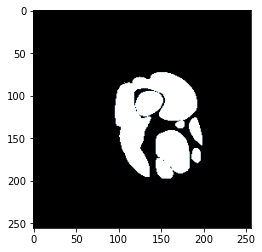

=== Slice 2332 ===


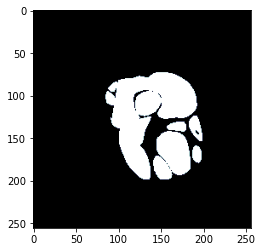

=== Slice 2334 ===


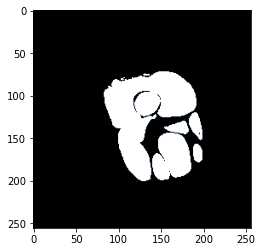

=== Slice 2336 ===


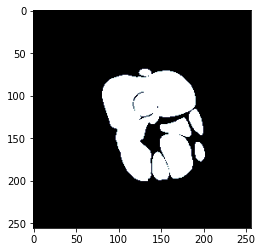

=== Slice 2338 ===


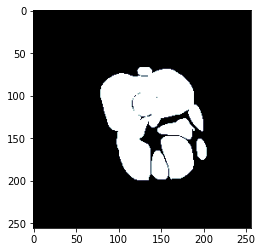

=== Slice 2340 ===


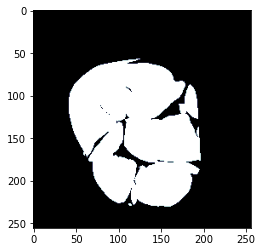

=== Slice 2342 ===


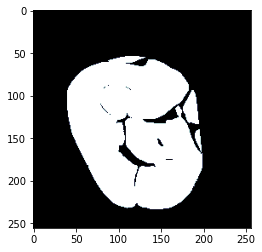

=== Slice 2344 ===


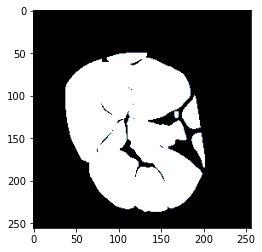

=== Slice 2346 ===


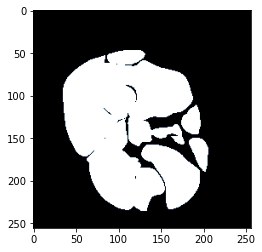

=== Slice 2348 ===


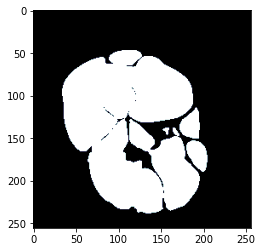

=== Slice 2350 ===


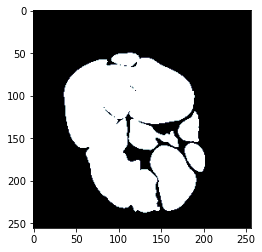

=== Slice 2352 ===


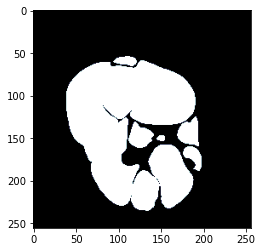

=== Slice 2354 ===


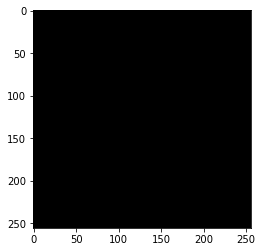

=== Slice 2356 ===


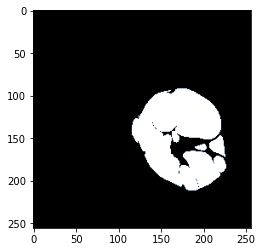

=== Slice 2358 ===


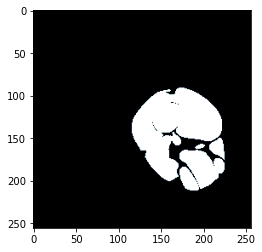

=== Slice 2360 ===


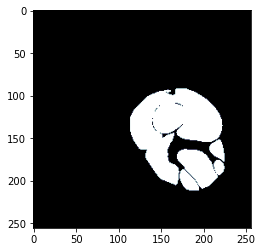

=== Slice 2362 ===


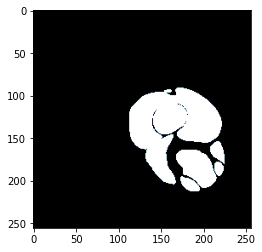

=== Slice 2364 ===


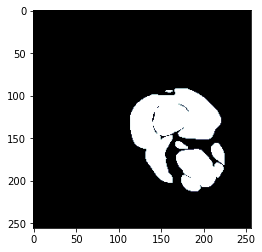

=== Slice 2366 ===


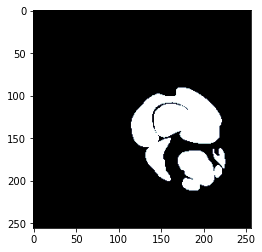

=== Slice 2368 ===


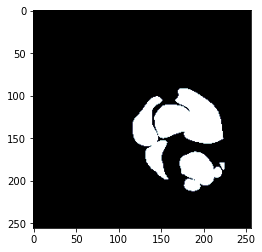

=== Slice 2370 ===


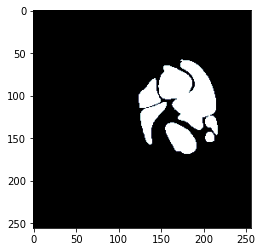

=== Slice 2372 ===


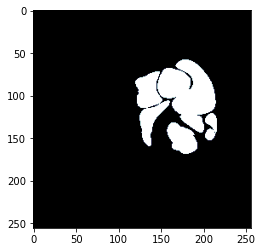

=== Slice 2374 ===


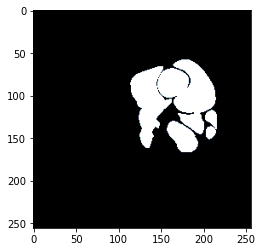

=== Slice 2376 ===


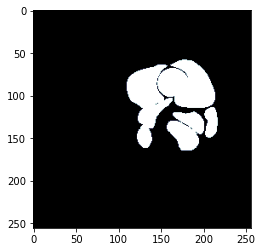

=== Slice 2378 ===


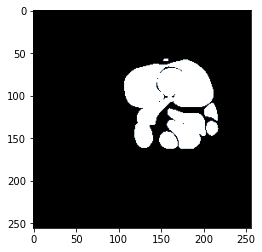

=== Slice 2380 ===


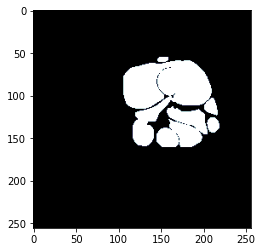

=== Slice 2382 ===


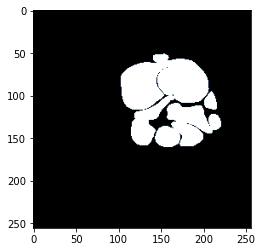

=== Slice 2384 ===


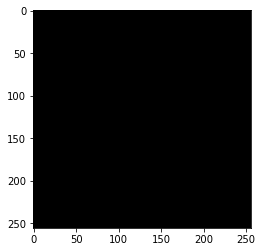

=== Slice 2386 ===


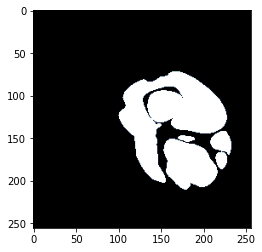

=== Slice 2388 ===


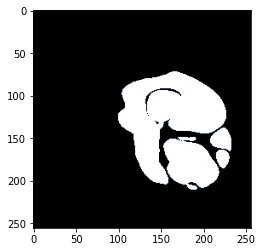

=== Slice 2390 ===


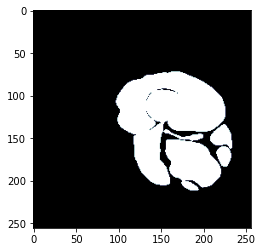

=== Slice 2392 ===


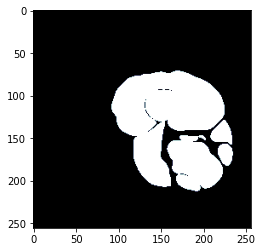

=== Slice 2394 ===


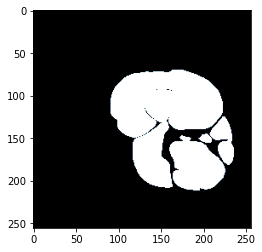

=== Slice 2396 ===


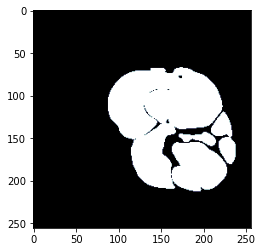

=== Slice 2398 ===


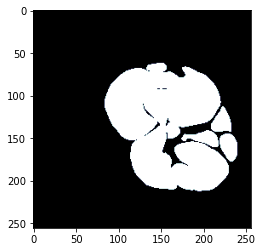

=== Slice 2400 ===


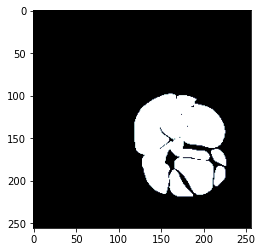

=== Slice 2402 ===


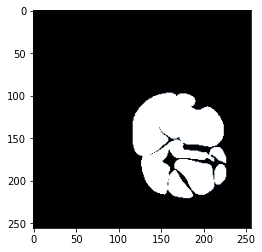

=== Slice 2404 ===


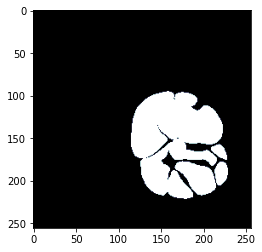

=== Slice 2406 ===


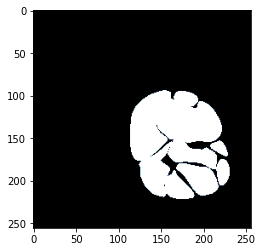

=== Slice 2408 ===


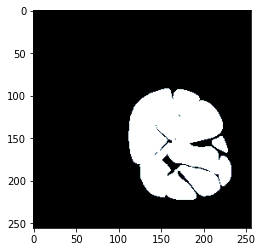

=== Slice 2410 ===


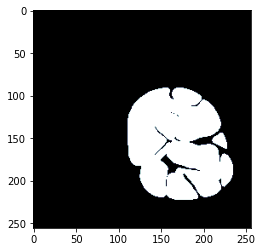

=== Slice 2412 ===


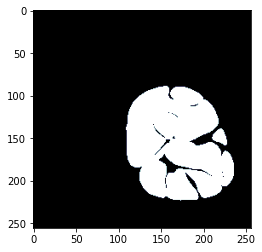

=== Slice 2414 ===


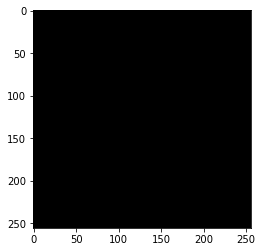

=== Slice 2416 ===


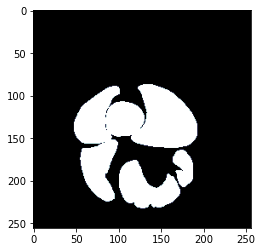

=== Slice 2418 ===


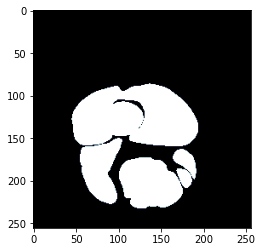

=== Slice 2420 ===


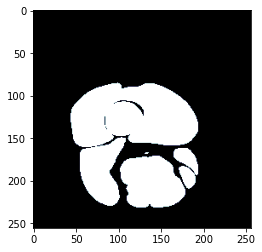

=== Slice 2422 ===


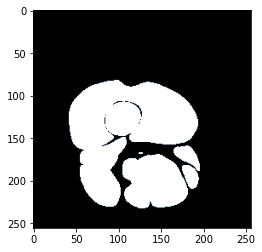

=== Slice 2424 ===


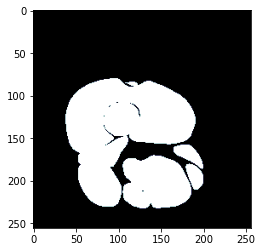

=== Slice 2426 ===


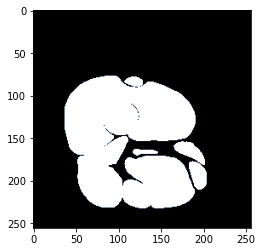

=== Slice 2428 ===


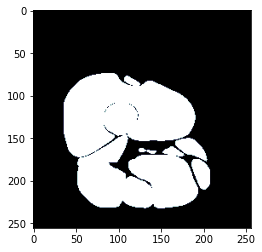

=== Slice 2430 ===


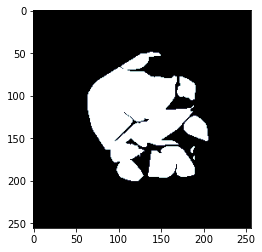

=== Slice 2432 ===


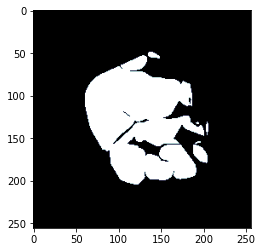

=== Slice 2434 ===


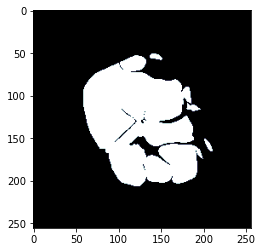

=== Slice 2436 ===


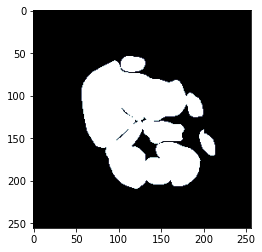

=== Slice 2438 ===


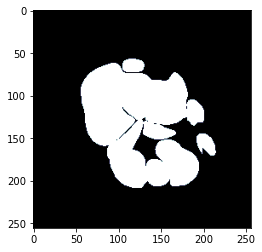

=== Slice 2440 ===


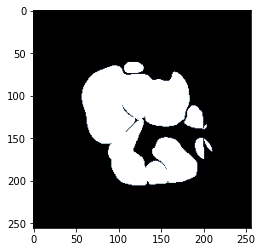

=== Slice 2442 ===


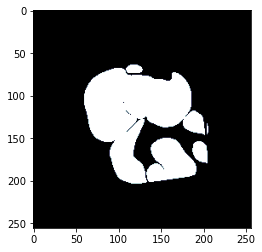

=== Slice 2444 ===


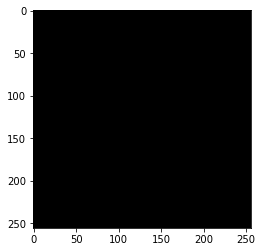

=== Slice 2446 ===


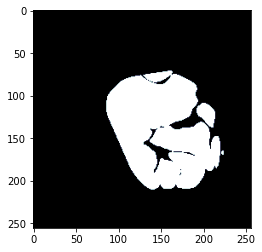

=== Slice 2448 ===


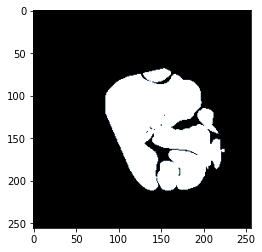

=== Slice 2450 ===


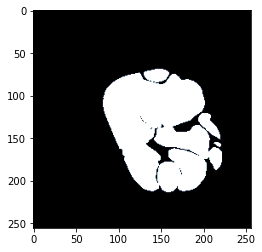

=== Slice 2452 ===


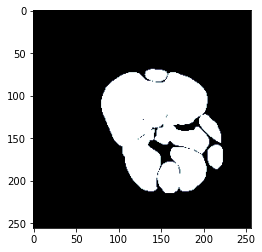

=== Slice 2454 ===


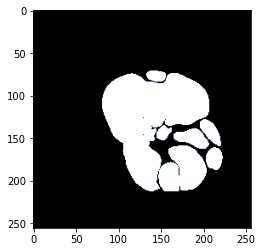

=== Slice 2456 ===


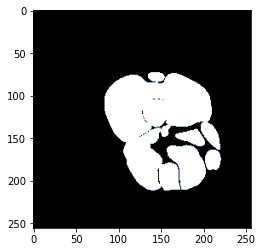

=== Slice 2458 ===


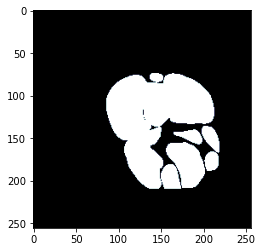

=== Slice 2460 ===


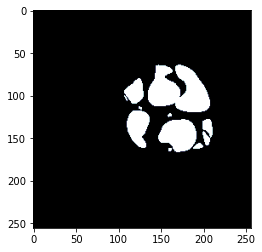

=== Slice 2462 ===


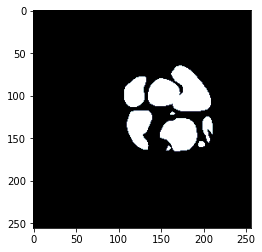

=== Slice 2464 ===


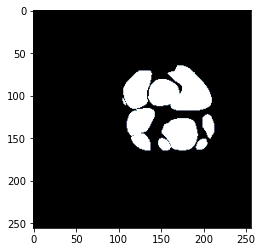

=== Slice 2466 ===


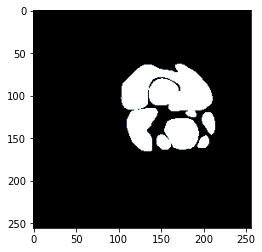

=== Slice 2468 ===


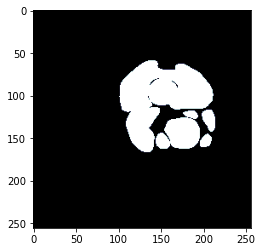

=== Slice 2470 ===


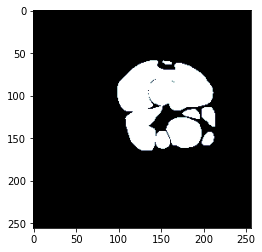

=== Slice 2472 ===


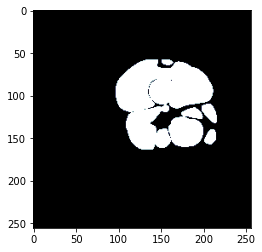

=== Slice 2474 ===


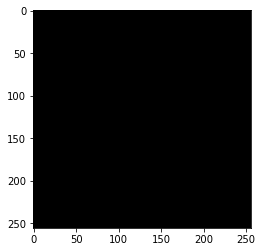

=== Slice 2476 ===


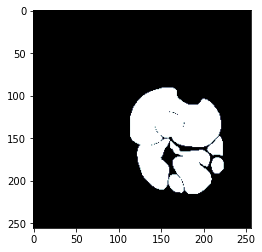

=== Slice 2478 ===


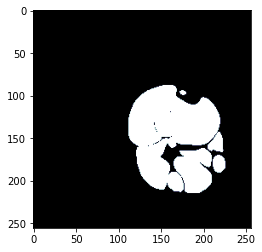

=== Slice 2480 ===


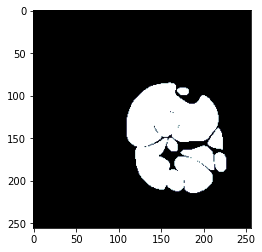

=== Slice 2482 ===


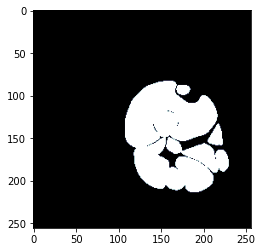

=== Slice 2484 ===


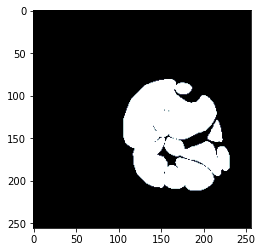

=== Slice 2486 ===


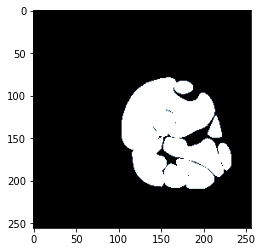

=== Slice 2488 ===


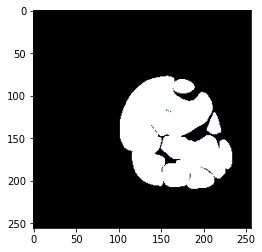

=== Slice 2490 ===


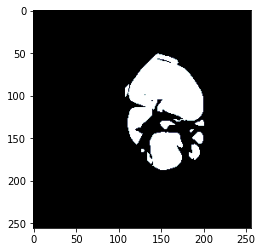

=== Slice 2492 ===


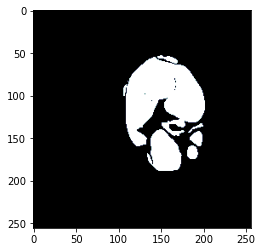

=== Slice 2494 ===


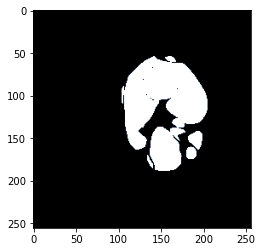

=== Slice 2496 ===


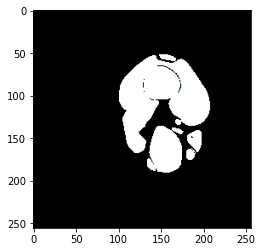

=== Slice 2498 ===


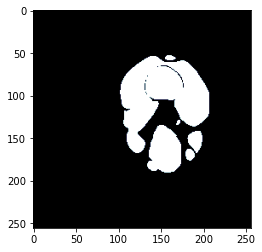

=== Slice 2500 ===


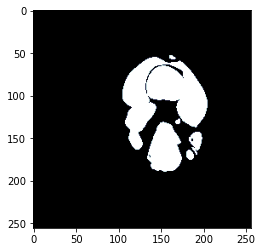

=== Slice 2502 ===


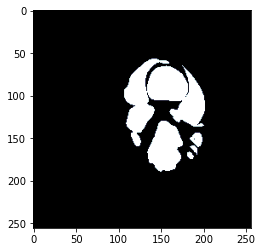

=== Slice 2504 ===


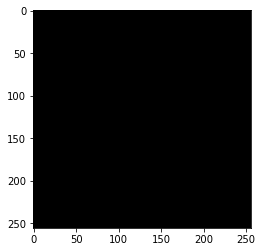

=== Slice 2506 ===


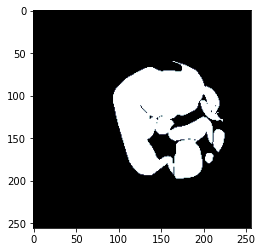

=== Slice 2508 ===


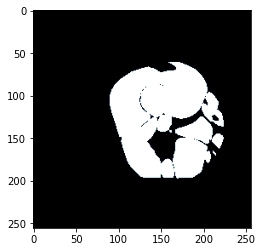

=== Slice 2510 ===


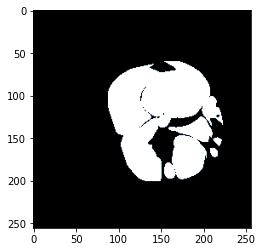

=== Slice 2512 ===


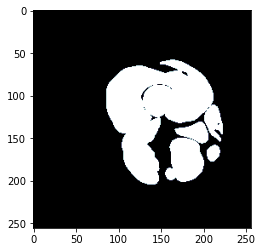

=== Slice 2514 ===


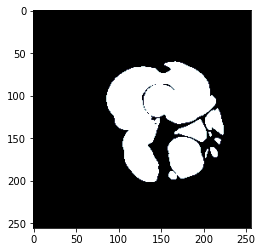

=== Slice 2516 ===


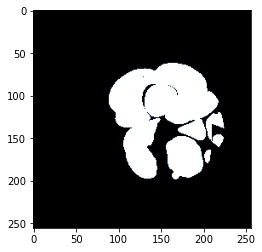

=== Slice 2518 ===


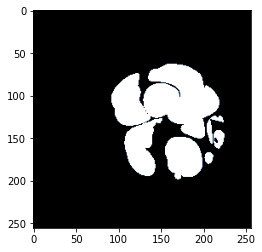

=== Slice 2520 ===


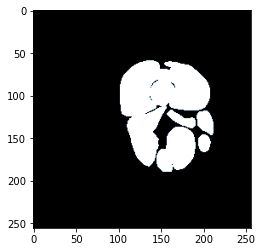

=== Slice 2522 ===


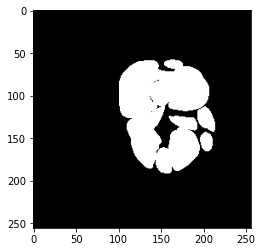

=== Slice 2524 ===


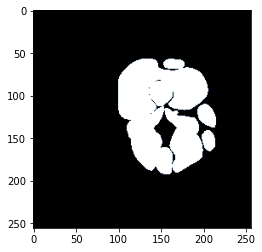

=== Slice 2526 ===


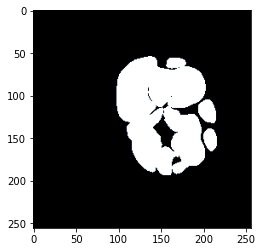

=== Slice 2528 ===


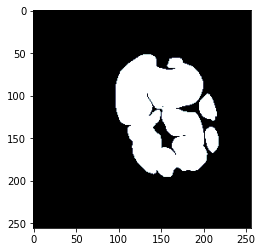

=== Slice 2530 ===


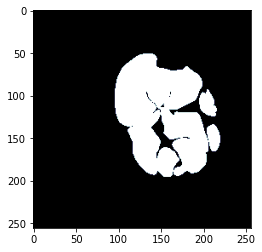

=== Slice 2532 ===


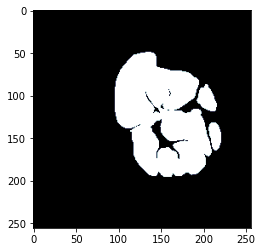

=== Slice 2534 ===


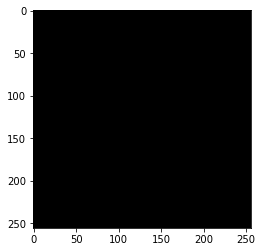

=== Slice 2536 ===


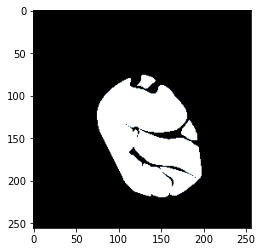

=== Slice 2538 ===


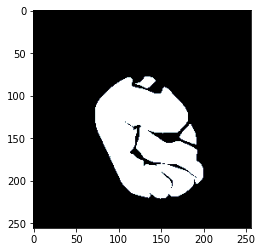

=== Slice 2540 ===


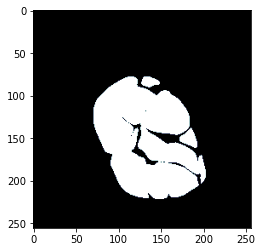

=== Slice 2542 ===


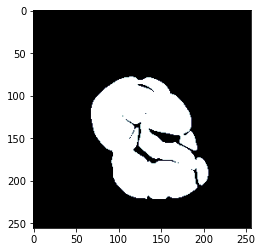

=== Slice 2544 ===


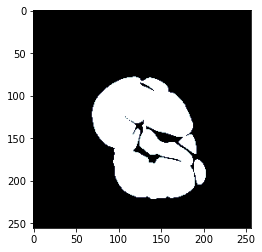

=== Slice 2546 ===


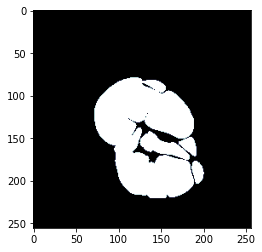

=== Slice 2548 ===


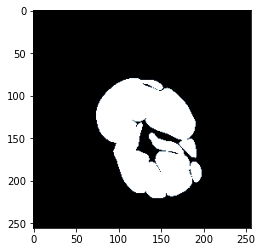

=== Slice 2550 ===


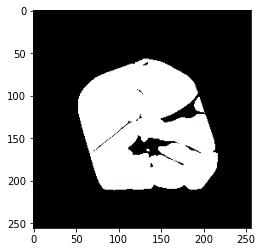

=== Slice 2552 ===


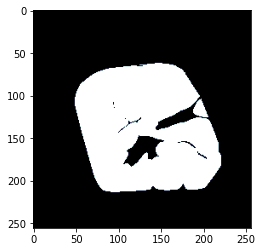

=== Slice 2554 ===


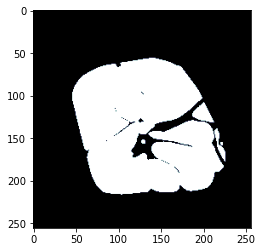

=== Slice 2556 ===


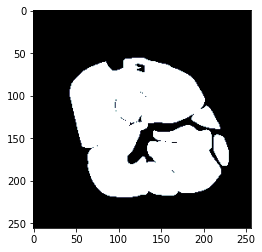

=== Slice 2558 ===


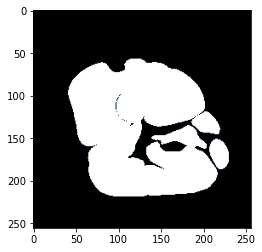

=== Slice 2560 ===


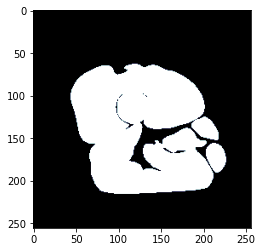

=== Slice 2562 ===


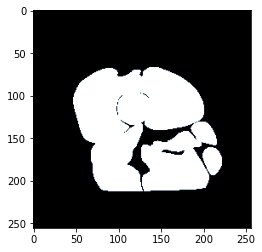

=== Slice 2564 ===


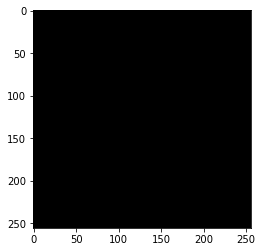

=== Slice 2566 ===


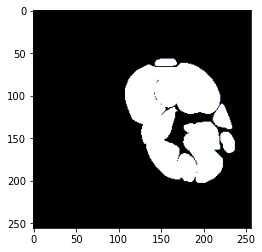

=== Slice 2568 ===


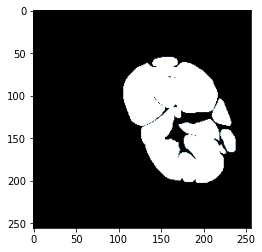

=== Slice 2570 ===


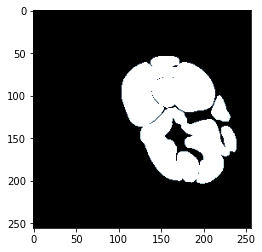

=== Slice 2572 ===


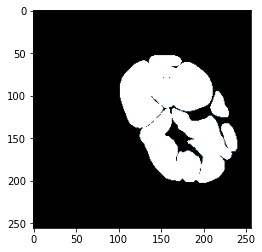

=== Slice 2574 ===


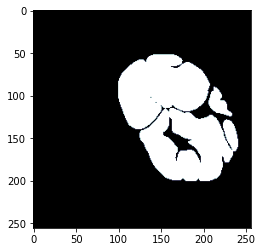

=== Slice 2576 ===


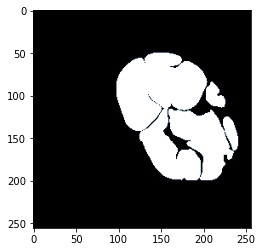

=== Slice 2578 ===


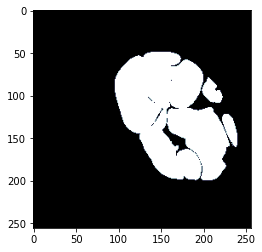

=== Slice 2580 ===


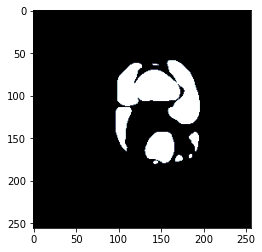

=== Slice 2582 ===


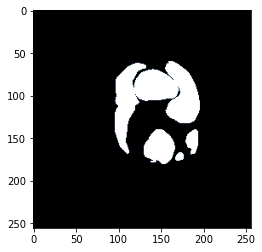

=== Slice 2584 ===


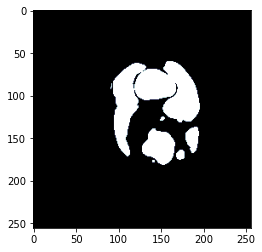

=== Slice 2586 ===


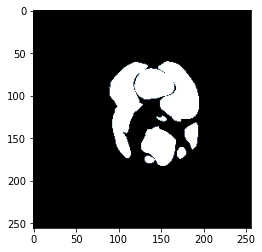

=== Slice 2588 ===


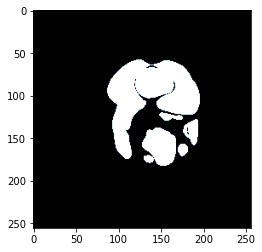

=== Slice 2590 ===


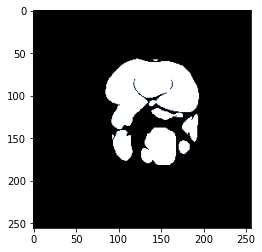

=== Slice 2592 ===


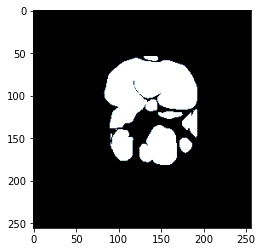

=== Slice 2594 ===


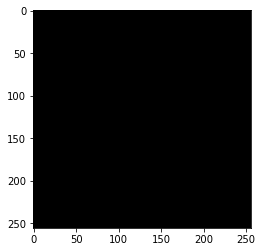

=== Slice 2596 ===


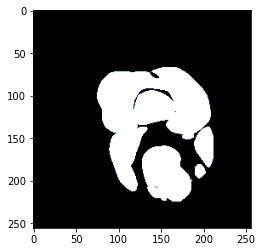

=== Slice 2598 ===


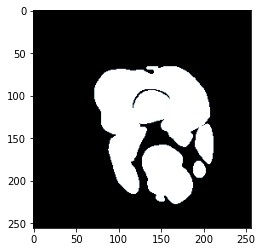

=== Slice 2600 ===


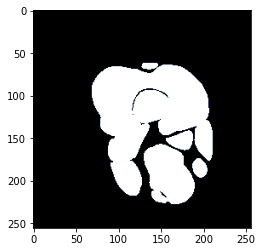

=== Slice 2602 ===


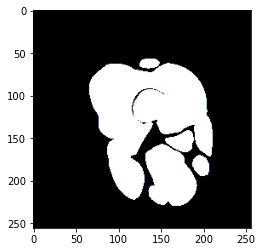

=== Slice 2604 ===


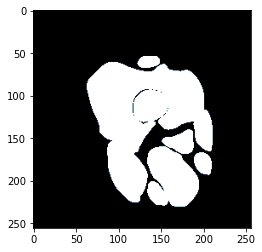

=== Slice 2606 ===


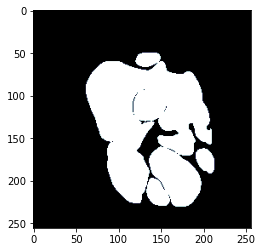

=== Slice 2608 ===


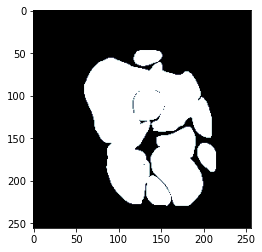

=== Slice 2610 ===


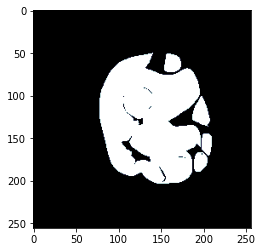

=== Slice 2612 ===


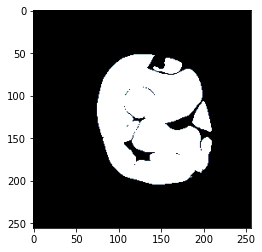

=== Slice 2614 ===


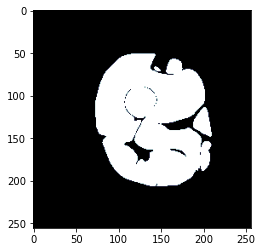

=== Slice 2616 ===


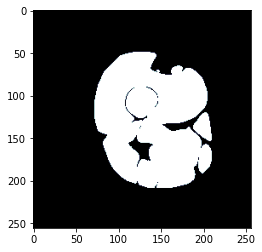

=== Slice 2618 ===


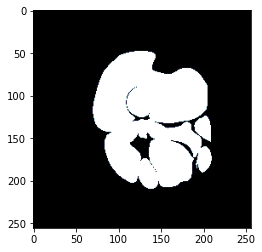

=== Slice 2620 ===


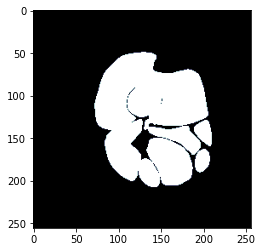

=== Slice 2622 ===


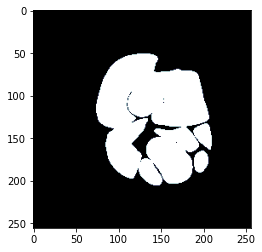

=== Slice 2624 ===


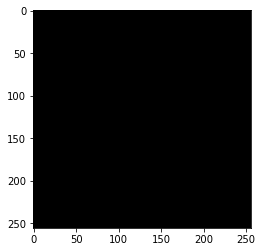

=== Slice 2626 ===


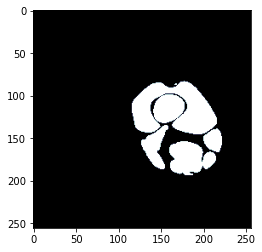

=== Slice 2628 ===


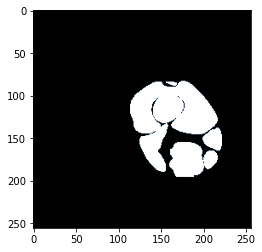

=== Slice 2630 ===


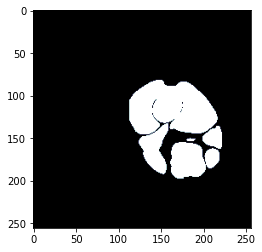

=== Slice 2632 ===


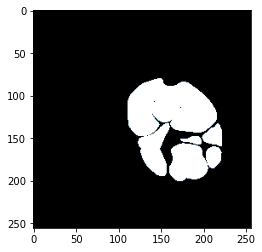

=== Slice 2634 ===


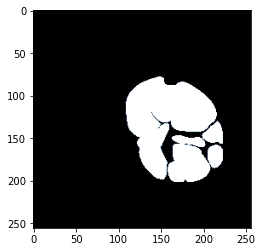

=== Slice 2636 ===


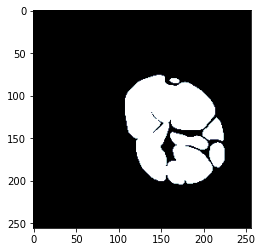

=== Slice 2638 ===


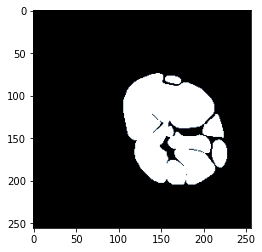

=== Slice 2640 ===


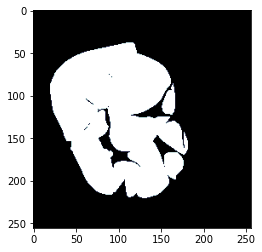

=== Slice 2642 ===


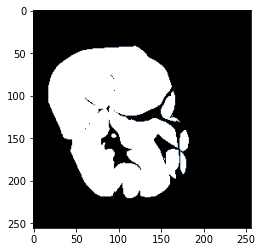

=== Slice 2644 ===


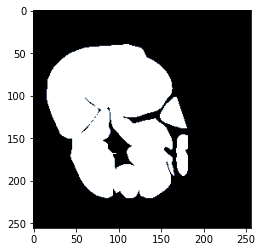

=== Slice 2646 ===


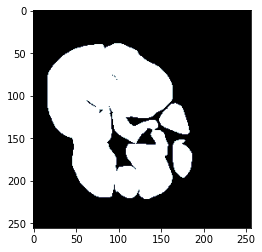

=== Slice 2648 ===


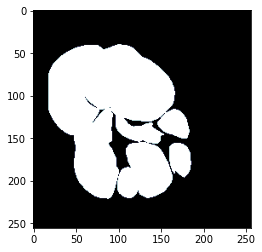

=== Slice 2650 ===


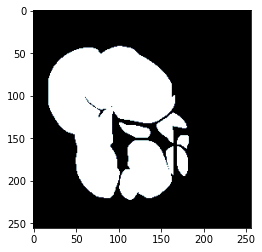

=== Slice 2652 ===


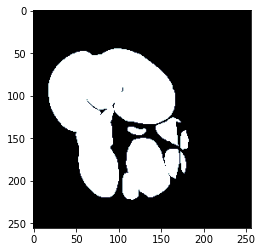

=== Slice 2654 ===


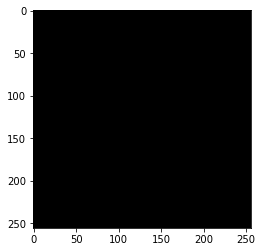

=== Slice 2656 ===


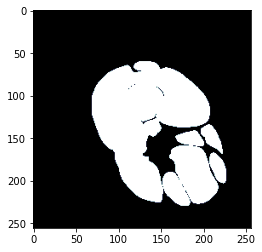

=== Slice 2658 ===


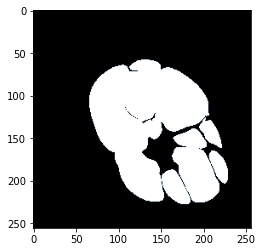

=== Slice 2660 ===


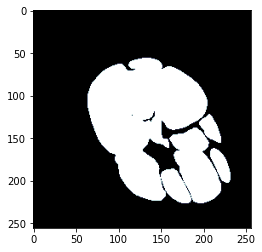

=== Slice 2662 ===


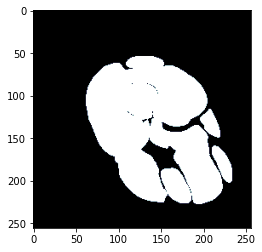

=== Slice 2664 ===


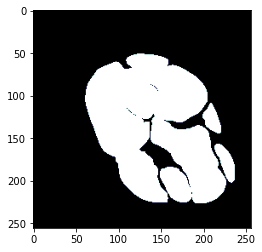

=== Slice 2666 ===


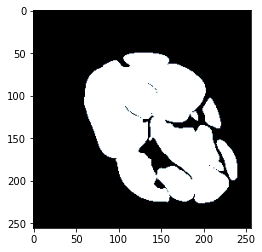

=== Slice 2668 ===


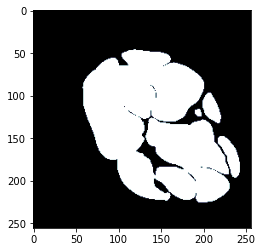

=== Slice 2670 ===


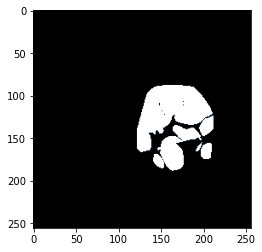

=== Slice 2672 ===


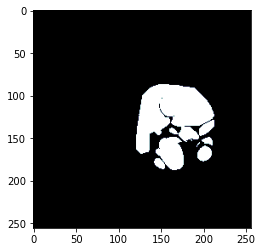

=== Slice 2674 ===


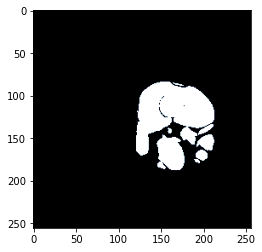

=== Slice 2676 ===


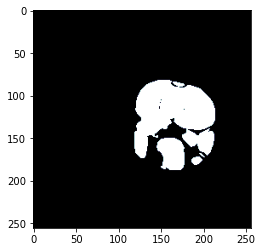

=== Slice 2678 ===


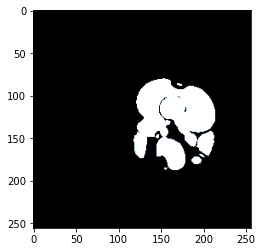

=== Slice 2680 ===


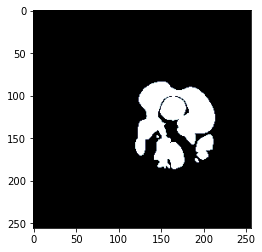

=== Slice 2682 ===


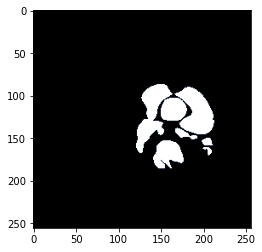

=== Slice 2684 ===


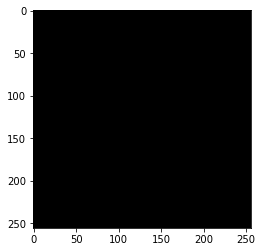

=== Slice 2686 ===


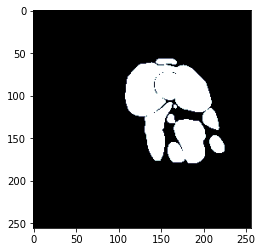

=== Slice 2688 ===


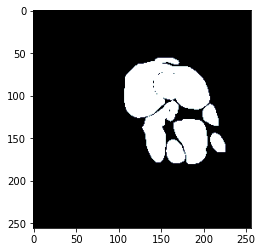

=== Slice 2690 ===


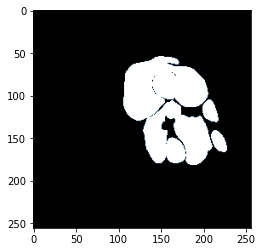

=== Slice 2692 ===


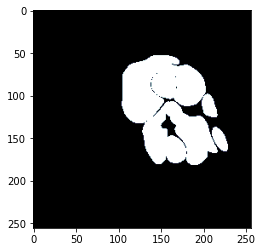

=== Slice 2694 ===


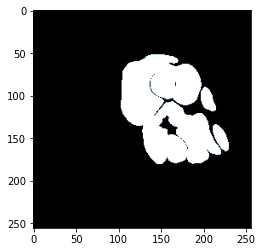

=== Slice 2696 ===


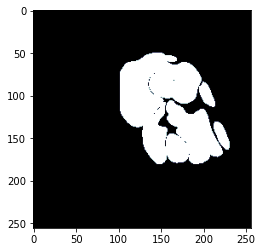

=== Slice 2698 ===


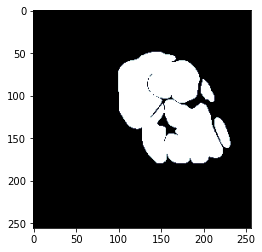

=== Slice 2700 ===


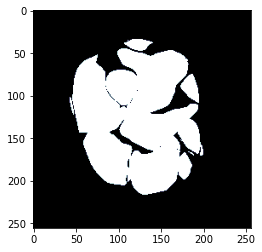

=== Slice 2702 ===


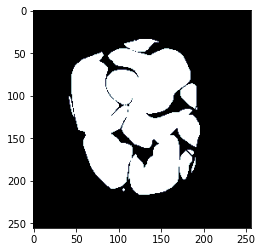

=== Slice 2704 ===


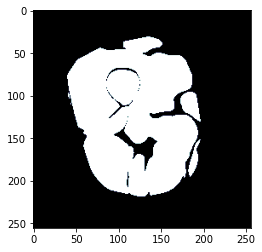

=== Slice 2706 ===


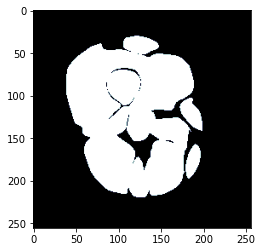

=== Slice 2708 ===


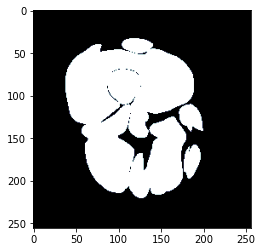

=== Slice 2710 ===


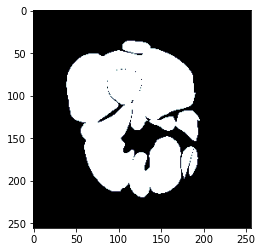

=== Slice 2712 ===


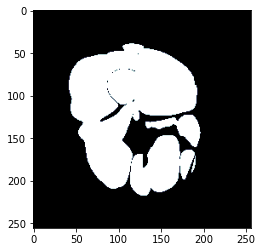

=== Slice 2714 ===


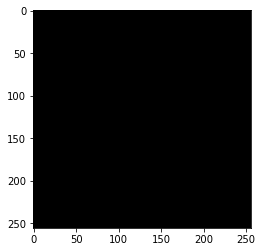

=== Slice 2716 ===


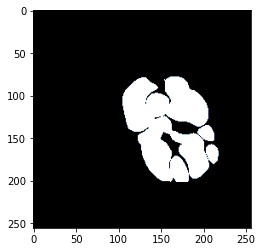

=== Slice 2718 ===


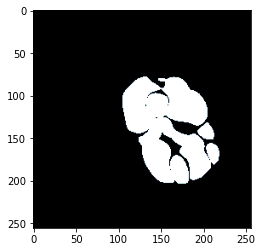

=== Slice 2720 ===


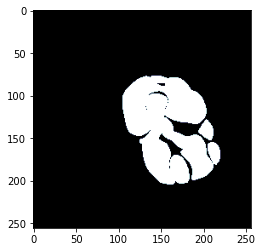

=== Slice 2722 ===


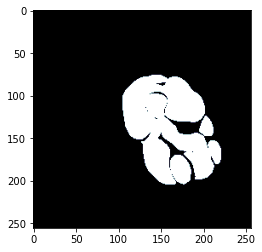

=== Slice 2724 ===


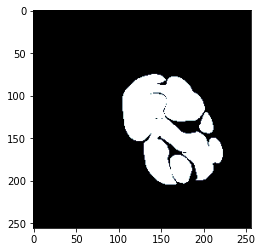

=== Slice 2726 ===


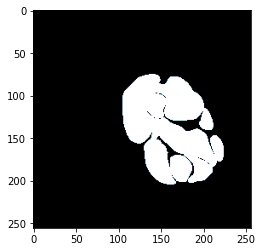

=== Slice 2728 ===


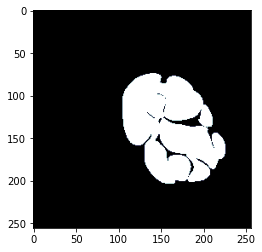

=== Slice 2730 ===


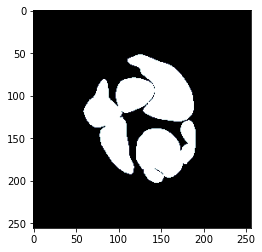

=== Slice 2732 ===


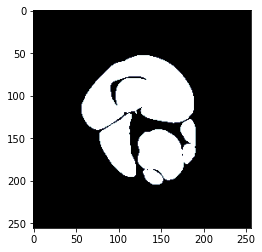

=== Slice 2734 ===


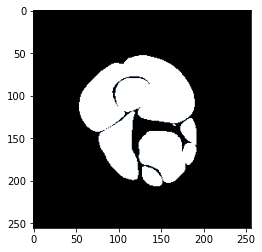

=== Slice 2736 ===


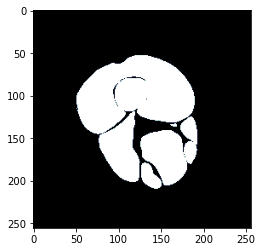

=== Slice 2738 ===


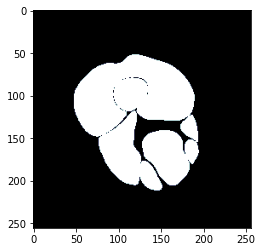

=== Slice 2740 ===


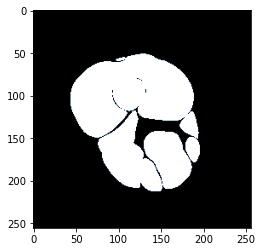

=== Slice 2742 ===


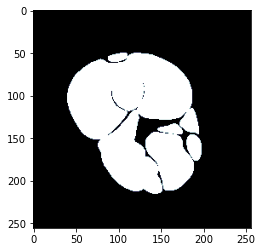

=== Slice 2744 ===


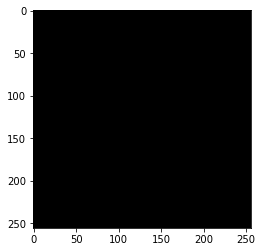

=== Slice 2746 ===


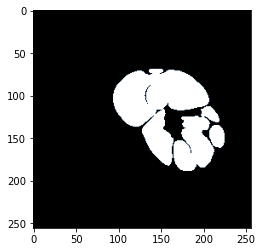

=== Slice 2748 ===


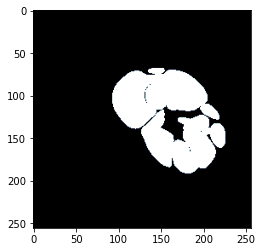

=== Slice 2750 ===


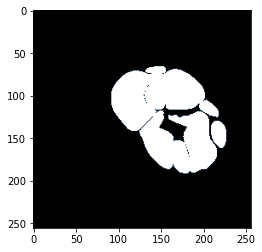

=== Slice 2752 ===


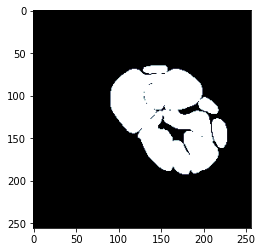

=== Slice 2754 ===


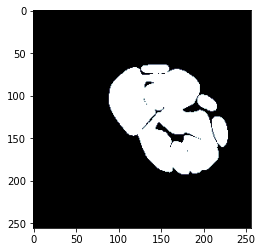

=== Slice 2756 ===


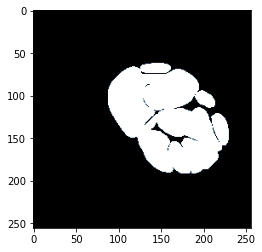

=== Slice 2758 ===


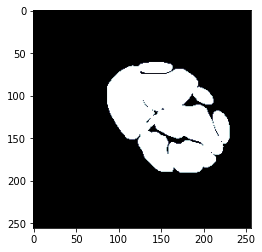

=== Slice 2760 ===


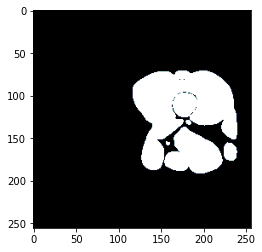

=== Slice 2762 ===


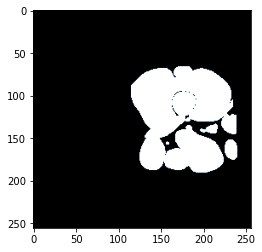

=== Slice 2764 ===


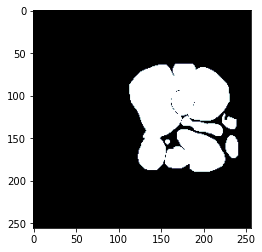

=== Slice 2766 ===


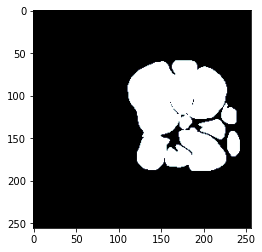

=== Slice 2768 ===


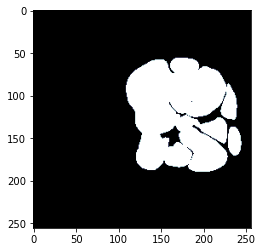

=== Slice 2770 ===


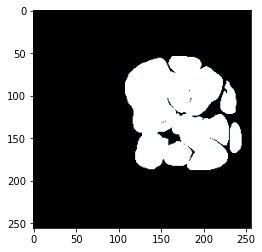

=== Slice 2772 ===


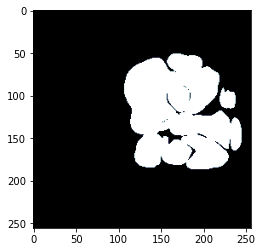

=== Slice 2774 ===


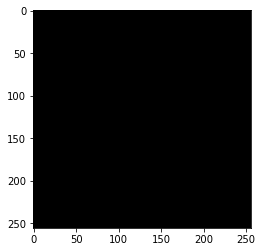

=== Slice 2776 ===


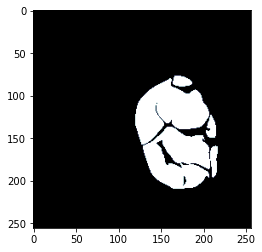

=== Slice 2778 ===


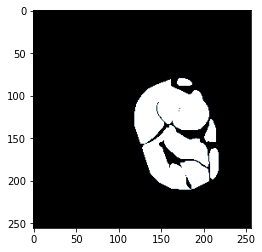

=== Slice 2780 ===


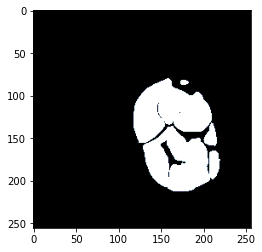

=== Slice 2782 ===


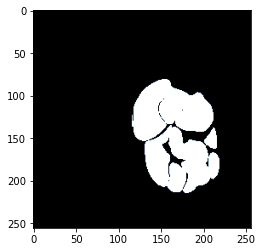

=== Slice 2784 ===


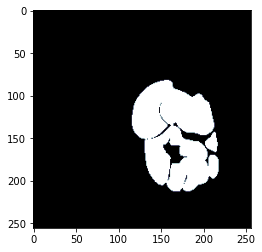

=== Slice 2786 ===


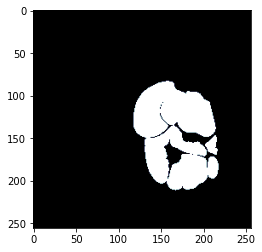

=== Slice 2788 ===


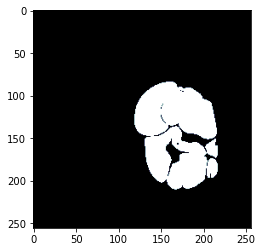

=== Slice 2790 ===


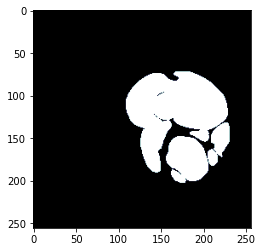

=== Slice 2792 ===


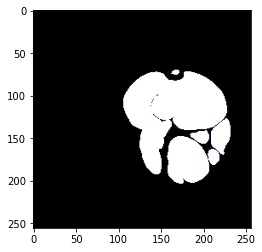

=== Slice 2794 ===


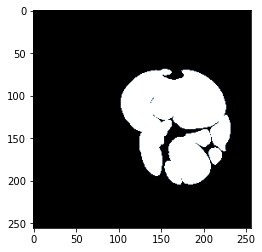

=== Slice 2796 ===


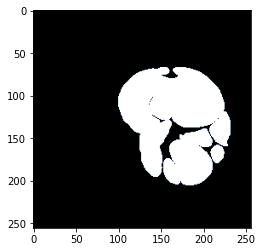

=== Slice 2798 ===


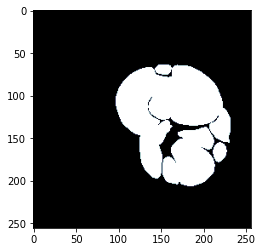

=== Slice 2800 ===


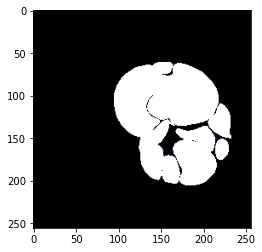

=== Slice 2802 ===


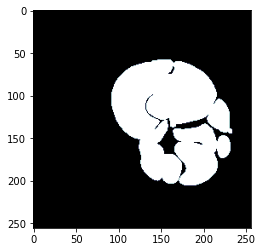

=== Slice 2804 ===


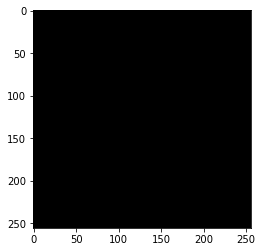

=== Slice 2806 ===


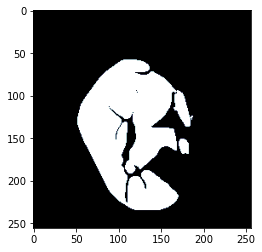

=== Slice 2808 ===


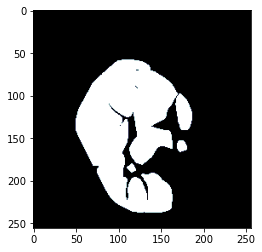

=== Slice 2810 ===


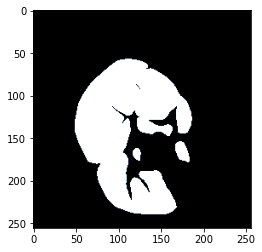

=== Slice 2812 ===


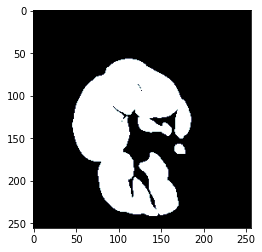

=== Slice 2814 ===


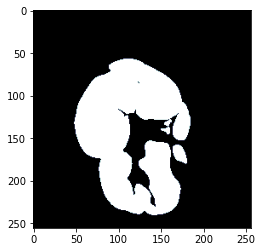

=== Slice 2816 ===


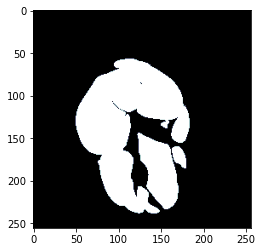

=== Slice 2818 ===


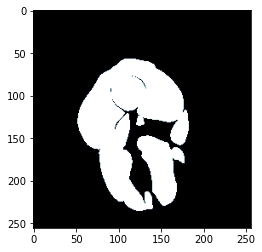

=== Slice 2820 ===


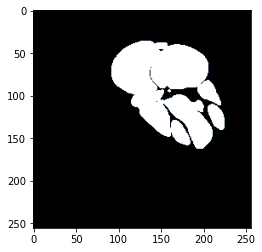

=== Slice 2822 ===


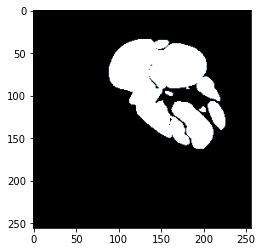

=== Slice 2824 ===


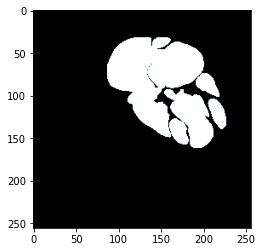

=== Slice 2826 ===


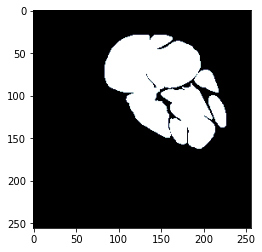

=== Slice 2828 ===


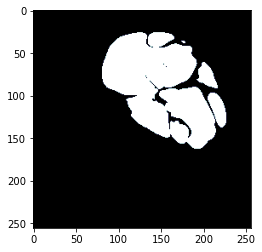

=== Slice 2830 ===


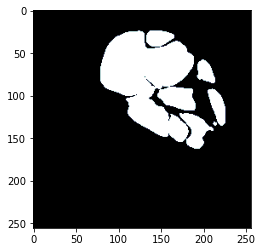

=== Slice 2832 ===


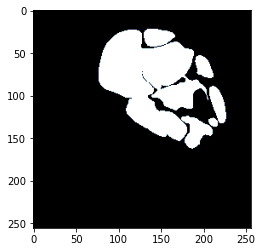

=== Slice 2834 ===


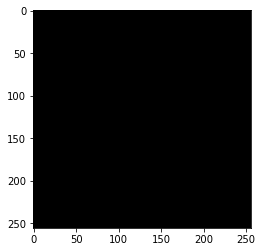

=== Slice 2836 ===


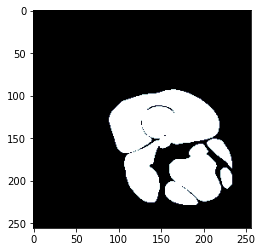

=== Slice 2838 ===


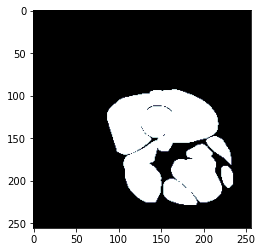

=== Slice 2840 ===


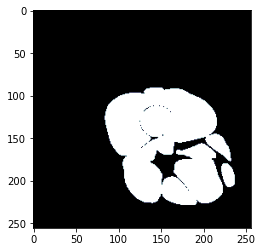

=== Slice 2842 ===


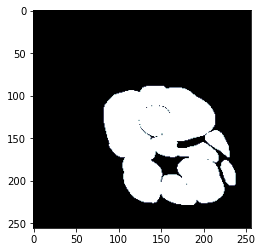

=== Slice 2844 ===


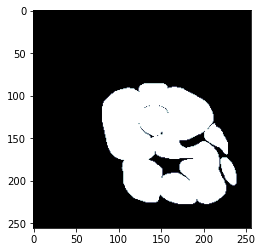

=== Slice 2846 ===


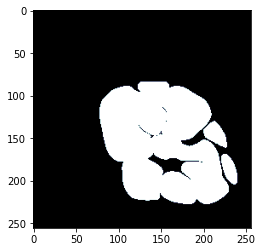

=== Slice 2848 ===


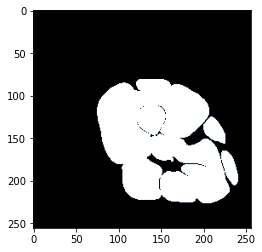

=== Slice 2850 ===


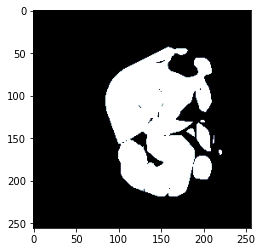

=== Slice 2852 ===


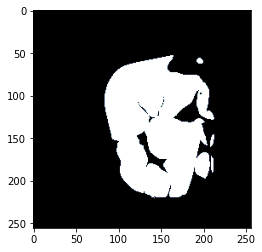

=== Slice 2854 ===


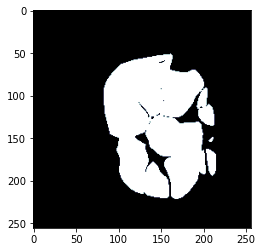

=== Slice 2856 ===


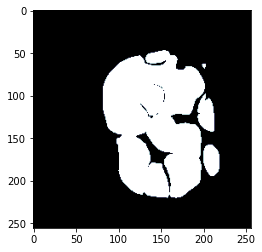

=== Slice 2858 ===


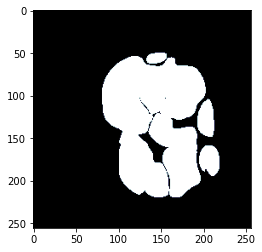

=== Slice 2860 ===


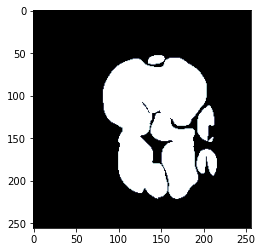

=== Slice 2862 ===


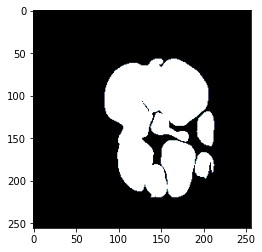

=== Slice 2864 ===


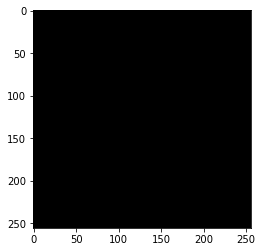

=== Slice 2866 ===


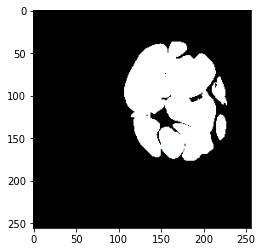

=== Slice 2868 ===


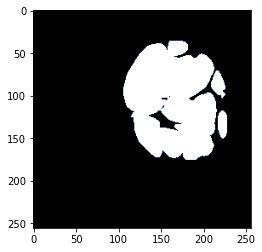

=== Slice 2870 ===


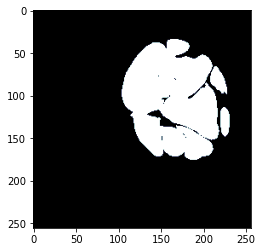

=== Slice 2872 ===


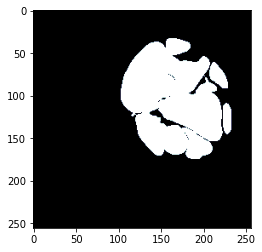

=== Slice 2874 ===


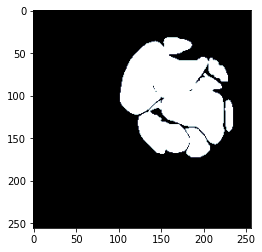

=== Slice 2876 ===


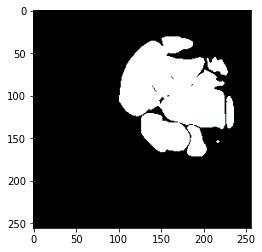

=== Slice 2878 ===


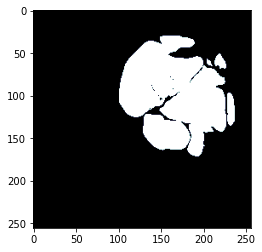

=== Slice 2880 ===


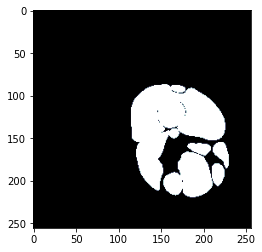

=== Slice 2882 ===


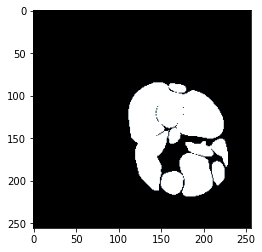

=== Slice 2884 ===


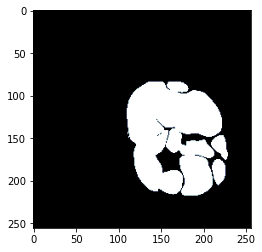

=== Slice 2886 ===


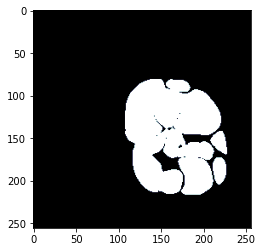

=== Slice 2888 ===


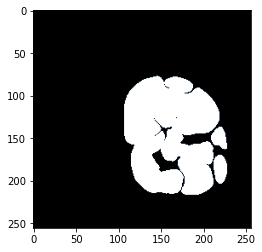

=== Slice 2890 ===


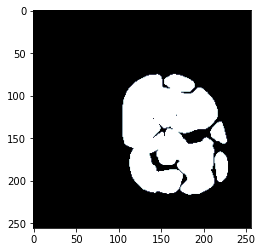

=== Slice 2892 ===


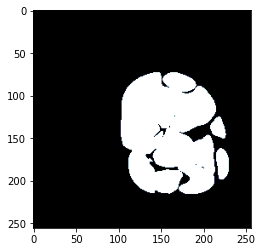

=== Slice 2894 ===


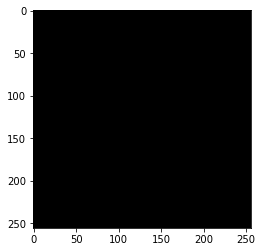

=== Slice 2896 ===


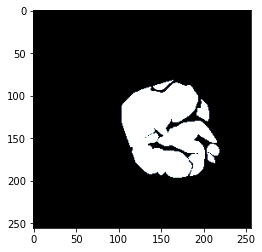

=== Slice 2898 ===


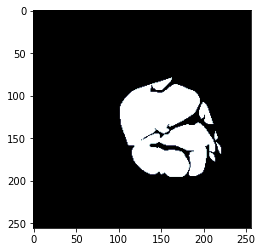

=== Slice 2900 ===


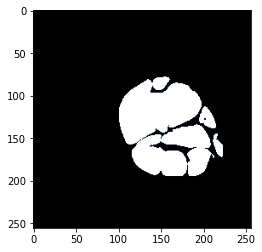

=== Slice 2902 ===


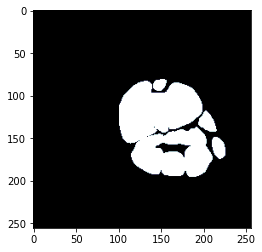

=== Slice 2904 ===


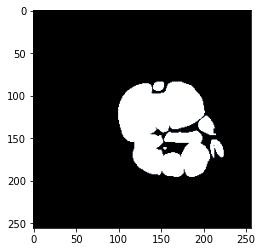

=== Slice 2906 ===


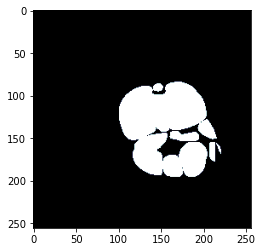

=== Slice 2908 ===


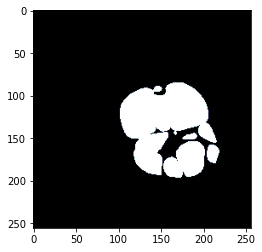

=== Slice 2910 ===


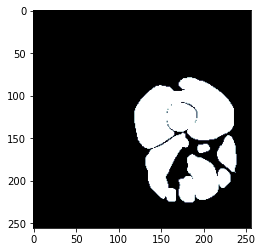

=== Slice 2912 ===


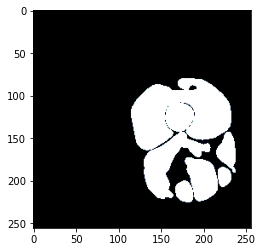

=== Slice 2914 ===


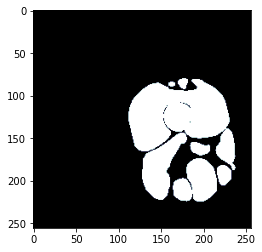

=== Slice 2916 ===


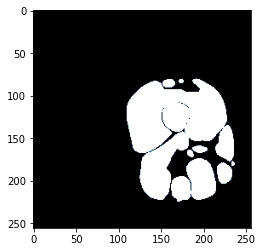

=== Slice 2918 ===


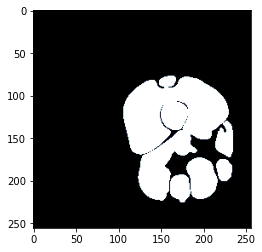

=== Slice 2920 ===


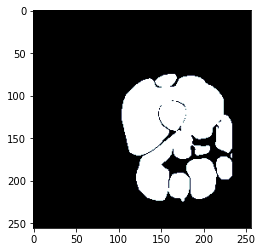

=== Slice 2922 ===


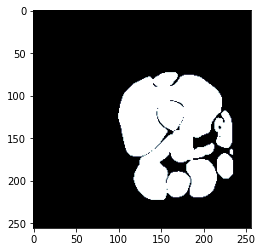

=== Slice 2924 ===


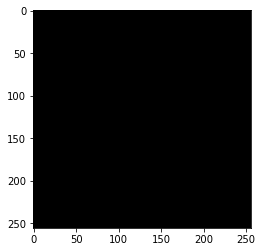

=== Slice 2926 ===


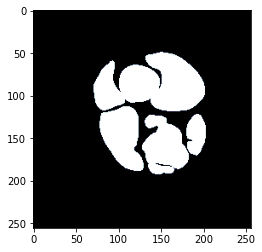

=== Slice 2928 ===


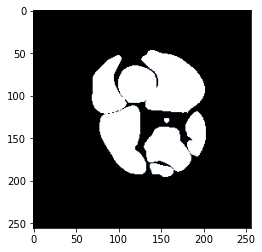

=== Slice 2930 ===


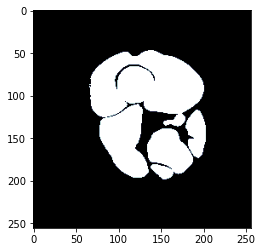

=== Slice 2932 ===


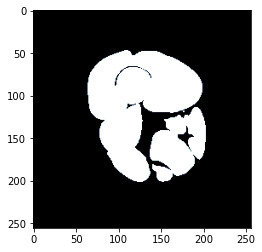

=== Slice 2934 ===


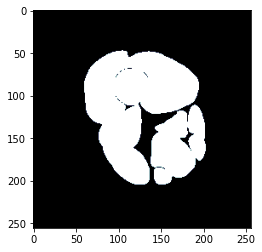

=== Slice 2936 ===


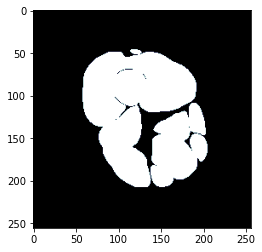

=== Slice 2938 ===


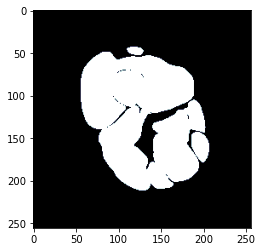

=== Slice 2940 ===


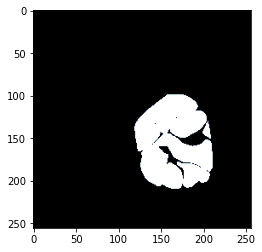

=== Slice 2942 ===


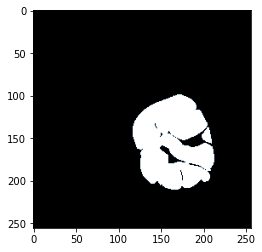

=== Slice 2944 ===


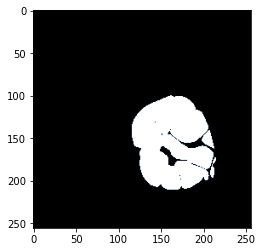

=== Slice 2946 ===


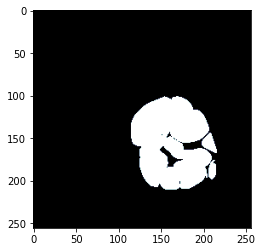

=== Slice 2948 ===


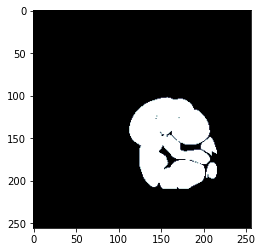

=== Slice 2950 ===


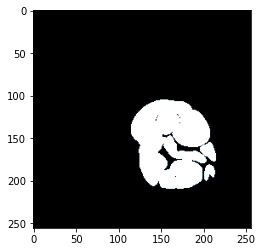

=== Slice 2952 ===


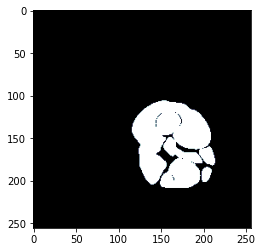

=== Slice 2954 ===


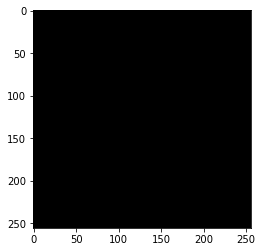

=== Slice 2956 ===


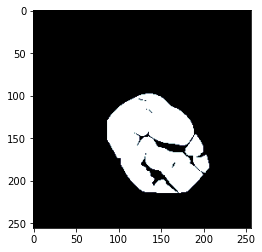

=== Slice 2958 ===


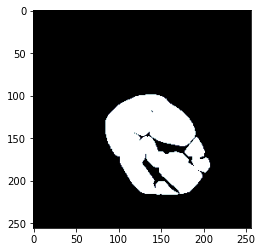

=== Slice 2960 ===


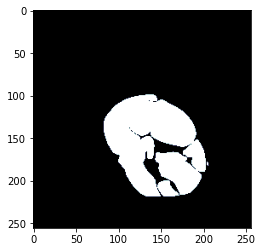

=== Slice 2962 ===


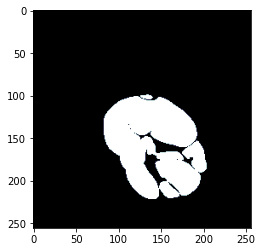

=== Slice 2964 ===


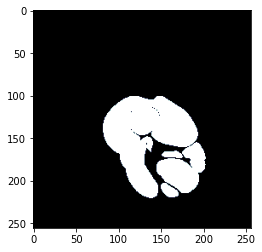

=== Slice 2966 ===


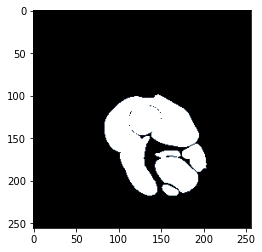

=== Slice 2968 ===


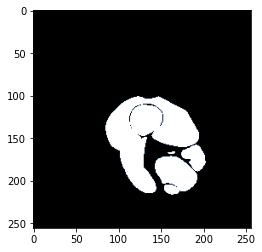

=== Slice 2970 ===


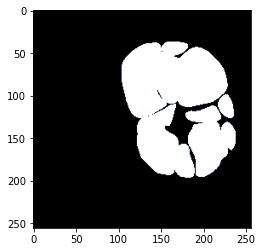

=== Slice 2972 ===


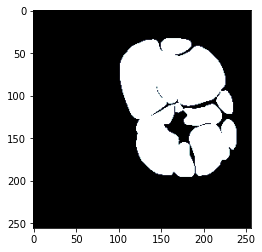

=== Slice 2974 ===


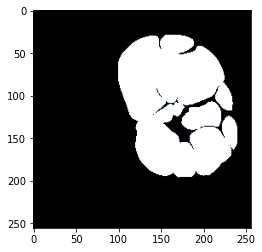

=== Slice 2976 ===


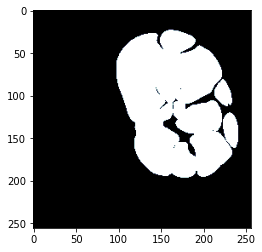

=== Slice 2978 ===


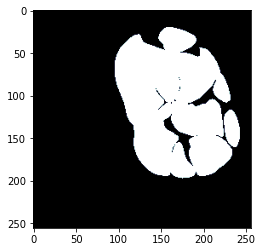

=== Slice 2980 ===


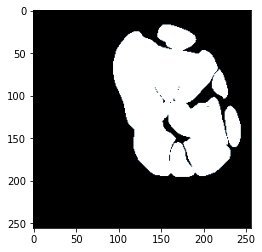

=== Slice 2982 ===


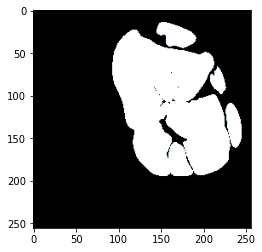

=== Slice 2984 ===


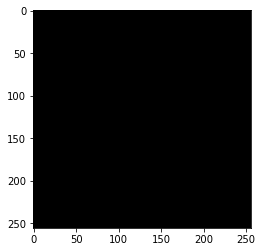

=== Slice 2986 ===


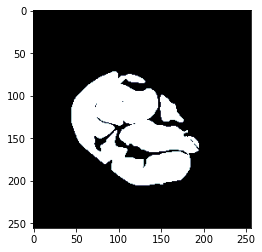

=== Slice 2988 ===


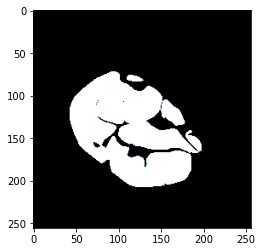

=== Slice 2990 ===


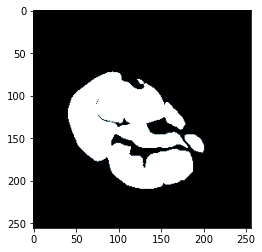

=== Slice 2992 ===


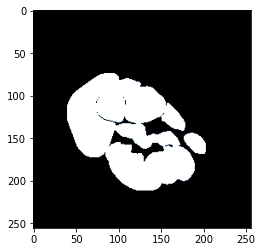

=== Slice 2994 ===


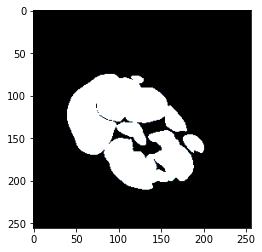

=== Slice 2996 ===


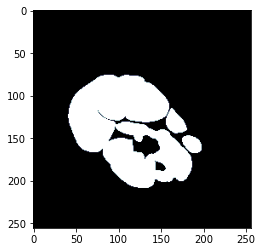

=== Slice 2998 ===


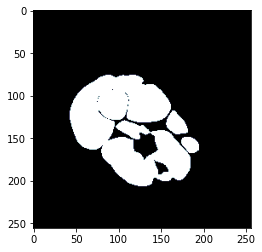

=== Slice 3000 ===


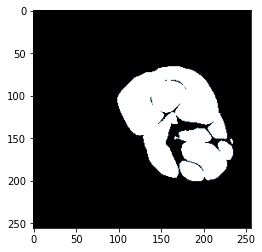

=== Slice 3002 ===


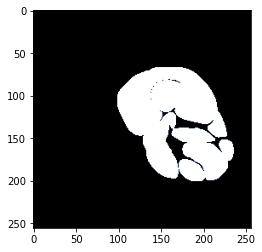

=== Slice 3004 ===


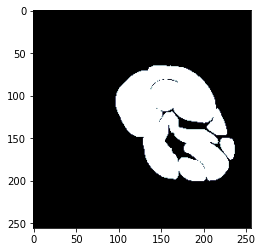

=== Slice 3006 ===


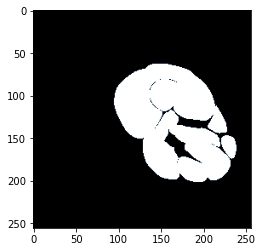

=== Slice 3008 ===


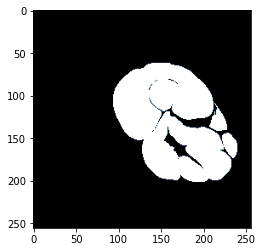

=== Slice 3010 ===


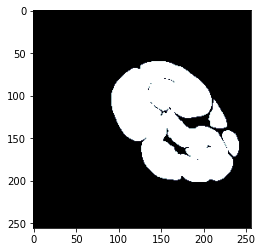

=== Slice 3012 ===


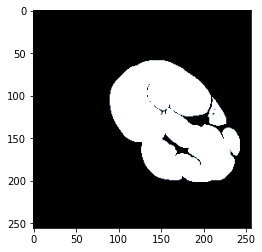

=== Slice 3014 ===


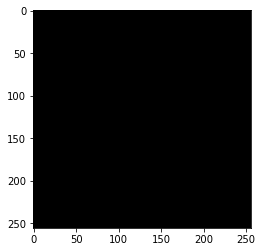

=== Slice 3016 ===


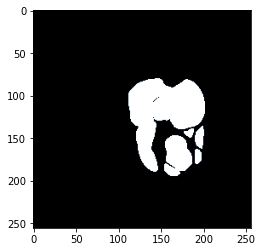

=== Slice 3018 ===


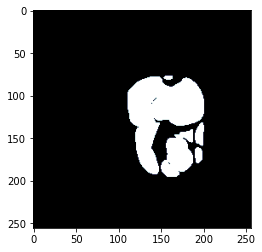

=== Slice 3020 ===


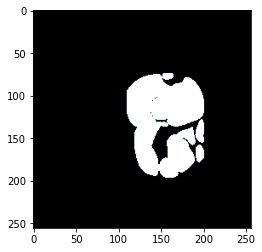

=== Slice 3022 ===


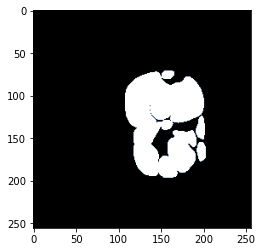

=== Slice 3024 ===


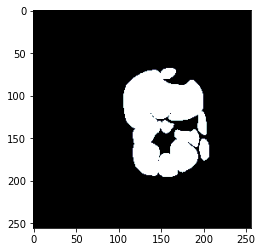

=== Slice 3026 ===


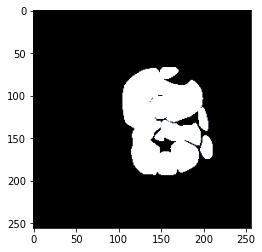

=== Slice 3028 ===


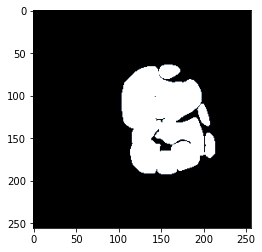

=== Slice 3030 ===


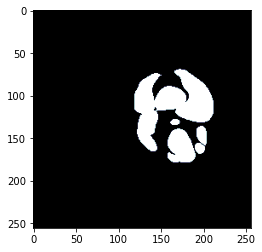

=== Slice 3032 ===


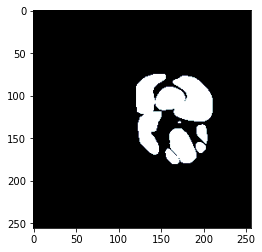

=== Slice 3034 ===


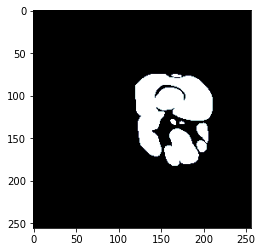

=== Slice 3036 ===


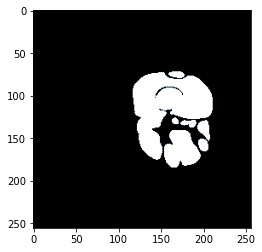

=== Slice 3038 ===


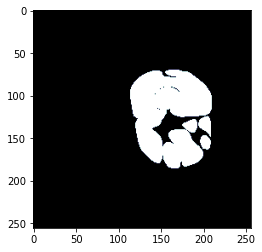

=== Slice 3040 ===


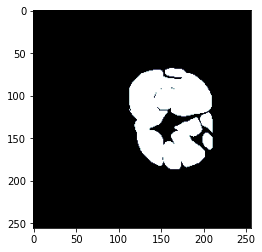

=== Slice 3042 ===


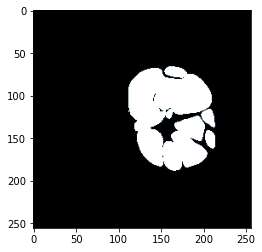

=== Slice 3044 ===


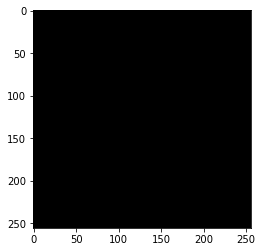

=== Slice 3046 ===


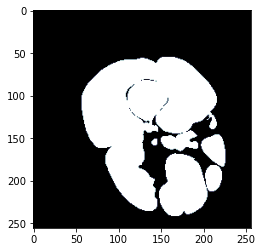

=== Slice 3048 ===


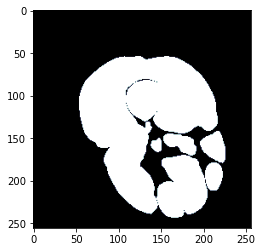

=== Slice 3050 ===


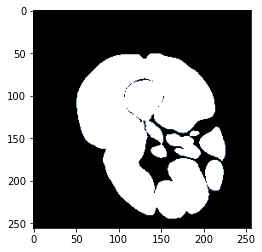

=== Slice 3052 ===


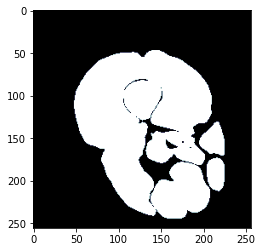

=== Slice 3054 ===


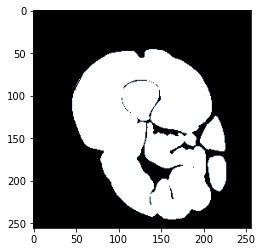

=== Slice 3056 ===


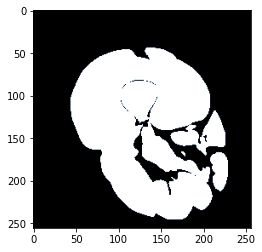

=== Slice 3058 ===


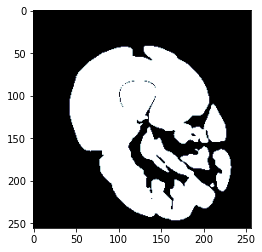

=== Slice 3060 ===


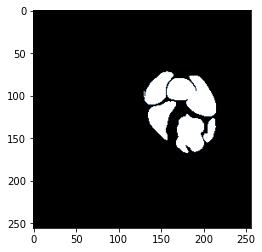

=== Slice 3062 ===


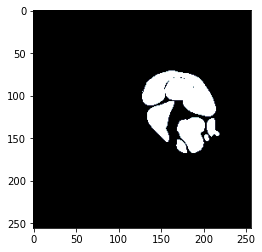

=== Slice 3064 ===


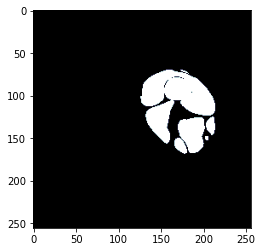

=== Slice 3066 ===


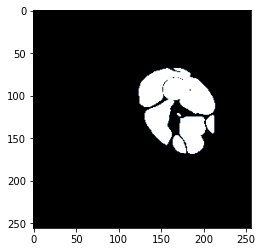

=== Slice 3068 ===


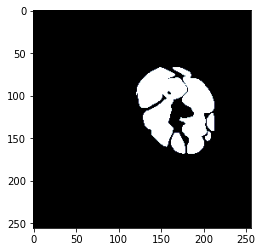

=== Slice 3070 ===


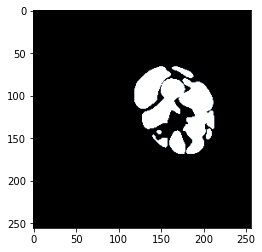

=== Slice 3072 ===


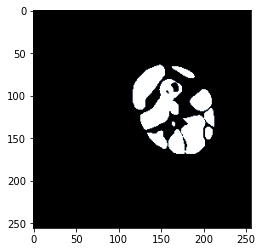

=== Slice 3074 ===


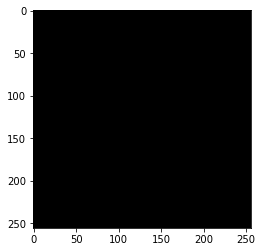

=== Slice 3076 ===


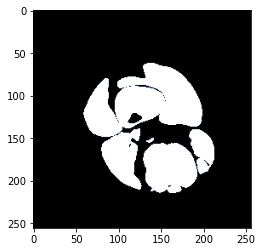

=== Slice 3078 ===


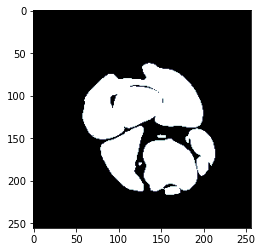

=== Slice 3080 ===


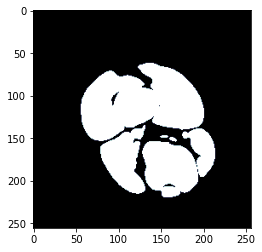

=== Slice 3082 ===


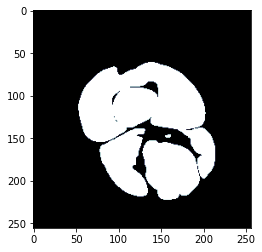

=== Slice 3084 ===


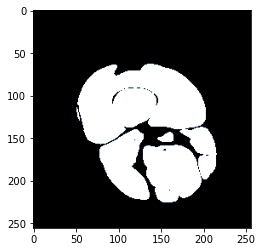

=== Slice 3086 ===


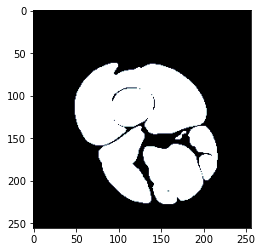

=== Slice 3088 ===


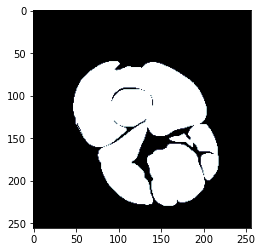

=== Slice 3090 ===


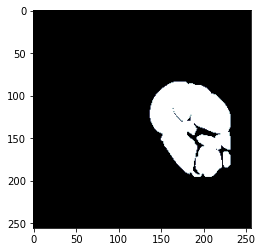

=== Slice 3092 ===


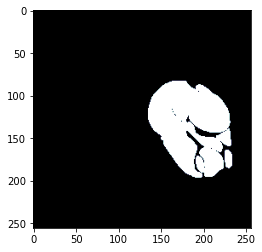

=== Slice 3094 ===


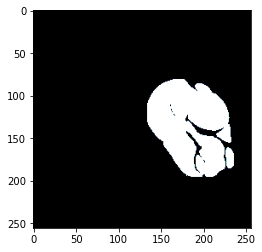

=== Slice 3096 ===


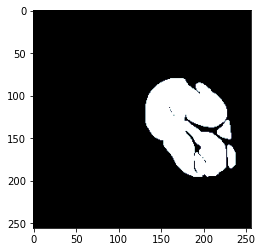

=== Slice 3098 ===


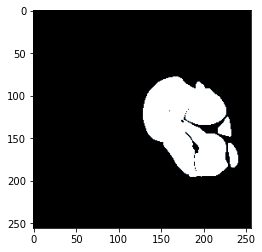

=== Slice 3100 ===


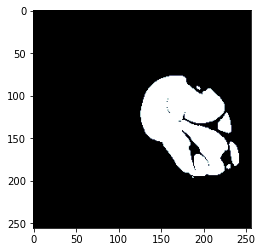

=== Slice 3102 ===


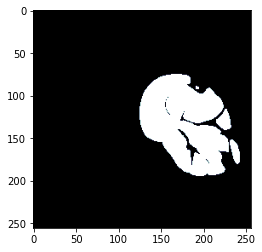

=== Slice 3104 ===


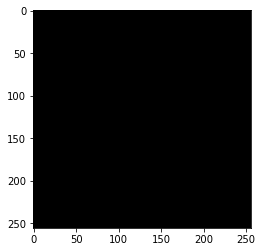

=== Slice 3106 ===


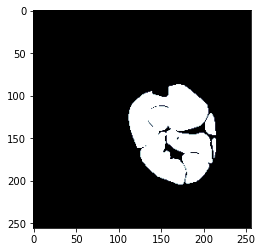

=== Slice 3108 ===


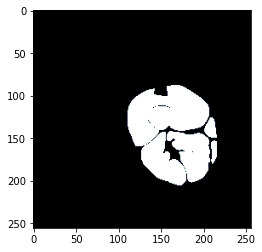

=== Slice 3110 ===


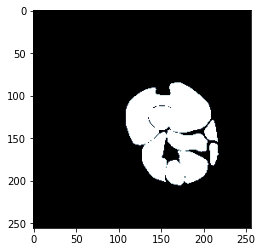

=== Slice 3112 ===


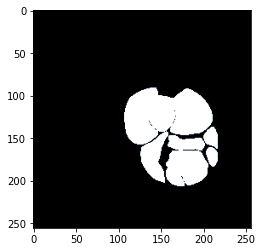

=== Slice 3114 ===


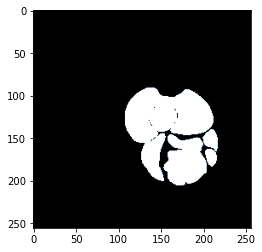

=== Slice 3116 ===


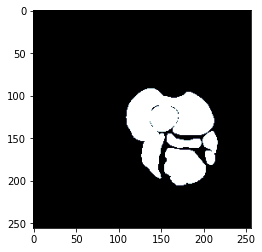

=== Slice 3118 ===


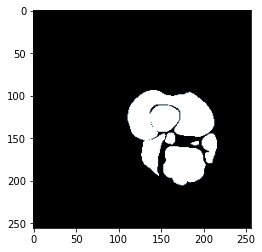

=== Slice 3120 ===


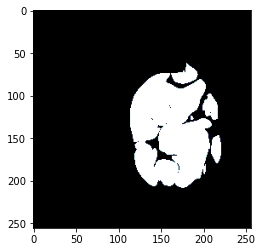

=== Slice 3122 ===


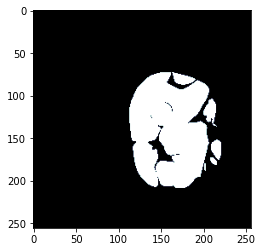

=== Slice 3124 ===


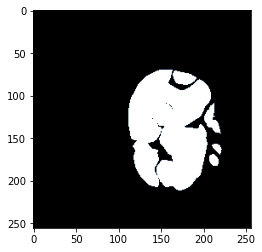

=== Slice 3126 ===


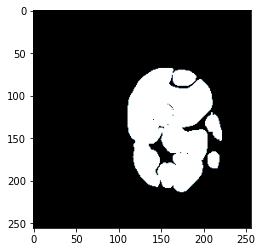

=== Slice 3128 ===


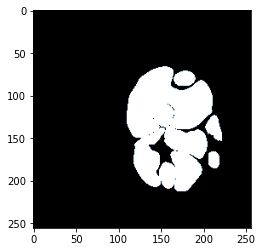

=== Slice 3130 ===


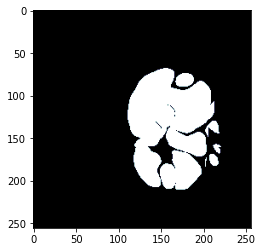

=== Slice 3132 ===


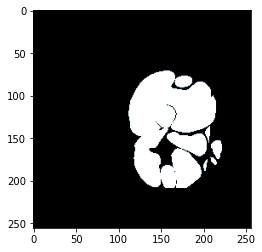

=== Slice 3134 ===


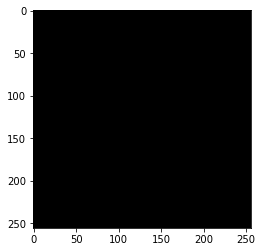

=== Slice 3136 ===


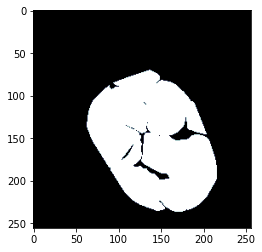

=== Slice 3138 ===


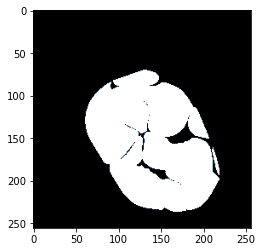

=== Slice 3140 ===


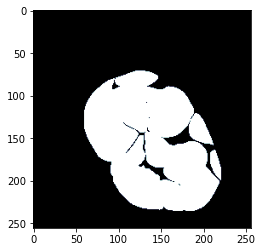

=== Slice 3142 ===


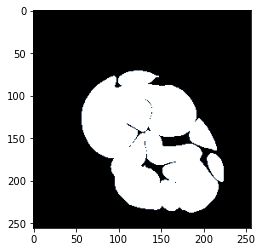

=== Slice 3144 ===


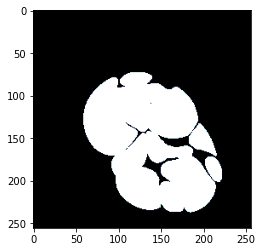

=== Slice 3146 ===


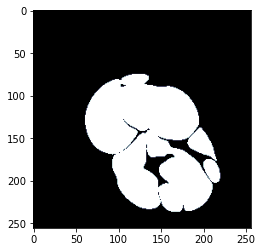

=== Slice 3148 ===


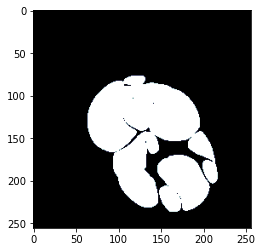

=== Slice 3150 ===


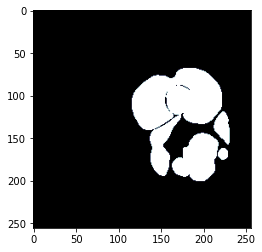

=== Slice 3152 ===


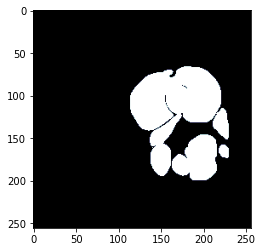

=== Slice 3154 ===


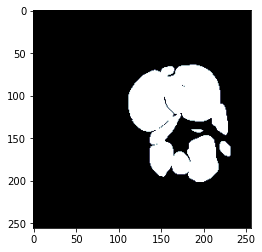

=== Slice 3156 ===


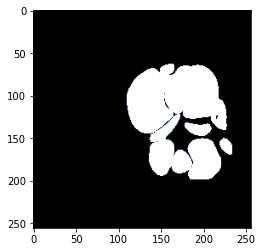

=== Slice 3158 ===


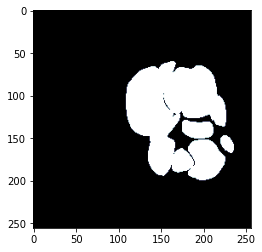

=== Slice 3160 ===


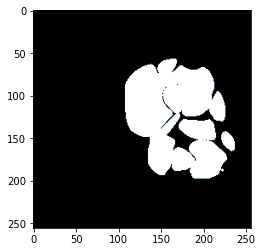

=== Slice 3162 ===


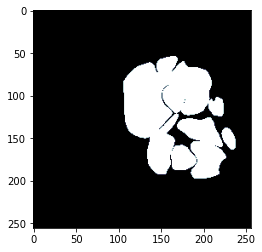

=== Slice 3164 ===


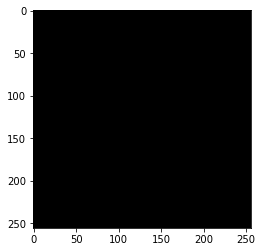

=== Slice 3166 ===


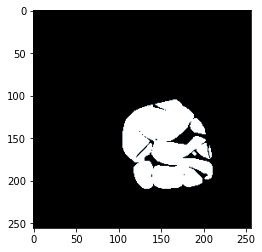

=== Slice 3168 ===


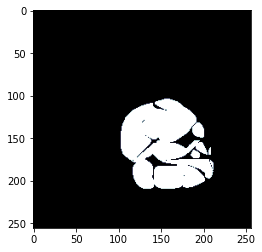

=== Slice 3170 ===


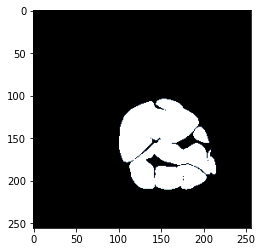

=== Slice 3172 ===


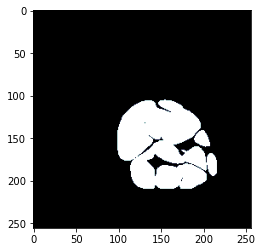

=== Slice 3174 ===


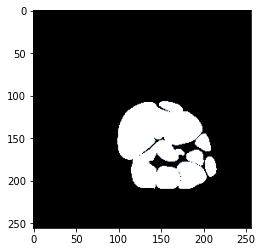

=== Slice 3176 ===


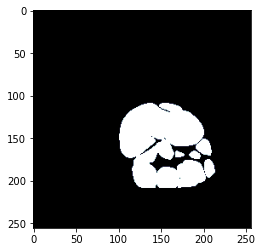

=== Slice 3178 ===


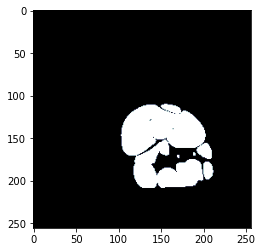

=== Slice 3180 ===


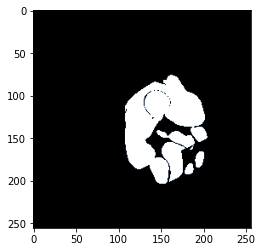

=== Slice 3182 ===


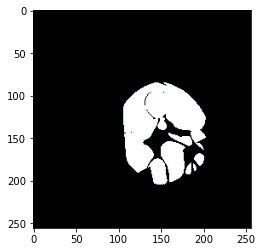

=== Slice 3184 ===


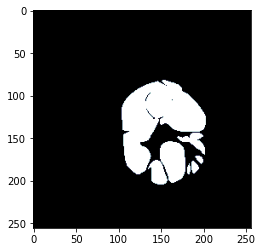

=== Slice 3186 ===


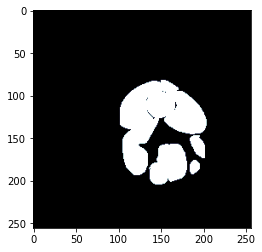

=== Slice 3188 ===


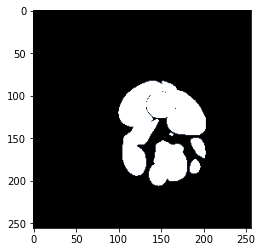

=== Slice 3190 ===


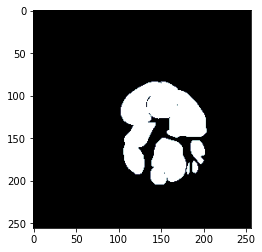

=== Slice 3192 ===


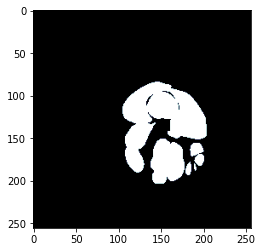

=== Slice 3194 ===


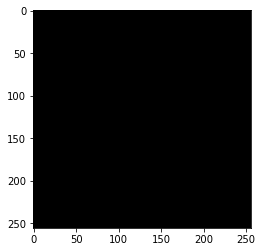

=== Slice 3196 ===


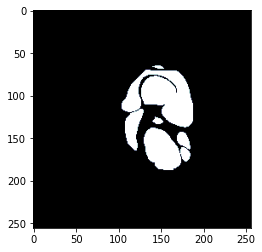

=== Slice 3198 ===


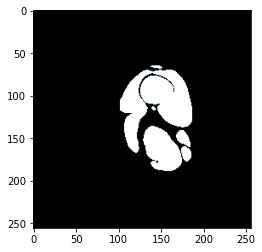

=== Slice 3200 ===


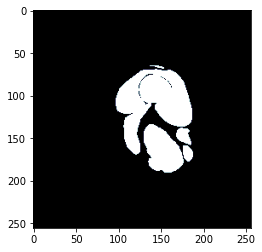

=== Slice 3202 ===


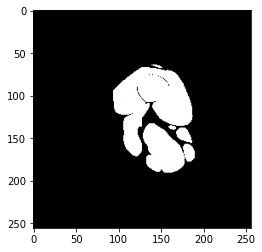

=== Slice 3204 ===


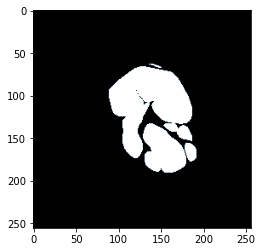

=== Slice 3206 ===


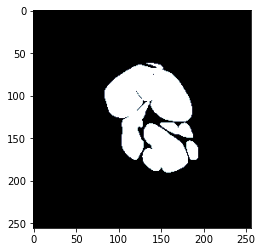

=== Slice 3208 ===


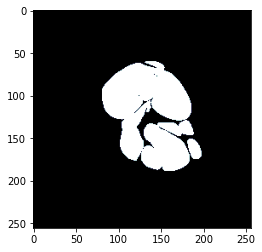

=== Slice 3210 ===


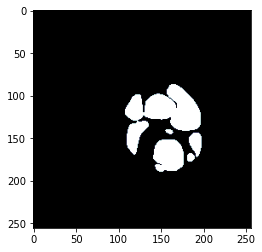

=== Slice 3212 ===


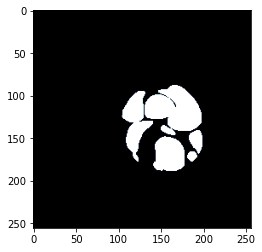

=== Slice 3214 ===


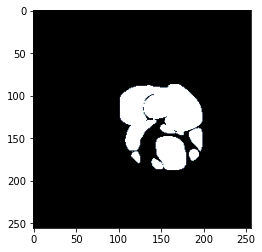

=== Slice 3216 ===


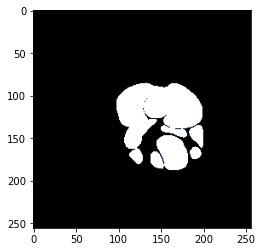

=== Slice 3218 ===


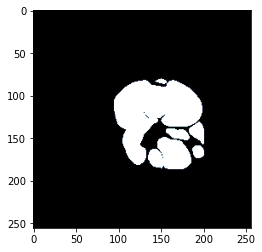

=== Slice 3220 ===


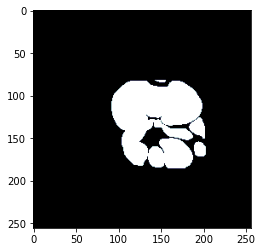

=== Slice 3222 ===


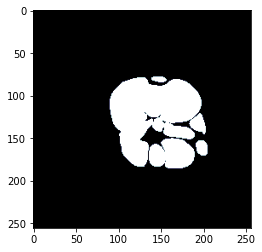

=== Slice 3224 ===


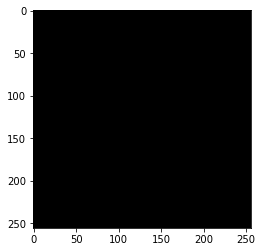

=== Slice 3226 ===


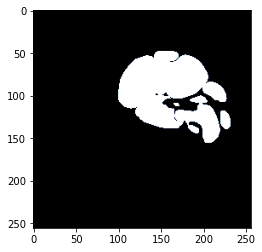

=== Slice 3228 ===


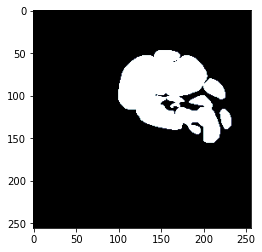

=== Slice 3230 ===


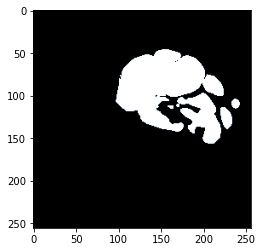

=== Slice 3232 ===


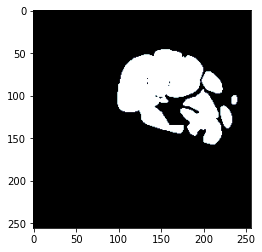

=== Slice 3234 ===


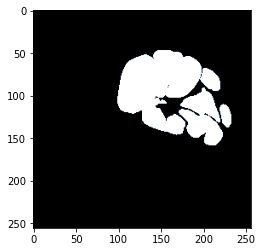

=== Slice 3236 ===


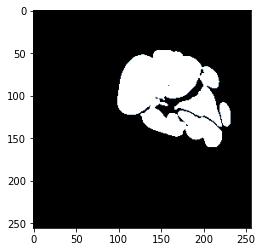

=== Slice 3238 ===


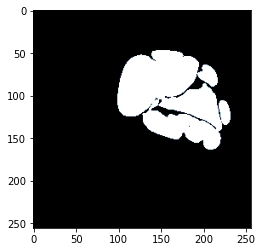

=== Slice 3240 ===


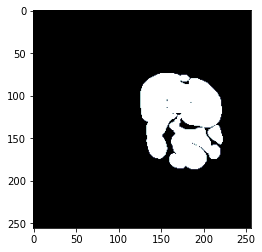

=== Slice 3242 ===


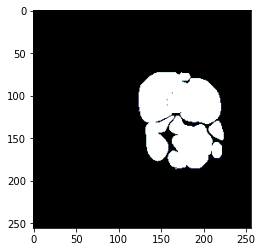

=== Slice 3244 ===


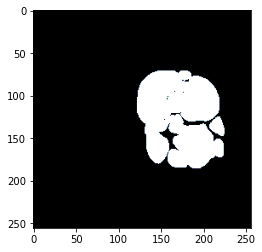

=== Slice 3246 ===


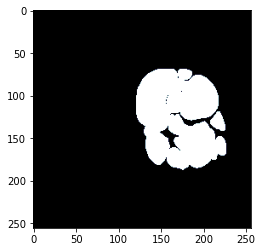

=== Slice 3248 ===


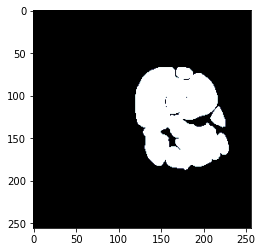

=== Slice 3250 ===


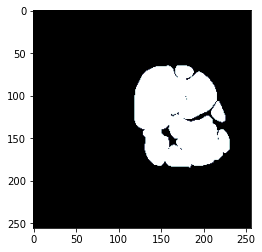

=== Slice 3252 ===


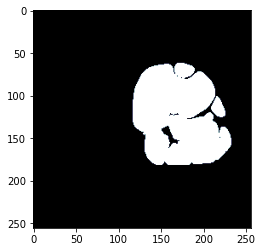

=== Slice 3254 ===


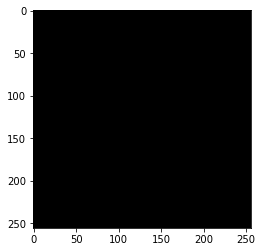

=== Slice 3256 ===


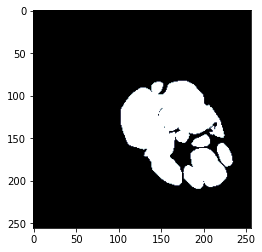

=== Slice 3258 ===


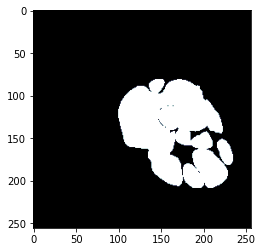

=== Slice 3260 ===


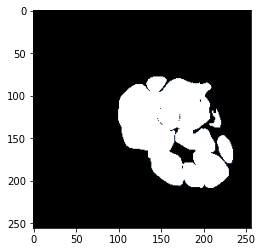

=== Slice 3262 ===


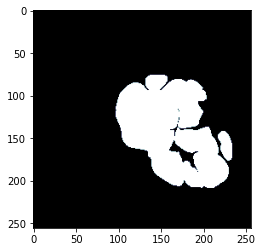

=== Slice 3264 ===


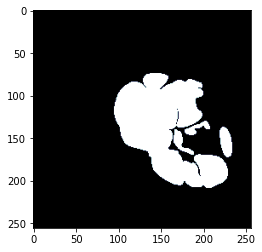

=== Slice 3266 ===


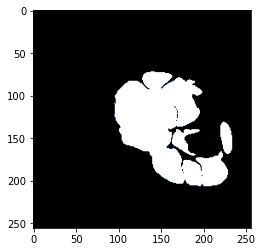

=== Slice 3268 ===


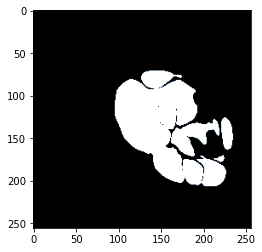

=== Slice 3270 ===


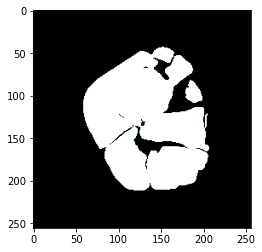

=== Slice 3272 ===


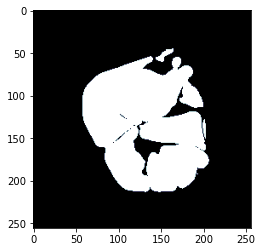

=== Slice 3274 ===


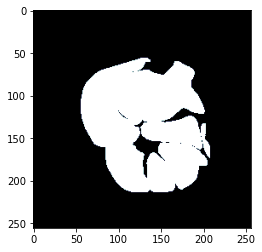

=== Slice 3276 ===


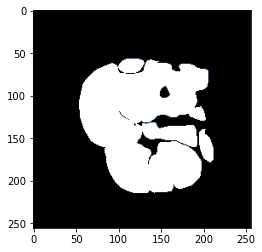

=== Slice 3278 ===


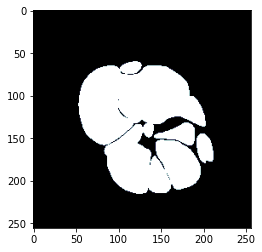

=== Slice 3280 ===


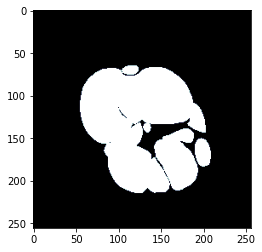

=== Slice 3282 ===


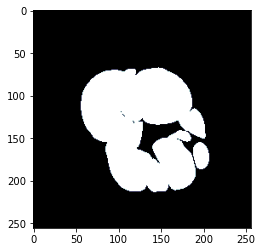

=== Slice 3284 ===


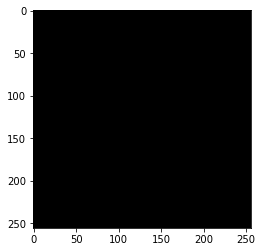

=== Slice 3286 ===


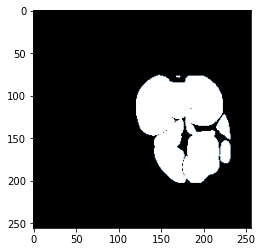

=== Slice 3288 ===


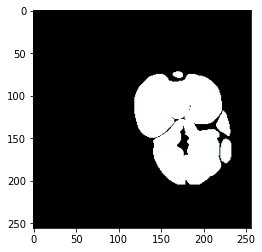

=== Slice 3290 ===


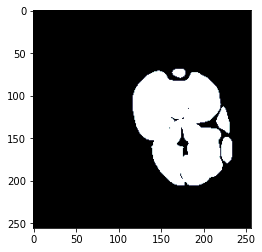

=== Slice 3292 ===


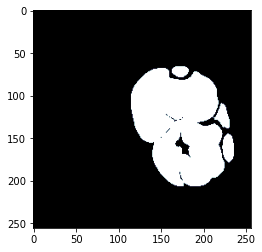

=== Slice 3294 ===


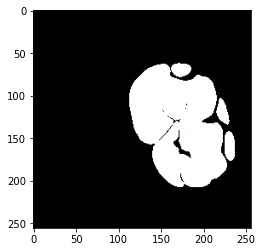

=== Slice 3296 ===


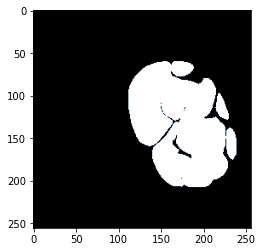

=== Slice 3298 ===


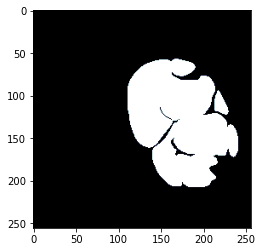

=== Slice 3300 ===


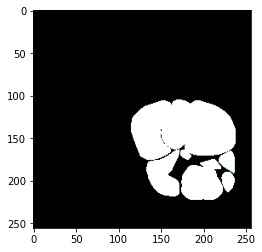

=== Slice 3302 ===


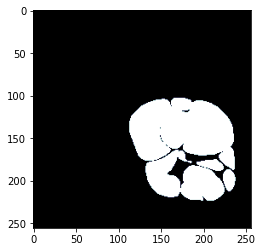

=== Slice 3304 ===


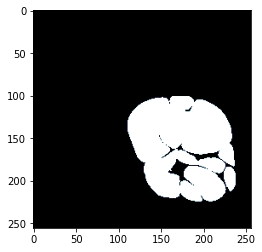

=== Slice 3306 ===


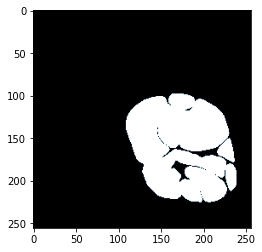

=== Slice 3308 ===


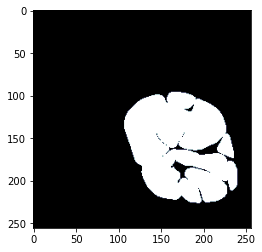

=== Slice 3310 ===


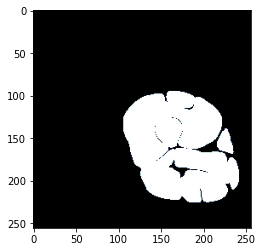

=== Slice 3312 ===


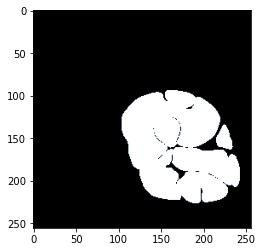

=== Slice 3314 ===


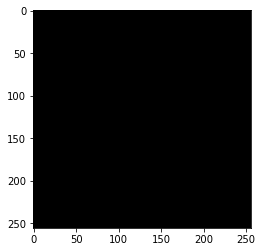

=== Slice 3316 ===


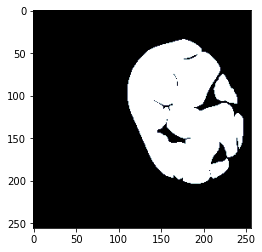

=== Slice 3318 ===


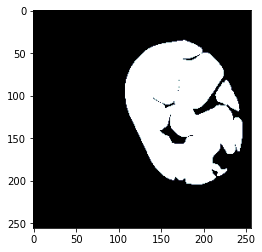

=== Slice 3320 ===


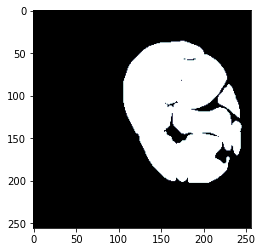

=== Slice 3322 ===


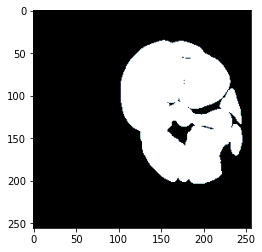

=== Slice 3324 ===


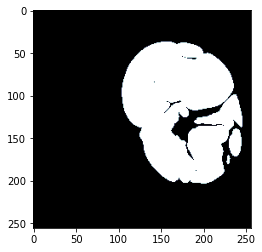

=== Slice 3326 ===


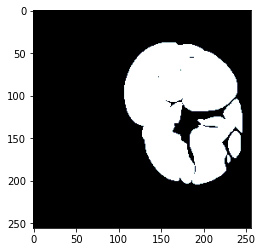

=== Slice 3328 ===


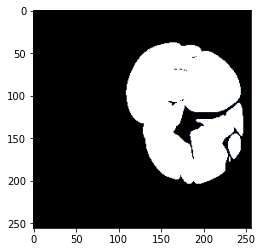

=== Slice 3330 ===


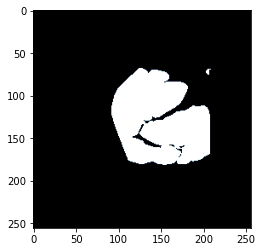

=== Slice 3332 ===


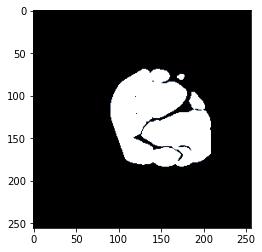

=== Slice 3334 ===


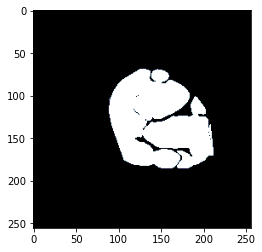

=== Slice 3336 ===


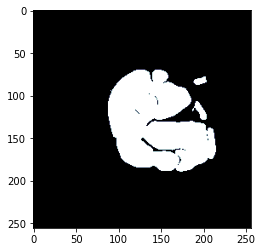

=== Slice 3338 ===


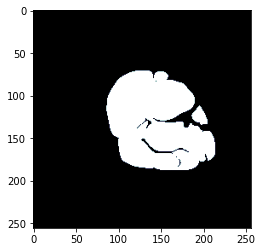

=== Slice 3340 ===


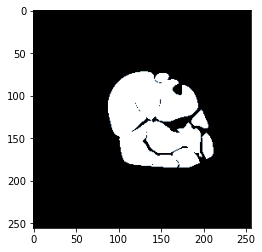

=== Slice 3342 ===


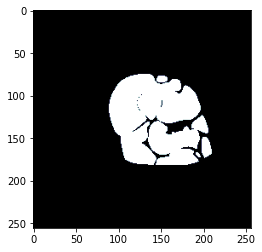

=== Slice 3344 ===


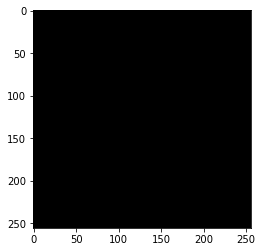

=== Slice 3346 ===


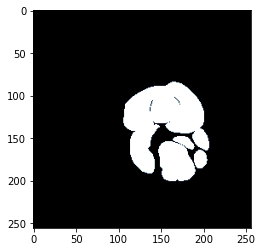

=== Slice 3348 ===


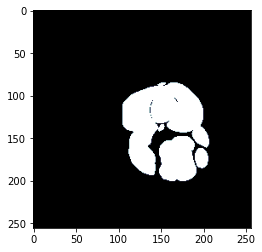

=== Slice 3350 ===


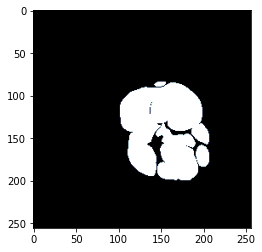

=== Slice 3352 ===


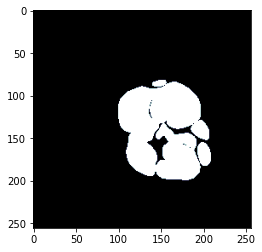

=== Slice 3354 ===


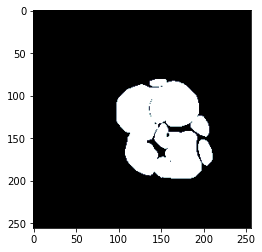

=== Slice 3356 ===


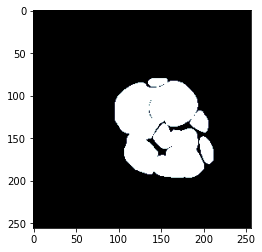

=== Slice 3358 ===


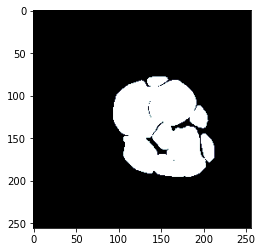

=== Slice 3360 ===


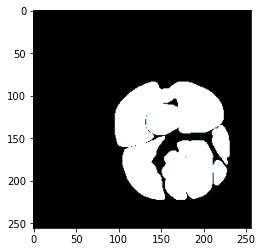

=== Slice 3362 ===


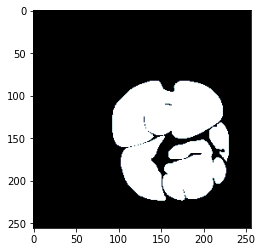

=== Slice 3364 ===


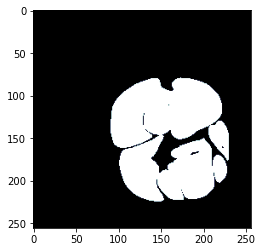

=== Slice 3366 ===


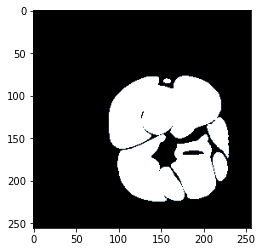

=== Slice 3368 ===


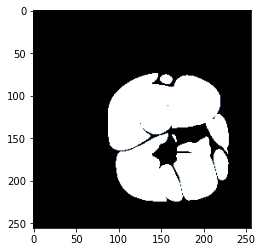

=== Slice 3370 ===


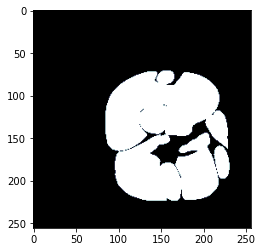

=== Slice 3372 ===


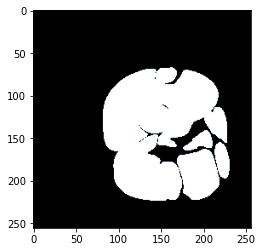

=== Slice 3374 ===


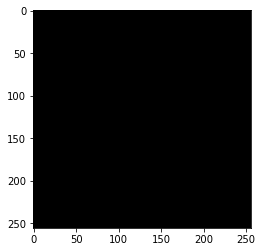

=== Slice 3376 ===


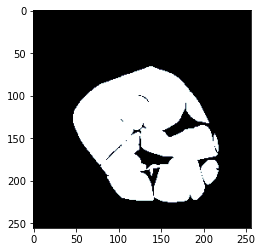

=== Slice 3378 ===


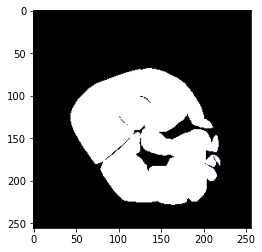

=== Slice 3380 ===


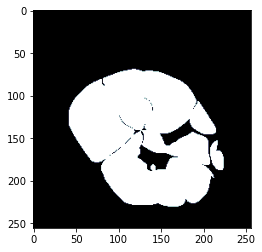

=== Slice 3382 ===


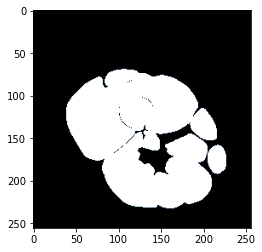

=== Slice 3384 ===


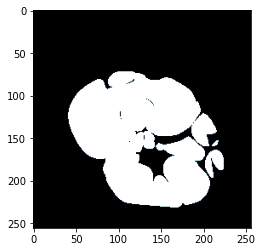

=== Slice 3386 ===


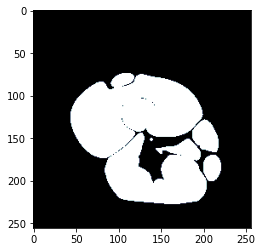

=== Slice 3388 ===


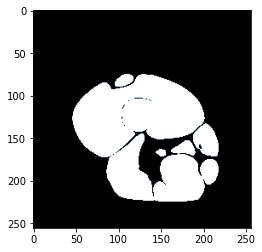

=== Slice 3390 ===


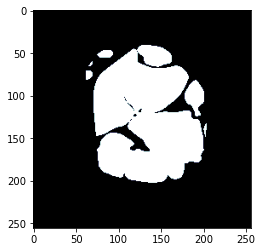

=== Slice 3392 ===


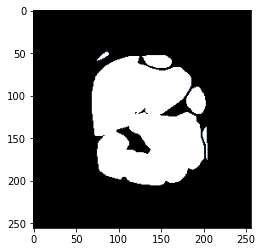

=== Slice 3394 ===


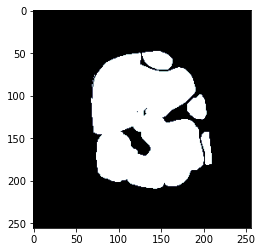

=== Slice 3396 ===


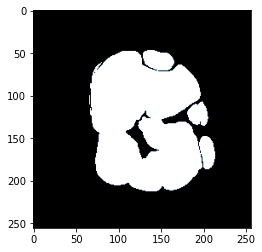

=== Slice 3398 ===


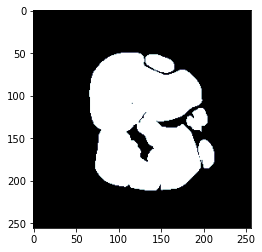

=== Slice 3400 ===


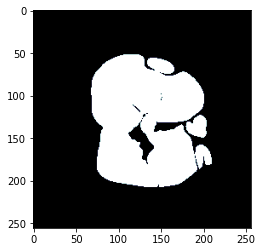

=== Slice 3402 ===


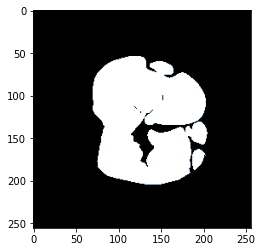

=== Slice 3404 ===


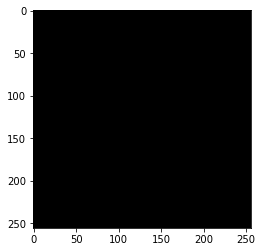

=== Slice 3406 ===


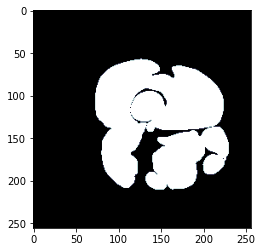

=== Slice 3408 ===


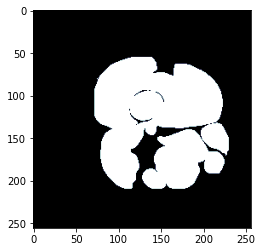

=== Slice 3410 ===


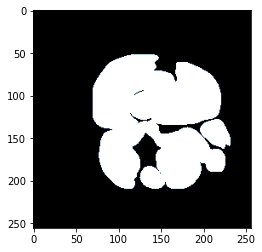

=== Slice 3412 ===


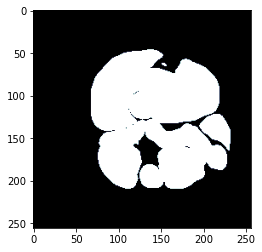

=== Slice 3414 ===


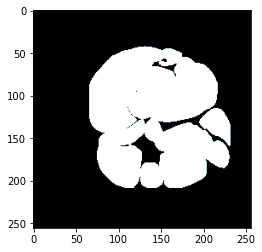

=== Slice 3416 ===


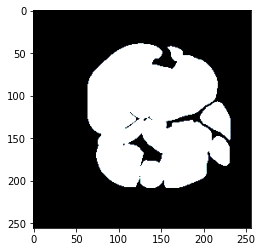

=== Slice 3418 ===


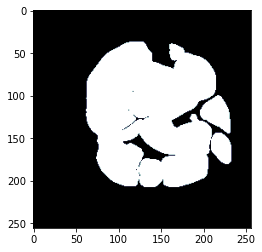

=== Slice 3420 ===


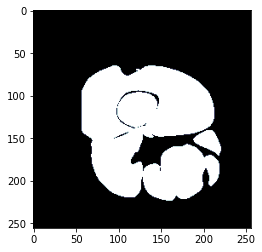

=== Slice 3422 ===


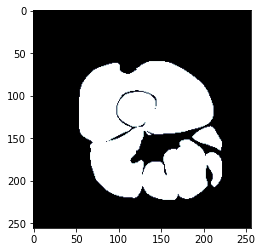

=== Slice 3424 ===


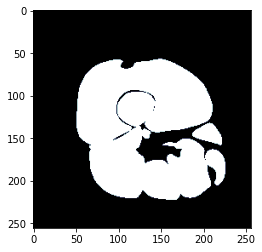

=== Slice 3426 ===


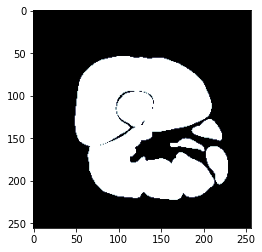

=== Slice 3428 ===


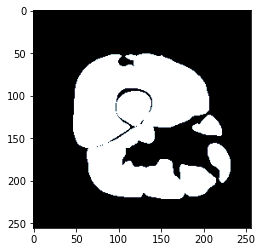

=== Slice 3430 ===


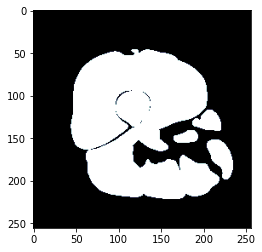

=== Slice 3432 ===


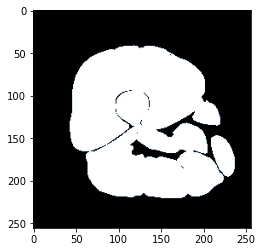

=== Slice 3434 ===


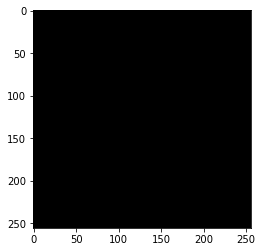

=== Slice 3436 ===


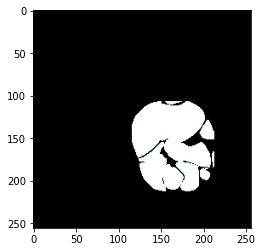

=== Slice 3438 ===


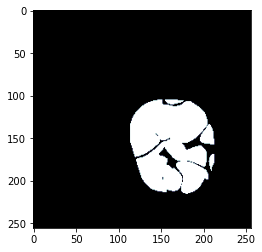

=== Slice 3440 ===


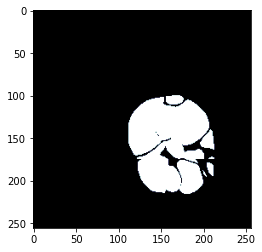

=== Slice 3442 ===


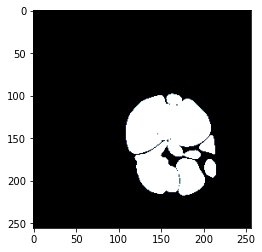

=== Slice 3444 ===


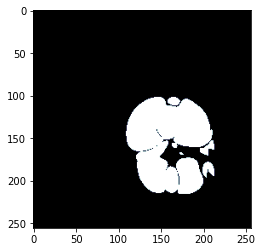

=== Slice 3446 ===


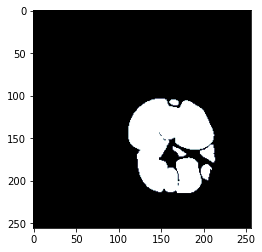

=== Slice 3448 ===


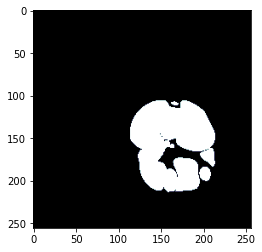

=== Slice 3450 ===


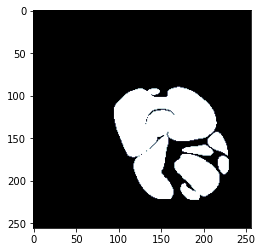

=== Slice 3452 ===


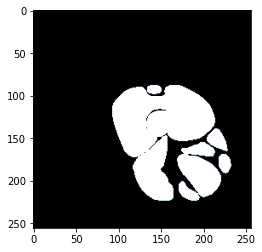

=== Slice 3454 ===


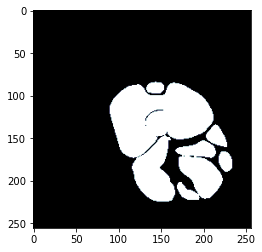

=== Slice 3456 ===


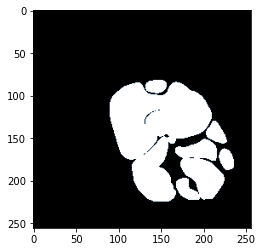

=== Slice 3458 ===


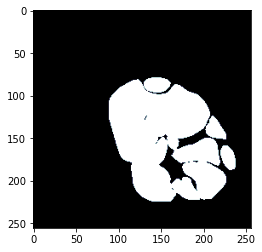

=== Slice 3460 ===


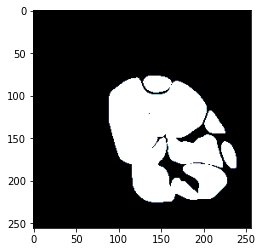

=== Slice 3462 ===


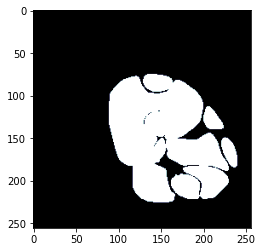

=== Slice 3464 ===


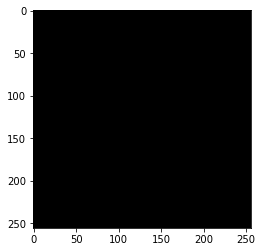

=== Slice 3466 ===


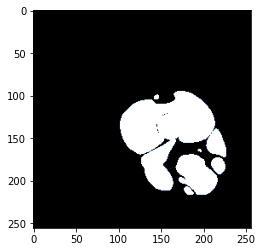

=== Slice 3468 ===


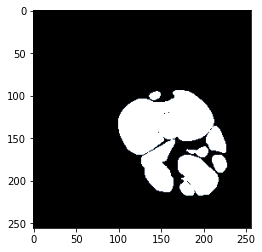

=== Slice 3470 ===


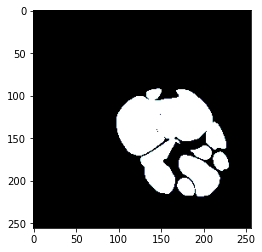

=== Slice 3472 ===


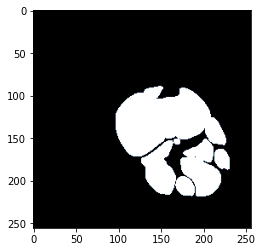

=== Slice 3474 ===


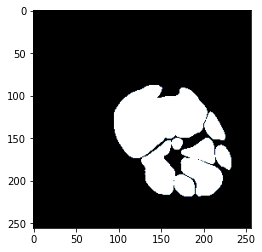

=== Slice 3476 ===


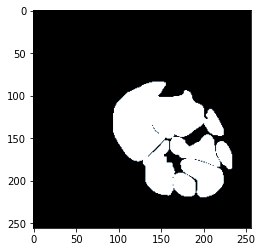

=== Slice 3478 ===


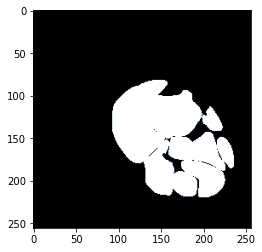

=== Slice 3480 ===


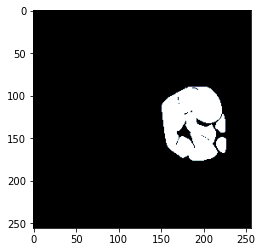

=== Slice 3482 ===


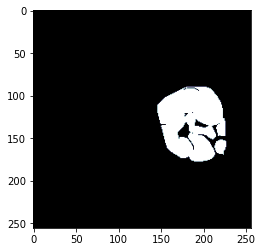

=== Slice 3484 ===


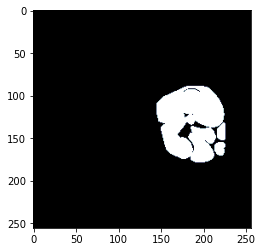

=== Slice 3486 ===


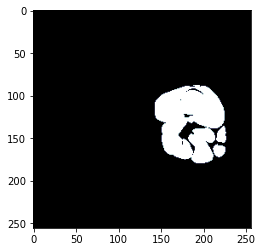

=== Slice 3488 ===


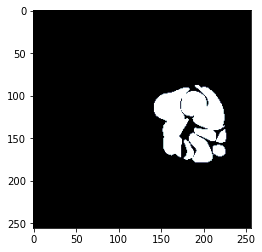

=== Slice 3490 ===


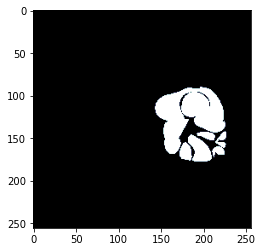

=== Slice 3492 ===


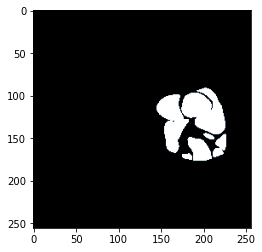

=== Slice 3494 ===


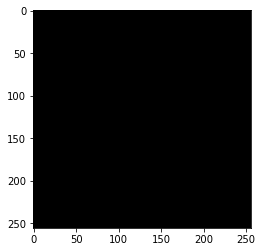

=== Slice 3496 ===


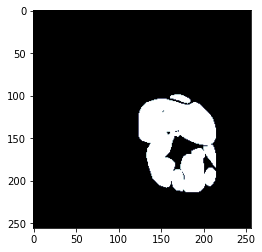

=== Slice 3498 ===


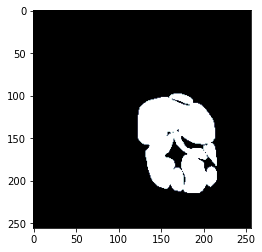

=== Slice 3500 ===


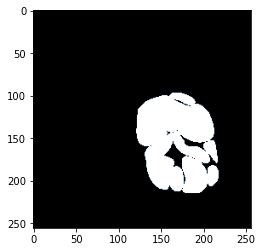

=== Slice 3502 ===


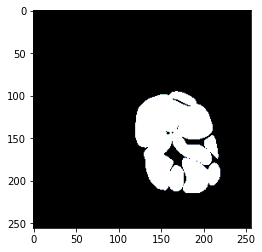

=== Slice 3504 ===


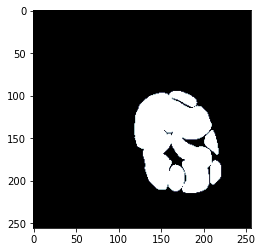

=== Slice 3506 ===


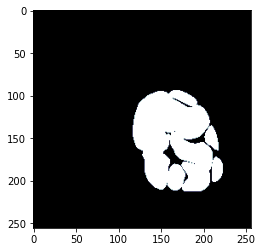

=== Slice 3508 ===


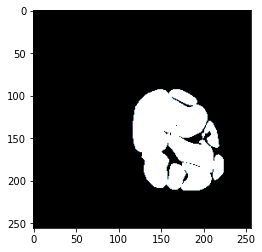

=== Slice 3510 ===


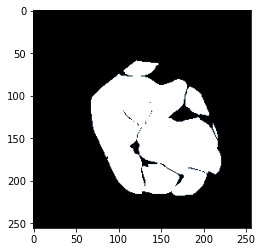

=== Slice 3512 ===


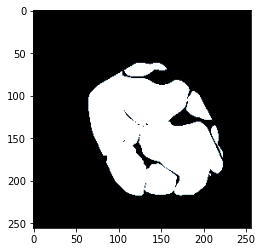

=== Slice 3514 ===


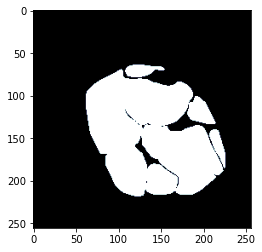

=== Slice 3516 ===


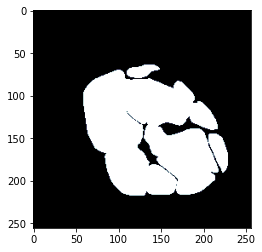

=== Slice 3518 ===


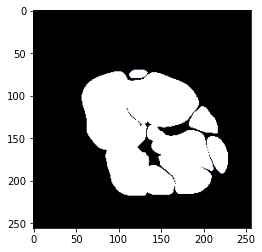

=== Slice 3520 ===


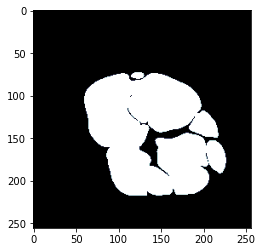

=== Slice 3522 ===


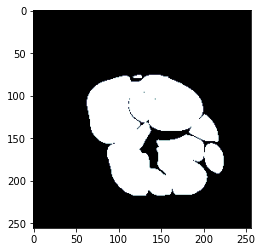

=== Slice 3524 ===


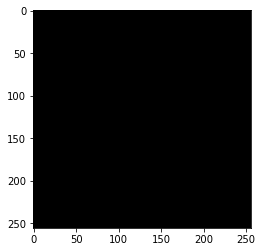

=== Slice 3526 ===


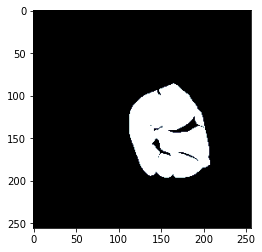

=== Slice 3528 ===


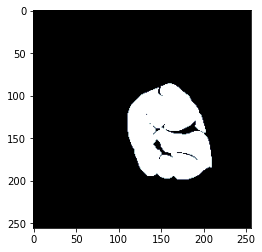

=== Slice 3530 ===


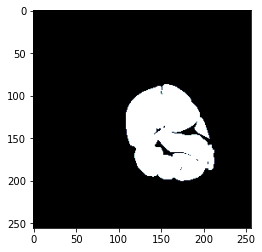

=== Slice 3532 ===


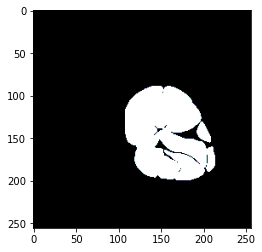

=== Slice 3534 ===


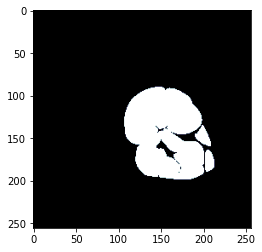

=== Slice 3536 ===


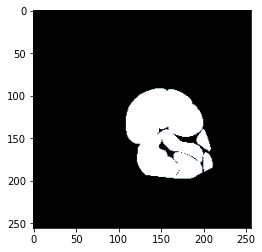

=== Slice 3538 ===


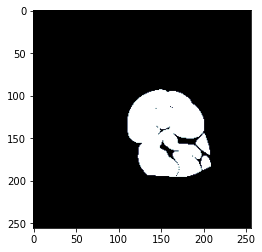

=== Slice 3540 ===


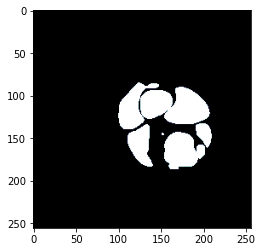

=== Slice 3542 ===


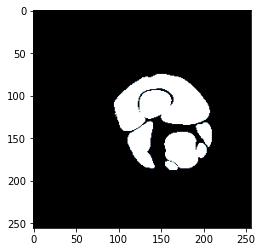

=== Slice 3544 ===


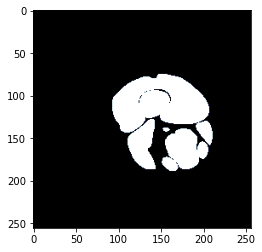

=== Slice 3546 ===


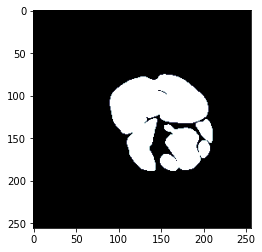

=== Slice 3548 ===


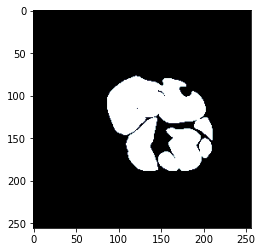

=== Slice 3550 ===


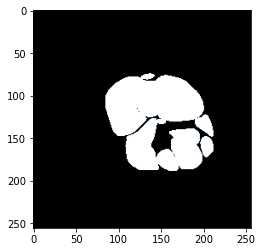

=== Slice 3552 ===


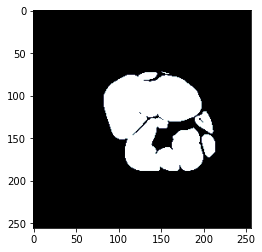

=== Slice 3554 ===


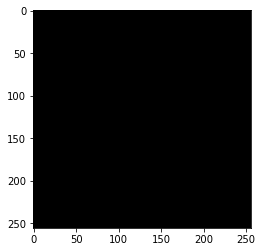

=== Slice 3556 ===


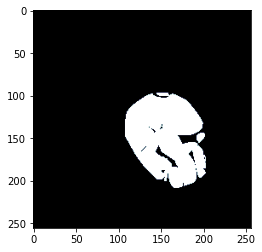

=== Slice 3558 ===


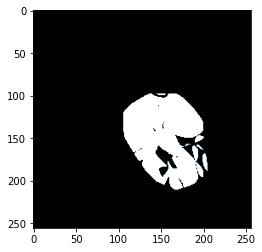

=== Slice 3560 ===


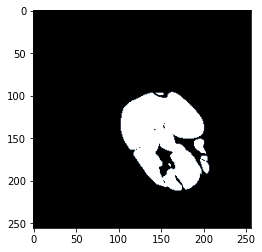

=== Slice 3562 ===


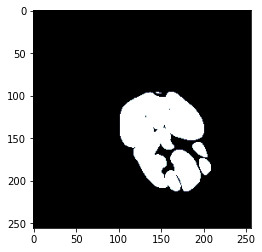

=== Slice 3564 ===


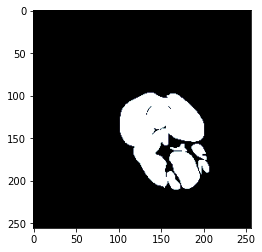

=== Slice 3566 ===


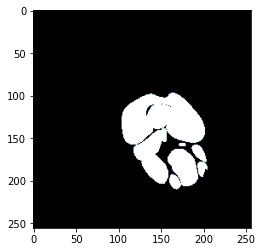

=== Slice 3568 ===


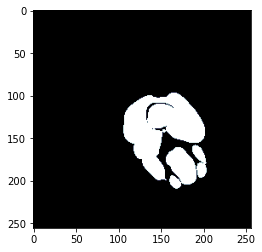

=== Slice 3570 ===


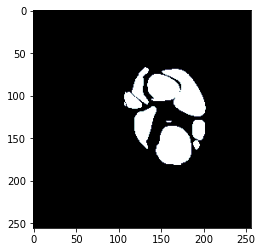

=== Slice 3572 ===


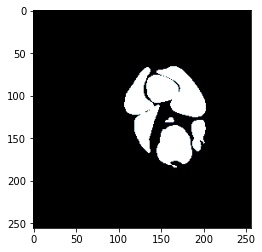

=== Slice 3574 ===


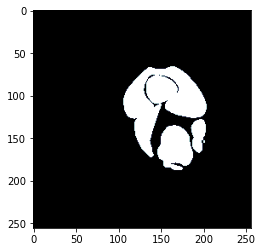

=== Slice 3576 ===


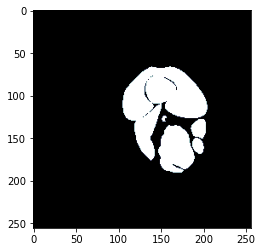

=== Slice 3578 ===


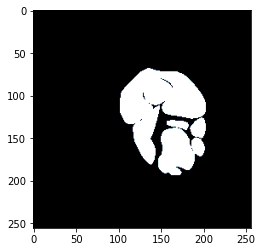

=== Slice 3580 ===


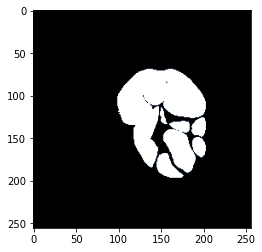

=== Slice 3582 ===


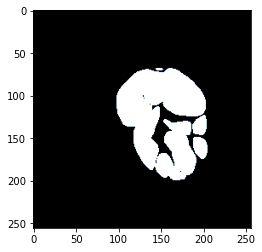

=== Slice 3584 ===


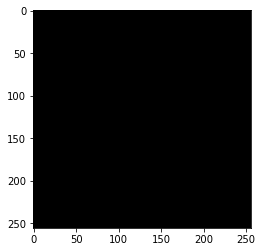

=== Slice 3586 ===


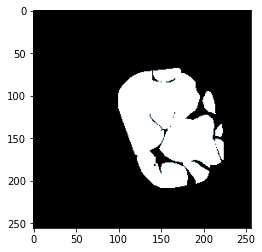

=== Slice 3588 ===


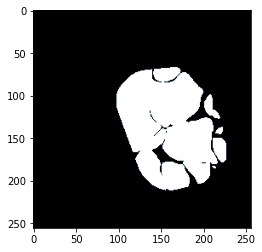

=== Slice 3590 ===


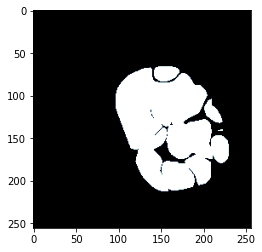

=== Slice 3592 ===


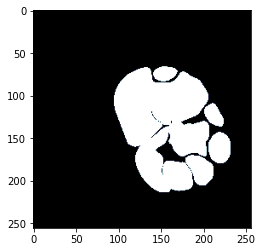

=== Slice 3594 ===


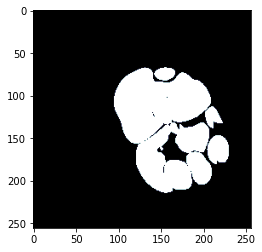

=== Slice 3596 ===


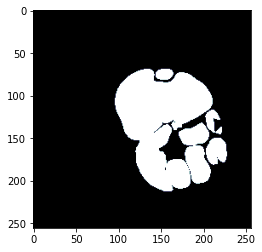

=== Slice 3598 ===


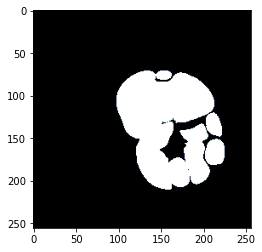

=== Slice 3600 ===


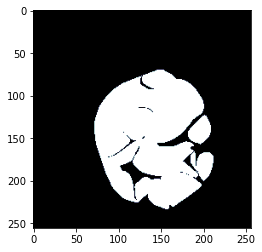

=== Slice 3602 ===


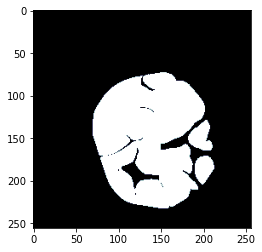

=== Slice 3604 ===


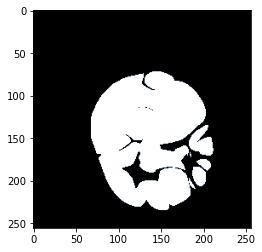

=== Slice 3606 ===


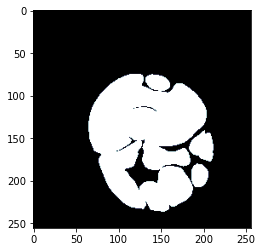

=== Slice 3608 ===


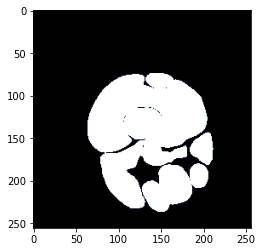

=== Slice 3610 ===


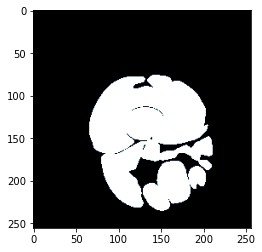

=== Slice 3612 ===


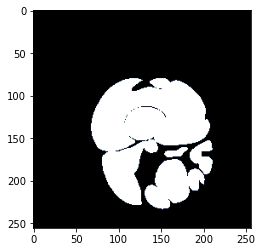

=== Slice 3614 ===


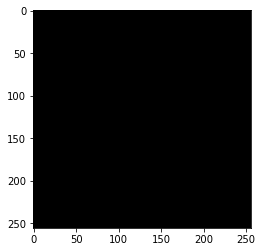

=== Slice 3616 ===


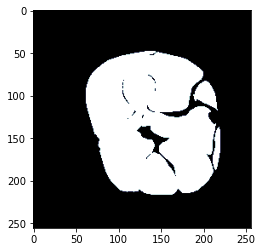

=== Slice 3618 ===


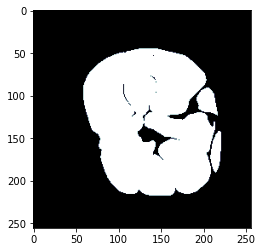

=== Slice 3620 ===


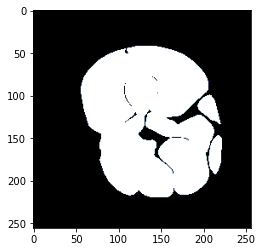

=== Slice 3622 ===


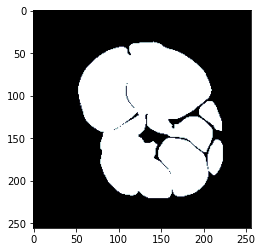

=== Slice 3624 ===


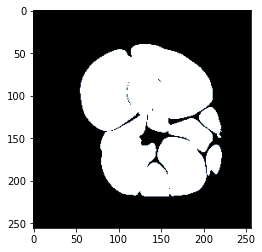

=== Slice 3626 ===


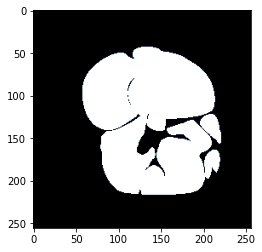

=== Slice 3628 ===


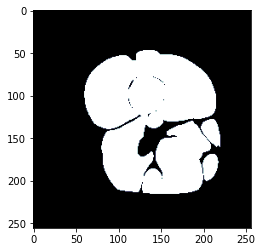

=== Slice 3630 ===


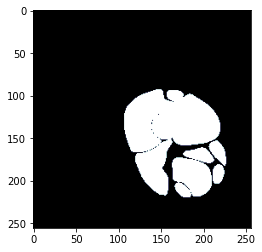

=== Slice 3632 ===


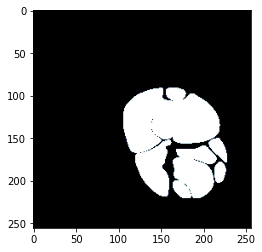

=== Slice 3634 ===


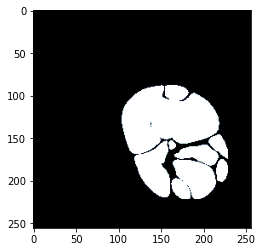

=== Slice 3636 ===


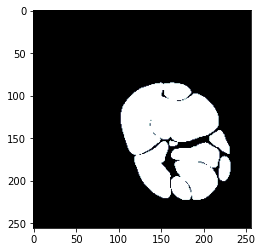

=== Slice 3638 ===


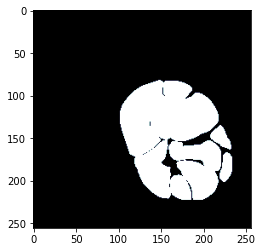

=== Slice 3640 ===


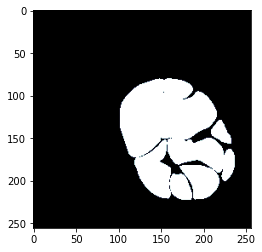

=== Slice 3642 ===


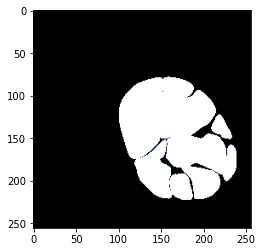

=== Slice 3644 ===


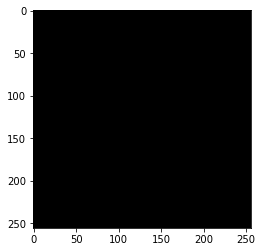

=== Slice 3646 ===


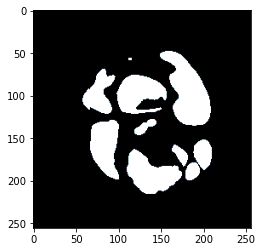

=== Slice 3648 ===


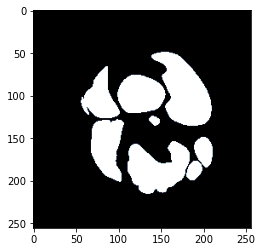

=== Slice 3650 ===


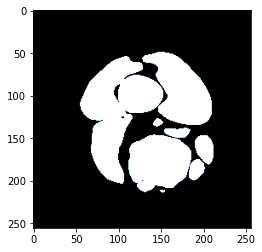

=== Slice 3652 ===


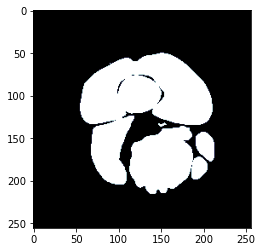

=== Slice 3654 ===


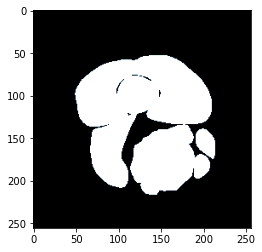

=== Slice 3656 ===


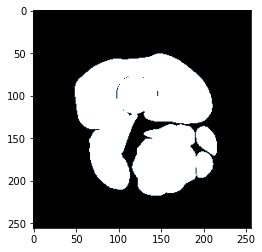

=== Slice 3658 ===


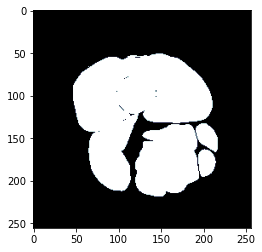

=== Slice 3660 ===


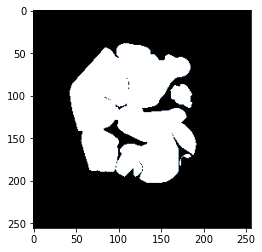

=== Slice 3662 ===


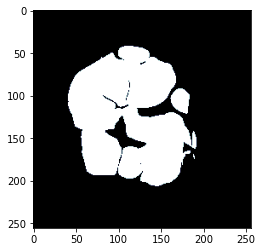

=== Slice 3664 ===


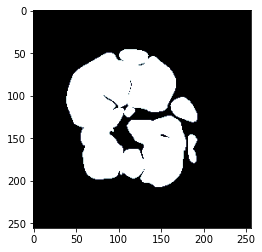

=== Slice 3666 ===


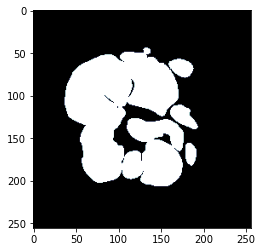

=== Slice 3668 ===


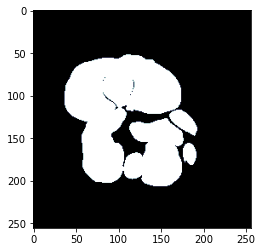

=== Slice 3670 ===


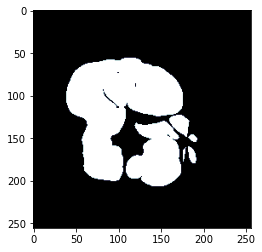

=== Slice 3672 ===


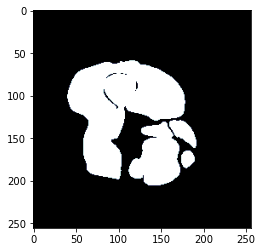

=== Slice 3674 ===


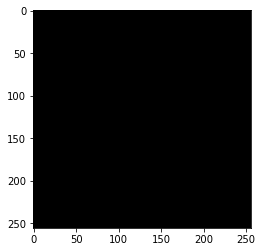

=== Slice 3676 ===


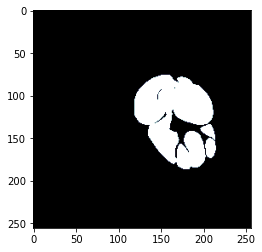

=== Slice 3678 ===


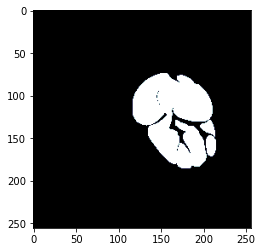

=== Slice 3680 ===


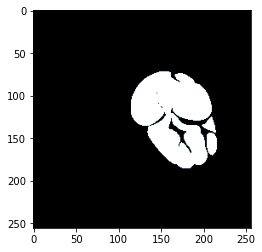

=== Slice 3682 ===


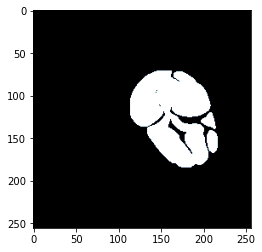

=== Slice 3684 ===


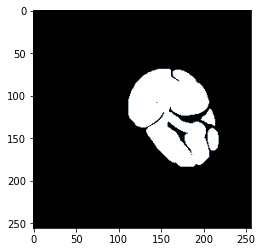

=== Slice 3686 ===


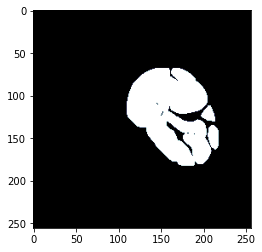

=== Slice 3688 ===


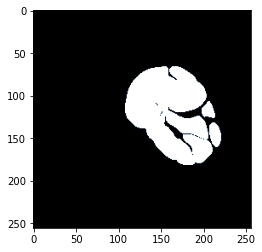

=== Slice 3690 ===


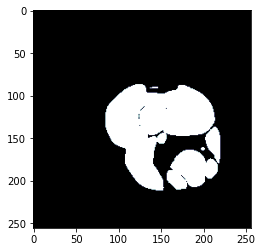

=== Slice 3692 ===


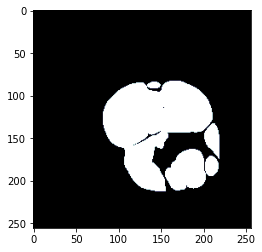

=== Slice 3694 ===


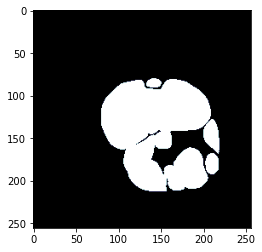

=== Slice 3696 ===


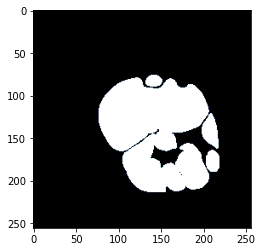

=== Slice 3698 ===


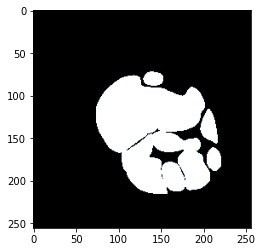

=== Slice 3700 ===


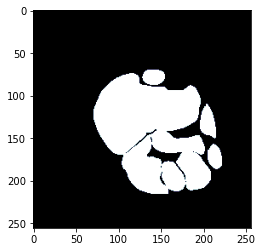

=== Slice 3702 ===


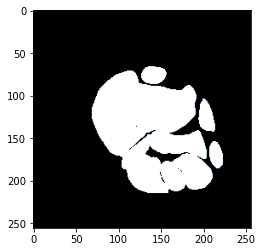

=== Slice 3704 ===


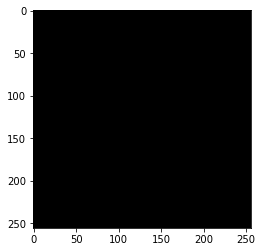

=== Slice 3706 ===


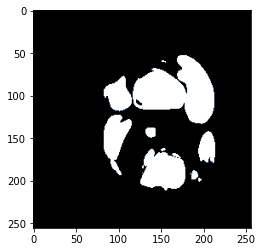

=== Slice 3708 ===


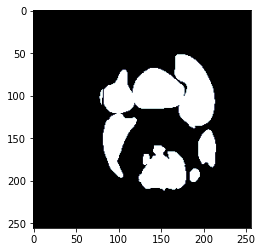

=== Slice 3710 ===


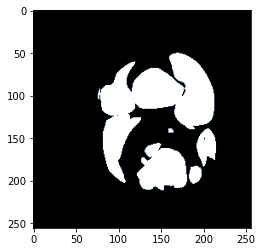

=== Slice 3712 ===


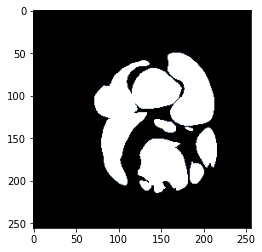

=== Slice 3714 ===


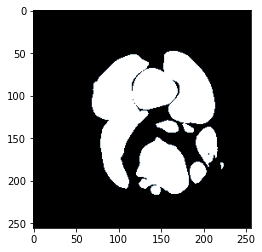

=== Slice 3716 ===


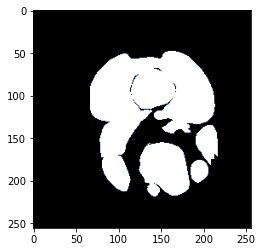

=== Slice 3718 ===


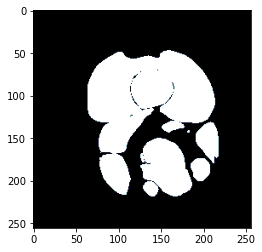

=== Slice 3720 ===


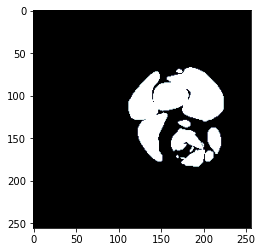

=== Slice 3722 ===


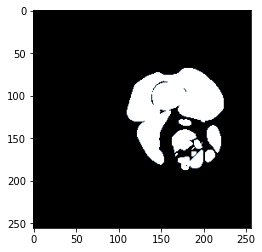

=== Slice 3724 ===


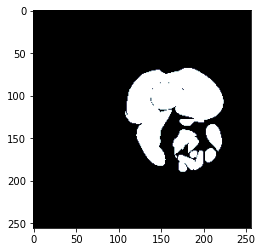

=== Slice 3726 ===


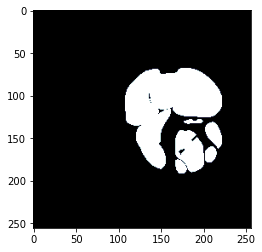

=== Slice 3728 ===


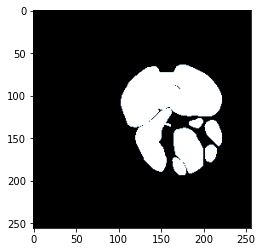

=== Slice 3730 ===


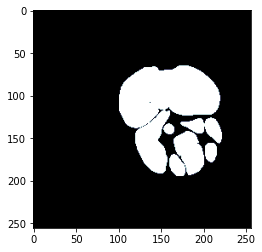

=== Slice 3732 ===


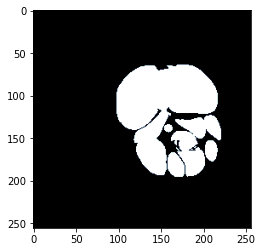

=== Slice 3734 ===


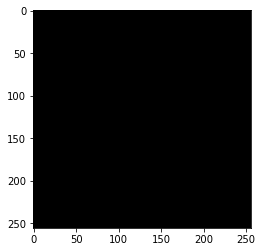

=== Slice 3736 ===


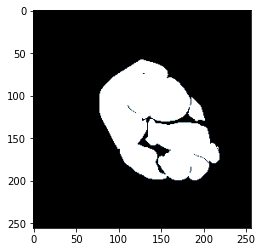

=== Slice 3738 ===


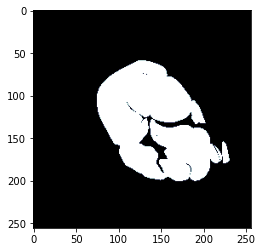

=== Slice 3740 ===


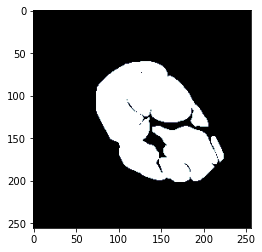

=== Slice 3742 ===


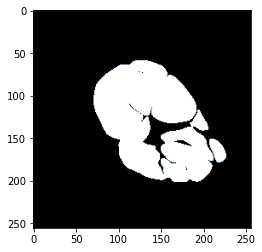

=== Slice 3744 ===


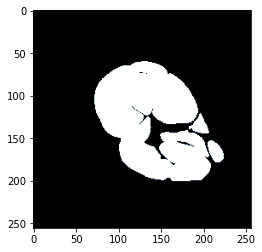

=== Slice 3746 ===


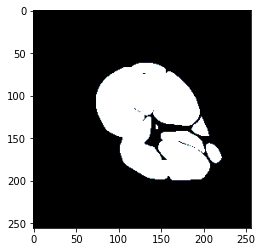

=== Slice 3748 ===


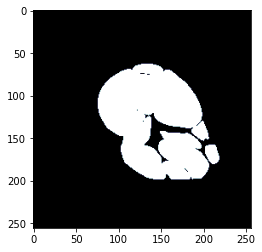

=== Slice 3750 ===


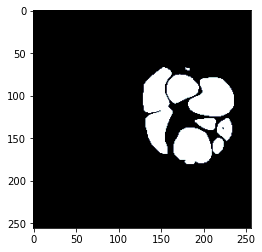

=== Slice 3752 ===


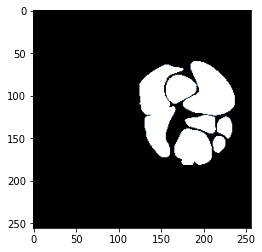

=== Slice 3754 ===


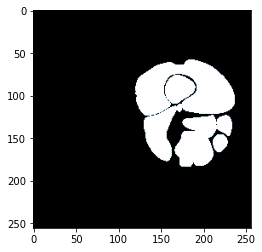

=== Slice 3756 ===


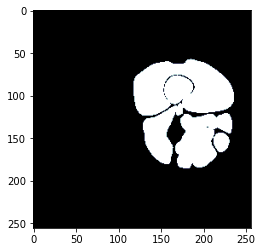

=== Slice 3758 ===


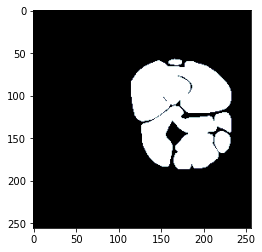

=== Slice 3760 ===


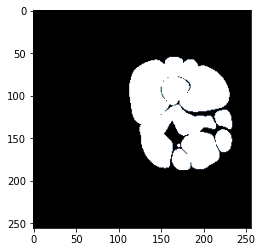

=== Slice 3762 ===


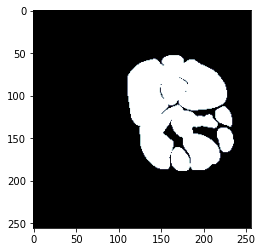

=== Slice 3764 ===


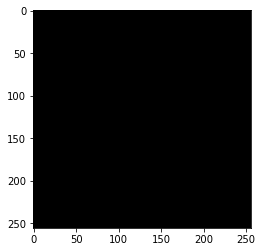

=== Slice 3766 ===


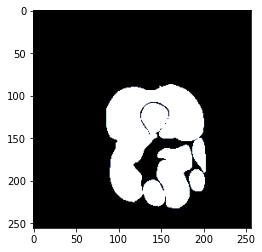

=== Slice 3768 ===


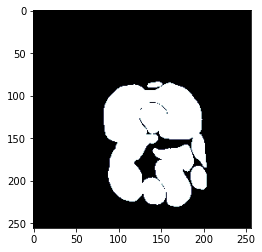

=== Slice 3770 ===


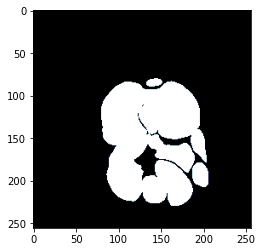

=== Slice 3772 ===


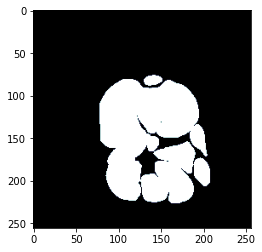

=== Slice 3774 ===


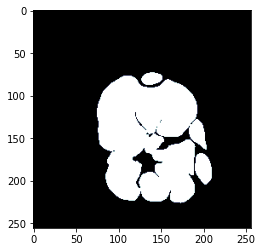

=== Slice 3776 ===


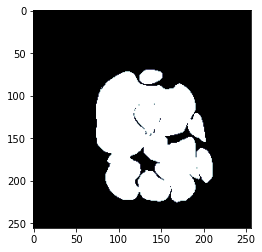

=== Slice 3778 ===


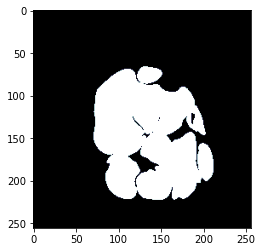

=== Slice 3780 ===


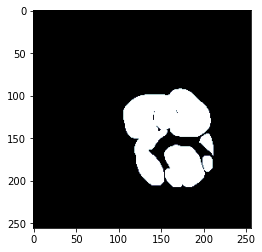

=== Slice 3782 ===


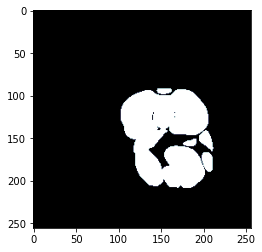

=== Slice 3784 ===


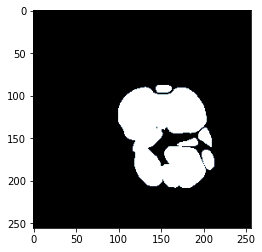

=== Slice 3786 ===


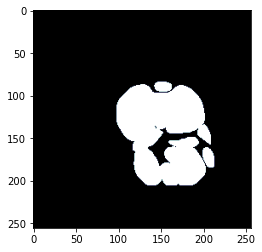

=== Slice 3788 ===


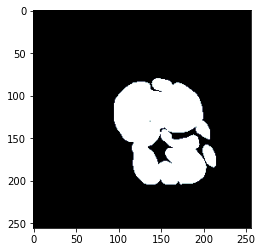

=== Slice 3790 ===


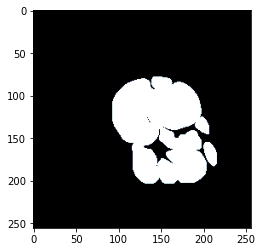

=== Slice 3792 ===


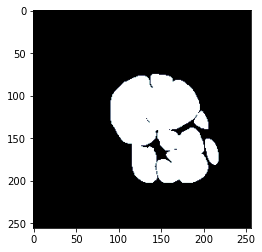

=== Slice 3794 ===


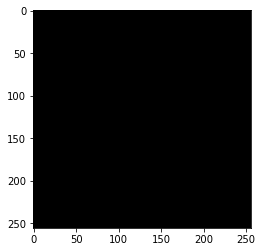

=== Slice 3796 ===


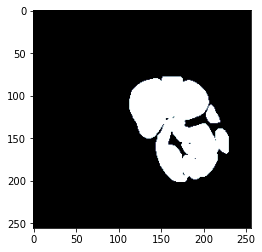

=== Slice 3798 ===


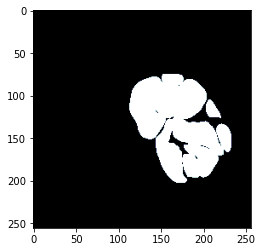

=== Slice 3800 ===


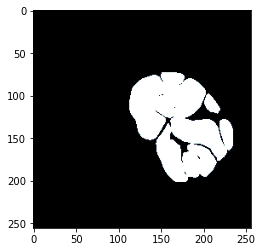

=== Slice 3802 ===


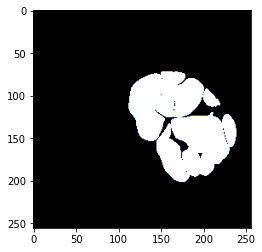

=== Slice 3804 ===


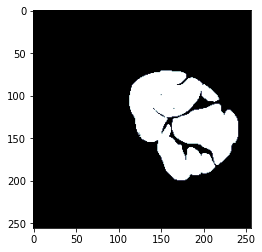

=== Slice 3806 ===


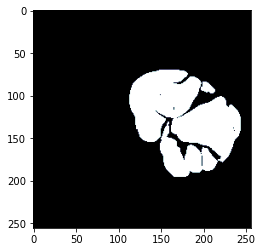

=== Slice 3808 ===


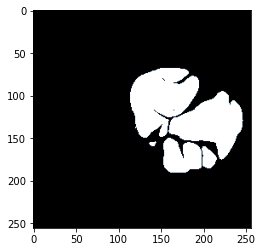

=== Slice 3810 ===


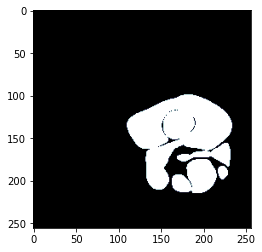

=== Slice 3812 ===


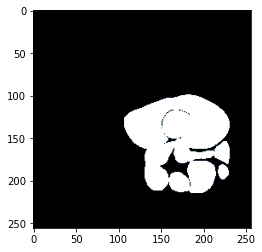

=== Slice 3814 ===


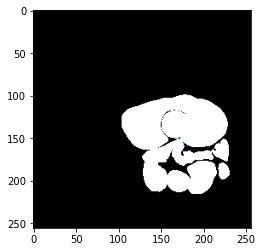

=== Slice 3816 ===


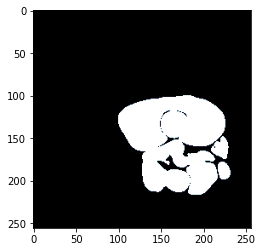

=== Slice 3818 ===


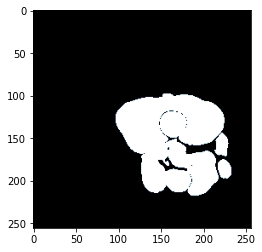

=== Slice 3820 ===


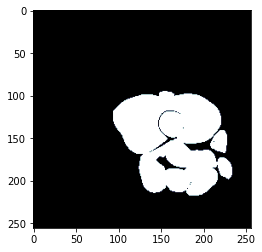

=== Slice 3822 ===


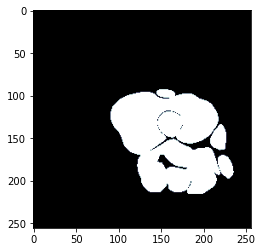

=== Slice 3824 ===


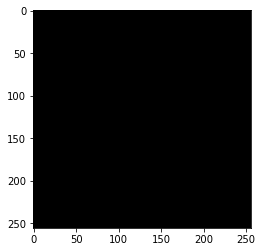

=== Slice 3826 ===


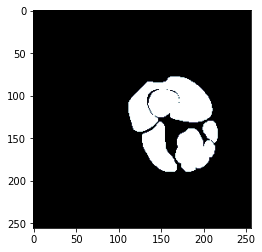

=== Slice 3828 ===


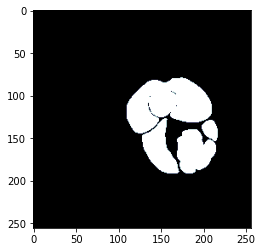

=== Slice 3830 ===


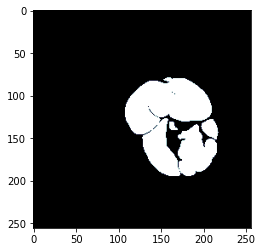

=== Slice 3832 ===


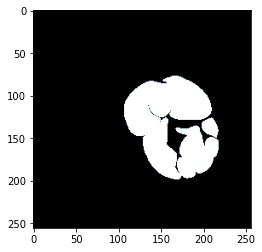

=== Slice 3834 ===


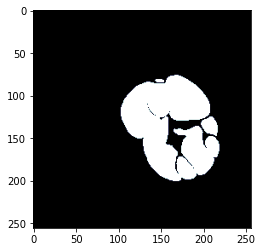

=== Slice 3836 ===


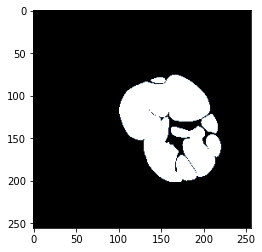

=== Slice 3838 ===


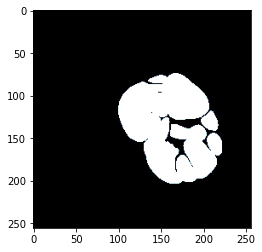

=== Slice 3840 ===


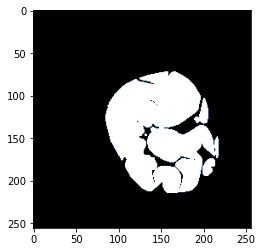

=== Slice 3842 ===


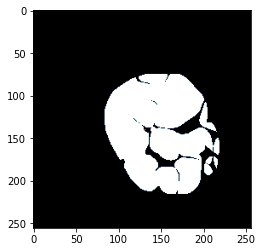

=== Slice 3844 ===


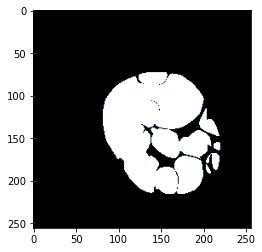

=== Slice 3846 ===


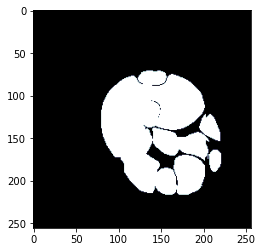

=== Slice 3848 ===


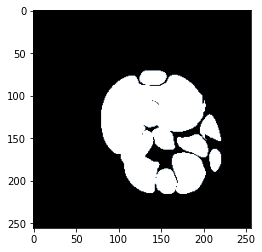

=== Slice 3850 ===


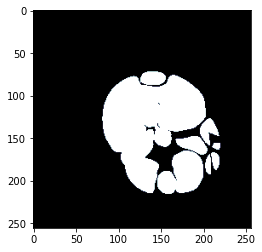

=== Slice 3852 ===


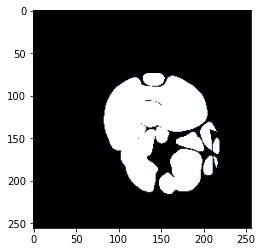

=== Slice 3854 ===


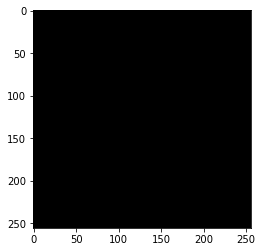

=== Slice 3856 ===


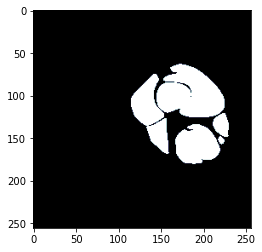

=== Slice 3858 ===


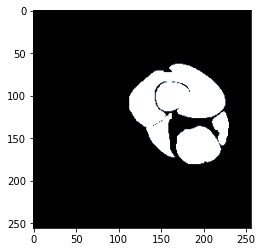

=== Slice 3860 ===


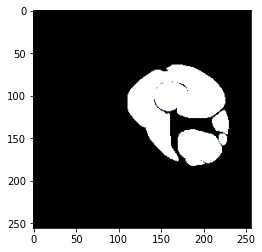

=== Slice 3862 ===


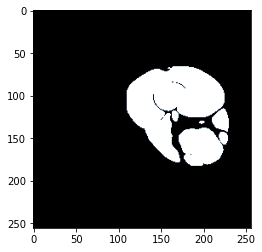

=== Slice 3864 ===


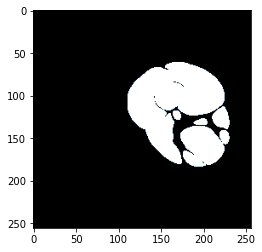

=== Slice 3866 ===


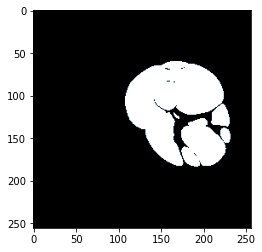

=== Slice 3868 ===


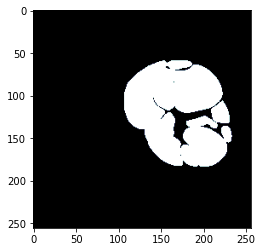

=== Slice 3870 ===


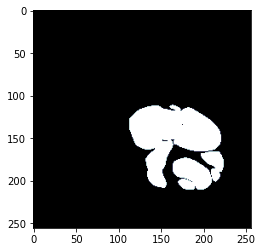

=== Slice 3872 ===


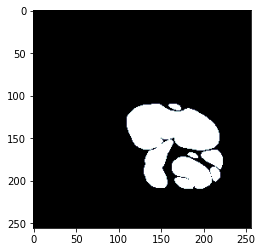

=== Slice 3874 ===


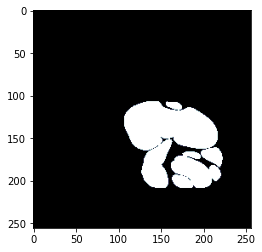

=== Slice 3876 ===


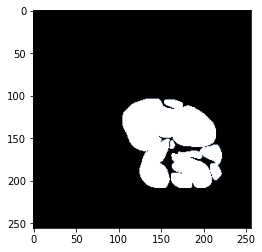

=== Slice 3878 ===


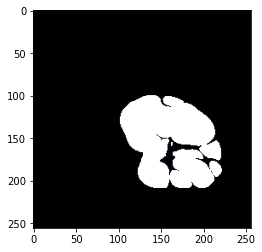

=== Slice 3880 ===


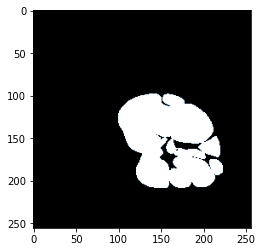

=== Slice 3882 ===


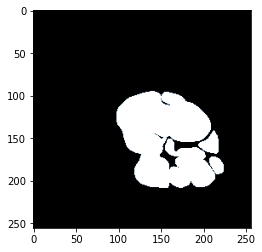

=== Slice 3884 ===


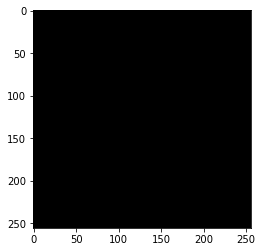

=== Slice 3886 ===


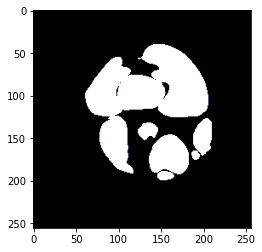

=== Slice 3888 ===


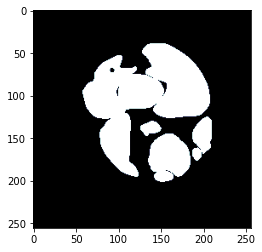

=== Slice 3890 ===


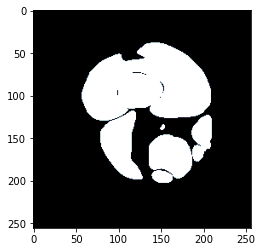

=== Slice 3892 ===


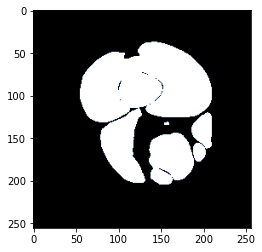

=== Slice 3894 ===


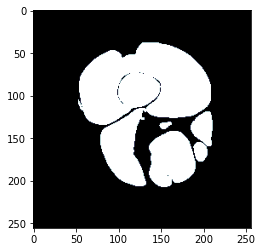

=== Slice 3896 ===


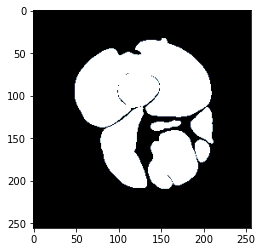

=== Slice 3898 ===


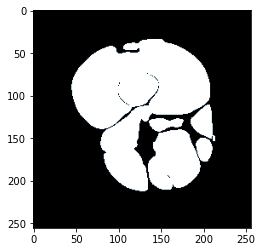

=== Slice 3900 ===


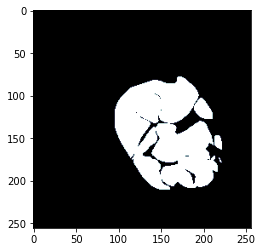

=== Slice 3902 ===


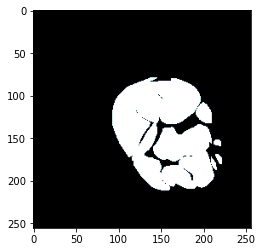

=== Slice 3904 ===


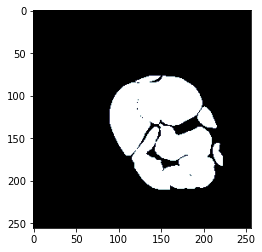

=== Slice 3906 ===


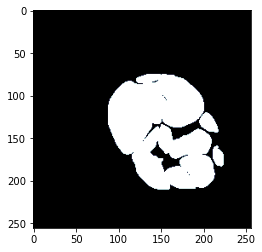

=== Slice 3908 ===


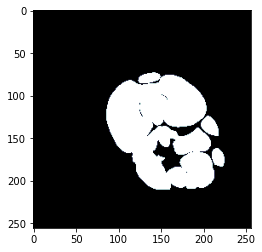

=== Slice 3910 ===


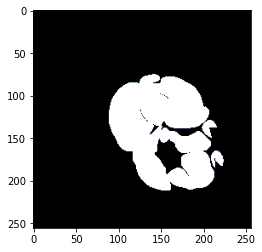

=== Slice 3912 ===


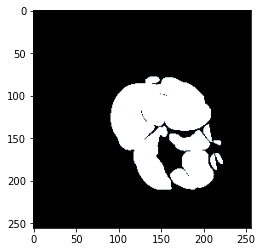

=== Slice 3914 ===


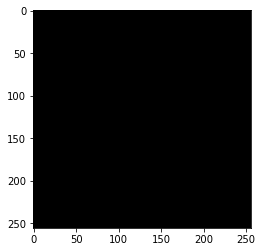

=== Slice 3916 ===


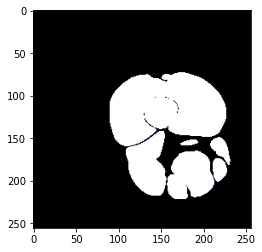

=== Slice 3918 ===


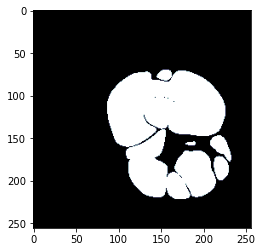

=== Slice 3920 ===


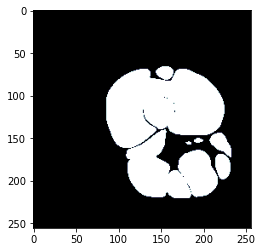

=== Slice 3922 ===


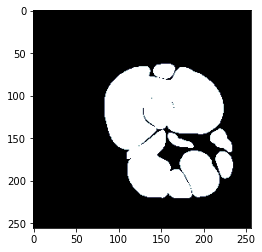

=== Slice 3924 ===


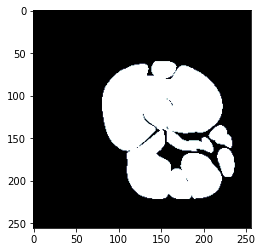

=== Slice 3926 ===


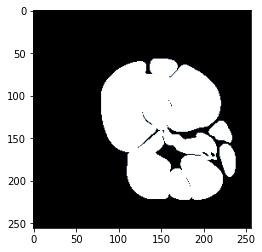

=== Slice 3928 ===


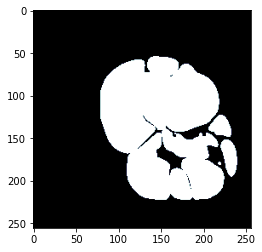

=== Slice 3930 ===


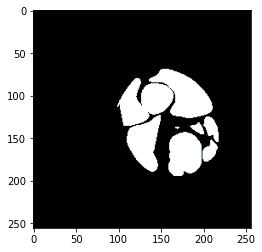

=== Slice 3932 ===


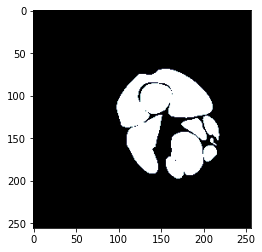

=== Slice 3934 ===


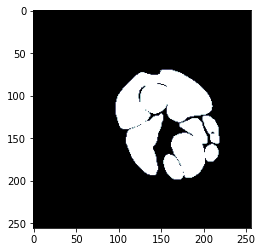

=== Slice 3936 ===


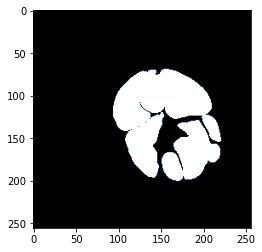

=== Slice 3938 ===


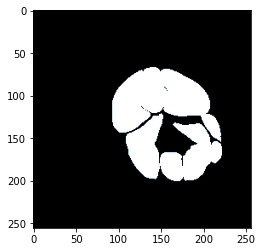

=== Slice 3940 ===


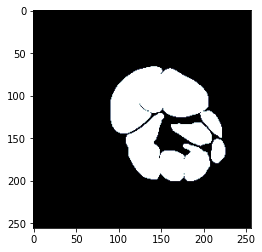

=== Slice 3942 ===


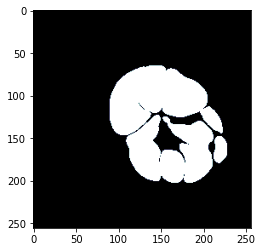

=== Slice 3944 ===


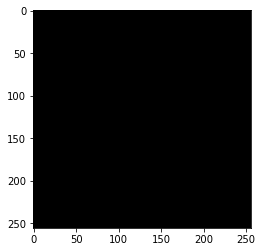

=== Slice 3946 ===


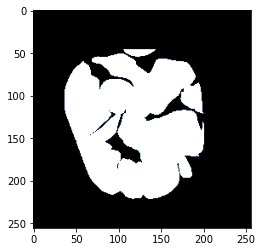

=== Slice 3948 ===


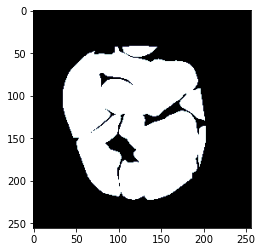

=== Slice 3950 ===


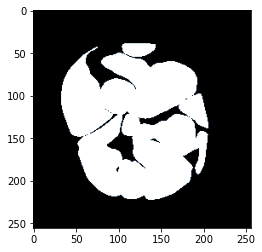

=== Slice 3952 ===


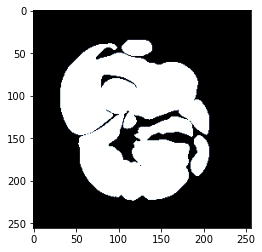

=== Slice 3954 ===


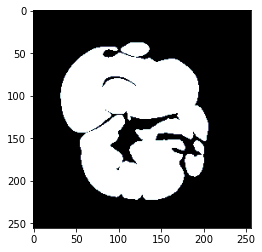

=== Slice 3956 ===


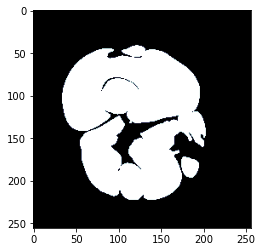

=== Slice 3958 ===


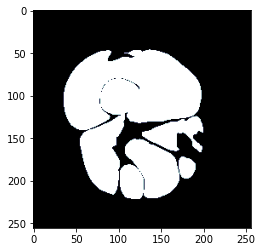

=== Slice 3960 ===


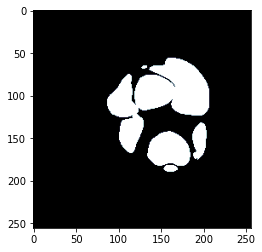

=== Slice 3962 ===


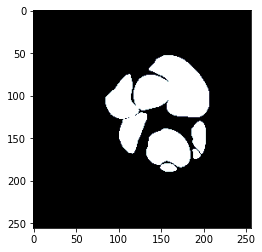

=== Slice 3964 ===


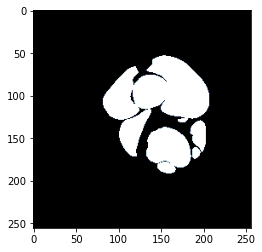

=== Slice 3966 ===


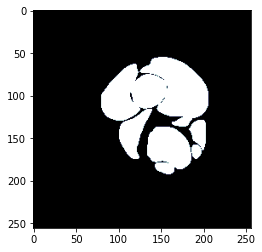

=== Slice 3968 ===


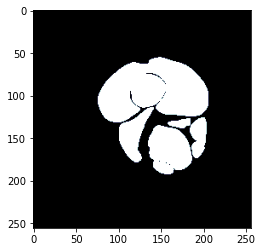

=== Slice 3970 ===


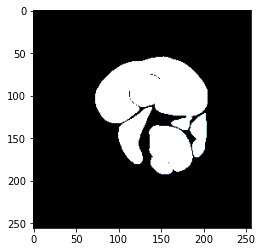

=== Slice 3972 ===


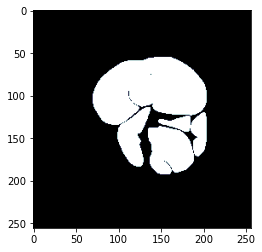

=== Slice 3974 ===


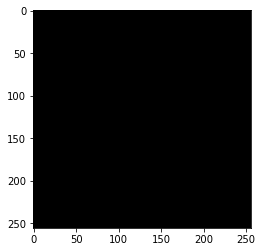

=== Slice 3976 ===


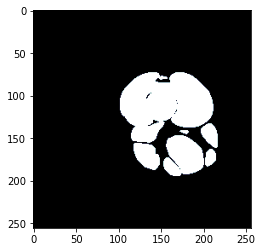

=== Slice 3978 ===


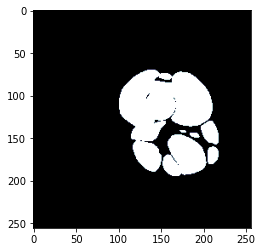

=== Slice 3980 ===


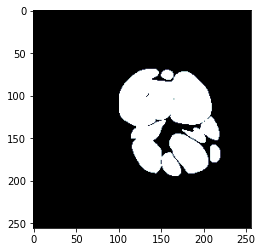

=== Slice 3982 ===


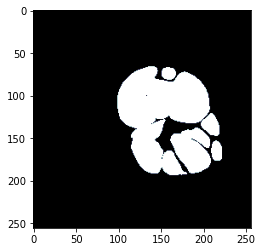

=== Slice 3984 ===


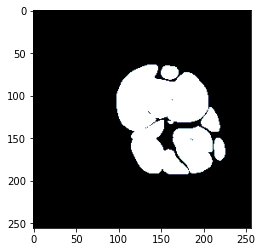

=== Slice 3986 ===


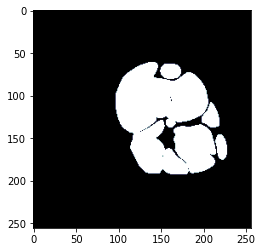

=== Slice 3988 ===


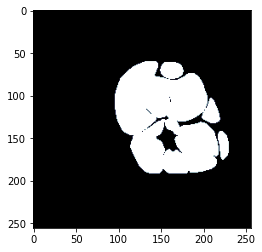

=== Slice 3990 ===


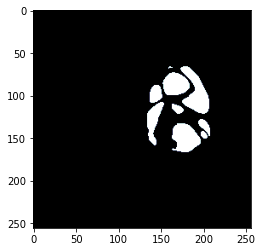

=== Slice 3992 ===


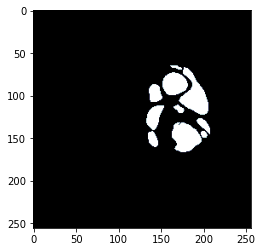

=== Slice 3994 ===


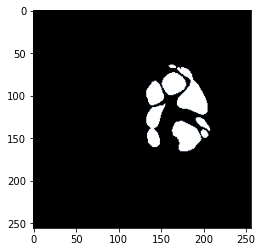

=== Slice 3996 ===


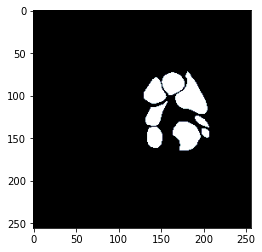

=== Slice 3998 ===


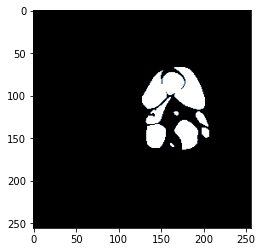

=== Slice 4000 ===


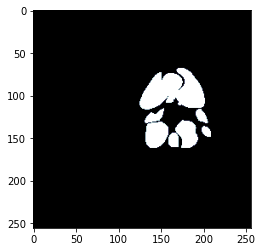

=== Slice 4002 ===


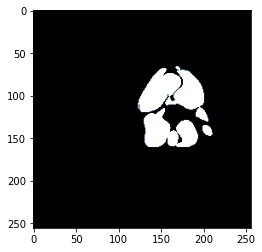

=== Slice 4004 ===


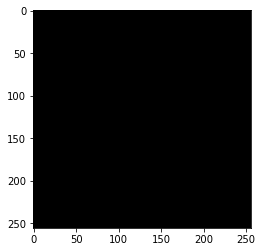

=== Slice 4006 ===


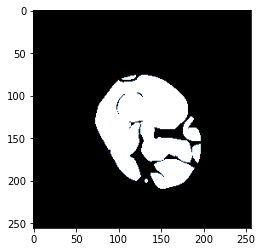

=== Slice 4008 ===


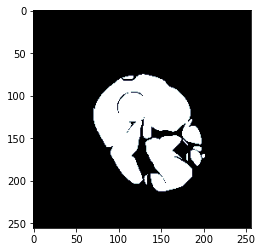

=== Slice 4010 ===


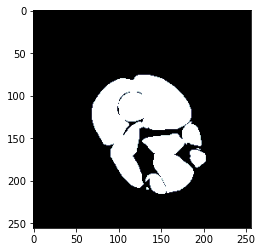

=== Slice 4012 ===


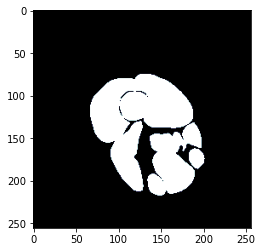

=== Slice 4014 ===


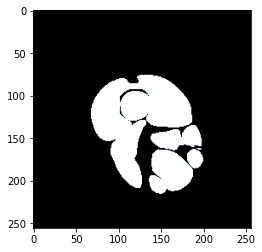

=== Slice 4016 ===


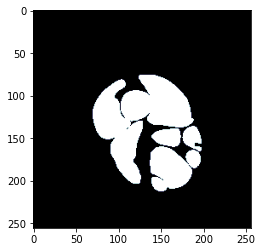

=== Slice 4018 ===


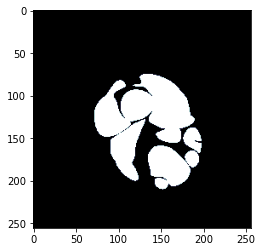

=== Slice 4020 ===


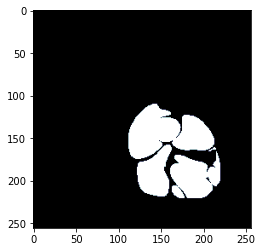

=== Slice 4022 ===


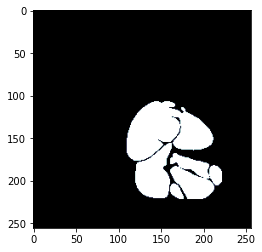

=== Slice 4024 ===


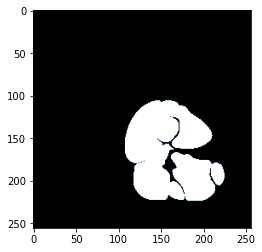

=== Slice 4026 ===


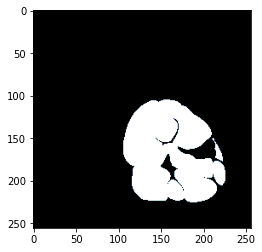

=== Slice 4028 ===


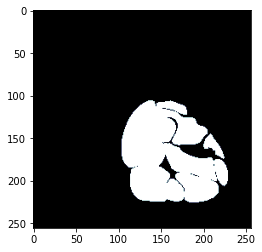

=== Slice 4030 ===


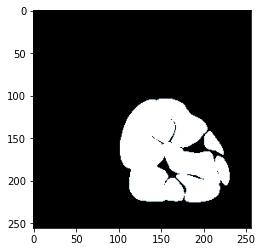

=== Slice 4032 ===


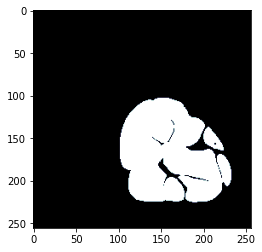

=== Slice 4034 ===


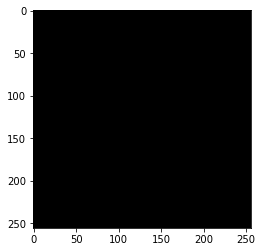

=== Slice 4036 ===


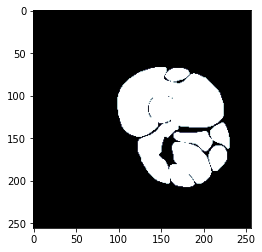

=== Slice 4038 ===


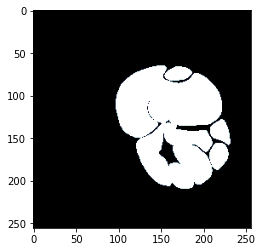

=== Slice 4040 ===


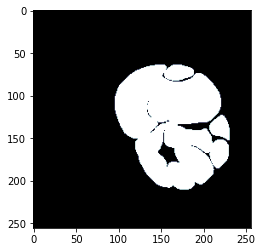

=== Slice 4042 ===


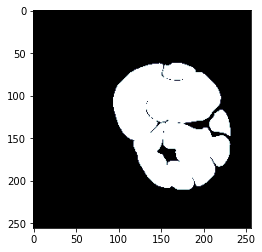

=== Slice 4044 ===


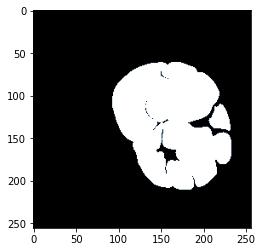

=== Slice 4046 ===


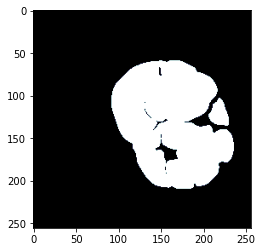

=== Slice 4048 ===


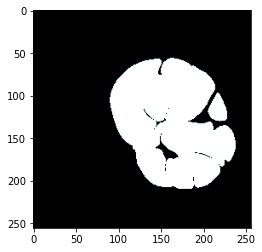

=== Slice 4050 ===


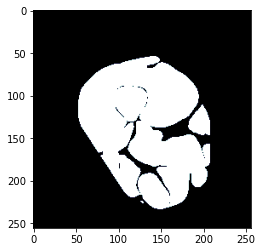

=== Slice 4052 ===


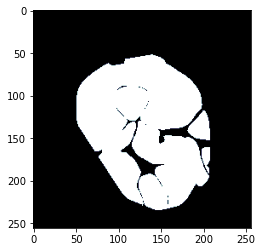

=== Slice 4054 ===


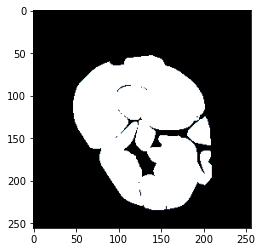

=== Slice 4056 ===


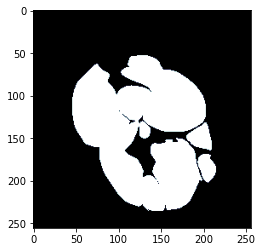

=== Slice 4058 ===


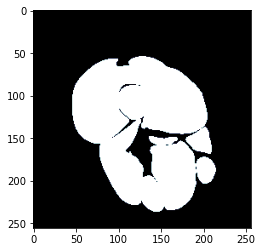

=== Slice 4060 ===


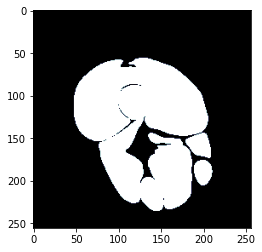

=== Slice 4062 ===


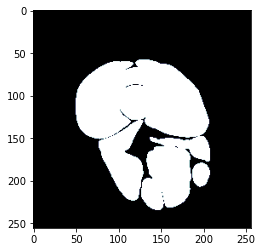

=== Slice 4064 ===


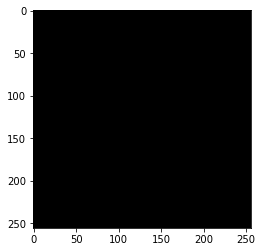

=== Slice 4066 ===


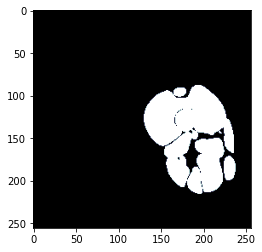

=== Slice 4068 ===


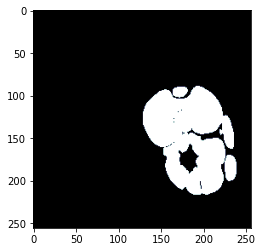

=== Slice 4070 ===


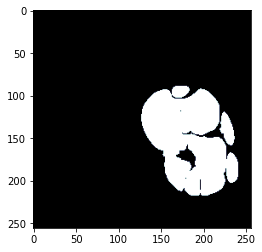

=== Slice 4072 ===


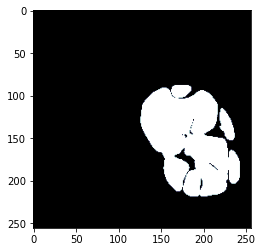

=== Slice 4074 ===


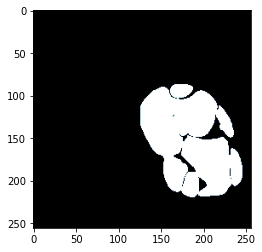

=== Slice 4076 ===


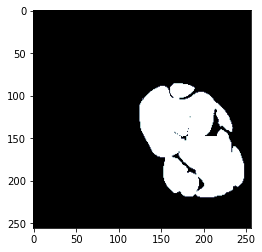

=== Slice 4078 ===


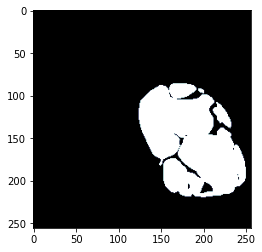

=== Slice 4080 ===


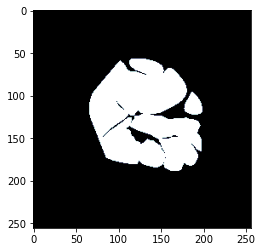

=== Slice 4082 ===


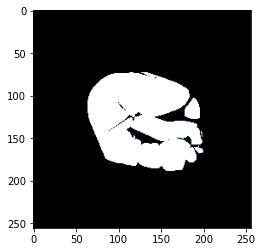

=== Slice 4084 ===


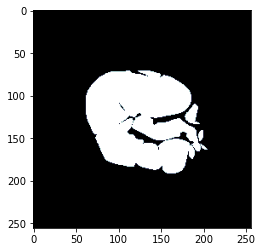

=== Slice 4086 ===


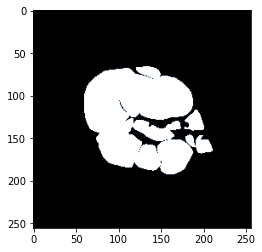

=== Slice 4088 ===


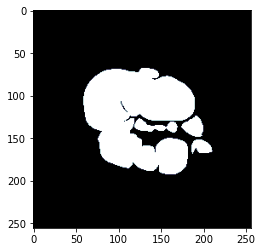

=== Slice 4090 ===


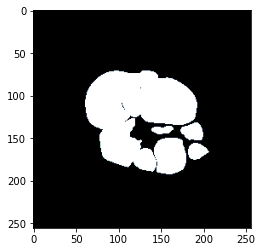

=== Slice 4092 ===


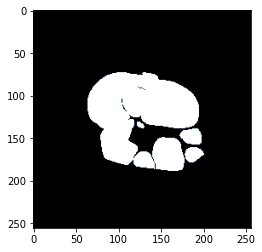

=== Slice 4094 ===


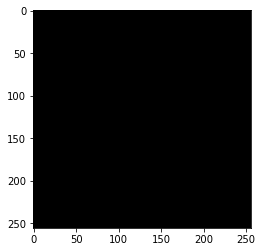

=== Slice 4096 ===


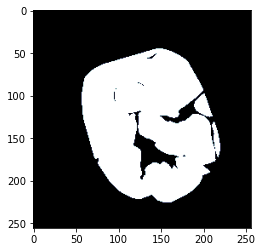

=== Slice 4098 ===


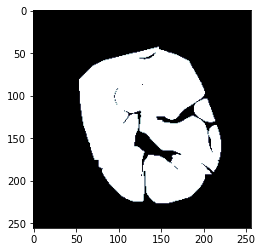

=== Slice 4100 ===


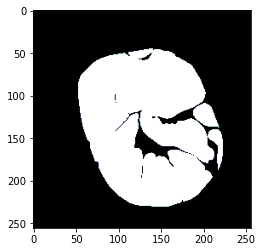

=== Slice 4102 ===


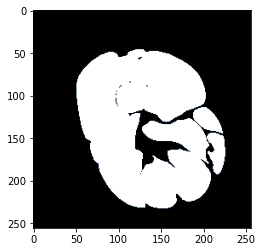

=== Slice 4104 ===


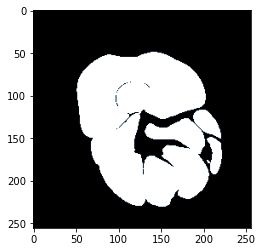

=== Slice 4106 ===


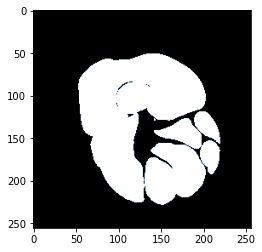

=== Slice 4108 ===


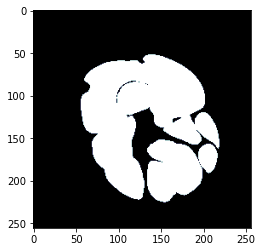

=== Slice 4110 ===


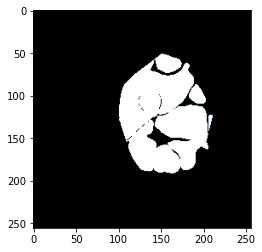

=== Slice 4112 ===


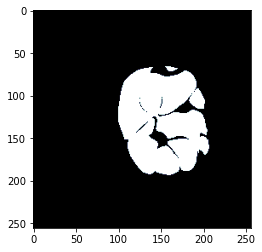

=== Slice 4114 ===


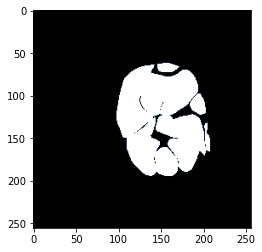

=== Slice 4116 ===


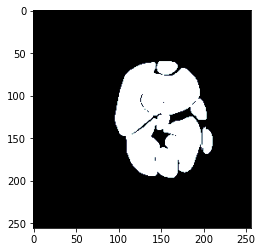

=== Slice 4118 ===


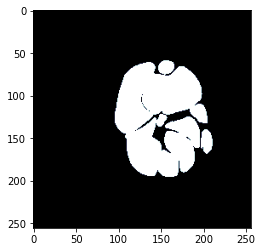

=== Slice 4120 ===


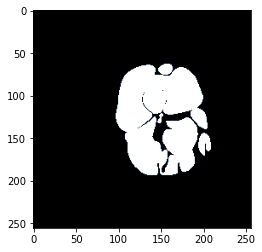

=== Slice 4122 ===


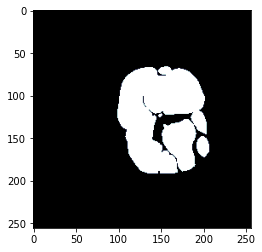

=== Slice 4124 ===


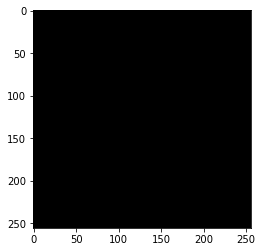

=== Slice 4126 ===


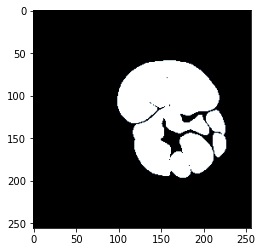

=== Slice 4128 ===


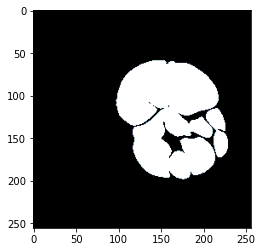

=== Slice 4130 ===


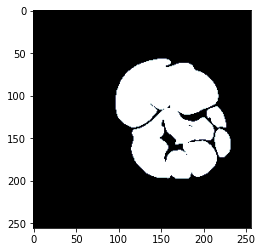

=== Slice 4132 ===


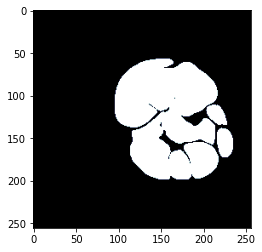

=== Slice 4134 ===


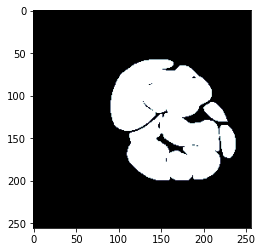

=== Slice 4136 ===


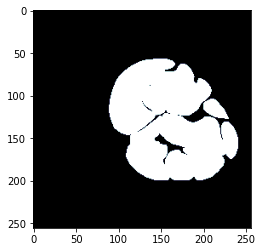

=== Slice 4138 ===


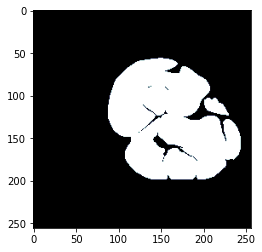

=== Slice 4140 ===


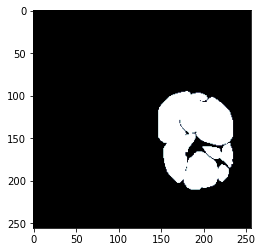

=== Slice 4142 ===


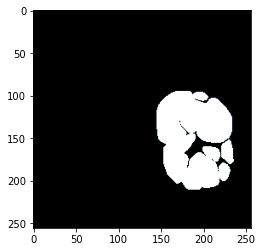

=== Slice 4144 ===


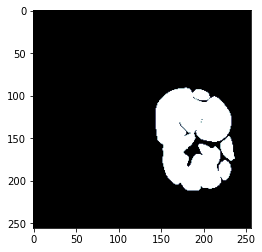

=== Slice 4146 ===


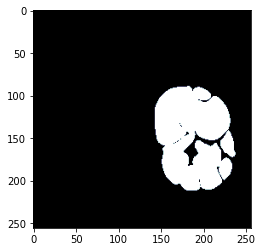

=== Slice 4148 ===


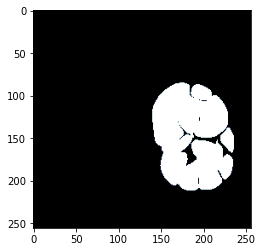

=== Slice 4150 ===


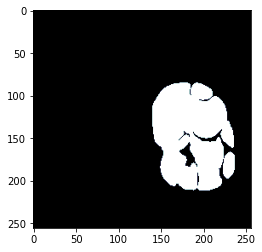

=== Slice 4152 ===


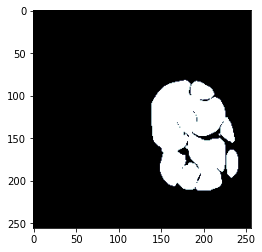

=== Slice 4154 ===


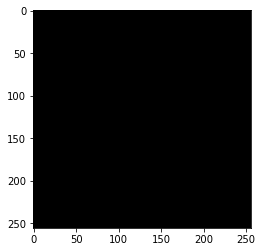

=== Slice 4156 ===


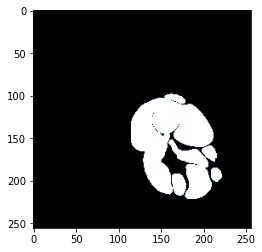

=== Slice 4158 ===


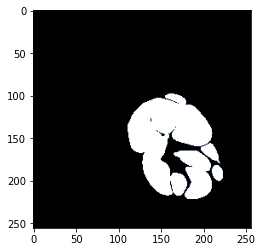

=== Slice 4160 ===


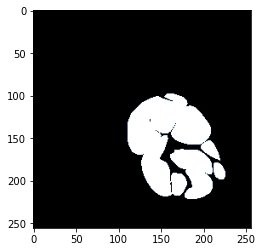

=== Slice 4162 ===


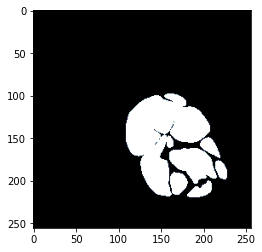

=== Slice 4164 ===


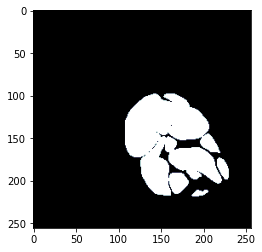

=== Slice 4166 ===


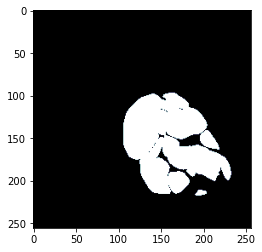

=== Slice 4168 ===


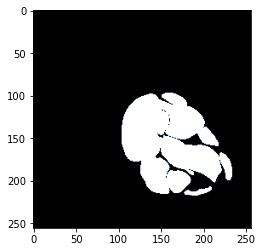

=== Slice 4170 ===


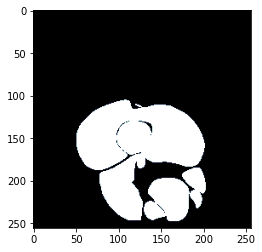

=== Slice 4172 ===


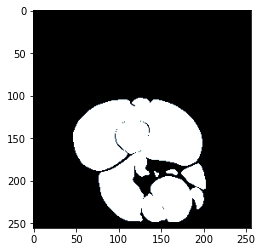

=== Slice 4174 ===


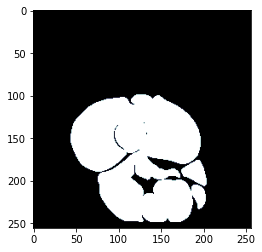

=== Slice 4176 ===


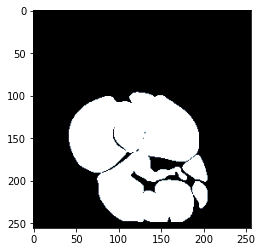

=== Slice 4178 ===


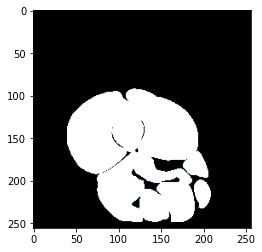

=== Slice 4180 ===


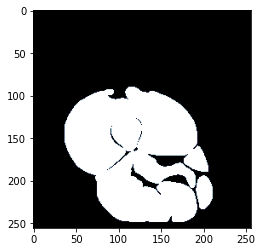

=== Slice 4182 ===


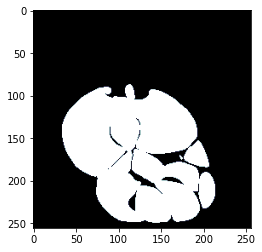

=== Slice 4184 ===


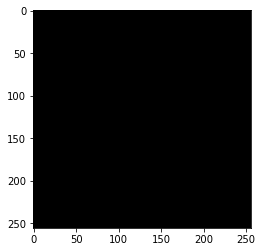

=== Slice 4186 ===


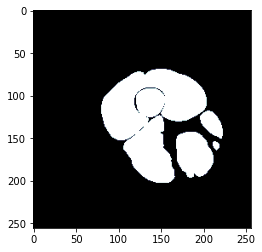

=== Slice 4188 ===


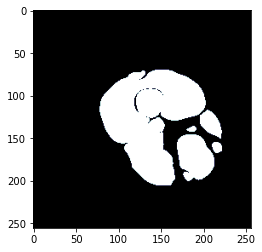

=== Slice 4190 ===


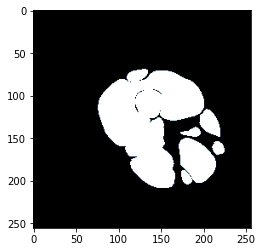

=== Slice 4192 ===


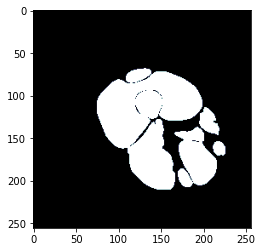

=== Slice 4194 ===


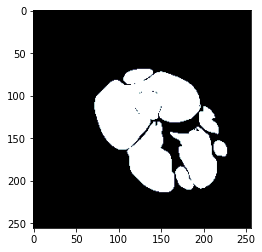

=== Slice 4196 ===


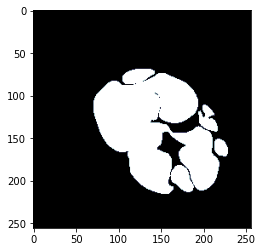

=== Slice 4198 ===


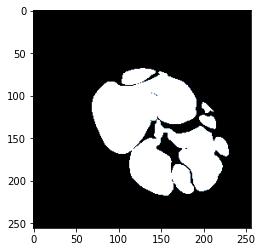

=== Slice 4200 ===


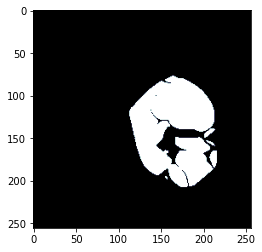

=== Slice 4202 ===


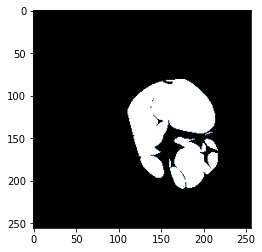

=== Slice 4204 ===


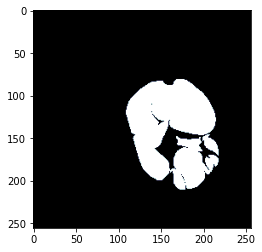

=== Slice 4206 ===


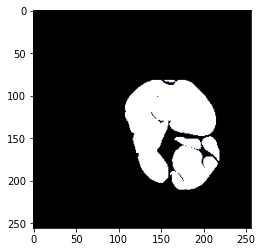

=== Slice 4208 ===


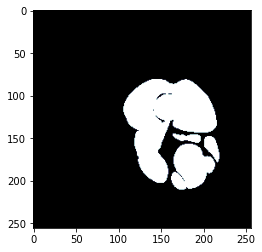

=== Slice 4210 ===


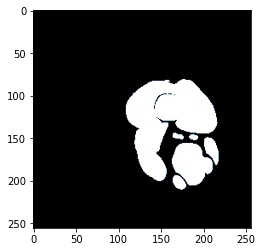

=== Slice 4212 ===


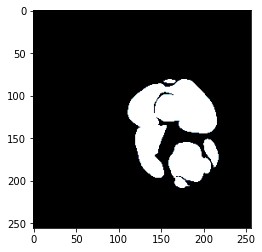

=== Slice 4214 ===


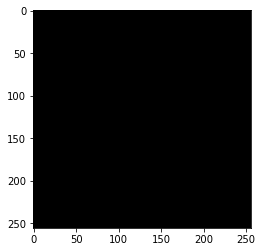

=== Slice 4216 ===


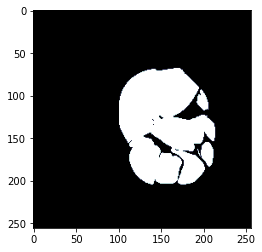

=== Slice 4218 ===


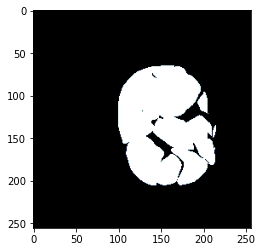

=== Slice 4220 ===


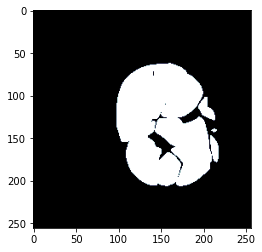

=== Slice 4222 ===


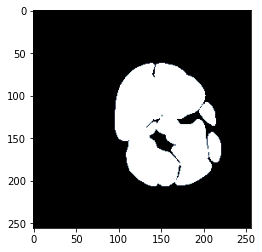

=== Slice 4224 ===


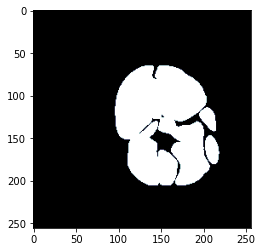

=== Slice 4226 ===


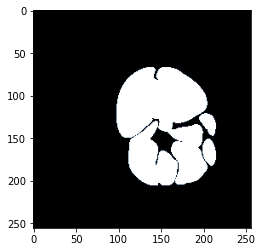

=== Slice 4228 ===


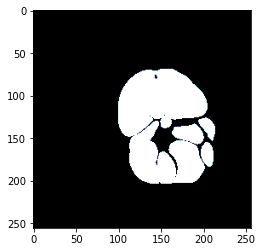

=== Slice 4230 ===


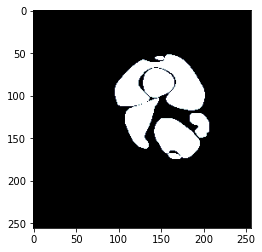

=== Slice 4232 ===


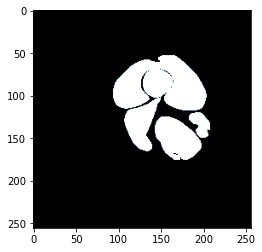

=== Slice 4234 ===


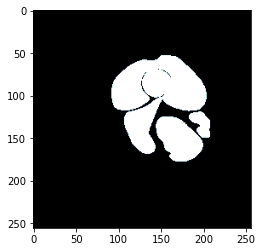

=== Slice 4236 ===


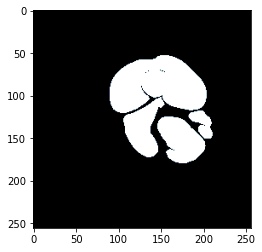

=== Slice 4238 ===


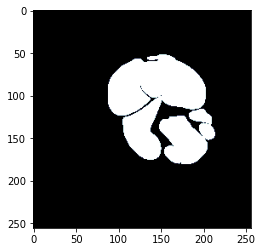

=== Slice 4240 ===


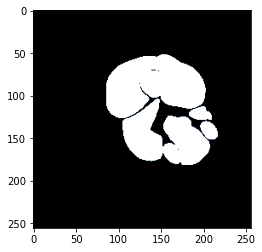

=== Slice 4242 ===


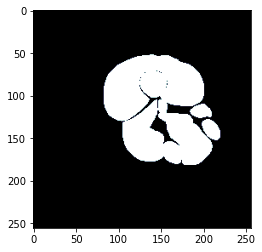

=== Slice 4244 ===


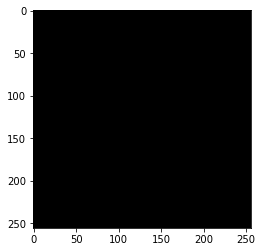

=== Slice 4246 ===


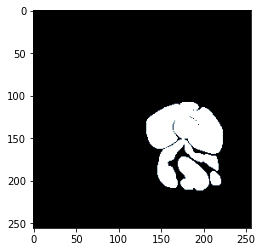

=== Slice 4248 ===


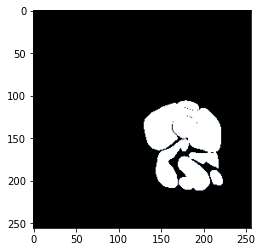

=== Slice 4250 ===


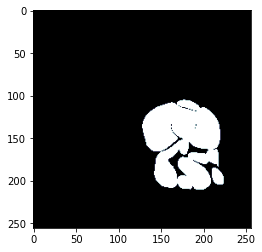

=== Slice 4252 ===


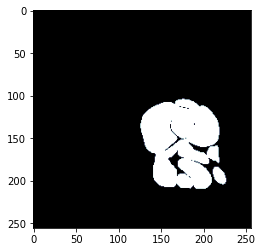

=== Slice 4254 ===


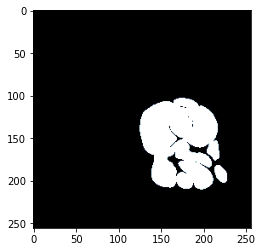

=== Slice 4256 ===


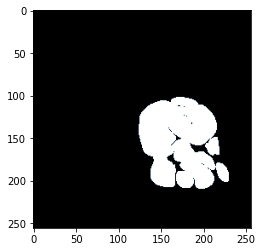

=== Slice 4258 ===


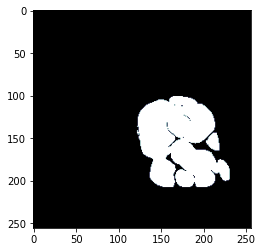

=== Slice 4260 ===


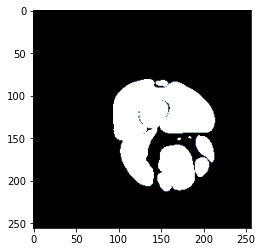

=== Slice 4262 ===


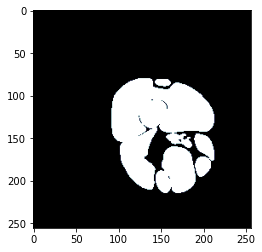

=== Slice 4264 ===


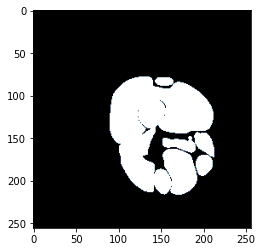

=== Slice 4266 ===


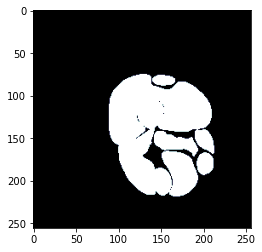

=== Slice 4268 ===


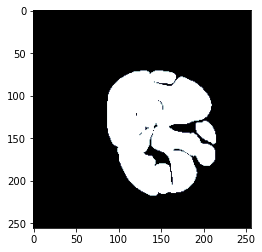

=== Slice 4270 ===


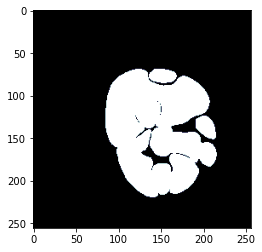

=== Slice 4272 ===


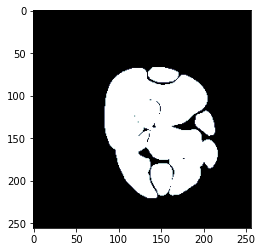

=== Slice 4274 ===


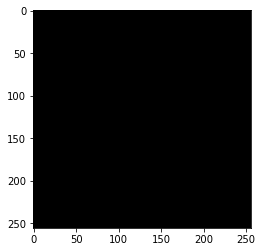

=== Slice 4276 ===


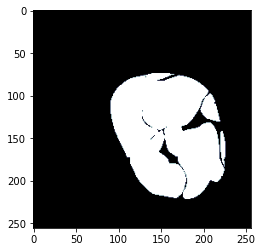

=== Slice 4278 ===


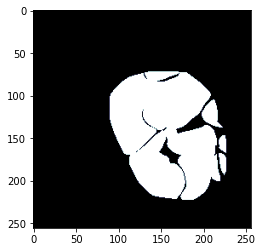

=== Slice 4280 ===


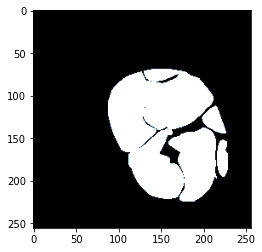

=== Slice 4282 ===


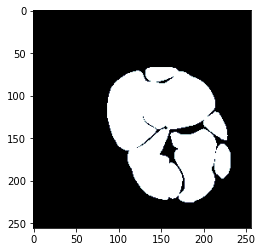

=== Slice 4284 ===


=== Slice 4286 ===


=== Slice 4288 ===


=== Slice 4290 ===


=== Slice 4292 ===


=== Slice 4294 ===


=== Slice 4296 ===


=== Slice 4298 ===


=== Slice 4300 ===


=== Slice 4302 ===


=== Slice 4304 ===


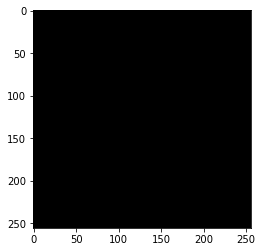

=== Slice 4306 ===


=== Slice 4308 ===


=== Slice 4310 ===


=== Slice 4312 ===


=== Slice 4314 ===


=== Slice 4316 ===


=== Slice 4318 ===


=== Slice 4320 ===


=== Slice 4322 ===


=== Slice 4324 ===


=== Slice 4326 ===


=== Slice 4328 ===


=== Slice 4330 ===


=== Slice 4332 ===


=== Slice 4334 ===


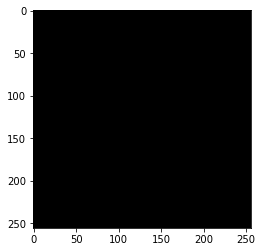

=== Slice 4336 ===


=== Slice 4338 ===


=== Slice 4340 ===


=== Slice 4342 ===


=== Slice 4344 ===


=== Slice 4346 ===


=== Slice 4348 ===


=== Slice 4350 ===


=== Slice 4352 ===


=== Slice 4354 ===


=== Slice 4356 ===


=== Slice 4358 ===


=== Slice 4360 ===


=== Slice 4362 ===


=== Slice 4364 ===


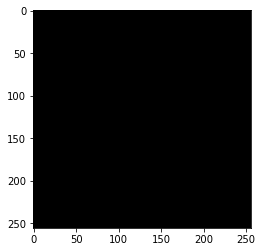

=== Slice 4366 ===


=== Slice 4368 ===


=== Slice 4370 ===


=== Slice 4372 ===


=== Slice 4374 ===


=== Slice 4376 ===


=== Slice 4378 ===


=== Slice 4380 ===


=== Slice 4382 ===


=== Slice 4384 ===


=== Slice 4386 ===


=== Slice 4388 ===


=== Slice 4390 ===


=== Slice 4392 ===


=== Slice 4394 ===


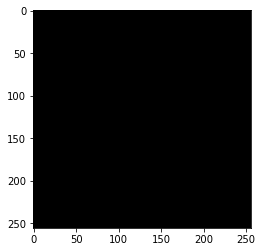

=== Slice 4396 ===


=== Slice 4398 ===


=== Slice 4400 ===


=== Slice 4402 ===


=== Slice 4404 ===


=== Slice 4406 ===


=== Slice 4408 ===


=== Slice 4410 ===


=== Slice 4412 ===


=== Slice 4414 ===


=== Slice 4416 ===


=== Slice 4418 ===


=== Slice 4420 ===


=== Slice 4422 ===


=== Slice 4424 ===


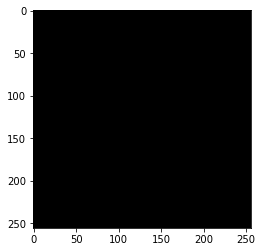

=== Slice 4426 ===


=== Slice 4428 ===


=== Slice 4430 ===


=== Slice 4432 ===


=== Slice 4434 ===


=== Slice 4436 ===


=== Slice 4438 ===


=== Slice 4440 ===


=== Slice 4442 ===


=== Slice 4444 ===


=== Slice 4446 ===


=== Slice 4448 ===


=== Slice 4450 ===


=== Slice 4452 ===


=== Slice 4454 ===


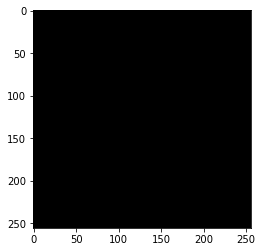

=== Slice 4456 ===


=== Slice 4458 ===


=== Slice 4460 ===


=== Slice 4462 ===


=== Slice 4464 ===


=== Slice 4466 ===


=== Slice 4468 ===


=== Slice 4470 ===


=== Slice 4472 ===


=== Slice 4474 ===


=== Slice 4476 ===


=== Slice 4478 ===


=== Slice 4480 ===


=== Slice 4482 ===


=== Slice 4484 ===


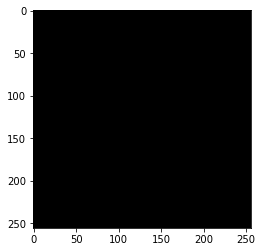

=== Slice 4486 ===


=== Slice 4488 ===


=== Slice 4490 ===


=== Slice 4492 ===


=== Slice 4494 ===


=== Slice 4496 ===


=== Slice 4498 ===


=== Slice 4500 ===


=== Slice 4502 ===


=== Slice 4504 ===


=== Slice 4506 ===


=== Slice 4508 ===


=== Slice 4510 ===


=== Slice 4512 ===


=== Slice 4514 ===


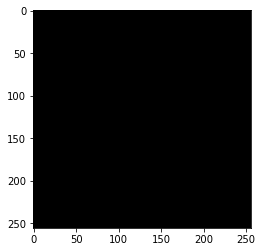

=== Slice 4516 ===


=== Slice 4518 ===


=== Slice 4520 ===


=== Slice 4522 ===


=== Slice 4524 ===


=== Slice 4526 ===


=== Slice 4528 ===


=== Slice 4530 ===


=== Slice 4532 ===


=== Slice 4534 ===


=== Slice 4536 ===


=== Slice 4538 ===


=== Slice 4540 ===


=== Slice 4542 ===


=== Slice 4544 ===


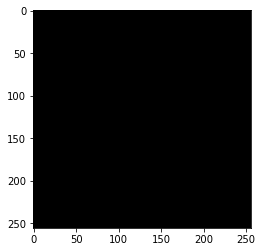

=== Slice 4546 ===


=== Slice 4548 ===


=== Slice 4550 ===


=== Slice 4552 ===


=== Slice 4554 ===


=== Slice 4556 ===


=== Slice 4558 ===


=== Slice 4560 ===


=== Slice 4562 ===


=== Slice 4564 ===


=== Slice 4566 ===


=== Slice 4568 ===


=== Slice 4570 ===


=== Slice 4572 ===


=== Slice 4574 ===


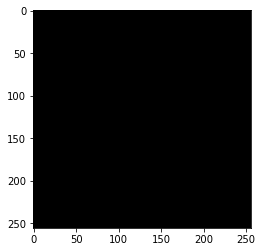

=== Slice 4576 ===


=== Slice 4578 ===


=== Slice 4580 ===


=== Slice 4582 ===


=== Slice 4584 ===


=== Slice 4586 ===


=== Slice 4588 ===


=== Slice 4590 ===


=== Slice 4592 ===


=== Slice 4594 ===


=== Slice 4596 ===


=== Slice 4598 ===


=== Slice 4600 ===


=== Slice 4602 ===


=== Slice 4604 ===


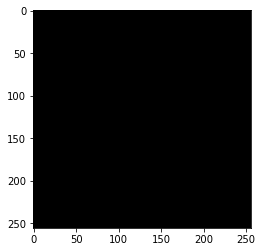

=== Slice 4606 ===


=== Slice 4608 ===


=== Slice 4610 ===


=== Slice 4612 ===


=== Slice 4614 ===


=== Slice 4616 ===


=== Slice 4618 ===


=== Slice 4620 ===


=== Slice 4622 ===


=== Slice 4624 ===


=== Slice 4626 ===


=== Slice 4628 ===


=== Slice 4630 ===


=== Slice 4632 ===


=== Slice 4634 ===


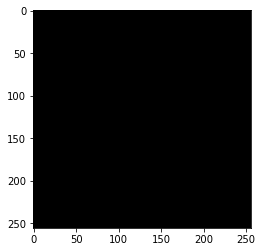

=== Slice 4636 ===


=== Slice 4638 ===


=== Slice 4640 ===


=== Slice 4642 ===


=== Slice 4644 ===


=== Slice 4646 ===


=== Slice 4648 ===


=== Slice 4650 ===


=== Slice 4652 ===


=== Slice 4654 ===


=== Slice 4656 ===


=== Slice 4658 ===


=== Slice 4660 ===


=== Slice 4662 ===


=== Slice 4664 ===


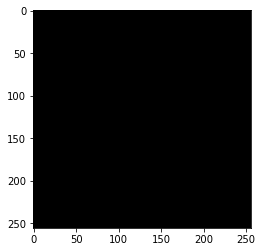

=== Slice 4666 ===


=== Slice 4668 ===


=== Slice 4670 ===


=== Slice 4672 ===


=== Slice 4674 ===


=== Slice 4676 ===


=== Slice 4678 ===


=== Slice 4680 ===


=== Slice 4682 ===


=== Slice 4684 ===


=== Slice 4686 ===


=== Slice 4688 ===


=== Slice 4690 ===


=== Slice 4692 ===


=== Slice 4694 ===


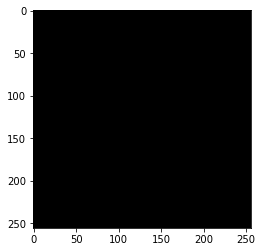

=== Slice 4696 ===


=== Slice 4698 ===


=== Slice 4700 ===


=== Slice 4702 ===


=== Slice 4704 ===


=== Slice 4706 ===


=== Slice 4708 ===


=== Slice 4710 ===


=== Slice 4712 ===


=== Slice 4714 ===


=== Slice 4716 ===


=== Slice 4718 ===


=== Slice 4720 ===


=== Slice 4722 ===


=== Slice 4724 ===


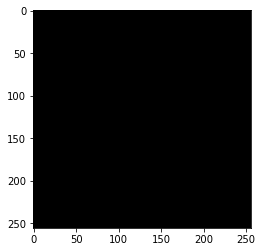

=== Slice 4726 ===


=== Slice 4728 ===


=== Slice 4730 ===


=== Slice 4732 ===


=== Slice 4734 ===


=== Slice 4736 ===


=== Slice 4738 ===


=== Slice 4740 ===


=== Slice 4742 ===


=== Slice 4744 ===


=== Slice 4746 ===


=== Slice 4748 ===


=== Slice 4750 ===


=== Slice 4752 ===


=== Slice 4754 ===


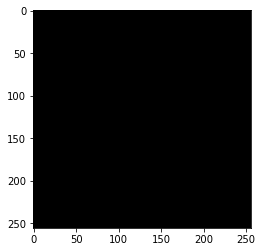

=== Slice 4756 ===


=== Slice 4758 ===


=== Slice 4760 ===


=== Slice 4762 ===


=== Slice 4764 ===


=== Slice 4766 ===


=== Slice 4768 ===


=== Slice 4770 ===


=== Slice 4772 ===


=== Slice 4774 ===


=== Slice 4776 ===


=== Slice 4778 ===


=== Slice 4780 ===


=== Slice 4782 ===


=== Slice 4784 ===


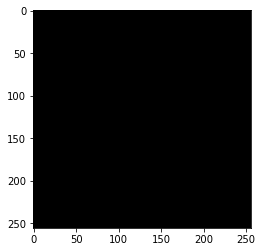

=== Slice 4786 ===


=== Slice 4788 ===


=== Slice 4790 ===


=== Slice 4792 ===


=== Slice 4794 ===


=== Slice 4796 ===


=== Slice 4798 ===


=== Slice 4800 ===


=== Slice 4802 ===


=== Slice 4804 ===


=== Slice 4806 ===


=== Slice 4808 ===


=== Slice 4810 ===


=== Slice 4812 ===


=== Slice 4814 ===


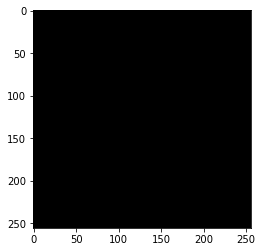

=== Slice 4816 ===


=== Slice 4818 ===


=== Slice 4820 ===


=== Slice 4822 ===


=== Slice 4824 ===


=== Slice 4826 ===


=== Slice 4828 ===


=== Slice 4830 ===


=== Slice 4832 ===


=== Slice 4834 ===


=== Slice 4836 ===


=== Slice 4838 ===


=== Slice 4840 ===


=== Slice 4842 ===


=== Slice 4844 ===


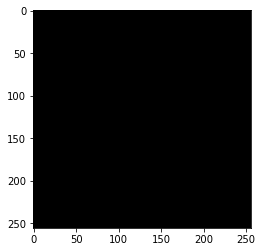

=== Slice 4846 ===


=== Slice 4848 ===


=== Slice 4850 ===


=== Slice 4852 ===


=== Slice 4854 ===


=== Slice 4856 ===


=== Slice 4858 ===


=== Slice 4860 ===


=== Slice 4862 ===


=== Slice 4864 ===


=== Slice 4866 ===


=== Slice 4868 ===


=== Slice 4870 ===


=== Slice 4872 ===


=== Slice 4874 ===


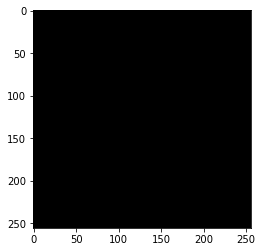

=== Slice 4876 ===


=== Slice 4878 ===


=== Slice 4880 ===


=== Slice 4882 ===


=== Slice 4884 ===


=== Slice 4886 ===


=== Slice 4888 ===


=== Slice 4890 ===


=== Slice 4892 ===


=== Slice 4894 ===


=== Slice 4896 ===


=== Slice 4898 ===


=== Slice 4900 ===


=== Slice 4902 ===


=== Slice 4904 ===


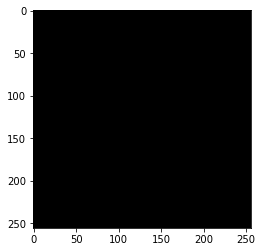

=== Slice 4906 ===


=== Slice 4908 ===


=== Slice 4910 ===


=== Slice 4912 ===


=== Slice 4914 ===


=== Slice 4916 ===


=== Slice 4918 ===


=== Slice 4920 ===


=== Slice 4922 ===


=== Slice 4924 ===


=== Slice 4926 ===


=== Slice 4928 ===


=== Slice 4930 ===


=== Slice 4932 ===


=== Slice 4934 ===


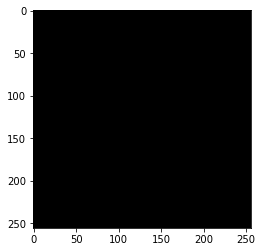

=== Slice 4936 ===


=== Slice 4938 ===


=== Slice 4940 ===


=== Slice 4942 ===


=== Slice 4944 ===


=== Slice 4946 ===


=== Slice 4948 ===


=== Slice 4950 ===


=== Slice 4952 ===


=== Slice 4954 ===


=== Slice 4956 ===


=== Slice 4958 ===


=== Slice 4960 ===


=== Slice 4962 ===


=== Slice 4964 ===


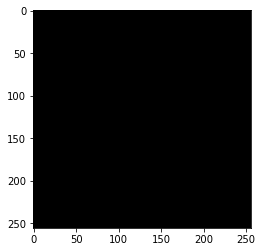

=== Slice 4966 ===


=== Slice 4968 ===


=== Slice 4970 ===


=== Slice 4972 ===


=== Slice 4974 ===


=== Slice 4976 ===


=== Slice 4978 ===


=== Slice 4980 ===


=== Slice 4982 ===


=== Slice 4984 ===


=== Slice 4986 ===


=== Slice 4988 ===


=== Slice 4990 ===


=== Slice 4992 ===


=== Slice 4994 ===


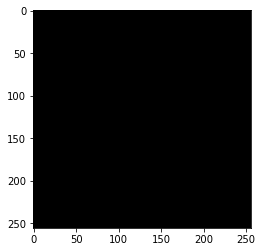

=== Slice 4996 ===


=== Slice 4998 ===


=== Slice 5000 ===


=== Slice 5002 ===


=== Slice 5004 ===


=== Slice 5006 ===


=== Slice 5008 ===


=== Slice 5010 ===


=== Slice 5012 ===


=== Slice 5014 ===


=== Slice 5016 ===


=== Slice 5018 ===


=== Slice 5020 ===


=== Slice 5022 ===


=== Slice 5024 ===


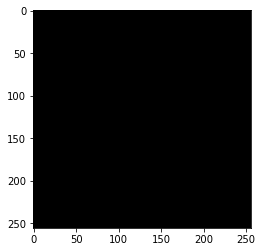

=== Slice 5026 ===


=== Slice 5028 ===


=== Slice 5030 ===


=== Slice 5032 ===


=== Slice 5034 ===


=== Slice 5036 ===


=== Slice 5038 ===


=== Slice 5040 ===


=== Slice 5042 ===


=== Slice 5044 ===


=== Slice 5046 ===


=== Slice 5048 ===


=== Slice 5050 ===


=== Slice 5052 ===


=== Slice 5054 ===


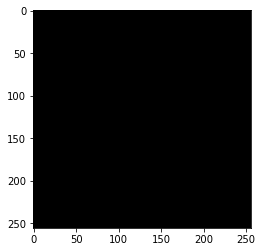

=== Slice 5056 ===


=== Slice 5058 ===


=== Slice 5060 ===


=== Slice 5062 ===


=== Slice 5064 ===


=== Slice 5066 ===


=== Slice 5068 ===


=== Slice 5070 ===


=== Slice 5072 ===


=== Slice 5074 ===


=== Slice 5076 ===


=== Slice 5078 ===


=== Slice 5080 ===


=== Slice 5082 ===


=== Slice 5084 ===


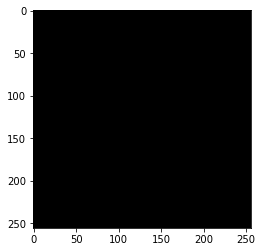

=== Slice 5086 ===


=== Slice 5088 ===


=== Slice 5090 ===


=== Slice 5092 ===


=== Slice 5094 ===


=== Slice 5096 ===


=== Slice 5098 ===


=== Slice 5100 ===


=== Slice 5102 ===


=== Slice 5104 ===


=== Slice 5106 ===


=== Slice 5108 ===


=== Slice 5110 ===


=== Slice 5112 ===


=== Slice 5114 ===


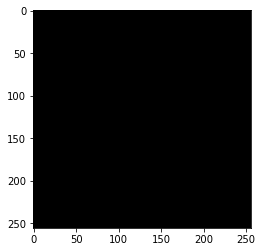

=== Slice 5116 ===


=== Slice 5118 ===


=== Slice 5120 ===


=== Slice 5122 ===


=== Slice 5124 ===


=== Slice 5126 ===


=== Slice 5128 ===


=== Slice 5130 ===


=== Slice 5132 ===


=== Slice 5134 ===


=== Slice 5136 ===


=== Slice 5138 ===


=== Slice 5140 ===


=== Slice 5142 ===


=== Slice 5144 ===


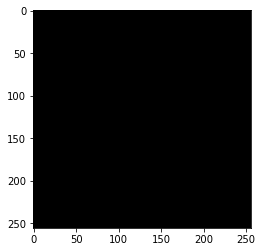

=== Slice 5146 ===


=== Slice 5148 ===


=== Slice 5150 ===


=== Slice 5152 ===


=== Slice 5154 ===


=== Slice 5156 ===


=== Slice 5158 ===


=== Slice 5160 ===


=== Slice 5162 ===


=== Slice 5164 ===


=== Slice 5166 ===


=== Slice 5168 ===


=== Slice 5170 ===


=== Slice 5172 ===


=== Slice 5174 ===


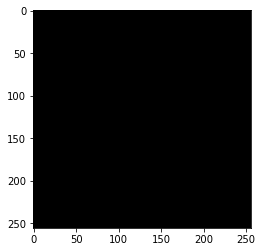

=== Slice 5176 ===


=== Slice 5178 ===


=== Slice 5180 ===


=== Slice 5182 ===


=== Slice 5184 ===


=== Slice 5186 ===


=== Slice 5188 ===


=== Slice 5190 ===


=== Slice 5192 ===


=== Slice 5194 ===


=== Slice 5196 ===


=== Slice 5198 ===


=== Slice 5200 ===


=== Slice 5202 ===


=== Slice 5204 ===


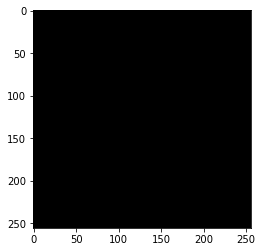

=== Slice 5206 ===


=== Slice 5208 ===


=== Slice 5210 ===


=== Slice 5212 ===


=== Slice 5214 ===


=== Slice 5216 ===


=== Slice 5218 ===


=== Slice 5220 ===


=== Slice 5222 ===


=== Slice 5224 ===


=== Slice 5226 ===


=== Slice 5228 ===


=== Slice 5230 ===


=== Slice 5232 ===


=== Slice 5234 ===


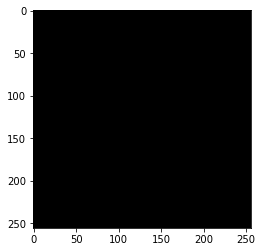

=== Slice 5236 ===


=== Slice 5238 ===


=== Slice 5240 ===


=== Slice 5242 ===


=== Slice 5244 ===


=== Slice 5246 ===


=== Slice 5248 ===


=== Slice 5250 ===


=== Slice 5252 ===


=== Slice 5254 ===


=== Slice 5256 ===


=== Slice 5258 ===


=== Slice 5260 ===


=== Slice 5262 ===


=== Slice 5264 ===


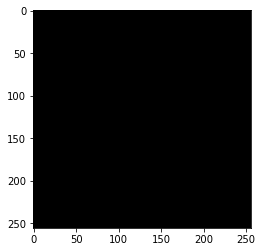

=== Slice 5266 ===


=== Slice 5268 ===


=== Slice 5270 ===


=== Slice 5272 ===


=== Slice 5274 ===


=== Slice 5276 ===


=== Slice 5278 ===


=== Slice 5280 ===


=== Slice 5282 ===


=== Slice 5284 ===


=== Slice 5286 ===


=== Slice 5288 ===


=== Slice 5290 ===


=== Slice 5292 ===


=== Slice 5294 ===


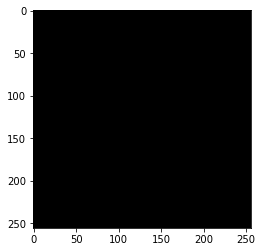

=== Slice 5296 ===


=== Slice 5298 ===


=== Slice 5300 ===


=== Slice 5302 ===


=== Slice 5304 ===


=== Slice 5306 ===


=== Slice 5308 ===


=== Slice 5310 ===


=== Slice 5312 ===


=== Slice 5314 ===


=== Slice 5316 ===


=== Slice 5318 ===


=== Slice 5320 ===


=== Slice 5322 ===


=== Slice 5324 ===


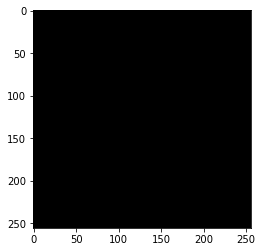

=== Slice 5326 ===


=== Slice 5328 ===


=== Slice 5330 ===


=== Slice 5332 ===


=== Slice 5334 ===


=== Slice 5336 ===


=== Slice 5338 ===


=== Slice 5340 ===


=== Slice 5342 ===


=== Slice 5344 ===


=== Slice 5346 ===


=== Slice 5348 ===


=== Slice 5350 ===


=== Slice 5352 ===


=== Slice 5354 ===


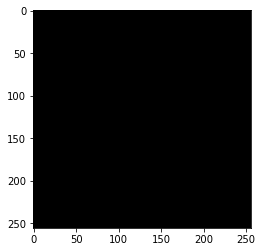

=== Slice 5356 ===


=== Slice 5358 ===


=== Slice 5360 ===


=== Slice 5362 ===


=== Slice 5364 ===


=== Slice 5366 ===


=== Slice 5368 ===


=== Slice 5370 ===


=== Slice 5372 ===


=== Slice 5374 ===


=== Slice 5376 ===


=== Slice 5378 ===


=== Slice 5380 ===


=== Slice 5382 ===


=== Slice 5384 ===


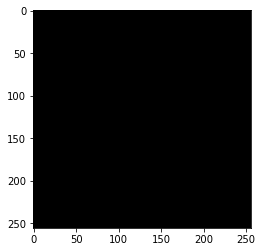

=== Slice 5386 ===


=== Slice 5388 ===


=== Slice 5390 ===


=== Slice 5392 ===


=== Slice 5394 ===


=== Slice 5396 ===


=== Slice 5398 ===


=== Slice 5400 ===


=== Slice 5402 ===


=== Slice 5404 ===


=== Slice 5406 ===


=== Slice 5408 ===


=== Slice 5410 ===


=== Slice 5412 ===


=== Slice 5414 ===


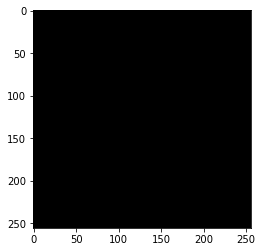

=== Slice 5416 ===


=== Slice 5418 ===


=== Slice 5420 ===


=== Slice 5422 ===


=== Slice 5424 ===


=== Slice 5426 ===


=== Slice 5428 ===


=== Slice 5430 ===


=== Slice 5432 ===


=== Slice 5434 ===


=== Slice 5436 ===


=== Slice 5438 ===


=== Slice 5440 ===


=== Slice 5442 ===


=== Slice 5444 ===


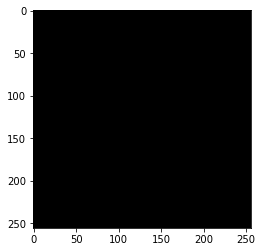

=== Slice 5446 ===


=== Slice 5448 ===


=== Slice 5450 ===


=== Slice 5452 ===


=== Slice 5454 ===


=== Slice 5456 ===


=== Slice 5458 ===


=== Slice 5460 ===


=== Slice 5462 ===


=== Slice 5464 ===


=== Slice 5466 ===


=== Slice 5468 ===


=== Slice 5470 ===


=== Slice 5472 ===


=== Slice 5474 ===


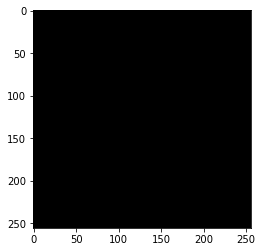

=== Slice 5476 ===


=== Slice 5478 ===


=== Slice 5480 ===


=== Slice 5482 ===


=== Slice 5484 ===


=== Slice 5486 ===


=== Slice 5488 ===


=== Slice 5490 ===


=== Slice 5492 ===


=== Slice 5494 ===


=== Slice 5496 ===


=== Slice 5498 ===


=== Slice 5500 ===


=== Slice 5502 ===


=== Slice 5504 ===


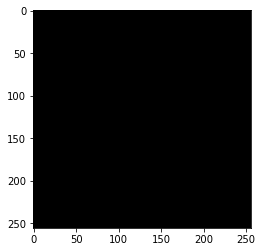

=== Slice 5506 ===


=== Slice 5508 ===


=== Slice 5510 ===


=== Slice 5512 ===


=== Slice 5514 ===


=== Slice 5516 ===


=== Slice 5518 ===


In [55]:
patientplot(PostZConnectFat)

In [56]:
np.save("PostZConnectSeg",PostZConnectFat)

In [6]:
plt.imshow(UFATS[1])